# Generar 'X' e 'y' para todos los experimentos
<p>Como datos para las X se toma la media de los 17 canales de:</p>
<ul>
    <li>X_1: PSD de la banda delta (1~4Hz)</li>
    <li>X_2: PSD de la banda theta (4~8Hz)</li>
    <li>X_3: PSD de la banda alpha (8~14Hz)</li>
    <li>X_4: PSD de la banda beta (14~31Hz)</li>
    <li>X_5: PSD de la banda gamma (31~50 Hz)</li>
</ul>

In [1]:
import mne
from mne.externals.pymatreader import read_mat

from read import read_features

import numpy as np

import pandas as pd

from sklearn.preprocessing import MinMaxScaler

import matplotlib
import matplotlib.pyplot as plt

In [2]:
labels = {
    'leve': 0,
    'moderada': 1,
    'severa': 2
}

def parse_y(y, lim_leve=0.075, lim_moderada=0.15):
    def classify(val):
        if (val <= lim_leve):
            return labels['leve']
        if (val <= lim_moderada):
            return labels['moderada']
        return labels['severa']
    
    len_y = len(y)
    classified = np.zeros(len_y, dtype=int)
    
    for i in range(len_y):
        classified[i] = classify(y[i])
        
    return classified

In [3]:
# Las que mejores graficas tienen
# features_files = ['4_20151105_noon.mat', '4_20151107_noon.mat', '5_20141108_noon.mat','12_20150928_noon.mat','14_20151014_night.mat', '18_20150926_noon.mat', '21_20151016_noon.mat']

# features_files = ['4_20151105_noon.mat', '5_20141108_noon.mat', '21_20151016_noon.mat']

features_files = ['1_20151124_noon_2.csv', '2_20151106_noon.csv', '3_20151024_noon.csv','4_20151105_noon.csv', '4_20151107_noon.csv',
            '5_20141108_noon.csv', '5_20151012_night.csv', '6_20151121_noon.csv','7_20151015_night.csv', '8_20151022_noon.csv', 
            '9_20151017_night.csv', '10_20151125_noon.csv', '11_20151024_night.csv', '12_20150928_noon.csv', '13_20150929_noon.csv',
            '14_20151014_night.csv','15_20151126_night.csv', '16_20151128_night.csv', '17_20150925_noon.csv', '18_20150926_noon.csv',
            '19_20151114_noon.csv', '20_20151129_night.csv', '21_20151016_noon.csv']

# features_files = ['21_20151016_noon.csv']

X_all = {} # psd
X_all_eog = {} # psd + eog
y_all = {} # datos perclos raw
y_all_limits = {} # thresholds perclos para cada experimento
y_all_class = {} # datos parseados a su clase

for experiment in features_files:
    
    ''' EOG parpadeos por epoch'''
    mat_data = read_mat(f'./SEED-VIG/Raw_Data/{experiment[:-4]}.mat')
    
    sfreq = mat_data['EOG']['eog_config']['current_sample_rate']
    samples = mat_data['EOG']['eog_h']*1e-6 
    samples = np.vstack((samples, mat_data['EOG']['eog_v']*1e-6))

    ch_names = ['EOG_H', 'EOG_V']
    ch_types = ["eog"]*len(ch_names)

    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=ch_types)

    info.set_montage('standard_1020')
    
    raw = mne.io.RawArray(samples, info, verbose=False)
    
    # Busqueda del treshold para el parpadeo
    # En los 5 primeros segundos del experimento, buscamos el percentil 2.5 y calculamos su valor absoluto como threshold para detectar parpadeos
    threshold = abs(np.percentile(raw.get_data()[1][:5*1000], 2.5))
    
    blinks = mne.preprocessing.find_eog_events(raw, filter_length='10s', thresh=threshold, verbose=False)
    blinks = blinks.T[0]
    
    n_samples = 885
    dur_sample = 8 # segs
    len_sample = 8*125
    
    blinks_per_sample = []
    for i in range(n_samples):
        blinks_per_sample.append([])
        
    for val in blinks:
        blinks_per_sample[val//len_sample].append(val)
    
    n_blinks_per_sample = [0]*n_samples
        
    for i in range(885):
        n_blinks_per_sample[i] = len(blinks_per_sample[i])
        
    scaler = MinMaxScaler(feature_range=(0, 1))
    n_blinks_per_sample = np.array(n_blinks_per_sample)
    n_blinks_per_sample = scaler.fit_transform(n_blinks_per_sample.reshape(-1,1))
    
    
    ''' PSD '''
    mat_data = read_mat(f'./SEED-VIG/EEG_Feature_5Bands/{experiment[:-4]}.mat')
    perclos_data = read_mat(f'./SEED-VIG/perclos_labels/{experiment[:-4]}.mat')
    y = np.array(perclos_data['perclos'])

    n_channels = 17
    psd_data = mat_data['psd_movingAve']
    perclos = []
    psd_delta = []
    psd_theta = []
    psd_alpha = []
    psd_beta = []
    psd_gamma = []
    start = 0
    end = 885
    for t in range(start, end):
        vals= np.zeros(5)

        for i in range(n_channels):
            vals[0] += psd_data[i][t][0]
            vals[1] += psd_data[i][t][1]
            vals[2] += psd_data[i][t][2]
            vals[3] += psd_data[i][t][3]
            vals[4] += psd_data[i][t][4]
        vals /= 17

        perclos.append(y[t])
        psd_delta.append(vals[0])
        psd_theta.append(vals[1])
        psd_alpha.append(vals[2])
        psd_beta.append(vals[3])
        psd_gamma.append(vals[4])

    
    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_delta = np.array(psd_delta)
    psd_delta = scaler.fit_transform(psd_delta.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_theta = np.array(psd_theta)
    psd_theta = scaler.fit_transform(psd_theta.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_alpha = np.array(psd_alpha)
    psd_alpha = scaler.fit_transform(psd_alpha.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_beta = np.array(psd_beta)
    psd_beta = scaler.fit_transform(psd_beta.reshape(-1,1))
    
    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_gamma = np.array(psd_gamma)
    psd_gamma = scaler.fit_transform(psd_gamma.reshape(-1,1))

    X = psd_delta
    X = np.hstack((X, psd_theta))
    X = np.hstack((X, psd_alpha))
    X = np.hstack((X, psd_beta))
    ''' DESCOMENTAR PARA USAR PSD DE GAMMA '''
    X = np.hstack((X, psd_gamma))
    
    X_all[f'{experiment[:-4]}'] = X # guardamos los psd
    
    X = np.hstack((X, n_blinks_per_sample))
    
    X_all_eog[f'{experiment[:-4]}'] = X # guardamos psd + eog
    
    ''' LABELS '''
    y_all[f'{experiment[:-4]}'] = y # guardamos perclos raw
    
    range_values = (np.max(y)-np.min(y))/100
    lim_leve = np.min(y)+range_values*12.5
    lim_moderada = np.min(y)+range_values*30
    y_all_limits[f'{experiment[:-4]}'] = [lim_leve, lim_moderada]
    
    y_all_class[f'{experiment[:-4]}'] = parse_y(y, lim_leve, lim_moderada) # guardamos ya clasificada
    
print(f'Generados los diccionarios X_all e y_all')

Generados los diccionarios X_all e y_all


In [4]:
print(X_all_eog['1_20151124_noon_2'].shape)

for key in X_all:
    print(key)

(885, 6)
1_20151124_noon_2
2_20151106_noon
3_20151024_noon
4_20151105_noon
4_20151107_noon
5_20141108_noon
5_20151012_night
6_20151121_noon
7_20151015_night
8_20151022_noon
9_20151017_night
10_20151125_noon
11_20151024_night
12_20150928_noon
13_20150929_noon
14_20151014_night
15_20151126_night
16_20151128_night
17_20150925_noon
18_20150926_noon
19_20151114_noon
20_20151129_night
21_20151016_noon


# Busqueda de hyperparametros y muestra de los resultados

## Funciones para la busqueda y el plot

In [5]:
from sklearn.model_selection import RandomizedSearchCV

from sklearn.model_selection import StratifiedShuffleSplit

from sklearn.model_selection import train_test_split

from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

from scipy.stats import uniform, randint, loguniform, gamma

def find_and_test_best_model_clust(X, y, model, space, cv=10, n_iter=100, scoring=None):
    
#     X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
    
    search = RandomizedSearchCV(model, space, n_iter=n_iter, scoring=scoring, n_jobs=-1, cv=cv, random_state=42)
    result = search.fit(X, y)
    
    print(f"Best Model:")
    print(f"\tScore: {result.best_score_:.4f}")
    print(f"\tHyperparameters: {result.best_params_}")
    
    print('\nCluestering evaluation:')
    best_model = result.best_estimator_
    final_predictions = best_model.predict(X)
    
    # The score is bounded between -1 for incorrect clustering and +1 for highly dense clustering. Scores around zero indicate overlapping clusters.
    silhouette = silhouette_score(X, final_predictions)
    print(f"\tSilhouette Coefficient: {silhouette:.4f}")
    
    # The score is higher when clusters are dense and well separated, which relates to a standard concept of a cluster.
    calinski = calinski_harabasz_score(X, final_predictions)
    print(f"\tCalinski-Harabasz Index: {calinski:.4f}")
    
    # This index signifies the average 'similarity' between clusters, where the similarity is a measure that compares the distance between clusters with the size of the clusters themselves.
    # Zero is the lowest possible score. Values closer to zero indicate a better partition.
    davies = davies_bouldin_score(X, final_predictions)
    print(f"\tDavies Bouldin Index: {davies:.4f}")
    
    return best_model, silhouette, calinski, davies

def plot_results_clust(X, y, model, lim_leve_moderada, lim_moderada_severa):
    plt.figure(figsize=(20, 8))
    plt.axhline(y=lim_leve_moderada, color='orange', linestyle='-', zorder=0, linewidth=3)
    plt.axhline(y=lim_moderada_severa, color='red', linestyle='-', zorder=0, linewidth=3)
    plt.plot(y, c='k', alpha=0.6)
    colors = model.predict(X)
    plt.scatter(range(len(y)), y, c=colors)
    #plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.show()

## K-Means

In [5]:
from sklearn.cluster import KMeans

### EEG

Experiment: 1_20151124_noon_2
Best Model:
	Score: -67.4894
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.4053
	Calinski-Harabasz Index: 703.7210
	Davies Bouldin Index: 1.3912


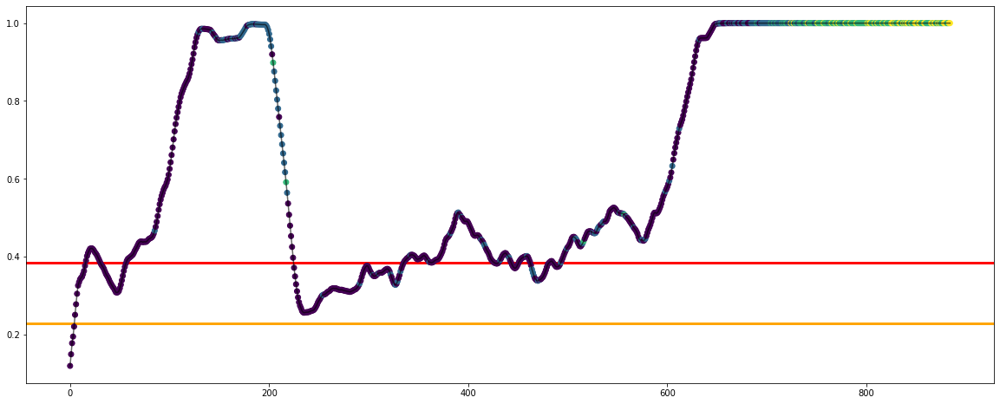

Experiment: 2_20151106_noon
Best Model:
	Score: -21.8765
	Hyperparameters: {'algorithm': 'full', 'init': 'k-means++', 'max_iter': 329, 'n_clusters': 4, 'n_init': 16, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.3959
	Calinski-Harabasz Index: 441.7271
	Davies Bouldin Index: 1.2355


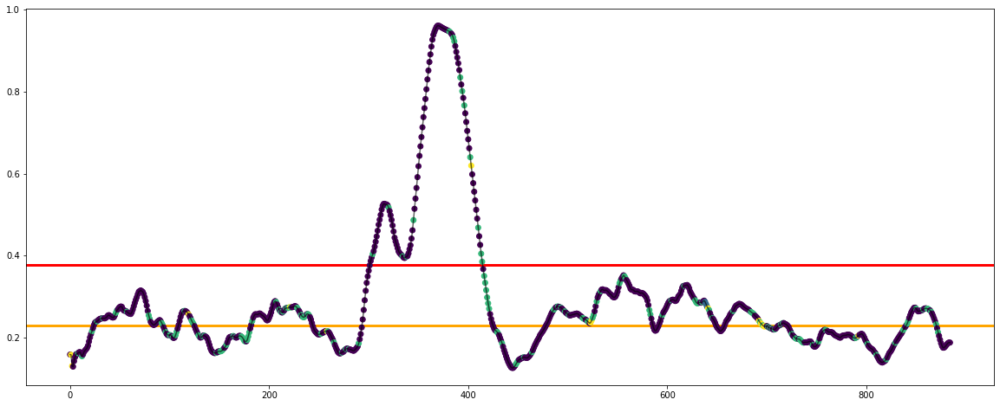

Experiment: 3_20151024_noon
Best Model:
	Score: -56.6614
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.1358
	Calinski-Harabasz Index: 175.7015
	Davies Bouldin Index: 1.8460


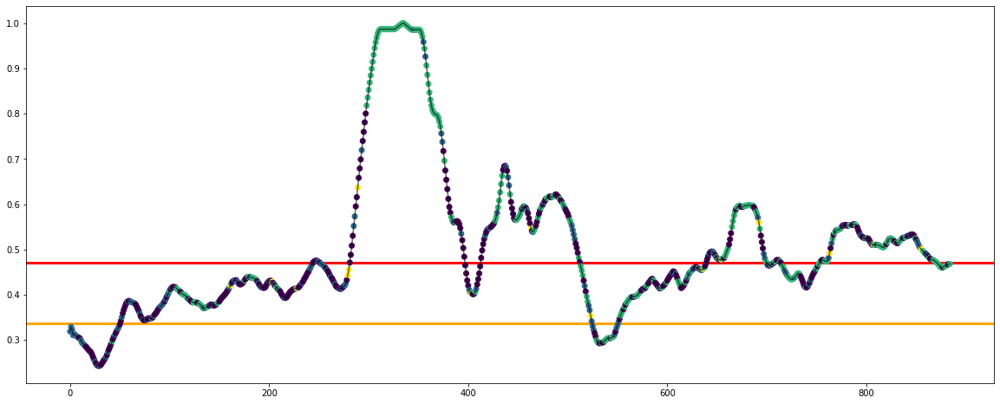

Experiment: 4_20151105_noon
Best Model:
	Score: -78.9416
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.1891
	Calinski-Harabasz Index: 307.5506
	Davies Bouldin Index: 1.7460


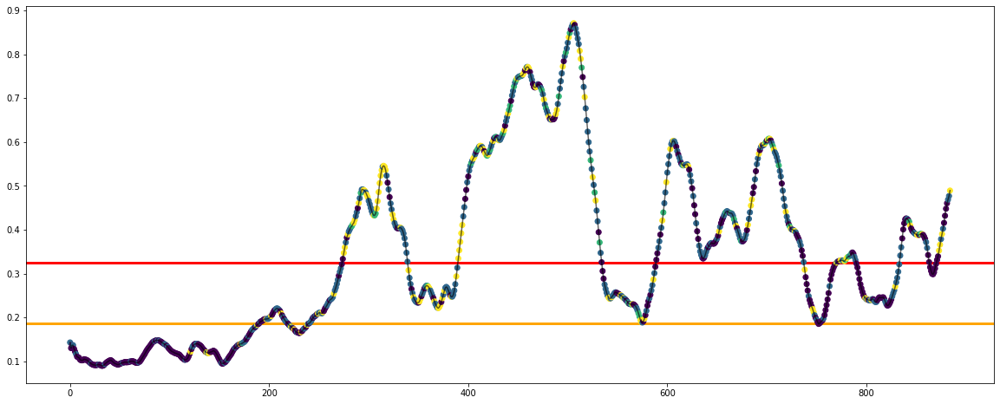

Experiment: 4_20151107_noon
Best Model:
	Score: -97.0604
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.1706
	Calinski-Harabasz Index: 334.5573
	Davies Bouldin Index: 1.7006


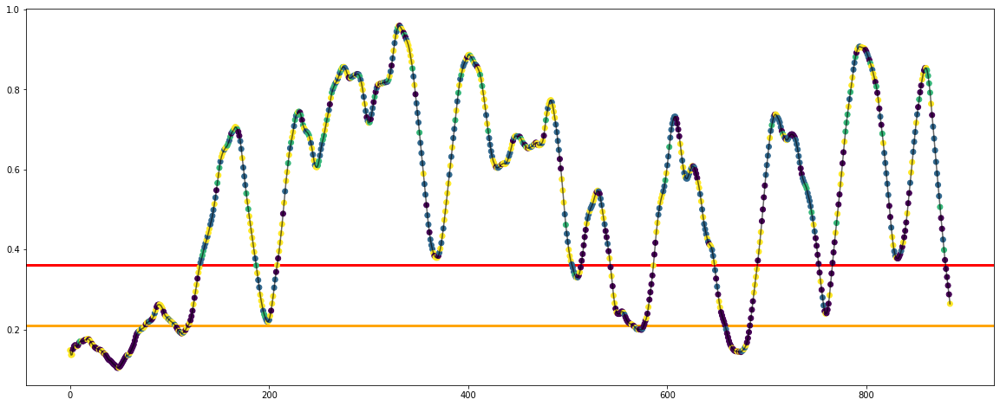

Experiment: 5_20141108_noon
Best Model:
	Score: -57.1523
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.2433
	Calinski-Harabasz Index: 250.3527
	Davies Bouldin Index: 1.6605


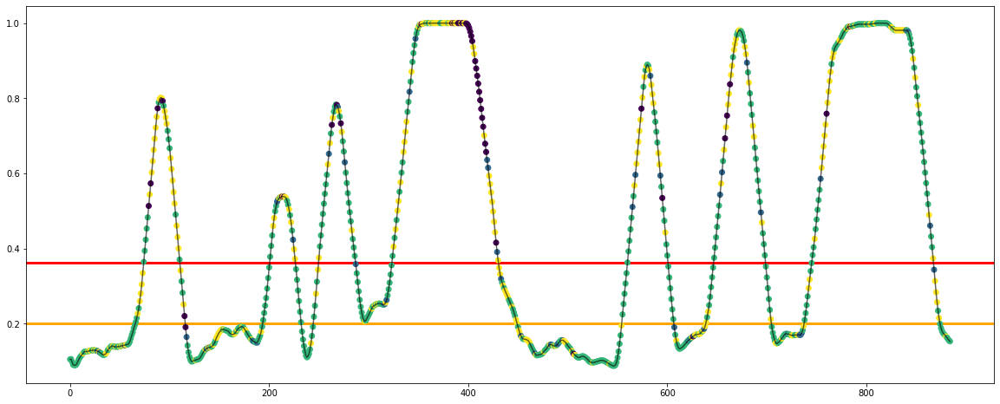

Experiment: 5_20151012_night
Best Model:
	Score: -48.6133
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.2979
	Calinski-Harabasz Index: 195.3145
	Davies Bouldin Index: 1.4909


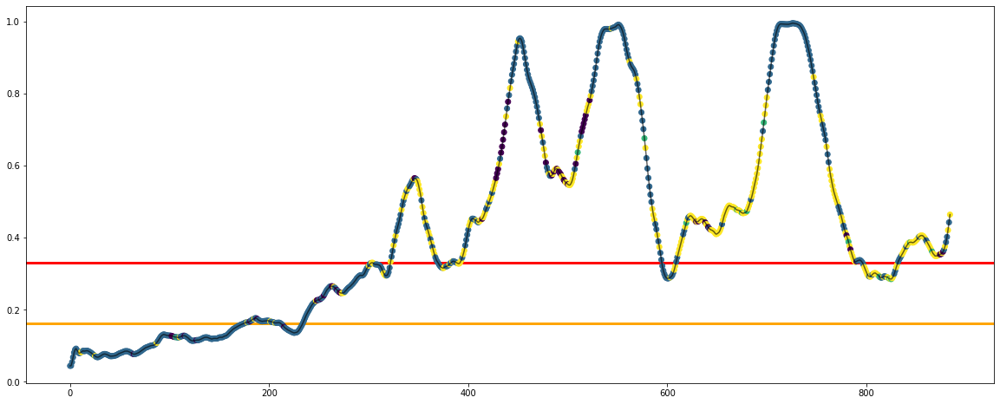

Experiment: 6_20151121_noon
Best Model:
	Score: -49.0385
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.2572
	Calinski-Harabasz Index: 171.8807
	Davies Bouldin Index: 2.0709


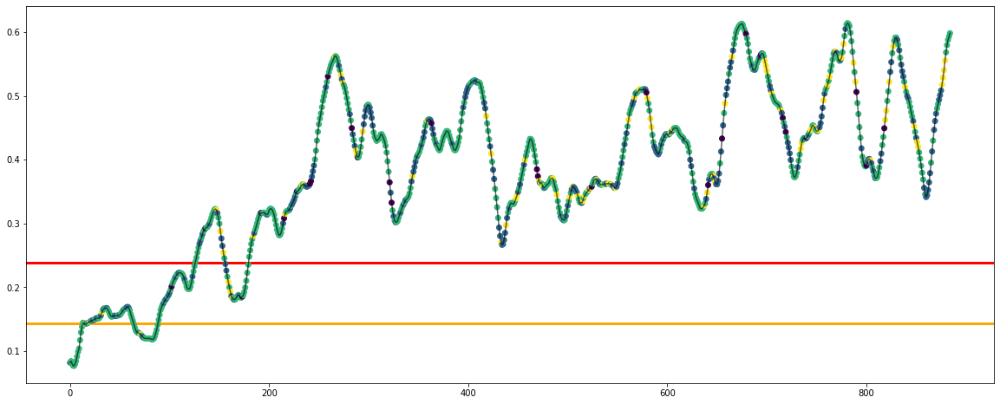

Experiment: 7_20151015_night
Best Model:
	Score: -53.4835
	Hyperparameters: {'algorithm': 'full', 'init': 'k-means++', 'max_iter': 329, 'n_clusters': 4, 'n_init': 16, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.1656
	Calinski-Harabasz Index: 161.6777
	Davies Bouldin Index: 1.4518


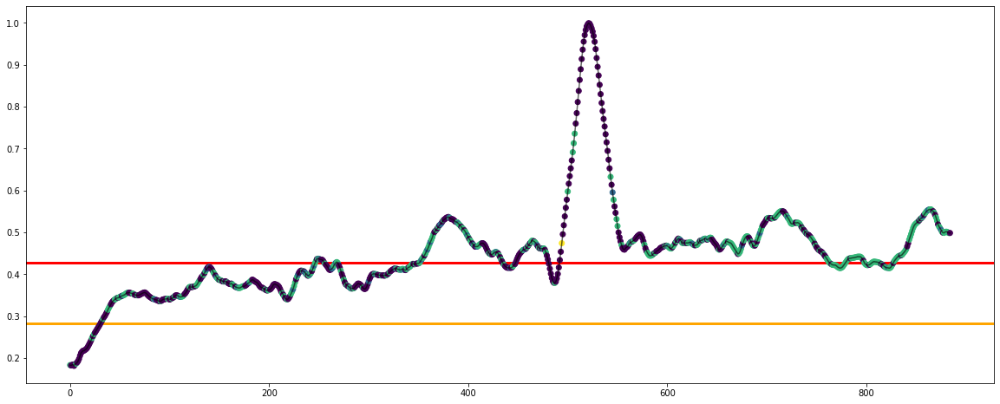

Experiment: 8_20151022_noon
Best Model:
	Score: -56.1566
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.2180
	Calinski-Harabasz Index: 258.1617
	Davies Bouldin Index: 1.7056


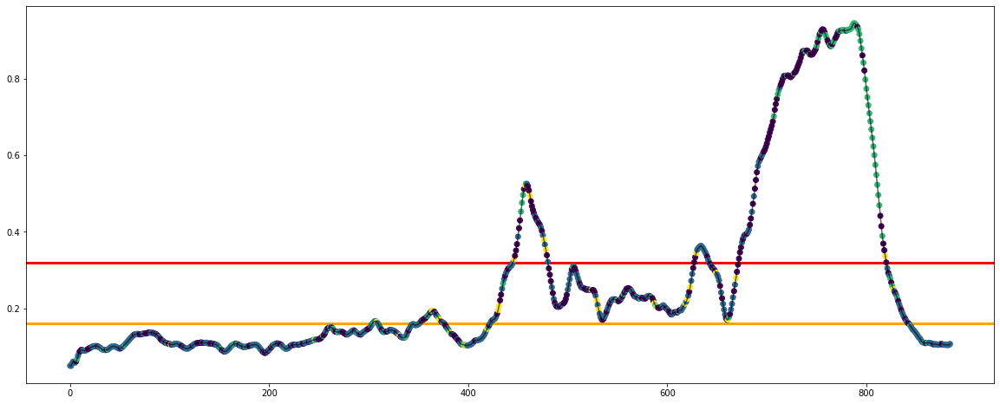

Experiment: 9_20151017_night
Best Model:
	Score: -37.1063
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.2095
	Calinski-Harabasz Index: 264.4888
	Davies Bouldin Index: 1.7232


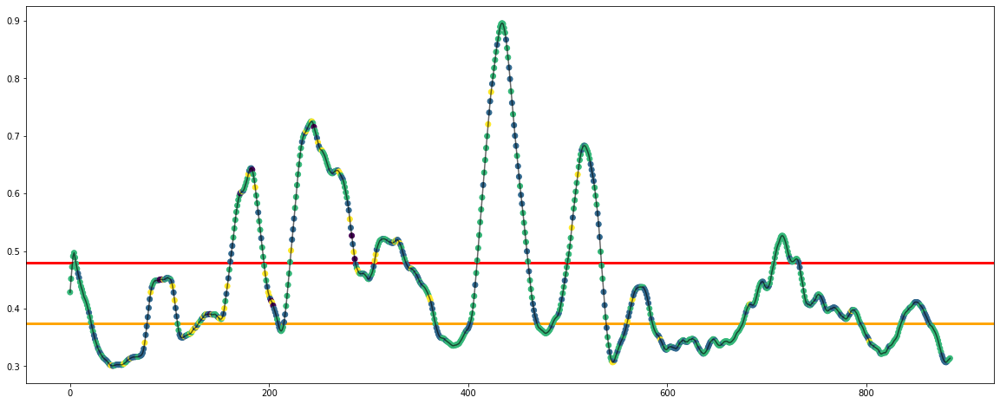

Experiment: 10_20151125_noon
Best Model:
	Score: -54.2614
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.2032
	Calinski-Harabasz Index: 246.5822
	Davies Bouldin Index: 1.5639


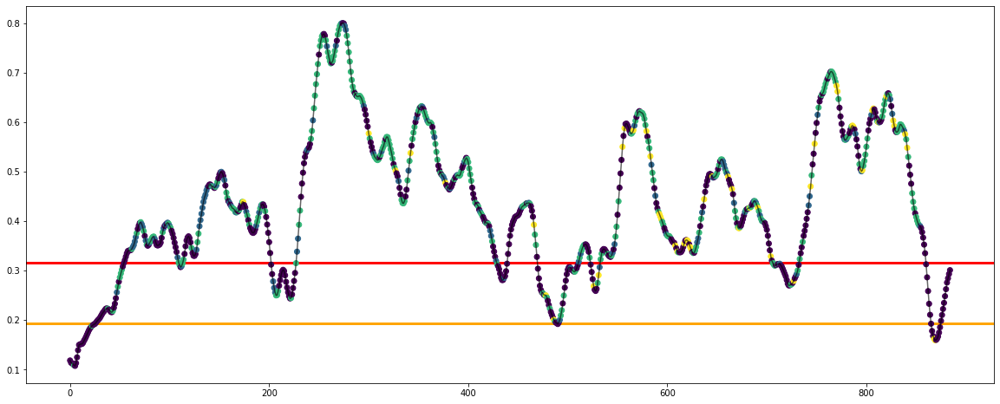

Experiment: 11_20151024_night
Best Model:
	Score: -48.6923
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.2025
	Calinski-Harabasz Index: 181.5814
	Davies Bouldin Index: 1.7443


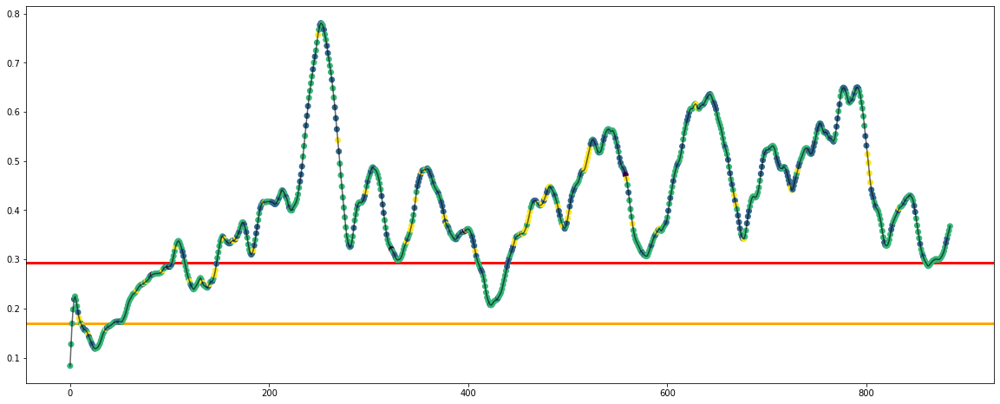

Experiment: 12_20150928_noon
Best Model:
	Score: -40.8470
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.3004
	Calinski-Harabasz Index: 371.0730
	Davies Bouldin Index: 1.4097


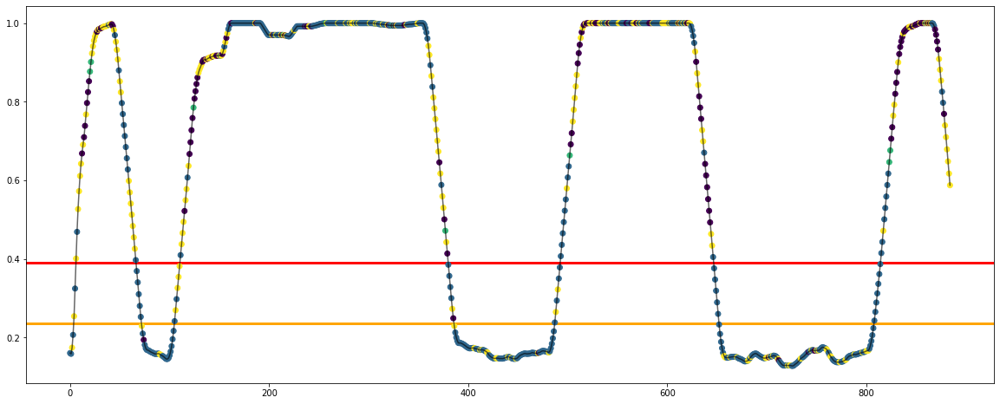

Experiment: 13_20150929_noon
Best Model:
	Score: -93.7324
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 258, 'n_clusters': 4, 'n_init': 14, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.2775
	Calinski-Harabasz Index: 378.8985
	Davies Bouldin Index: 1.3084


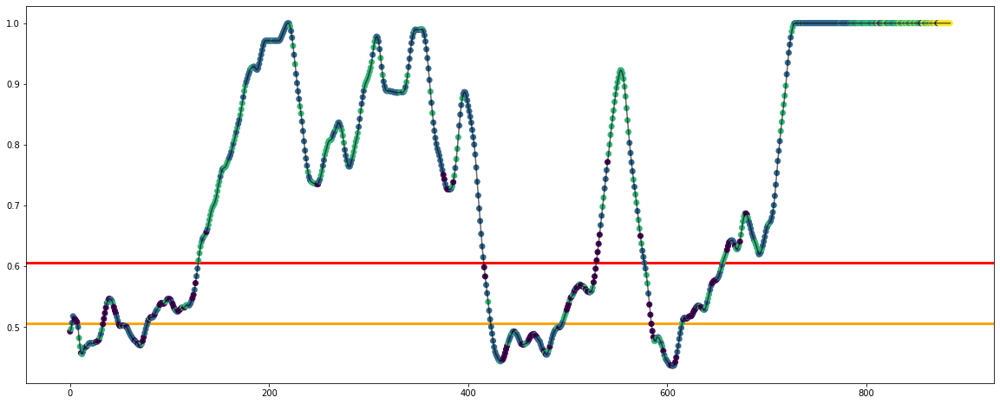

Experiment: 14_20151014_night
Best Model:
	Score: -50.0413
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.3259
	Calinski-Harabasz Index: 256.9023
	Davies Bouldin Index: 1.5734


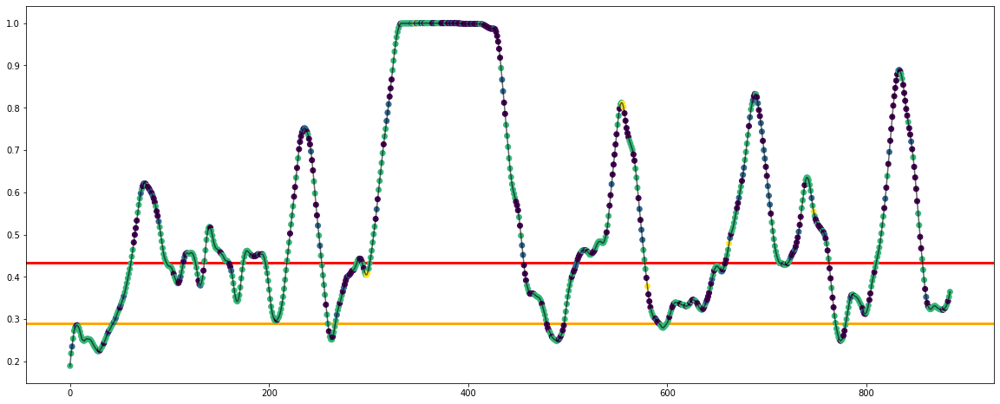

Experiment: 15_20151126_night
Best Model:
	Score: -53.4428
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.4082
	Calinski-Harabasz Index: 424.1478
	Davies Bouldin Index: 1.1631


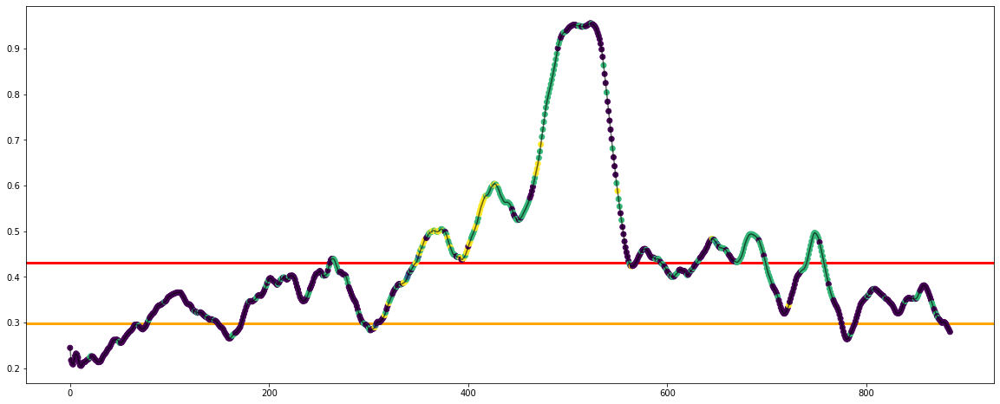

Experiment: 16_20151128_night
Best Model:
	Score: -42.7400
	Hyperparameters: {'algorithm': 'auto', 'init': 'random', 'max_iter': 374, 'n_clusters': 4, 'n_init': 18, 'tol': 0.001}

Cluestering evaluation:
	Silhouette Coefficient: 0.2744
	Calinski-Harabasz Index: 469.1585
	Davies Bouldin Index: 1.3259


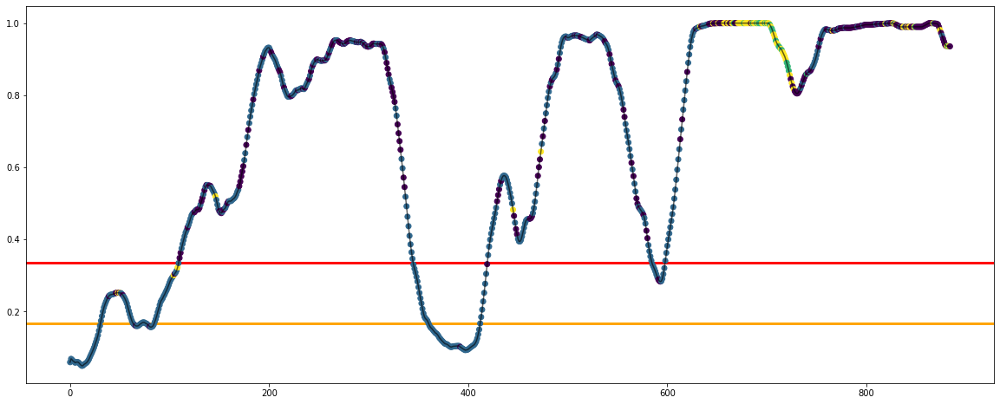

Experiment: 17_20150925_noon
Best Model:
	Score: -75.1637
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.1664
	Calinski-Harabasz Index: 259.5687
	Davies Bouldin Index: 1.7608


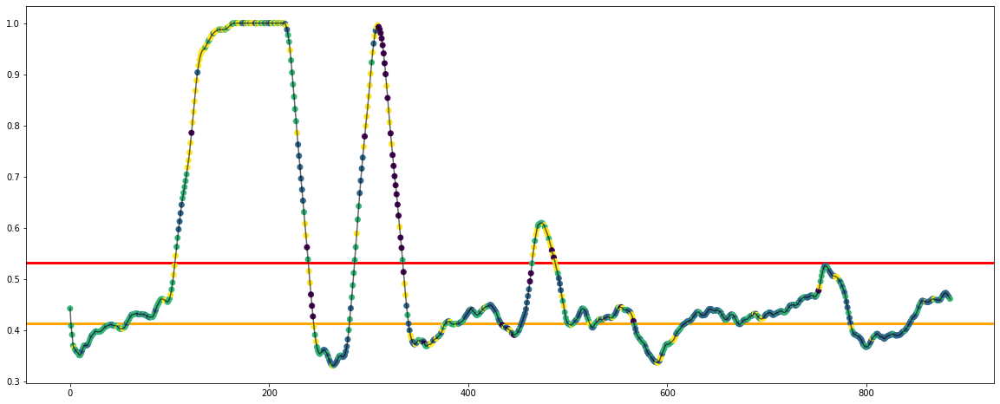

Experiment: 18_20150926_noon
Best Model:
	Score: -45.0916
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.3790
	Calinski-Harabasz Index: 326.6249
	Davies Bouldin Index: 1.3110


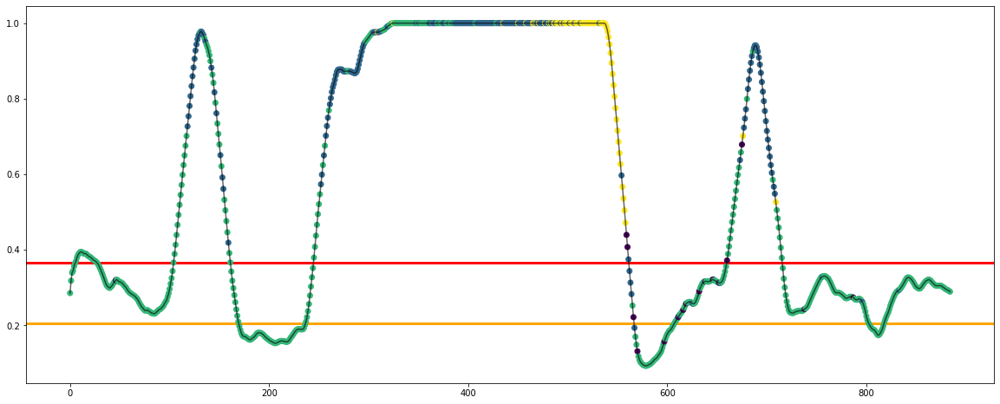

Experiment: 19_20151114_noon
Best Model:
	Score: -86.8731
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.1015
	Calinski-Harabasz Index: 186.0723
	Davies Bouldin Index: 2.3422


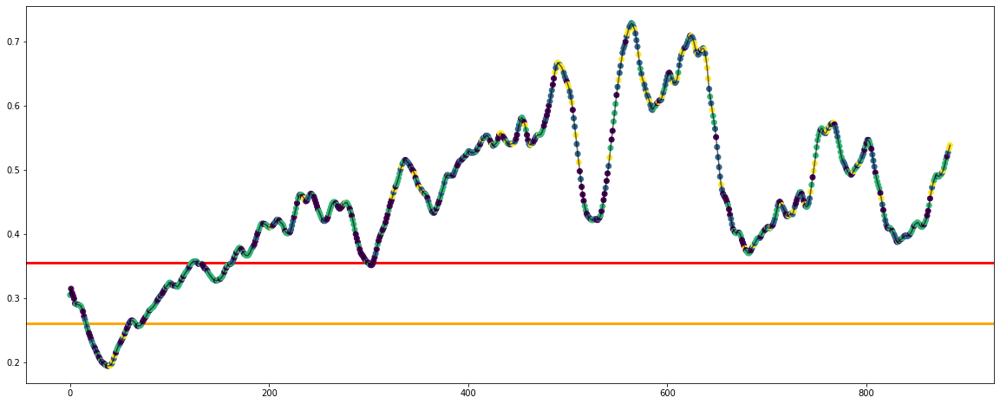

Experiment: 20_20151129_night
Best Model:
	Score: -57.2090
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.2530
	Calinski-Harabasz Index: 503.9082
	Davies Bouldin Index: 1.4123


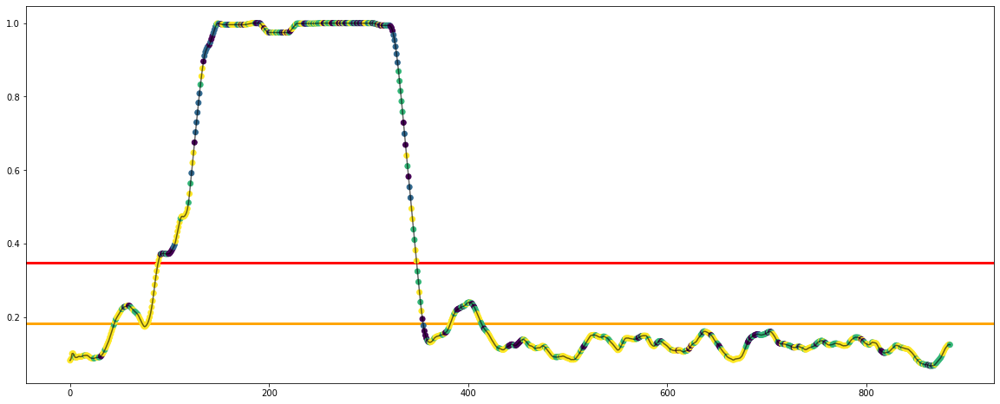

Experiment: 21_20151016_noon
Best Model:
	Score: -47.2723
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.4285
	Calinski-Harabasz Index: 258.9335
	Davies Bouldin Index: 1.4127


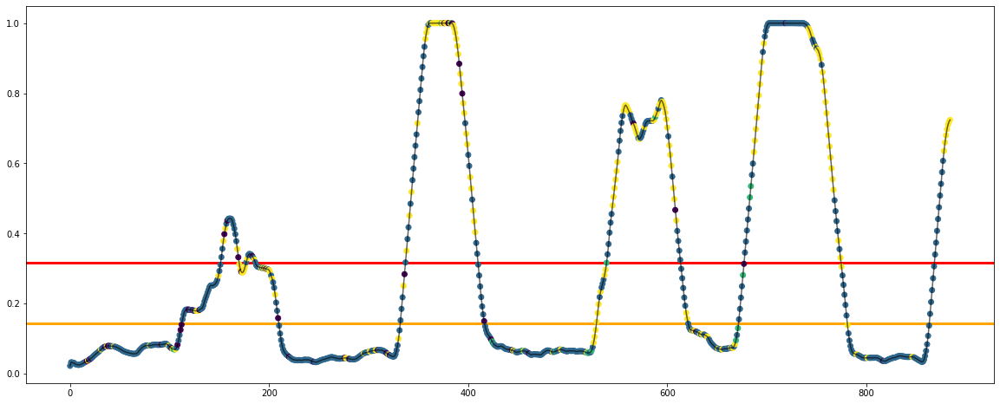

In [47]:
csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    X, y = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)
    
    print(f"Experiment: {key}")
    model = KMeans(random_state=42)

    space = dict()
    space['n_clusters'] = [2, 3, 4]
    space['init'] = ['k-means++', 'random']
    space['n_init'] = randint(5, 20)
    space['max_iter'] = randint(200, 400)
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['algorithm'] = ['auto', 'full', 'elkan']

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_minmax, y_all[key], model, space, cv=10, n_iter=20)
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_minmax, y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/KMeans-EEG.csv', index=False)

### PSD

Experiment: 1_20151124_noon_2
Best Model:
	Score: -3.3897
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.5795
	Calinski-Harabasz Index: 881.5995
	Davies Bouldin Index: 0.6913


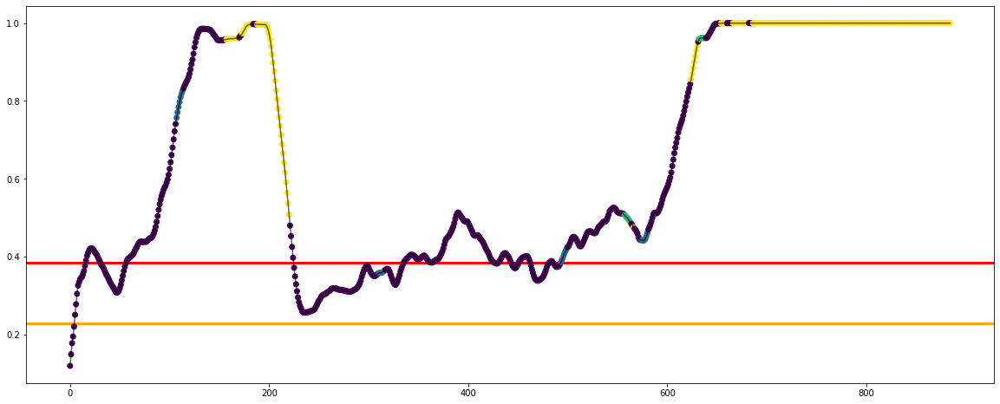

Experiment: 2_20151106_noon
Best Model:
	Score: -2.2132
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.4933
	Calinski-Harabasz Index: 832.5843
	Davies Bouldin Index: 1.0038


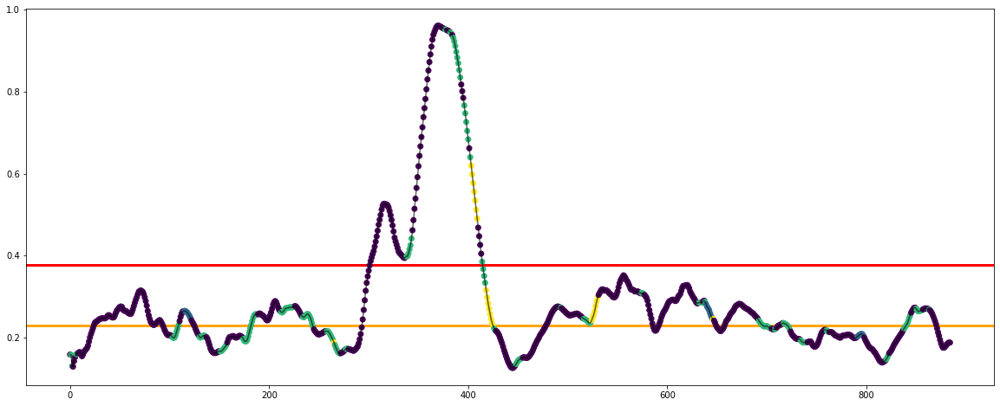

Experiment: 3_20151024_noon
Best Model:
	Score: -3.2348
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.4426
	Calinski-Harabasz Index: 918.8877
	Davies Bouldin Index: 0.7900


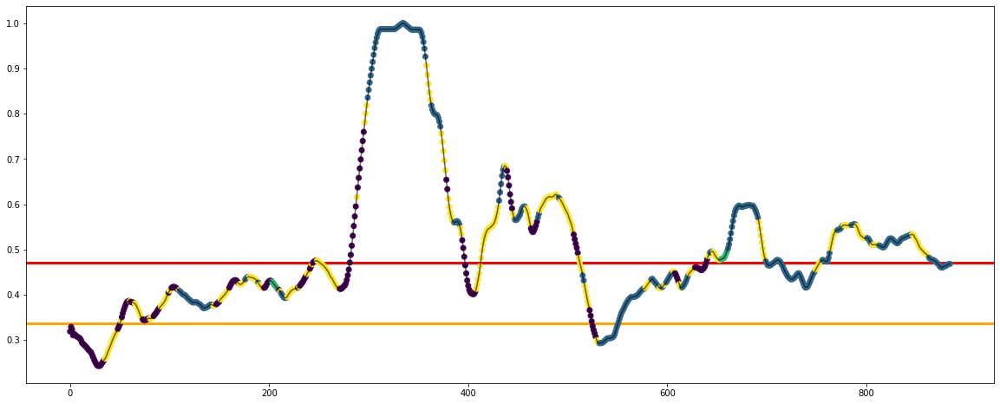

Experiment: 4_20151105_noon
Best Model:
	Score: -5.0033
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.3453
	Calinski-Harabasz Index: 567.5819
	Davies Bouldin Index: 1.0632


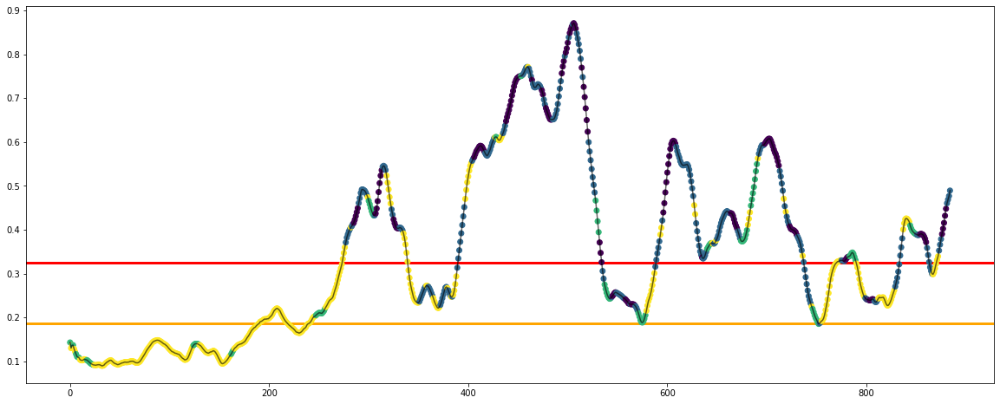

Experiment: 4_20151107_noon
Best Model:
	Score: -5.6168
	Hyperparameters: {'algorithm': 'auto', 'init': 'random', 'max_iter': 374, 'n_clusters': 4, 'n_init': 18, 'tol': 0.001}

Cluestering evaluation:
	Silhouette Coefficient: 0.3721
	Calinski-Harabasz Index: 478.9180
	Davies Bouldin Index: 1.0433


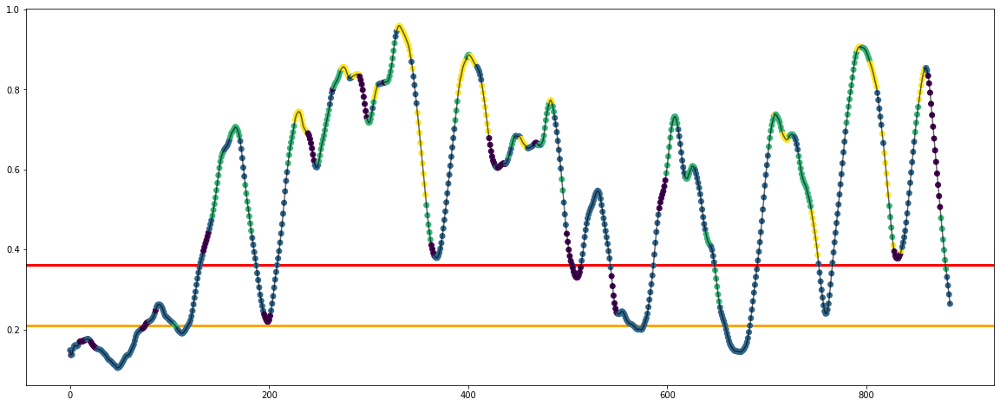

Experiment: 5_20141108_noon
Best Model:
	Score: -5.9900
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.5221
	Calinski-Harabasz Index: 377.2710
	Davies Bouldin Index: 0.8879


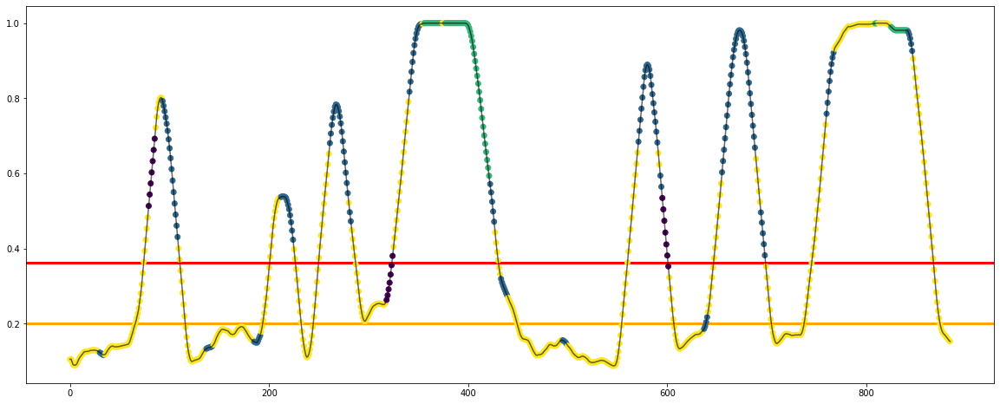

Experiment: 5_20151012_night
Best Model:
	Score: -3.1992
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.5810
	Calinski-Harabasz Index: 3376.1141
	Davies Bouldin Index: 0.5194


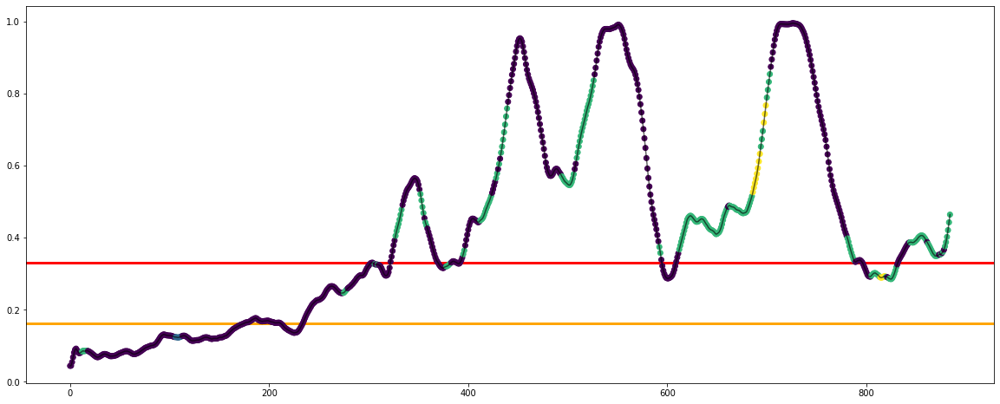

Experiment: 6_20151121_noon
Best Model:
	Score: -3.1936
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.8281
	Calinski-Harabasz Index: 1743.4484
	Davies Bouldin Index: 0.4132


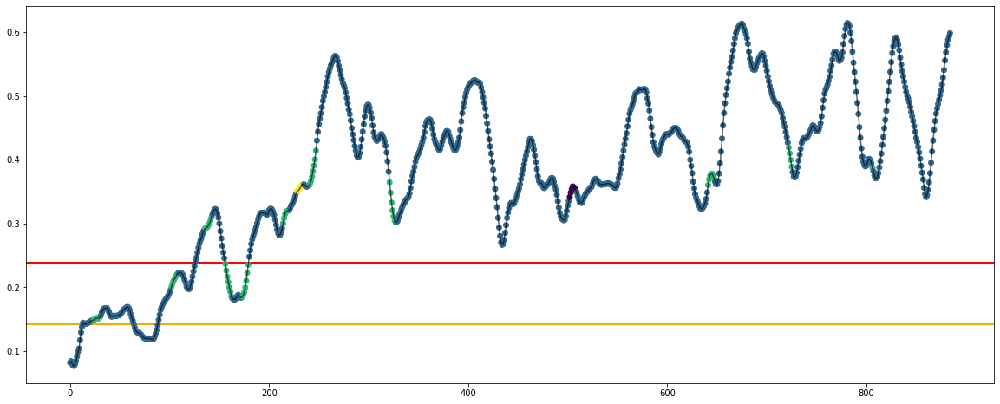

Experiment: 7_20151015_night
Best Model:
	Score: -4.1028
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.4164
	Calinski-Harabasz Index: 673.3647
	Davies Bouldin Index: 0.8009


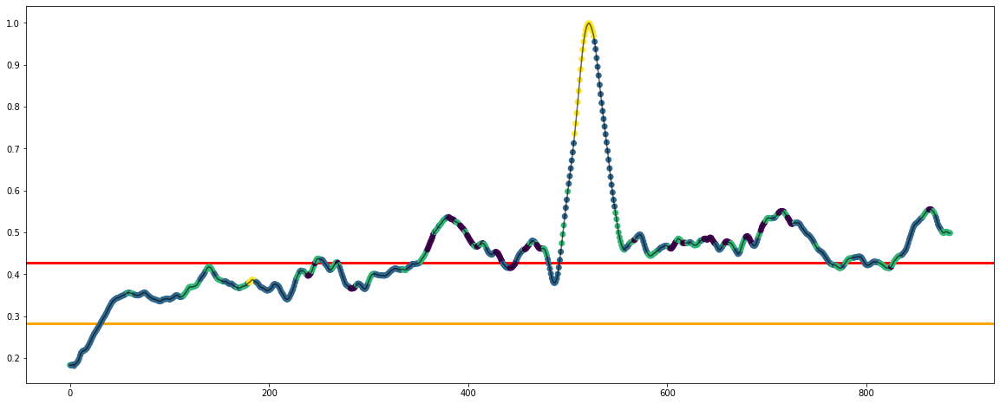

Experiment: 8_20151022_noon
Best Model:
	Score: -2.4342
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.9579
	Calinski-Harabasz Index: 13291.9910
	Davies Bouldin Index: 0.4896


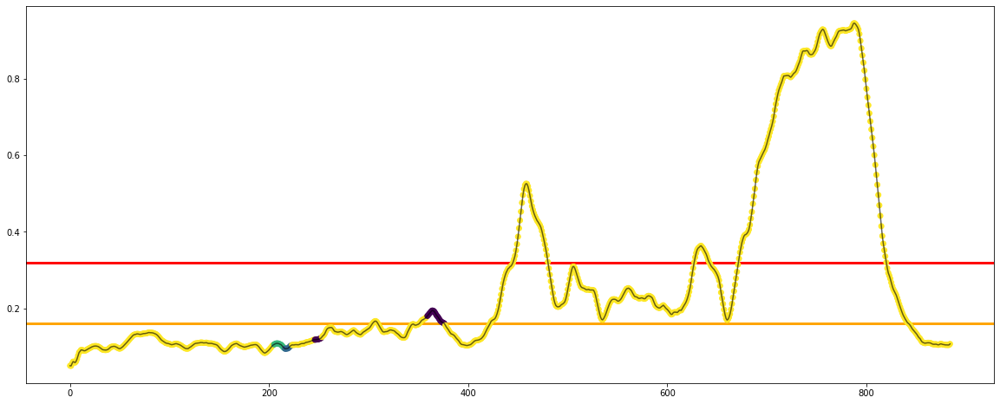

Experiment: 9_20151017_night
Best Model:
	Score: -3.4582
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.7352
	Calinski-Harabasz Index: 862.0988
	Davies Bouldin Index: 0.7303


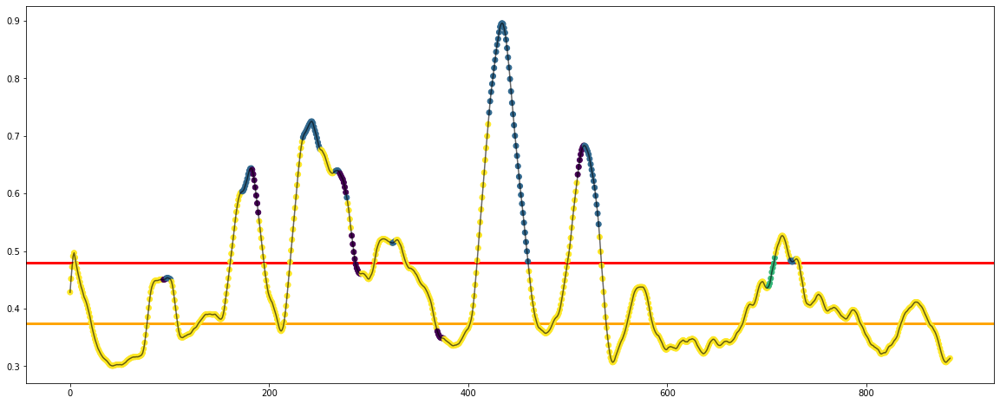

Experiment: 10_20151125_noon
Best Model:
	Score: -3.0740
	Hyperparameters: {'algorithm': 'auto', 'init': 'random', 'max_iter': 374, 'n_clusters': 4, 'n_init': 18, 'tol': 0.001}

Cluestering evaluation:
	Silhouette Coefficient: 0.6103
	Calinski-Harabasz Index: 7218.1267
	Davies Bouldin Index: 0.6990


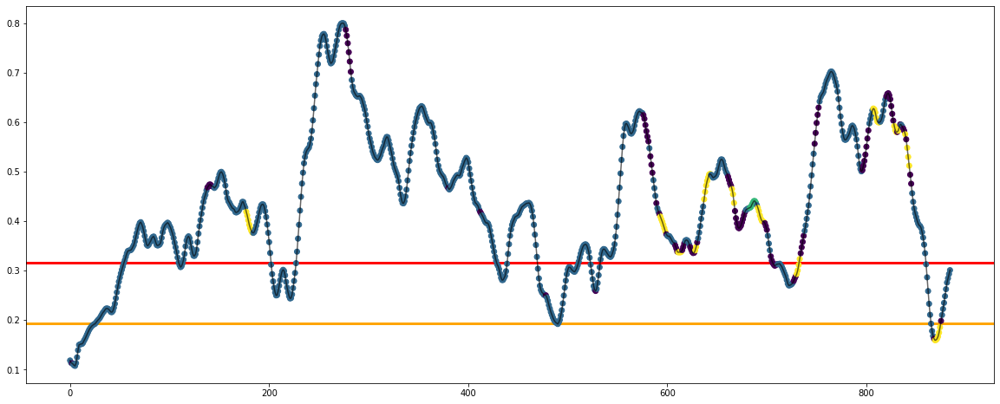

Experiment: 11_20151024_night
Best Model:
	Score: -4.8027
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.4268
	Calinski-Harabasz Index: 456.6504
	Davies Bouldin Index: 0.8883


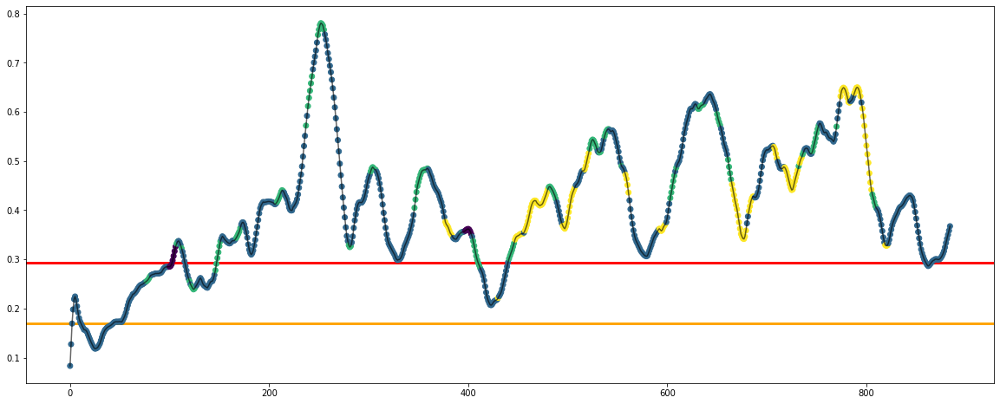

Experiment: 12_20150928_noon
Best Model:
	Score: -5.6976
	Hyperparameters: {'algorithm': 'full', 'init': 'random', 'max_iter': 203, 'n_clusters': 3, 'n_init': 17, 'tol': 0.005}

Cluestering evaluation:
	Silhouette Coefficient: 0.4878
	Calinski-Harabasz Index: 690.7652
	Davies Bouldin Index: 0.7559


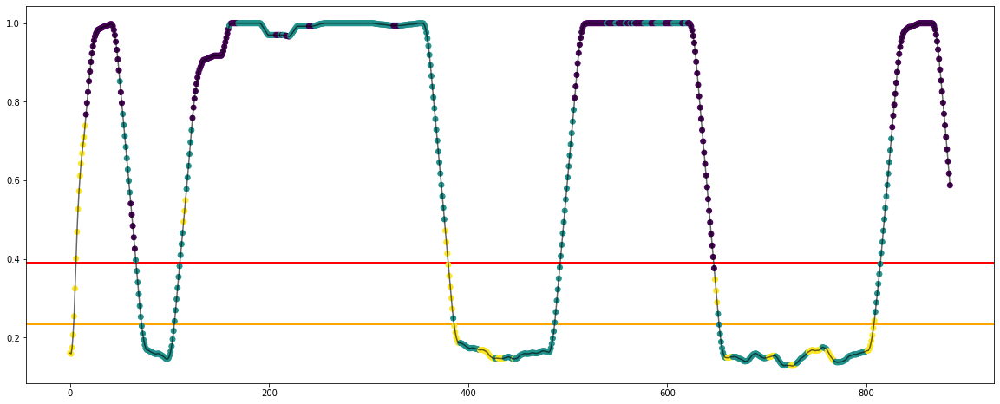

Experiment: 13_20150929_noon
Best Model:
	Score: -5.9285
	Hyperparameters: {'algorithm': 'auto', 'init': 'random', 'max_iter': 374, 'n_clusters': 4, 'n_init': 18, 'tol': 0.001}

Cluestering evaluation:
	Silhouette Coefficient: 0.5317
	Calinski-Harabasz Index: 737.4453
	Davies Bouldin Index: 0.6164


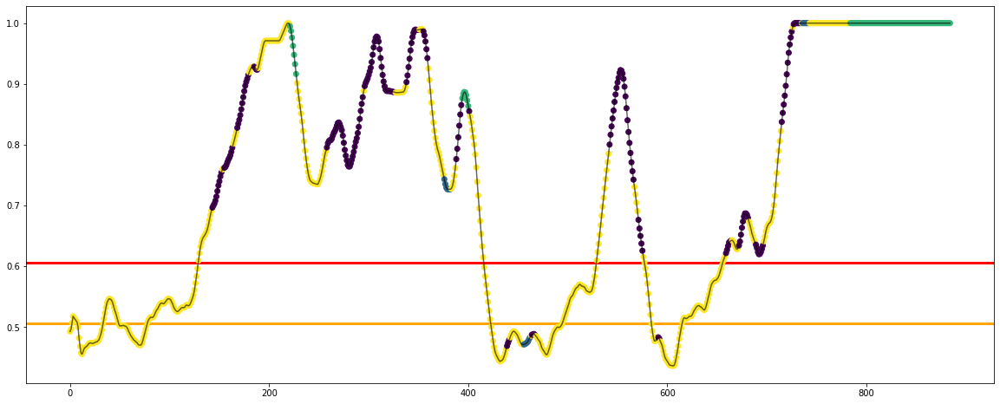

Experiment: 14_20151014_night
Best Model:
	Score: -6.2119
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.5913
	Calinski-Harabasz Index: 673.1830
	Davies Bouldin Index: 0.7876


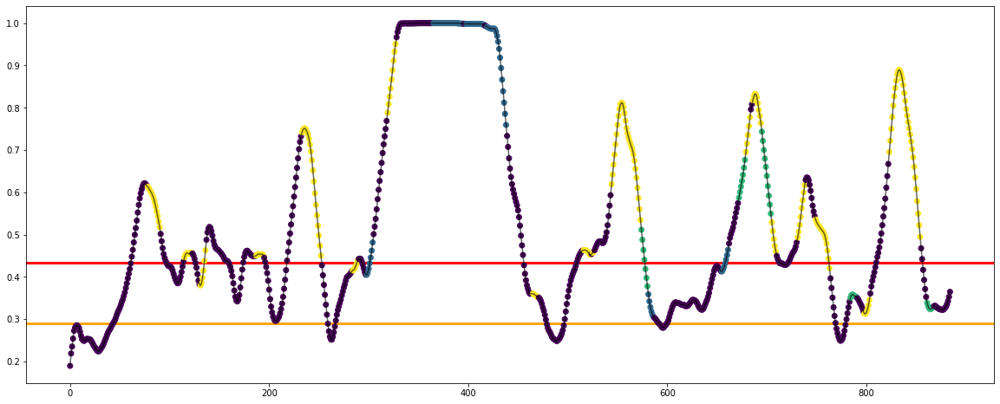

Experiment: 15_20151126_night
Best Model:
	Score: -3.2239
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 356, 'n_clusters': 4, 'n_init': 17, 'tol': 0.001}

Cluestering evaluation:
	Silhouette Coefficient: 0.4968
	Calinski-Harabasz Index: 2209.7050
	Davies Bouldin Index: 0.6666


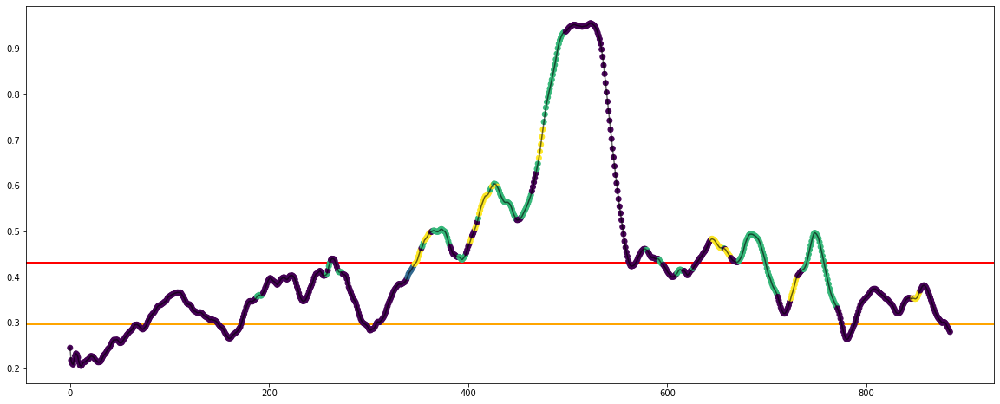

Experiment: 16_20151128_night
Best Model:
	Score: -3.1838
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.8256
	Calinski-Harabasz Index: 37599.5729
	Davies Bouldin Index: 0.3063


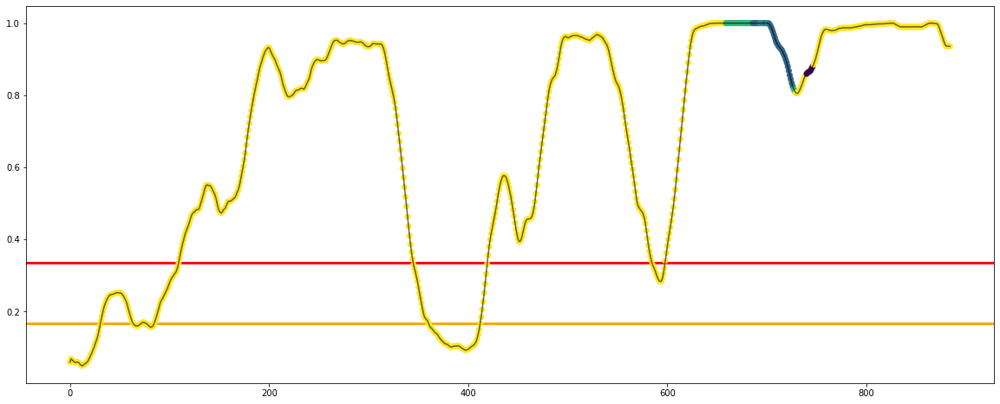

Experiment: 17_20150925_noon
Best Model:
	Score: -4.1018
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 356, 'n_clusters': 4, 'n_init': 17, 'tol': 0.001}

Cluestering evaluation:
	Silhouette Coefficient: 0.5482
	Calinski-Harabasz Index: 821.9353
	Davies Bouldin Index: 0.6586


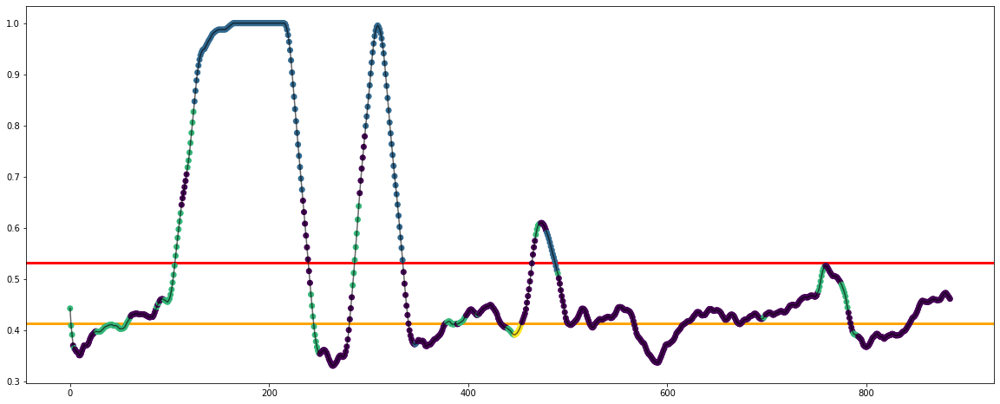

Experiment: 18_20150926_noon
Best Model:
	Score: -3.1237
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.7485
	Calinski-Harabasz Index: 1297.2008
	Davies Bouldin Index: 0.4881


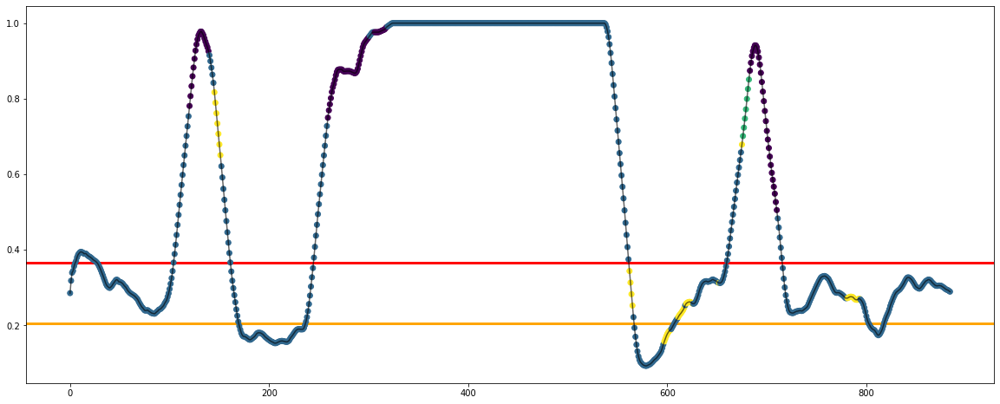

Experiment: 19_20151114_noon
Best Model:
	Score: -3.1604
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 258, 'n_clusters': 4, 'n_init': 14, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.4396
	Calinski-Harabasz Index: 4567.5399
	Davies Bouldin Index: 0.6406


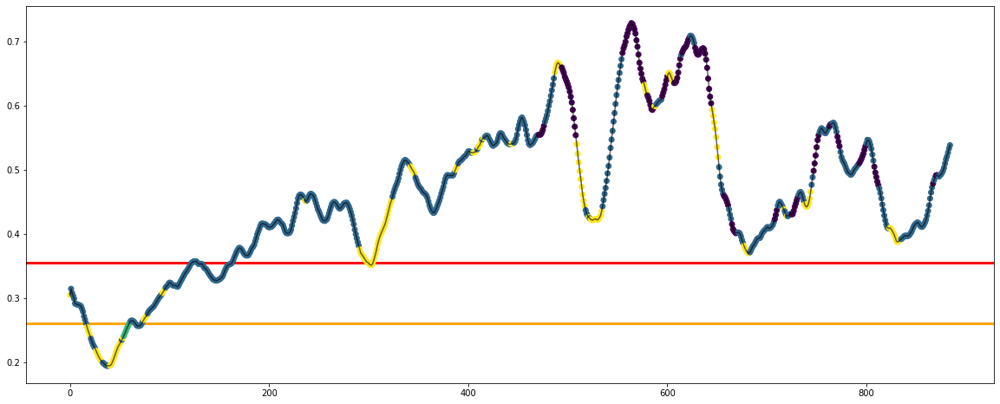

Experiment: 20_20151129_night
Best Model:
	Score: -3.7908
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 356, 'n_clusters': 4, 'n_init': 17, 'tol': 0.001}

Cluestering evaluation:
	Silhouette Coefficient: 0.5714
	Calinski-Harabasz Index: 1343.6829
	Davies Bouldin Index: 0.5932


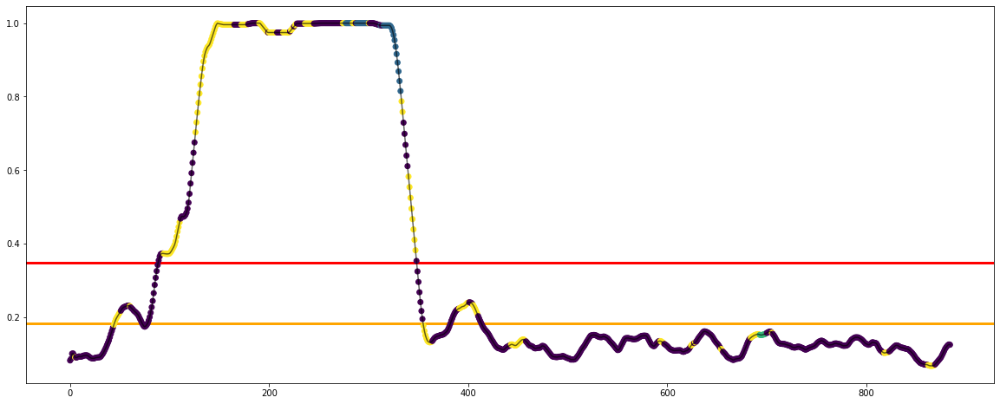

Experiment: 21_20151016_noon
Best Model:
	Score: -5.3324
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.6322
	Calinski-Harabasz Index: 547.3352
	Davies Bouldin Index: 0.8278


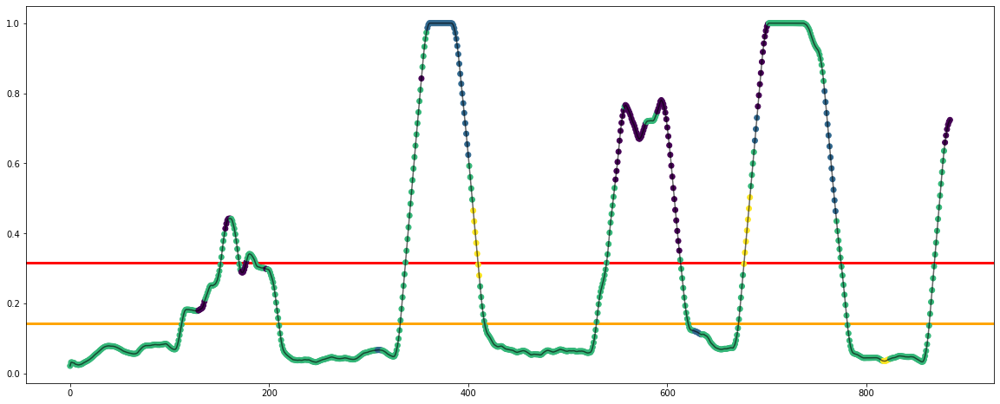

In [26]:
csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = KMeans(random_state=42)

    space = dict()
    space['n_clusters'] = [2, 3, 4]
    space['init'] = ['k-means++', 'random']
    space['n_init'] = randint(5, 20)
    space['max_iter'] = randint(200, 400)
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['algorithm'] = ['auto', 'full', 'elkan']

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all[key], y_all[key], model, space, cv=10, n_iter=20)
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/KMeans-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2
Best Model:
	Score: -5.7858
	Hyperparameters: {'algorithm': 'auto', 'init': 'random', 'max_iter': 374, 'n_clusters': 4, 'n_init': 18, 'tol': 0.001}

Cluestering evaluation:
	Silhouette Coefficient: 0.4390
	Calinski-Harabasz Index: 549.1419
	Davies Bouldin Index: 0.8038


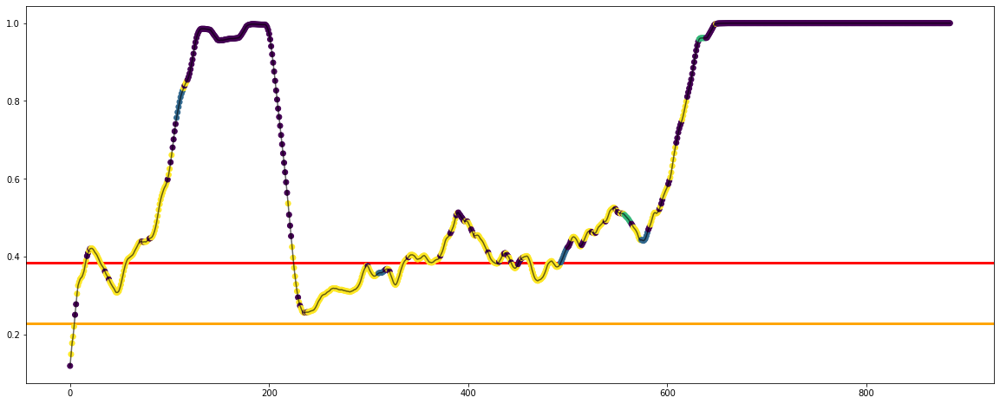

Experiment: 2_20151106_noon
Best Model:
	Score: -3.4657
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.4551
	Calinski-Harabasz Index: 747.4113
	Davies Bouldin Index: 0.6511


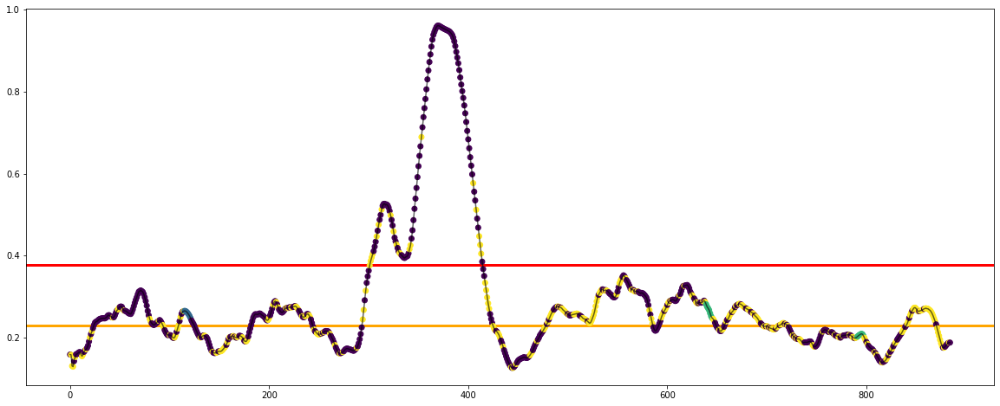

Experiment: 3_20151024_noon
Best Model:
	Score: -5.4118
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.3782
	Calinski-Harabasz Index: 519.9178
	Davies Bouldin Index: 0.9314


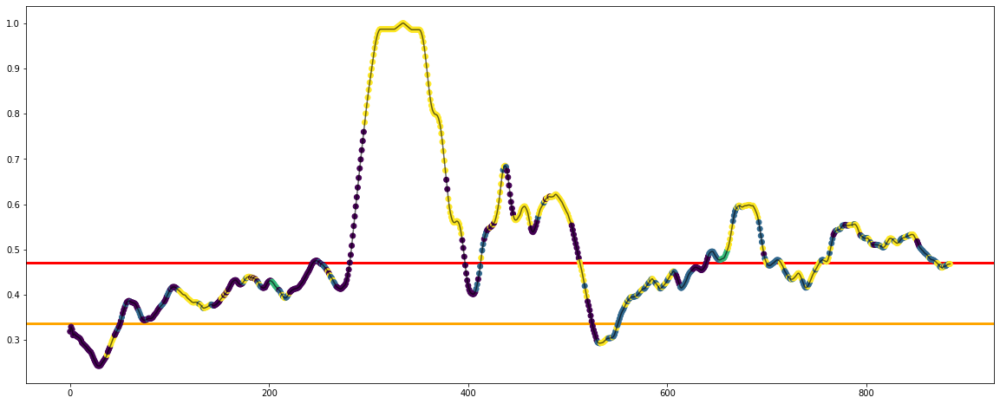

Experiment: 4_20151105_noon
Best Model:
	Score: -7.7005
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.3051
	Calinski-Harabasz Index: 387.8774
	Davies Bouldin Index: 1.0737


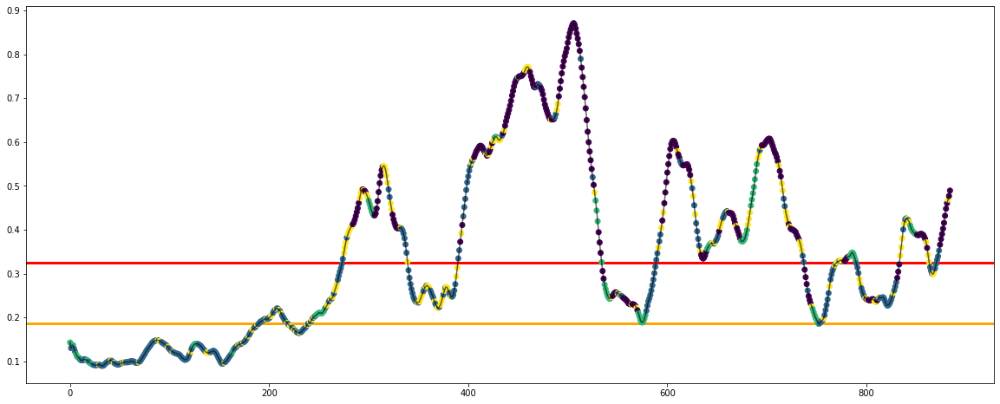

Experiment: 4_20151107_noon
Best Model:
	Score: -7.8656
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.2895
	Calinski-Harabasz Index: 364.2791
	Davies Bouldin Index: 1.1913


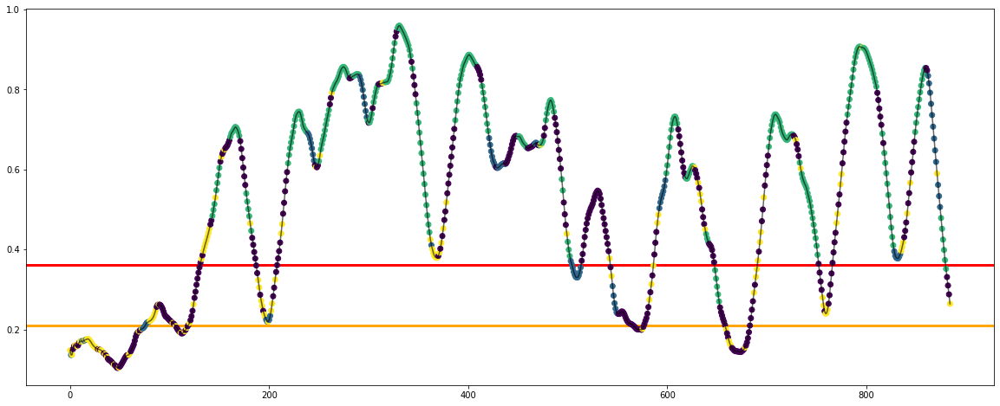

Experiment: 5_20141108_noon
Best Model:
	Score: -6.9041
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.3547
	Calinski-Harabasz Index: 292.8675
	Davies Bouldin Index: 1.0952


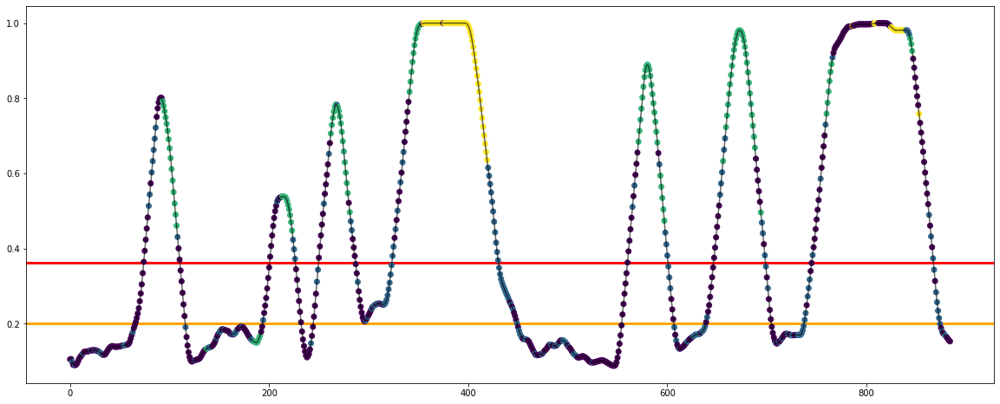

Experiment: 5_20151012_night
Best Model:
	Score: -4.4932
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.4577
	Calinski-Harabasz Index: 1425.1753
	Davies Bouldin Index: 0.6281


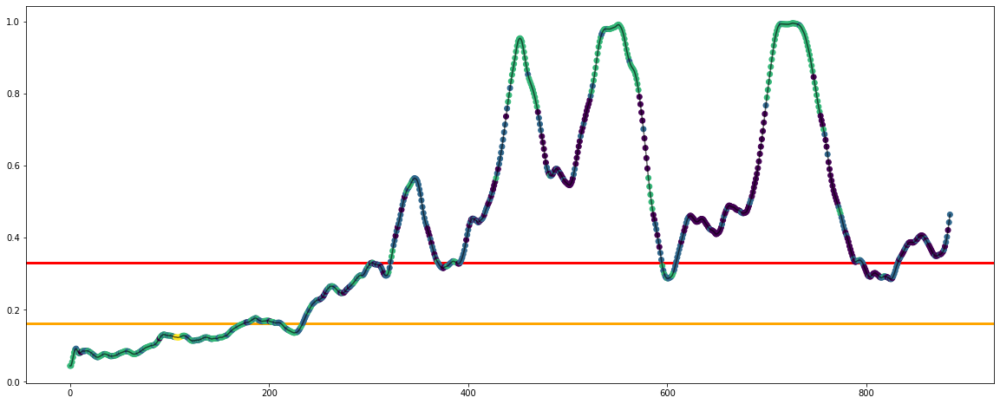

Experiment: 6_20151121_noon
Best Model:
	Score: -5.0984
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 258, 'n_clusters': 4, 'n_init': 14, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.5252
	Calinski-Harabasz Index: 618.0669
	Davies Bouldin Index: 0.7200


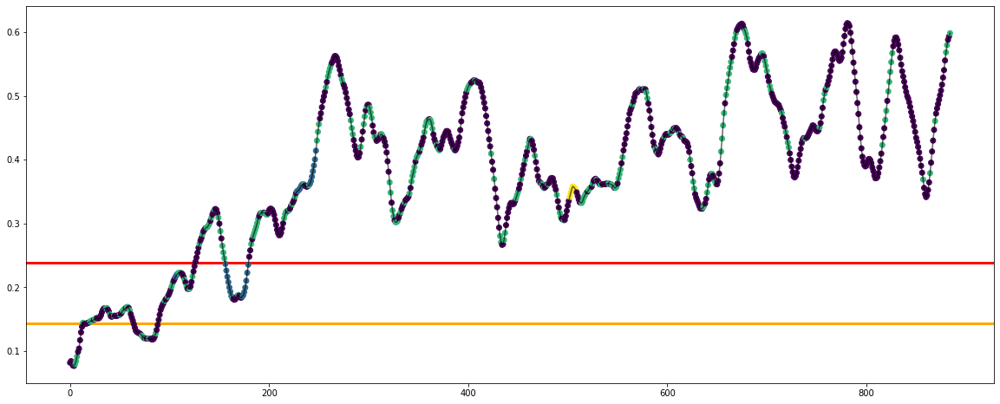

Experiment: 7_20151015_night
Best Model:
	Score: -6.3074
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.3071
	Calinski-Harabasz Index: 458.5529
	Davies Bouldin Index: 1.0096


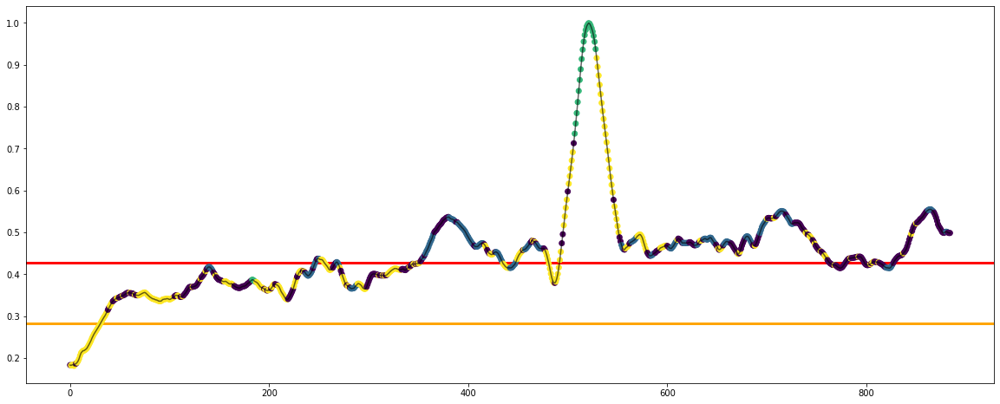

Experiment: 8_20151022_noon
Best Model:
	Score: -3.8410
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.6083
	Calinski-Harabasz Index: 1914.4799
	Davies Bouldin Index: 0.4647


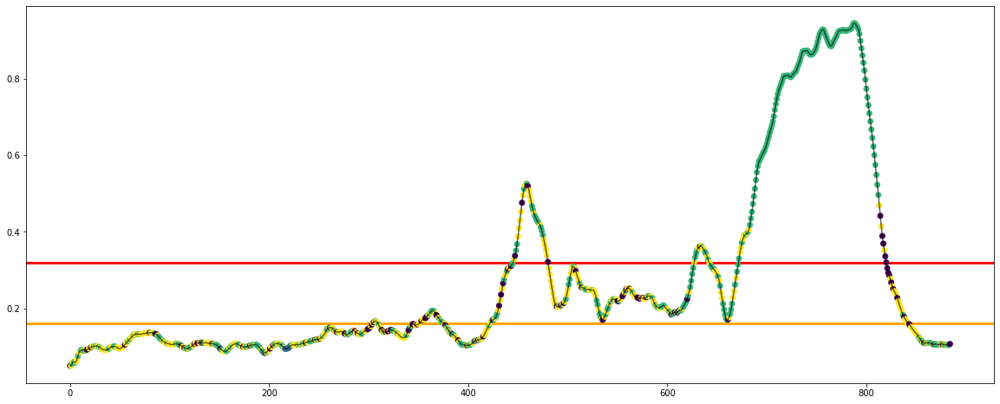

Experiment: 9_20151017_night
Best Model:
	Score: -5.6739
	Hyperparameters: {'algorithm': 'full', 'init': 'k-means++', 'max_iter': 329, 'n_clusters': 4, 'n_init': 16, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.4489
	Calinski-Harabasz Index: 553.7347
	Davies Bouldin Index: 0.7162


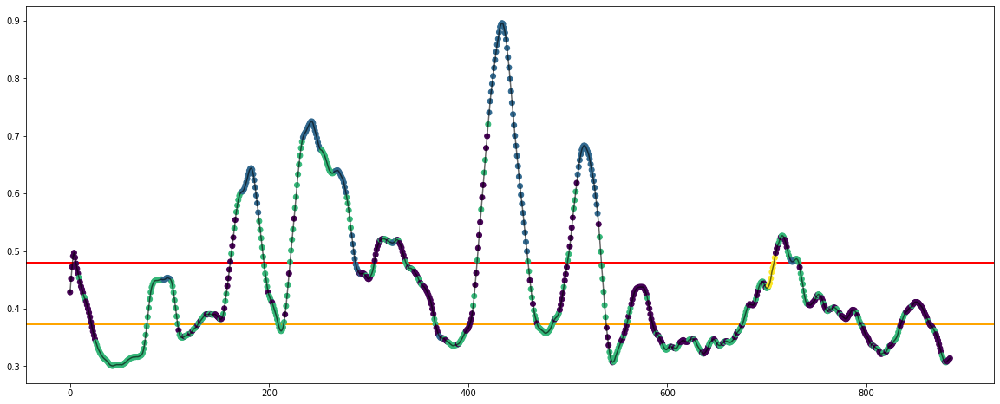

Experiment: 10_20151125_noon
Best Model:
	Score: -3.7201
	Hyperparameters: {'algorithm': 'full', 'init': 'k-means++', 'max_iter': 329, 'n_clusters': 4, 'n_init': 16, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.5081
	Calinski-Harabasz Index: 1843.4250
	Davies Bouldin Index: 0.6553


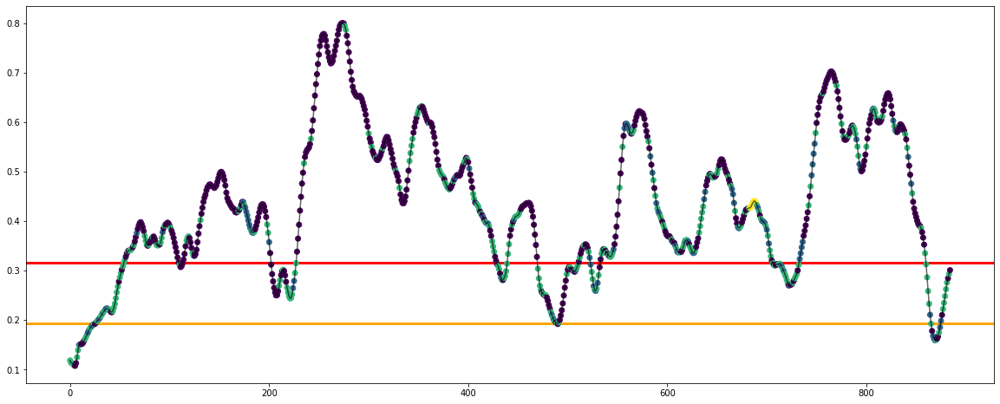

Experiment: 11_20151024_night
Best Model:
	Score: -6.4872
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 389, 'n_clusters': 4, 'n_init': 18, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.2951
	Calinski-Harabasz Index: 310.8230
	Davies Bouldin Index: 0.9959


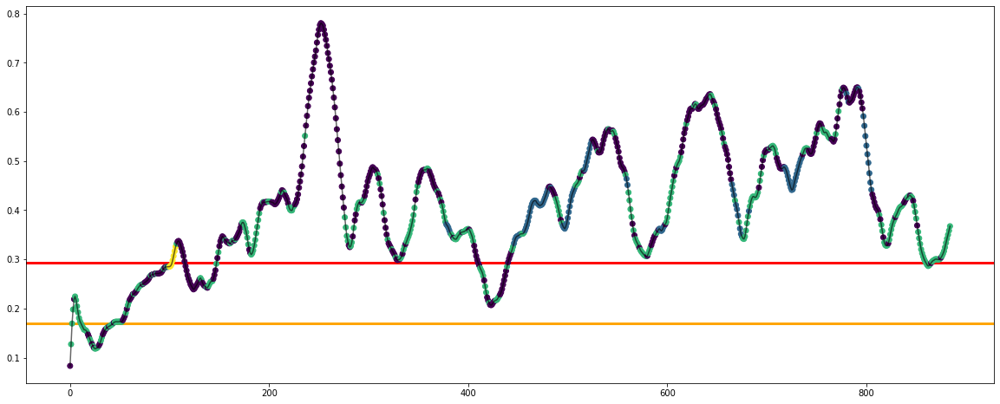

Experiment: 12_20150928_noon
Best Model:
	Score: -6.1279
	Hyperparameters: {'algorithm': 'full', 'init': 'k-means++', 'max_iter': 329, 'n_clusters': 4, 'n_init': 16, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.3936
	Calinski-Harabasz Index: 567.4960
	Davies Bouldin Index: 0.9336


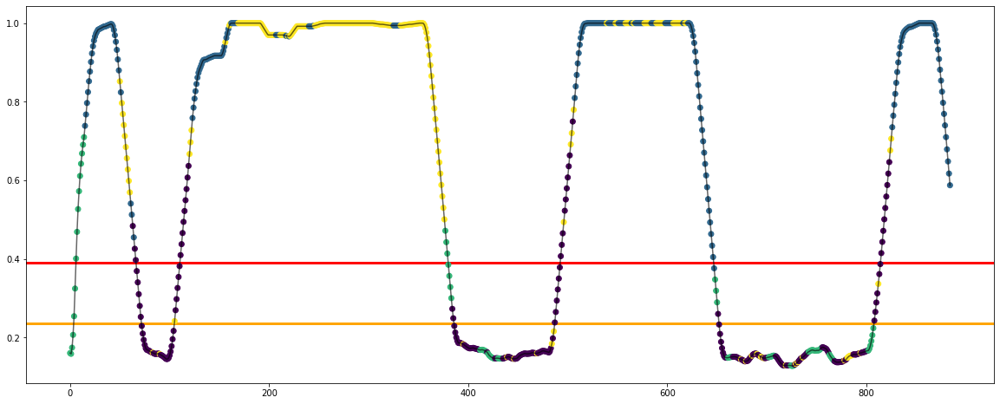

Experiment: 13_20150929_noon
Best Model:
	Score: -9.8378
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 258, 'n_clusters': 4, 'n_init': 14, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.4353
	Calinski-Harabasz Index: 483.5921
	Davies Bouldin Index: 0.7611


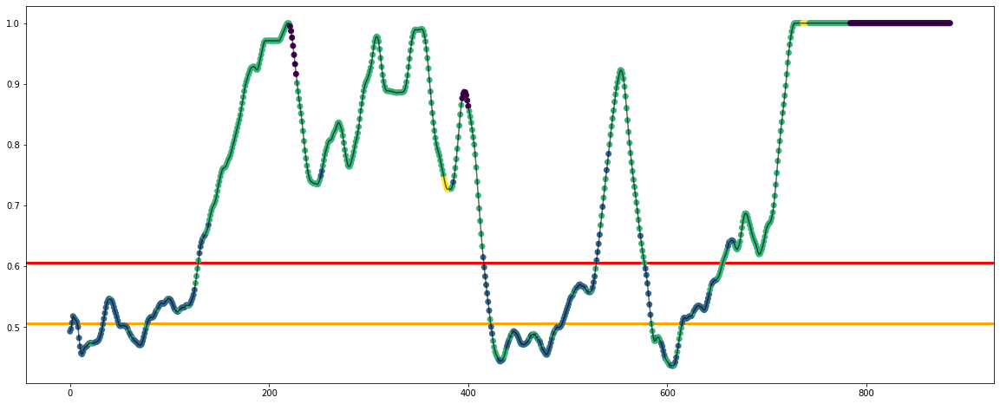

Experiment: 14_20151014_night
Best Model:
	Score: -8.6141
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.3839
	Calinski-Harabasz Index: 435.1507
	Davies Bouldin Index: 0.9388


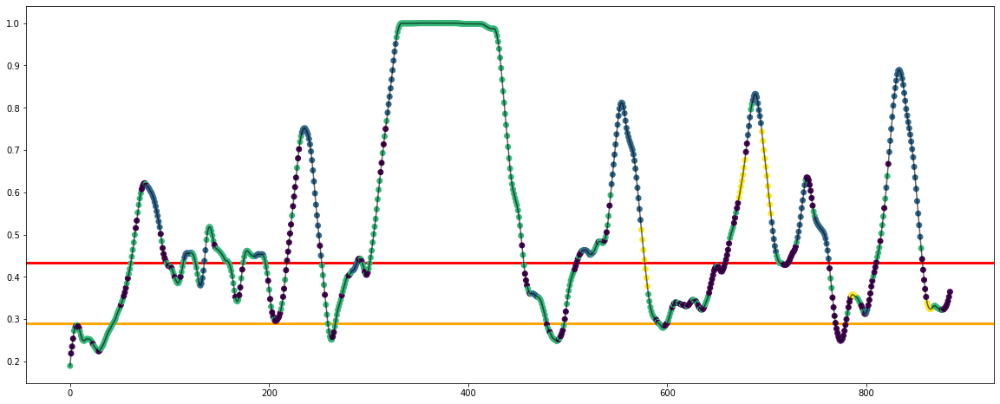

Experiment: 15_20151126_night
Best Model:
	Score: -4.4959
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.4363
	Calinski-Harabasz Index: 1121.3512
	Davies Bouldin Index: 0.6491


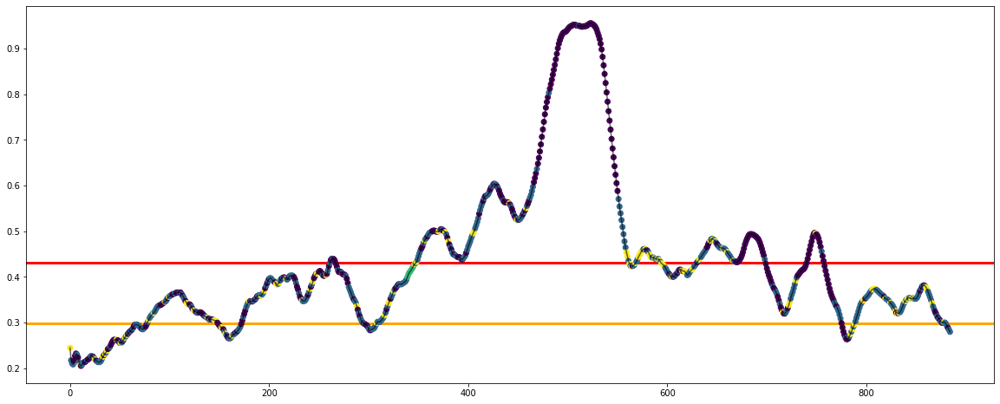

Experiment: 16_20151128_night
Best Model:
	Score: -3.5530
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.8678
	Calinski-Harabasz Index: 4005.5202
	Davies Bouldin Index: 0.2740


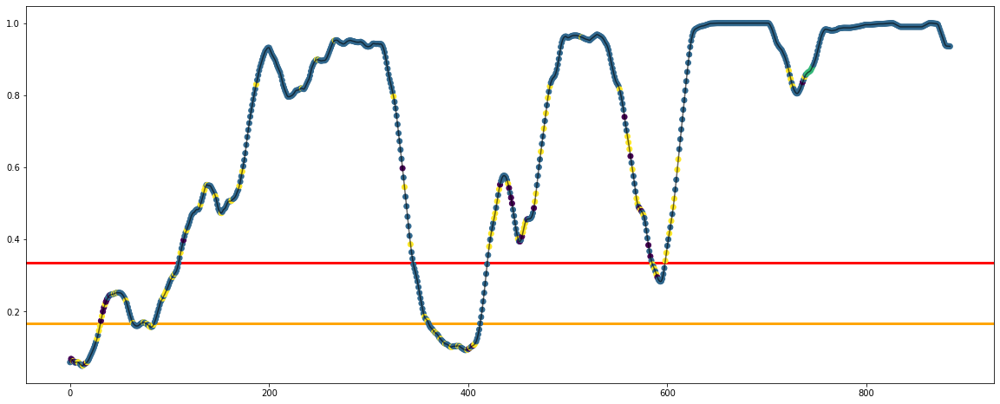

Experiment: 17_20150925_noon
Best Model:
	Score: -6.4809
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 258, 'n_clusters': 4, 'n_init': 14, 'tol': 0.0005}

Cluestering evaluation:
	Silhouette Coefficient: 0.4173
	Calinski-Harabasz Index: 595.8175
	Davies Bouldin Index: 0.7365


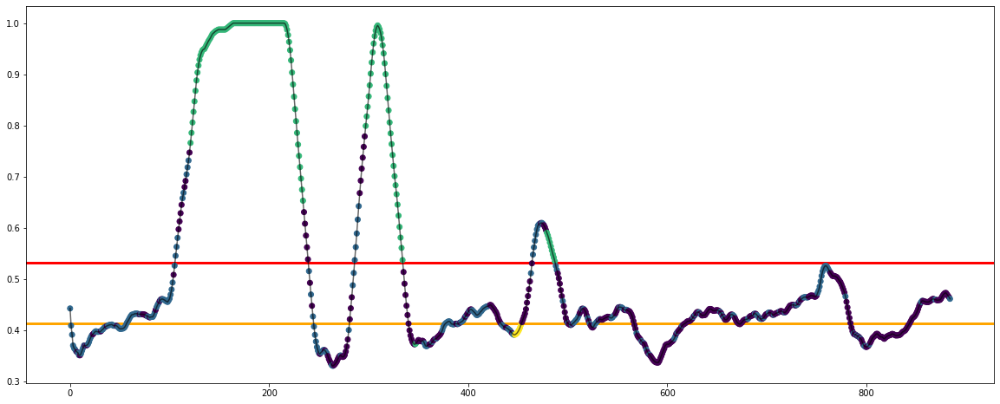

Experiment: 18_20150926_noon
Best Model:
	Score: -5.6837
	Hyperparameters: {'algorithm': 'auto', 'init': 'k-means++', 'max_iter': 321, 'n_clusters': 4, 'n_init': 11, 'tol': 0.0001}

Cluestering evaluation:
	Silhouette Coefficient: 0.4871
	Calinski-Harabasz Index: 558.4757
	Davies Bouldin Index: 0.6974


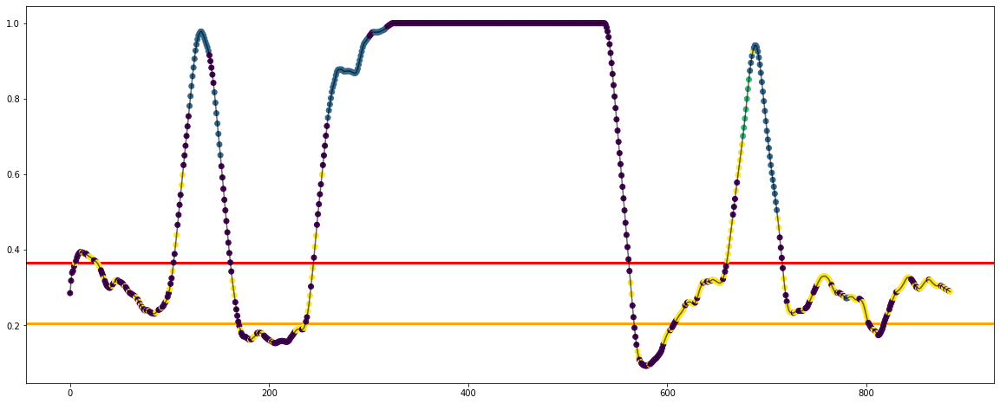

Experiment: 19_20151114_noon
Best Model:
	Score: -4.2474
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.5246
	Calinski-Harabasz Index: 1876.5418
	Davies Bouldin Index: 0.5374


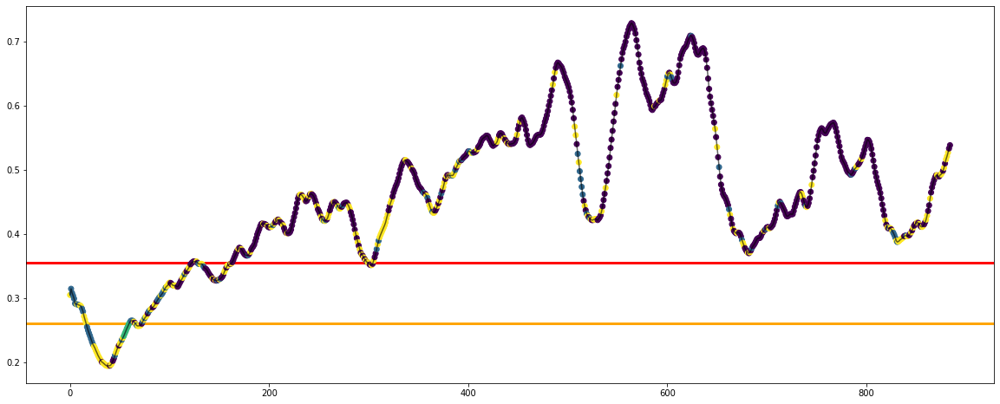

Experiment: 20_20151129_night
Best Model:
	Score: -5.1096
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 292, 'n_clusters': 4, 'n_init': 15, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.4607
	Calinski-Harabasz Index: 692.6190
	Davies Bouldin Index: 0.7695


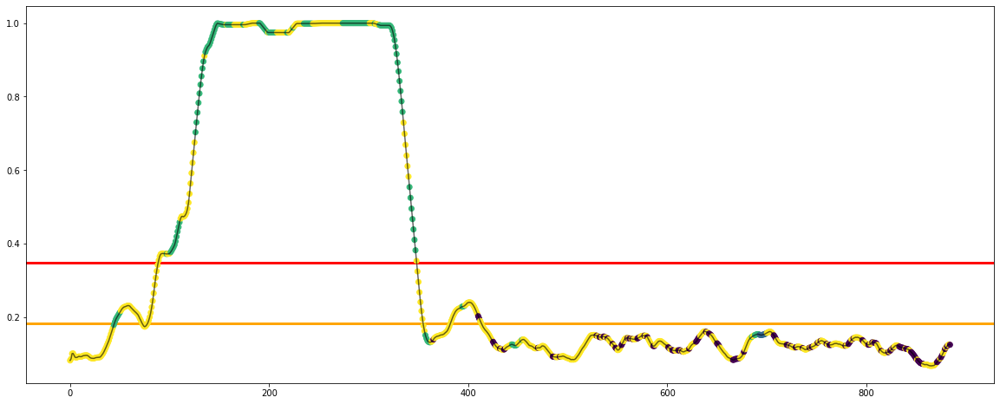

Experiment: 21_20151016_noon
Best Model:
	Score: -8.9765
	Hyperparameters: {'algorithm': 'elkan', 'init': 'random', 'max_iter': 316, 'n_clusters': 4, 'n_init': 10, 'tol': 1e-05}

Cluestering evaluation:
	Silhouette Coefficient: 0.5104
	Calinski-Harabasz Index: 331.9658
	Davies Bouldin Index: 0.7220


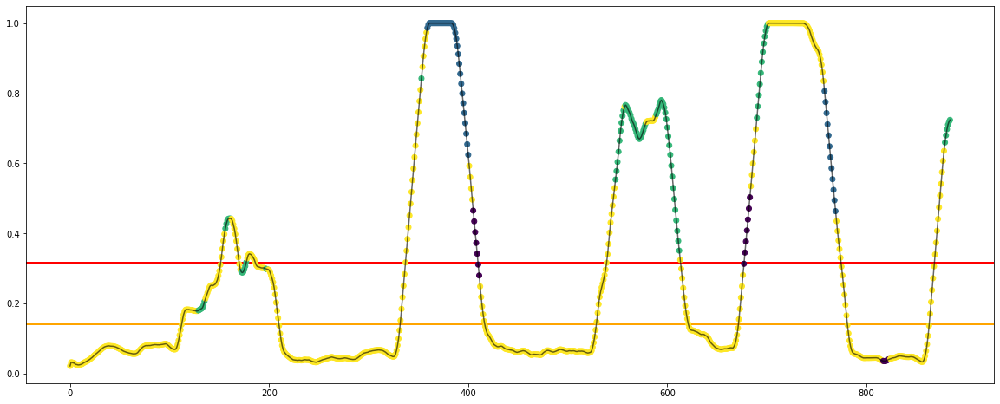

In [27]:
csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = KMeans(random_state=42)

    space = dict()
    space['n_clusters'] = [2, 3, 4]
    space['init'] = ['k-means++', 'random']
    space['n_init'] = randint(5, 20)
    space['max_iter'] = randint(200, 400)
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['algorithm'] = ['auto', 'full', 'elkan']

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all_eog[key], y_all[key], model, space, cv=10, n_iter=20)
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/KMeans-PSD+EOG.csv', index=False)

### Resto de cosas de K-Means

In [7]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

In [11]:
def kmeans_simple_plot(X, y, n_plots=3):

    fig, ax = plt.subplots(ncols=n_plots ,figsize=(20,4))

    for k in range(2, 2+n_plots):
        ax[k-2].title.set_text(f"Clusters when k={k}")

        kmeans = KMeans(n_clusters=k)
        y_pred = kmeans.fit_predict(X)

        ax[k-2].scatter(X.T[0], X.T[1], c=y_pred)
        centroids = kmeans.cluster_centers_
        ax[k-2].scatter(centroids[:, 0], centroids[:, 1], s=100, c='red')

    plt.show()

In [12]:
def kmeans_complex_plot(X, y, n_plots=3):
    # Grafica compleja

    fig, ax = plt.subplots(nrows=n_plots, ncols=2 ,figsize=(20,15))
    fig. tight_layout(pad=5)

    for k in range(2, 2+n_plots):
        kmeans = KMeans(n_clusters=k, random_state=42)
        y_pred = kmeans.fit_predict(X)

        ### Silhouette Diagram ###

        ax[k-2][0].set_xlim([-0.1, 1])
        ax[k-2][0].set_ylim([0, len(X) + (k + 1) * 10])

        silhouette_avg = silhouette_score(X, y_pred)

        sample_silhouette_values = silhouette_samples(X, y_pred)

        y_lower = 10
        for i in range(k):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[y_pred == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / k)
            ax[k-2][0].fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax[k-2][0].text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax[k-2][0].axvline(x=silhouette_avg, color="red", linestyle="--")

        ax[k-2][0].set_title(f"The silhouette diagram for n_clusters = {k}. Avg = {silhouette_avg:.3f}")
        ax[k-2][0].set_xlabel("The silhouette coefficient values")
        ax[k-2][0].set_ylabel("Cluster label")

        ax[k-2][0].set_yticks([])  # Clear the yaxis labels / ticks
        ax[k-2][0].set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        ### Clusters Visualization ###
        ax[k-2][1].set_title(f"Clusters visualization for n_clusters = {k}")
        ax[k-2][1].scatter(X.T[0], X.T[1], marker='.', s=50, lw=0, alpha=1,c=y_pred, edgecolor='k')
        centroids = kmeans.cluster_centers_
        ax[k-2][1].scatter(centroids[:, 0], centroids[:, 1], marker='o', c="white", alpha=1, s=200, edgecolor='k')
        for i, c in enumerate(centroids):
                ax[k-2][1].scatter(c[0], c[1], marker='$%d$' % i, alpha=1, s=50, edgecolor='k')

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data with n_clusters from %d to %d" % (2, n_plots+1)), fontweight='bold')
    plt.show()

In [13]:
def kmeans_predictions_plot(X, y, k=3):
    kmeans = KMeans(n_clusters=k)
    predictions = kmeans.fit_predict(X)

    plt.figure(figsize=(20, 8))
    plt.plot(y, color='gray')
    plt.scatter(range(len(predictions)), y, c=predictions)
    plt.title('Coloreado del valor PERCLOS y el cluster asociado')
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.show()

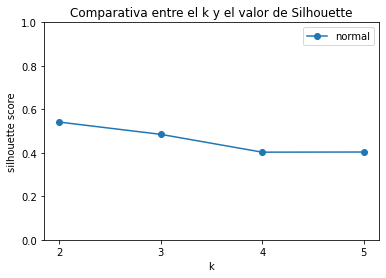

In [24]:
k_values = list(range(2, 5+1))
silhouette_scores = []

key = '11_20151024_night'

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    
    kmeans.fit_predict(X_all[key])
    silhouette_scores.append(silhouette_score(X_all[key], kmeans.labels_))
    
plt.plot(k_values, silhouette_scores, '-o', label='normal')
plt.xticks(range(2,6))
plt.ylim([0, 1])
plt.title('Comparativa entre el k y el valor de Silhouette')
plt.xlabel('k')
plt.ylabel('silhouette score')
plt.legend()
plt.show()

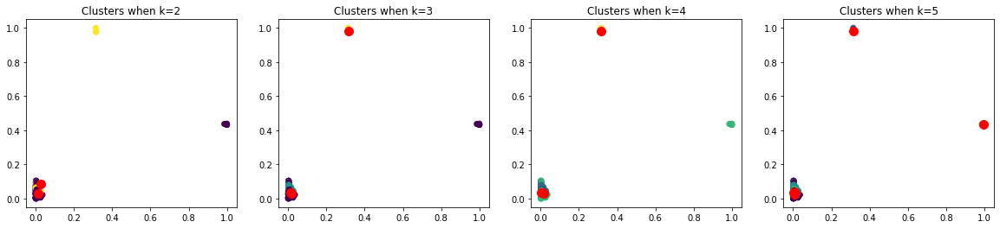

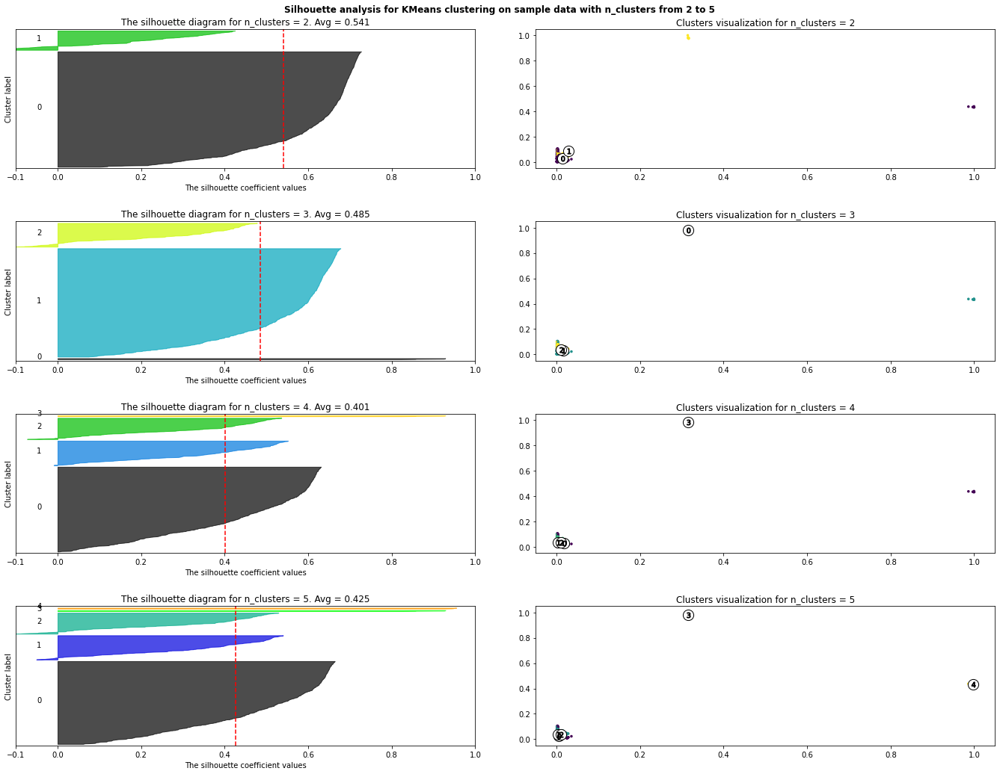

In [25]:
kmeans_simple_plot(X_all[key], y_all[key], 4)
kmeans_complex_plot(X_all[key], y_all[key], 4)

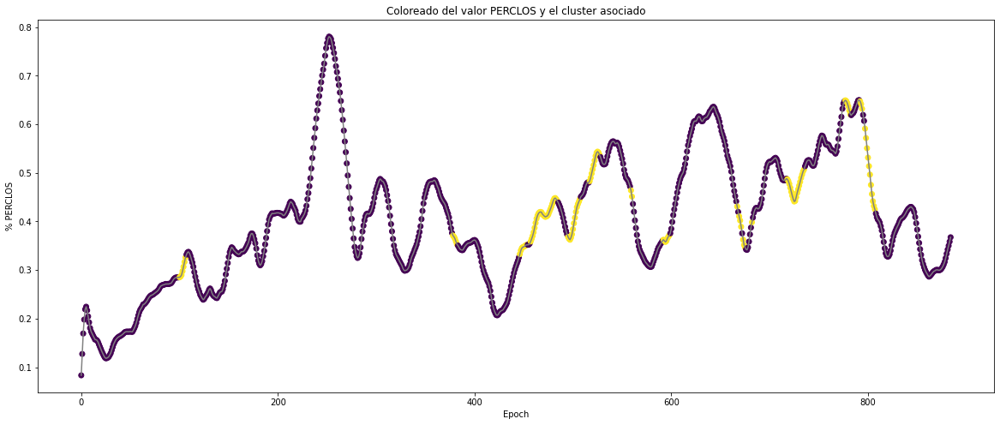

In [27]:
kmeans_predictions_plot(X_all[key], y_all[key], 2)

## GM

In [21]:
from sklearn.mixture import GaussianMixture

### EEG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 193.7521
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2951
	Calinski-Harabasz Index: 661.5482
	Davies Bouldin Index: 1.3286
Ha convergido? True, n_its: 15
[0.22 0.32 0.46]


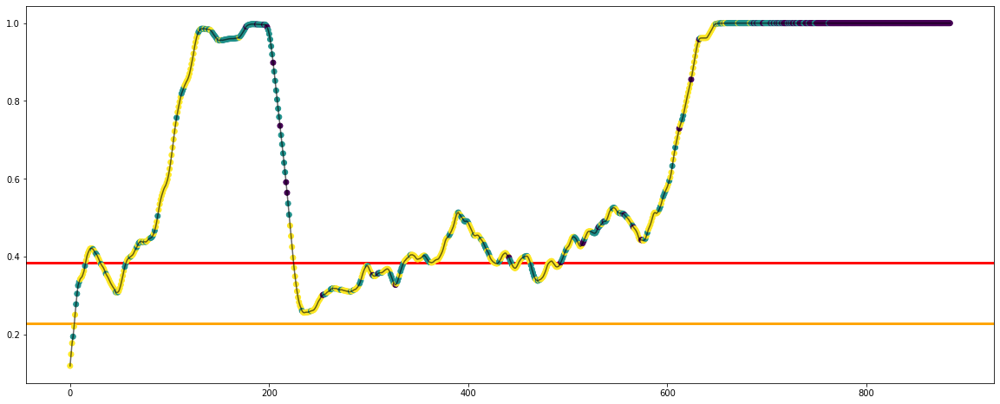

Experiment: 2_20151106_noon
Best Model:
	Score: 377.1063
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: -0.0190
	Calinski-Harabasz Index: 6.3868
	Davies Bouldin Index: 6.4942
Ha convergido? True, n_its: 3
[0.34 0.33 0.33]


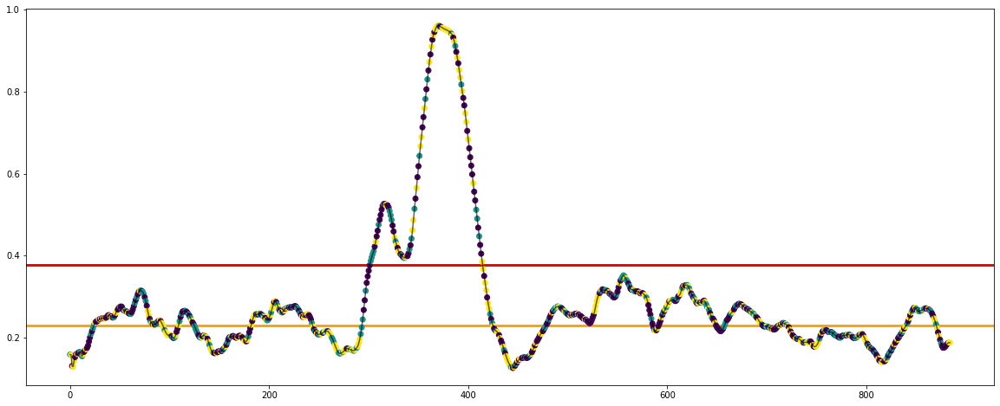

Experiment: 3_20151024_noon
Best Model:
	Score: 240.4137
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.1743
	Calinski-Harabasz Index: 112.0811
	Davies Bouldin Index: 2.4818
Ha convergido? True, n_its: 29
[0.68 0.28 0.05]


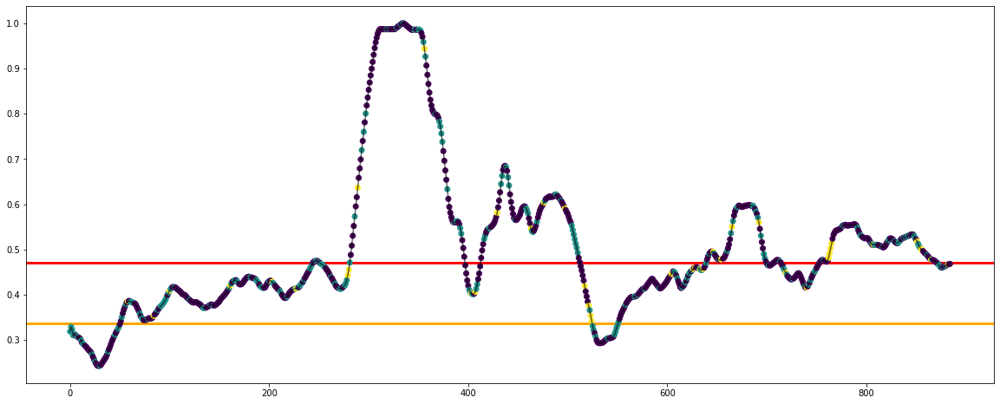

Experiment: 4_20151105_noon
Best Model:
	Score: 294.7748
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: -0.0060
	Calinski-Harabasz Index: 9.5946
	Davies Bouldin Index: 8.1801
Ha convergido? True, n_its: 3
[0.34 0.33 0.33]


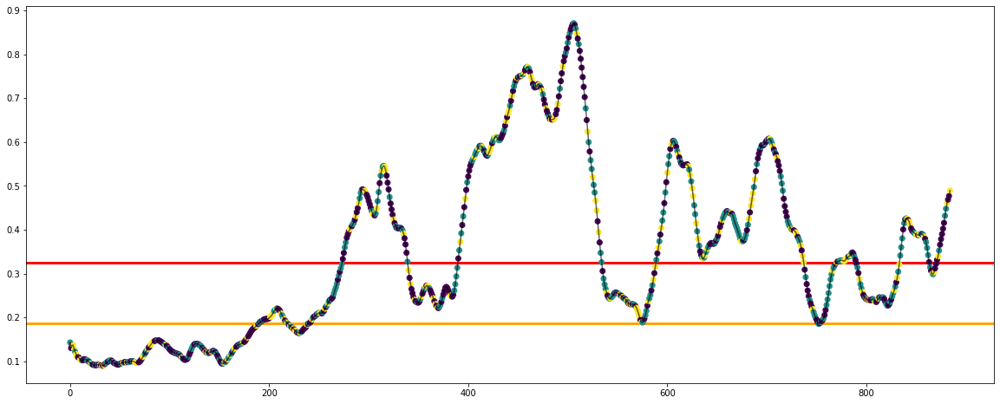

Experiment: 4_20151107_noon
Best Model:
	Score: 259.0353
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 0.005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: -0.0225
	Calinski-Harabasz Index: 7.9998
	Davies Bouldin Index: 9.7066
Ha convergido? True, n_its: 2
[0.34 0.33 0.33]


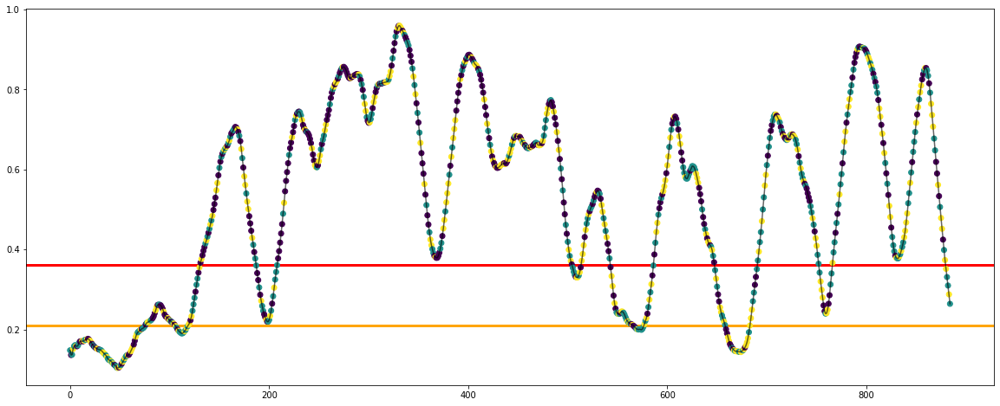

Experiment: 5_20141108_noon
Best Model:
	Score: 193.5468
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.1760
	Calinski-Harabasz Index: 253.9710
	Davies Bouldin Index: 1.7649
Ha convergido? True, n_its: 24
[0.38 0.15 0.47]


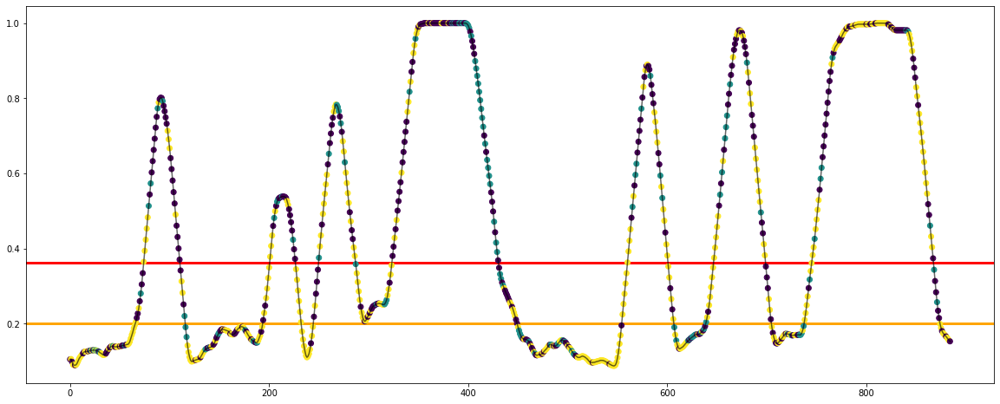

Experiment: 5_20151012_night
Best Model:
	Score: 206.9480
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2038
	Calinski-Harabasz Index: 171.8515
	Davies Bouldin Index: 2.1790
Ha convergido? True, n_its: 28
[0.15 0.5  0.36]


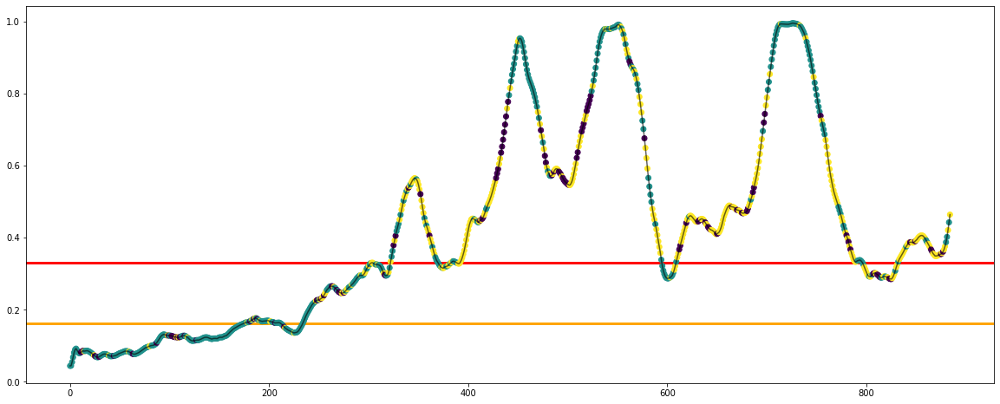

Experiment: 6_20151121_noon
Best Model:
	Score: 314.5694
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2705
	Calinski-Harabasz Index: 134.7259
	Davies Bouldin Index: 2.6176
Ha convergido? True, n_its: 21
[0.61 0.3  0.09]


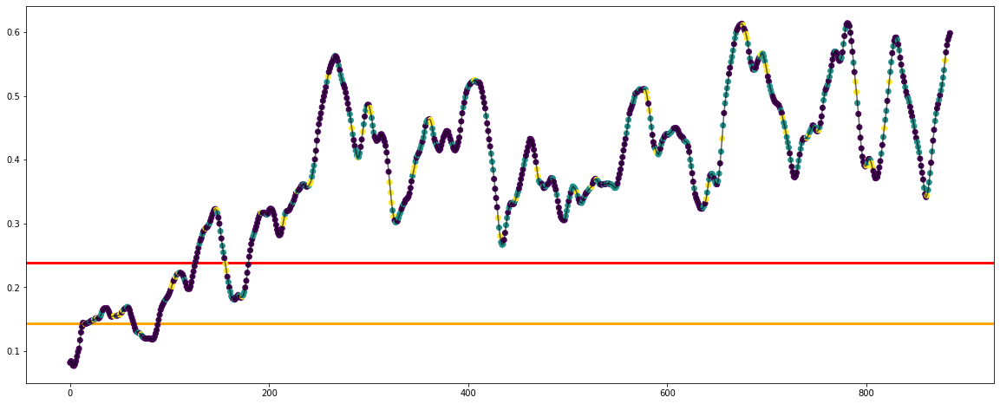

Experiment: 7_20151015_night
Best Model:
	Score: 266.8034
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2540
	Calinski-Harabasz Index: 151.1797
	Davies Bouldin Index: 2.0769
Ha convergido? True, n_its: 26
[0.7  0.04 0.26]


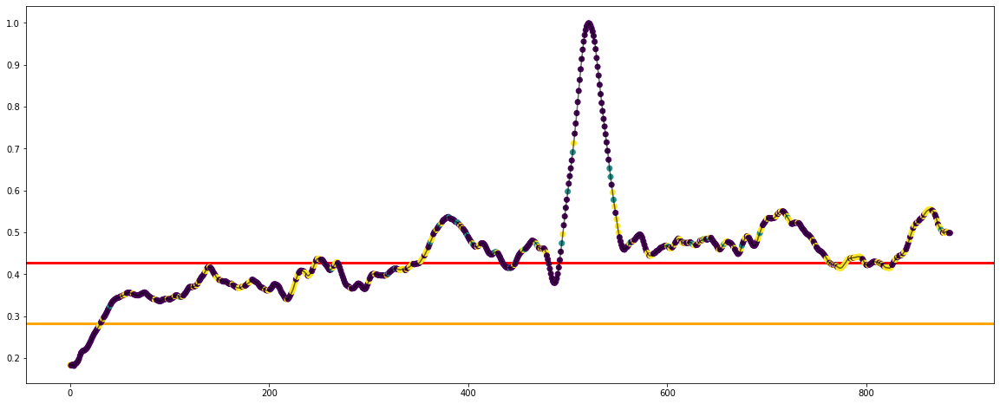

Experiment: 8_20151022_noon
Best Model:
	Score: 253.2611
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.1799
	Calinski-Harabasz Index: 173.2423
	Davies Bouldin Index: 2.1561
Ha convergido? True, n_its: 58
[0.18 0.36 0.46]


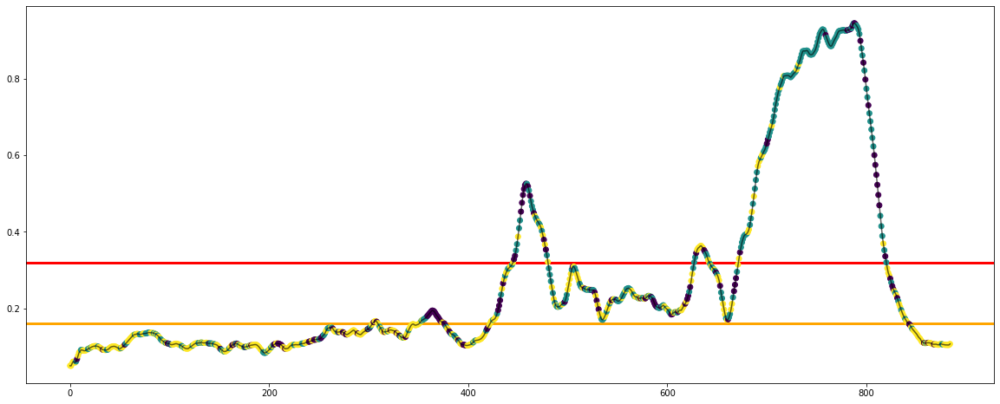

Experiment: 9_20151017_night
Best Model:
	Score: 333.6293
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 1e-07, 'tol': 0.0005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.1014
	Calinski-Harabasz Index: 148.2912
	Davies Bouldin Index: 2.1679
Ha convergido? True, n_its: 75
[0.38 0.48 0.14]


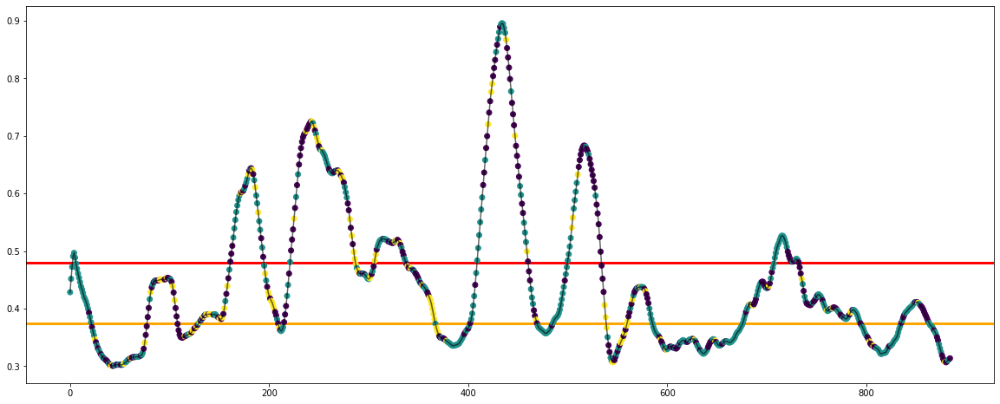

Experiment: 10_20151125_noon
Best Model:
	Score: 246.0609
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 0.005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: -0.0252
	Calinski-Harabasz Index: 3.4142
	Davies Bouldin Index: 13.1431
Ha convergido? True, n_its: 2
[0.35 0.32 0.33]


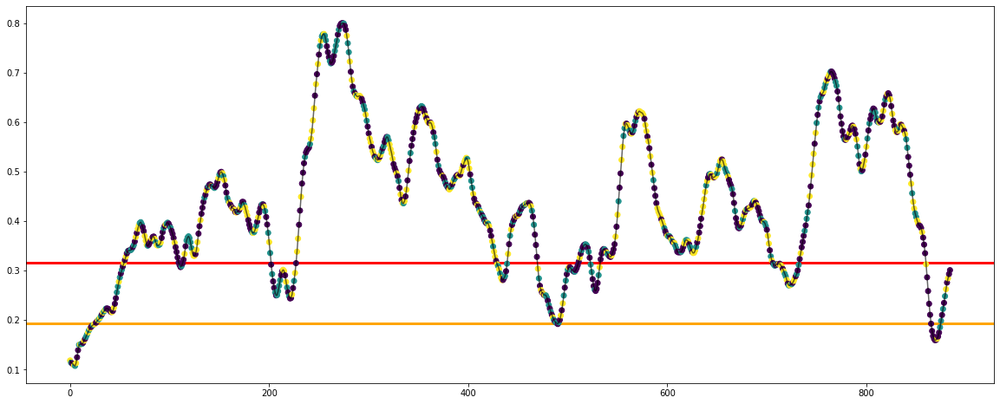

Experiment: 11_20151024_night
Best Model:
	Score: 249.7316
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 1e-07, 'tol': 0.0005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.2085
	Calinski-Harabasz Index: 189.4610
	Davies Bouldin Index: 1.8136
Ha convergido? True, n_its: 17
[0.39 0.56 0.05]


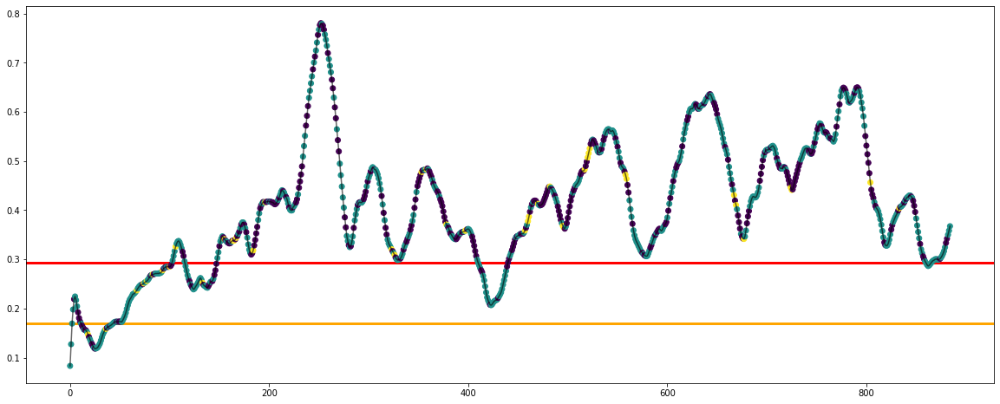

Experiment: 12_20150928_noon
Best Model:
	Score: 365.0270
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.001, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.3912
	Calinski-Harabasz Index: 419.2803
	Davies Bouldin Index: 1.0225
Ha convergido? True, n_its: 12
[0.68 0.01 0.3 ]


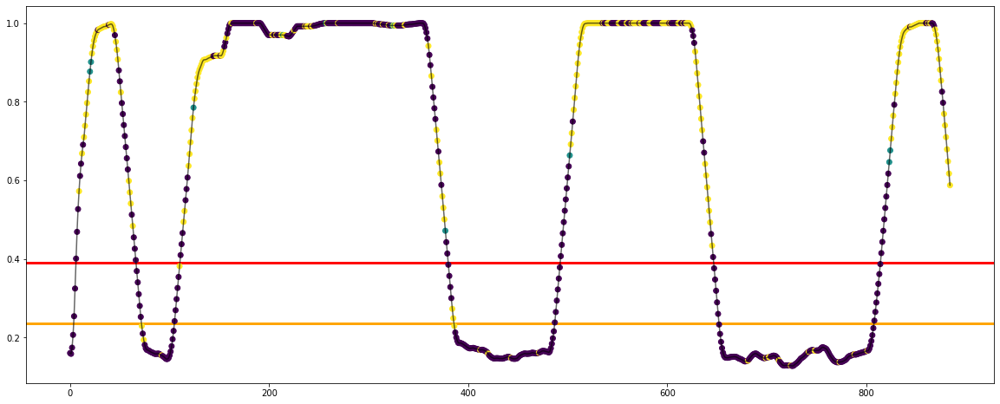

Experiment: 13_20150929_noon
Best Model:
	Score: 213.1178
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: -0.0209
	Calinski-Harabasz Index: 20.1656
	Davies Bouldin Index: 5.8637
Ha convergido? True, n_its: 4
[0.34 0.34 0.32]


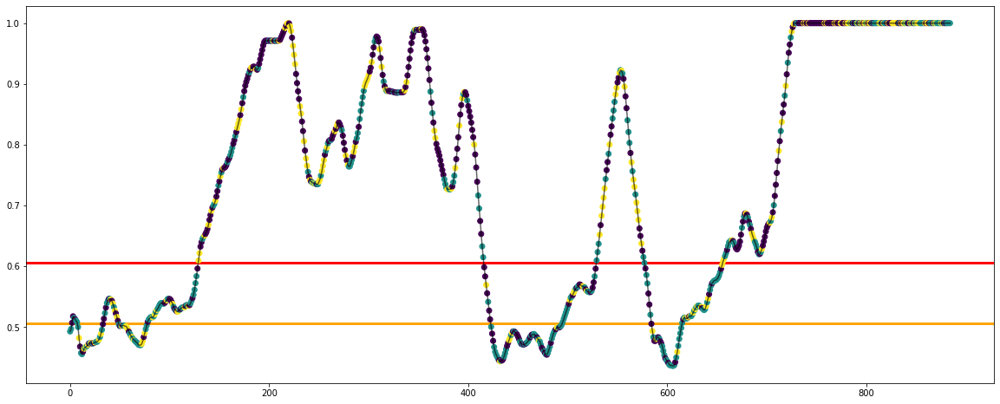

Experiment: 14_20151014_night
Best Model:
	Score: 331.8410
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 1e-07, 'tol': 0.0005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.2907
	Calinski-Harabasz Index: 225.1086
	Davies Bouldin Index: 2.1296
Ha convergido? True, n_its: 12
[0.48 0.06 0.46]


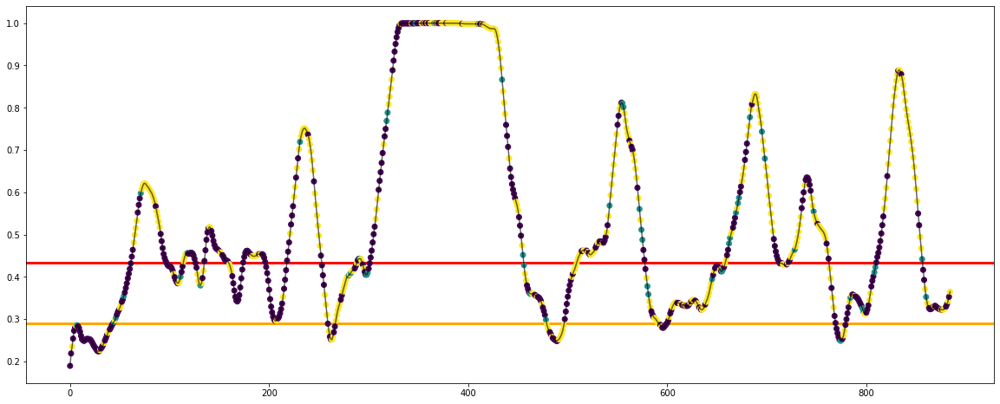

Experiment: 15_20151126_night
Best Model:
	Score: 292.8634
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: -0.0470
	Calinski-Harabasz Index: 5.5156
	Davies Bouldin Index: 9.4854
Ha convergido? True, n_its: 4
[0.34 0.33 0.33]


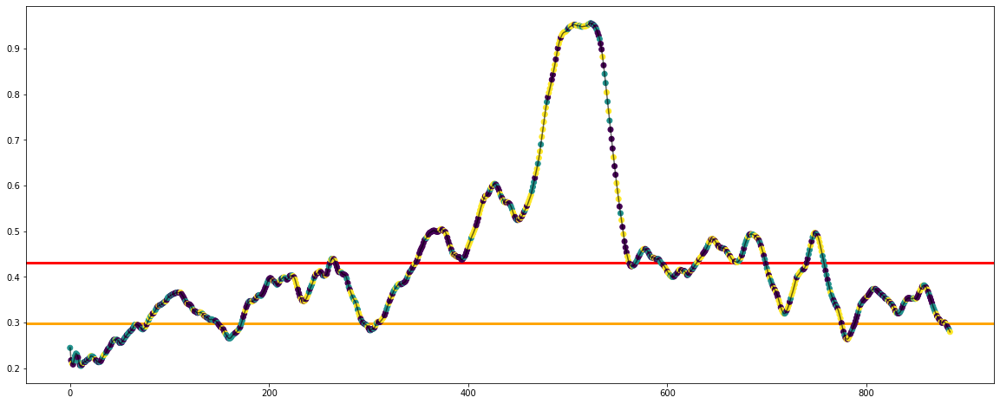

Experiment: 16_20151128_night
Best Model:
	Score: 365.3252
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: -0.0142
	Calinski-Harabasz Index: 5.3026
	Davies Bouldin Index: 9.6642
Ha convergido? True, n_its: 3
[0.34 0.33 0.33]


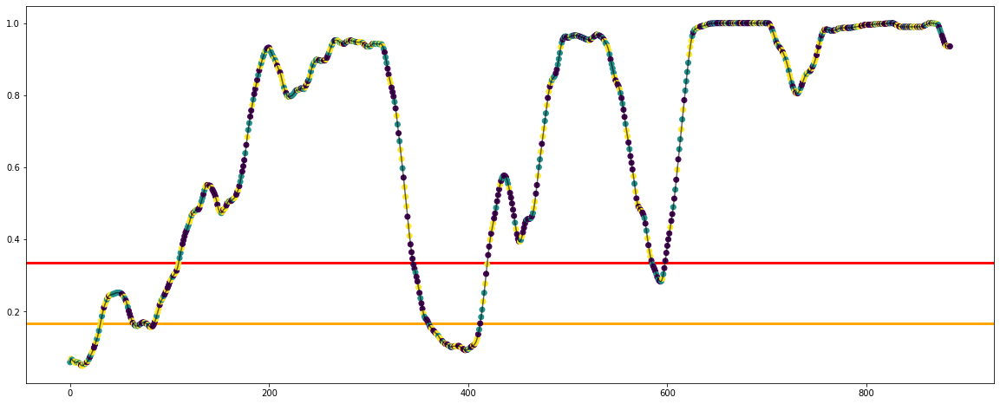

Experiment: 17_20150925_noon
Best Model:
	Score: 261.4005
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: -0.0119
	Calinski-Harabasz Index: 8.6549
	Davies Bouldin Index: 8.7692
Ha convergido? True, n_its: 4
[0.34 0.33 0.33]


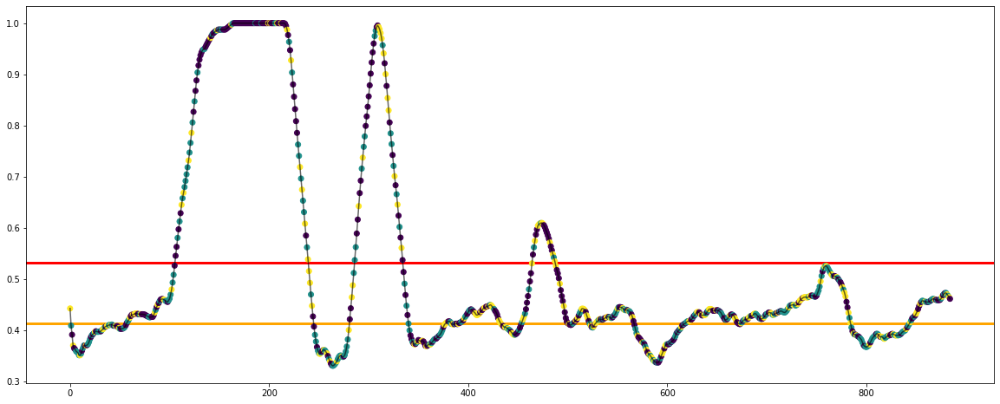

Experiment: 18_20150926_noon
Best Model:
	Score: 312.9302
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 1e-07, 'tol': 0.0005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.2870
	Calinski-Harabasz Index: 239.2275
	Davies Bouldin Index: 1.9377
Ha convergido? True, n_its: 24
[0.51 0.38 0.11]


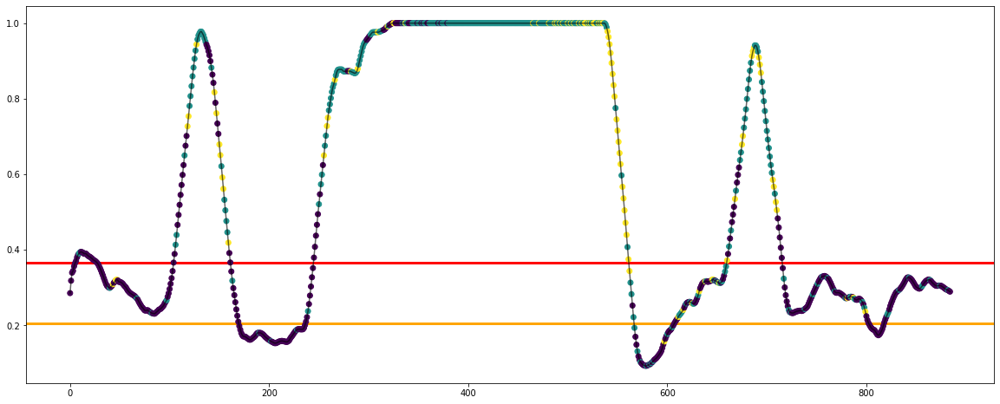

Experiment: 19_20151114_noon
Best Model:
	Score: 185.3226
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.0085
	Calinski-Harabasz Index: 14.0012
	Davies Bouldin Index: 7.7560
Ha convergido? True, n_its: 3
[0.35 0.32 0.33]


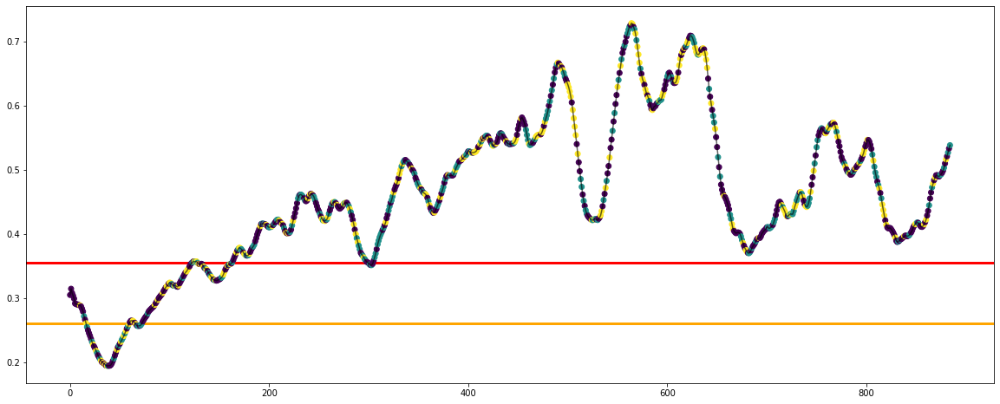

Experiment: 20_20151129_night
Best Model:
	Score: 239.6875
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: -0.0267
	Calinski-Harabasz Index: 18.6939
	Davies Bouldin Index: 6.9386
Ha convergido? True, n_its: 3
[0.34 0.34 0.32]


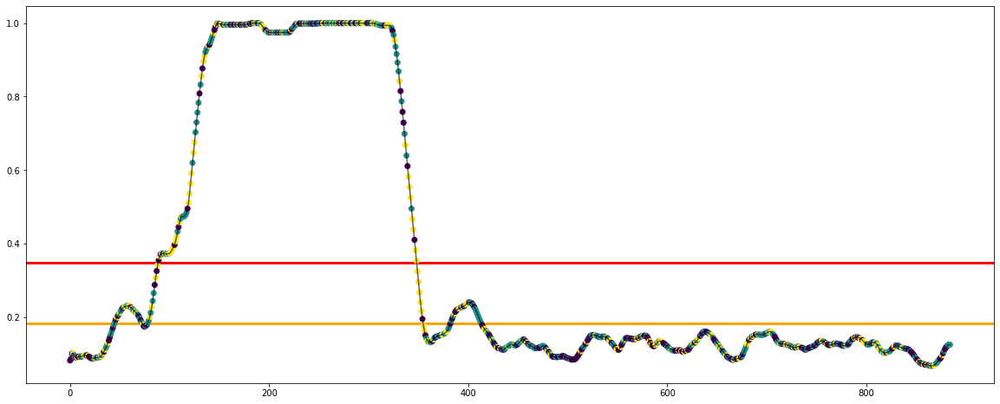

Experiment: 21_20151016_noon
Best Model:
	Score: 289.4722
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2535
	Calinski-Harabasz Index: 217.0669
	Davies Bouldin Index: 1.8321
Ha convergido? True, n_its: 61
[0.5  0.15 0.36]


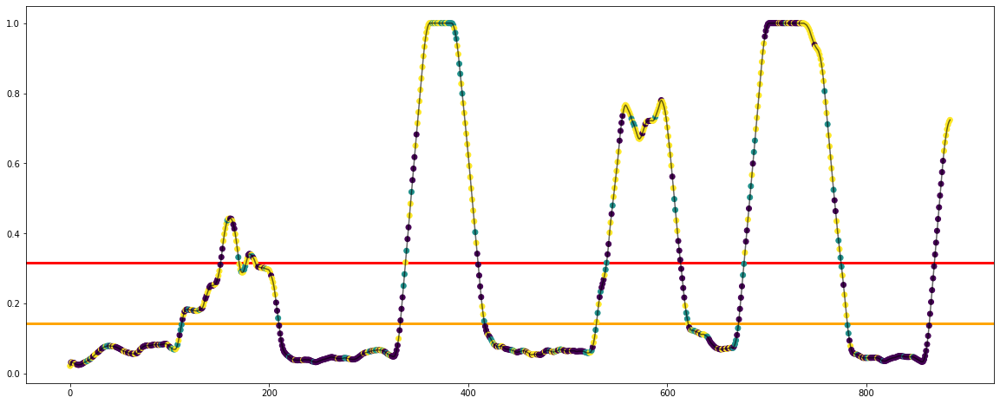

In [45]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    X, y = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)
    
    
    print(f"Experiment: {key}")
    model = GaussianMixture(max_iter=200, random_state=42)

    space = dict()
    space['n_components'] = randint(2, 4)
    space['covariance_type'] = ['full', 'tied', 'diag', 'spherical']
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['reg_covar'] = [1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5]
    space['n_init'] = randint(1, 5)
    space['init_params'] = ['kmeans', 'random']
    space['warm_start'] = [True, False]

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_minmax, y_all[key], model, space, cv=10, n_iter=30)
    
    print(f'Ha convergido? {best_model.converged_}, n_its: {best_model.n_iter_}')
    print(np.round(best_model.weights_,2))
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_minmax, y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/GM-EEG.csv', index=False)

### PSD

Experiment: 1_20151124_noon_2
Best Model:
	Score: 7.3746
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.4654
	Calinski-Harabasz Index: 285.9613
	Davies Bouldin Index: 1.5713
Ha convergido? True, n_its: 30
[0.07 0.42 0.51]


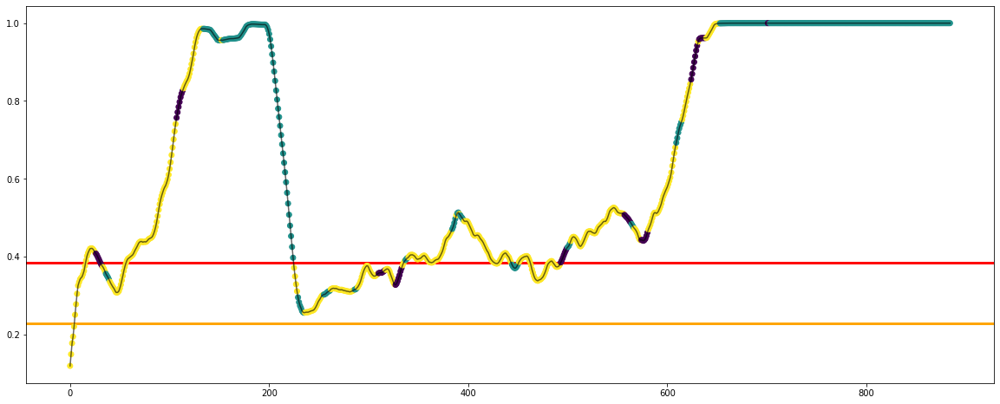

Experiment: 2_20151106_noon
Best Model:
	Score: 10.9131
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.3331
	Calinski-Harabasz Index: 358.1452
	Davies Bouldin Index: 1.1222
Ha convergido? True, n_its: 28
[0.59 0.08 0.34]


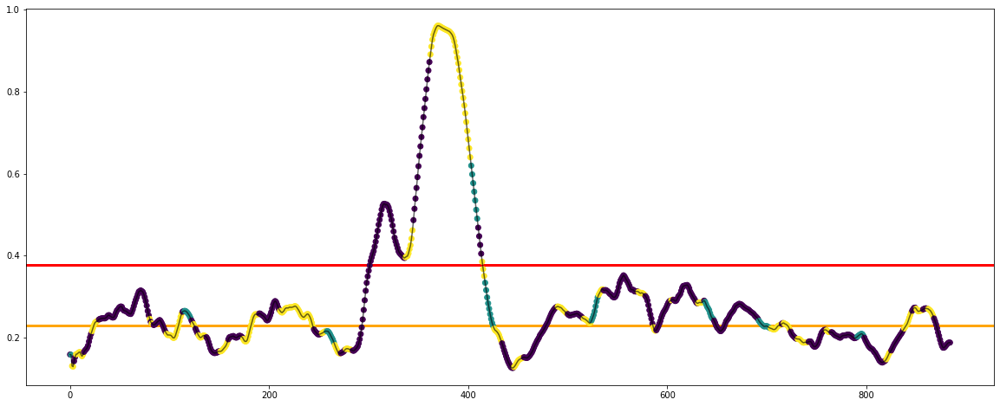

Experiment: 3_20151024_noon
Best Model:
	Score: 6.5386
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.1568
	Calinski-Harabasz Index: 156.8897
	Davies Bouldin Index: 1.9170
Ha convergido? True, n_its: 50
[0.08 0.52 0.4 ]


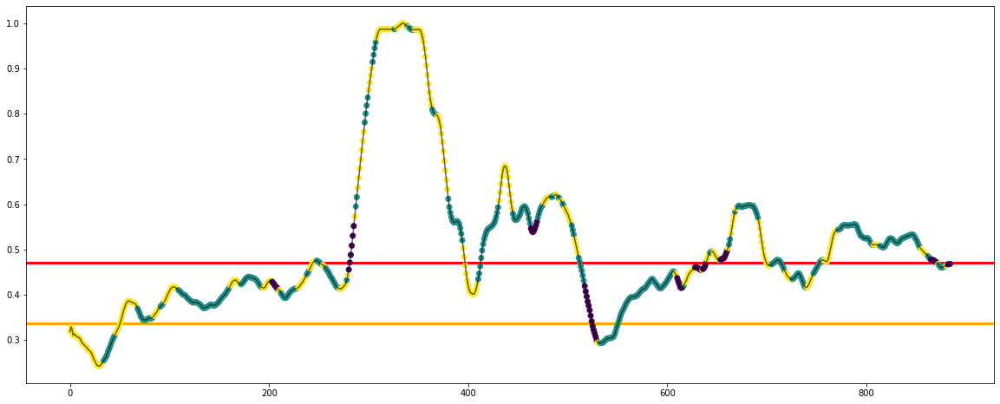

Experiment: 4_20151105_noon
Best Model:
	Score: 3.3170
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-07, 'tol': 1e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.2915
	Calinski-Harabasz Index: 358.2633
	Davies Bouldin Index: 1.1276
Ha convergido? True, n_its: 35
[0.54 0.35 0.11]


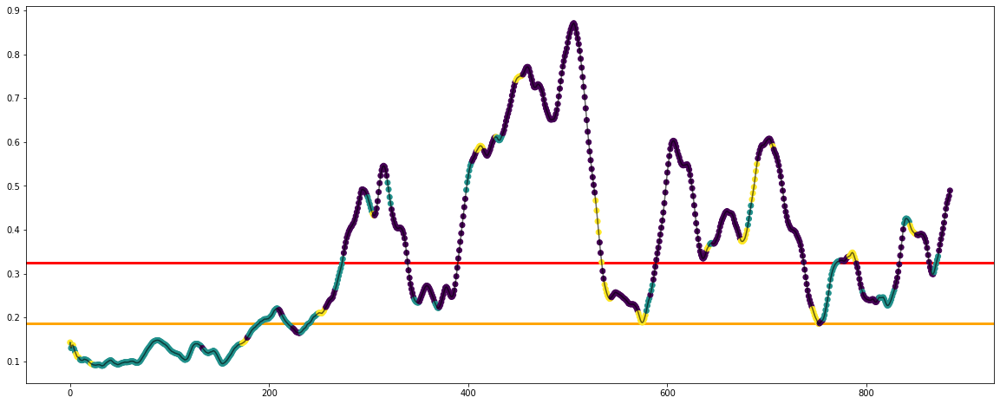

Experiment: 4_20151107_noon
Best Model:
	Score: 4.4965
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-07, 'tol': 1e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.2337
	Calinski-Harabasz Index: 323.6651
	Davies Bouldin Index: 1.2738
Ha convergido? True, n_its: 34
[0.27 0.28 0.45]


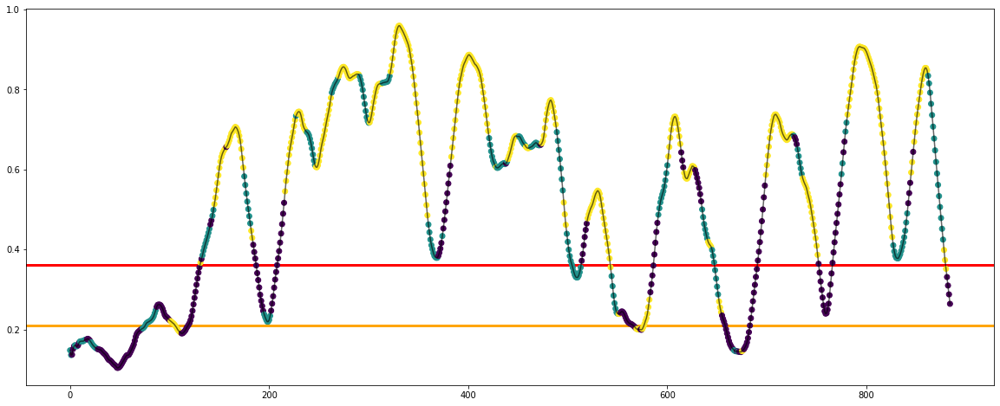

Experiment: 5_20141108_noon
Best Model:
	Score: 7.0810
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-06, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2346
	Calinski-Harabasz Index: 178.3899
	Davies Bouldin Index: 1.6950
Ha convergido? True, n_its: 28
[0.41 0.23 0.36]


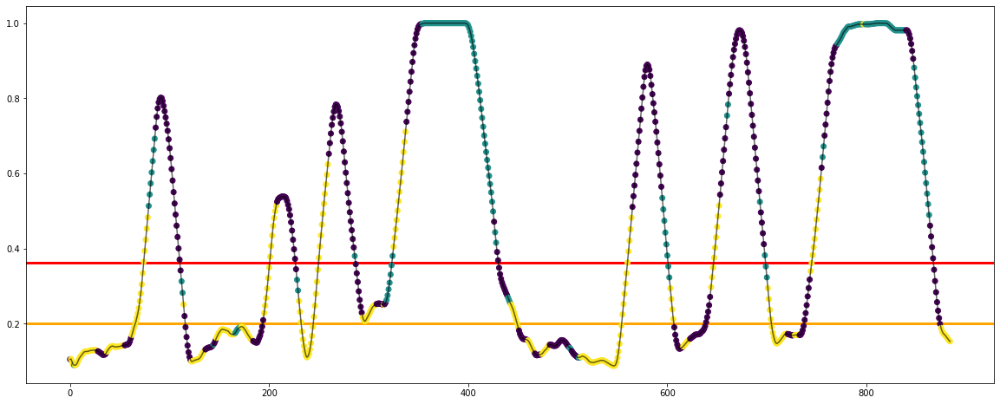

Experiment: 5_20151012_night
Best Model:
	Score: 7.8162
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.4879
	Calinski-Harabasz Index: 285.8688
	Davies Bouldin Index: 1.1220
Ha convergido? True, n_its: 36
[0.05 0.39 0.56]


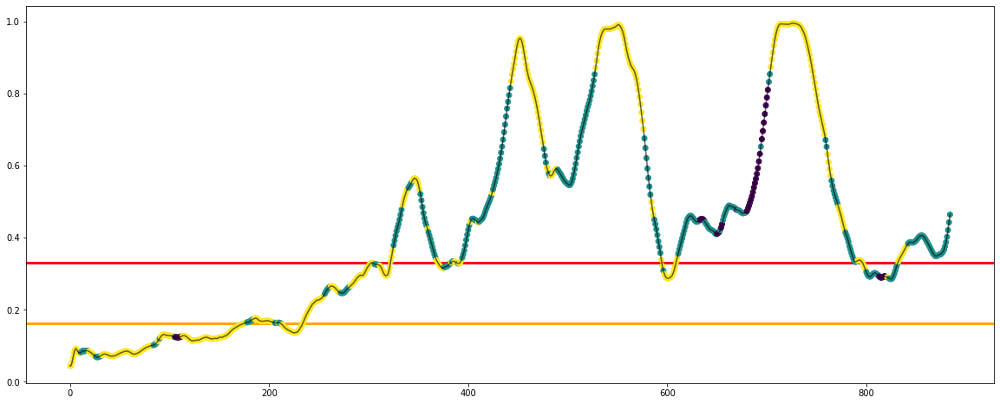

Experiment: 6_20151121_noon
Best Model:
	Score: 14.8580
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-06, 'tol': 0.001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.4937
	Calinski-Harabasz Index: 303.7696
	Davies Bouldin Index: 1.1522
Ha convergido? True, n_its: 18
[0.3  0.07 0.63]


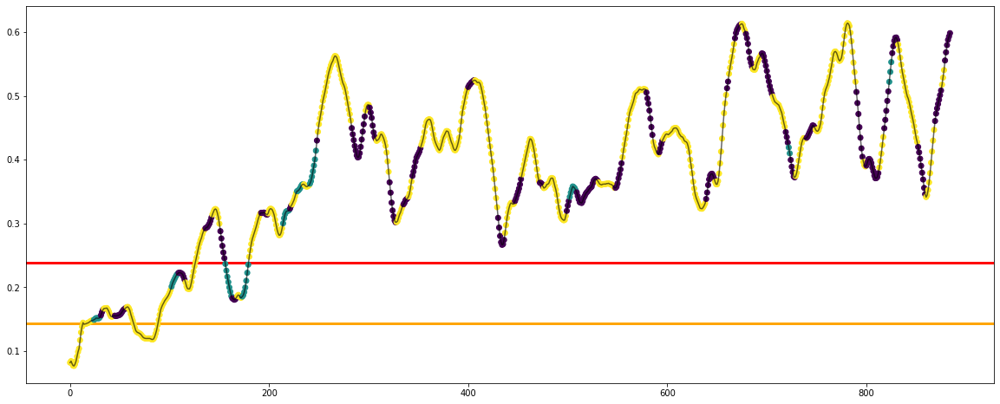

Experiment: 7_20151015_night
Best Model:
	Score: 4.0652
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.3093
	Calinski-Harabasz Index: 455.8955
	Davies Bouldin Index: 1.0427
Ha convergido? True, n_its: 28
[0.38 0.32 0.3 ]


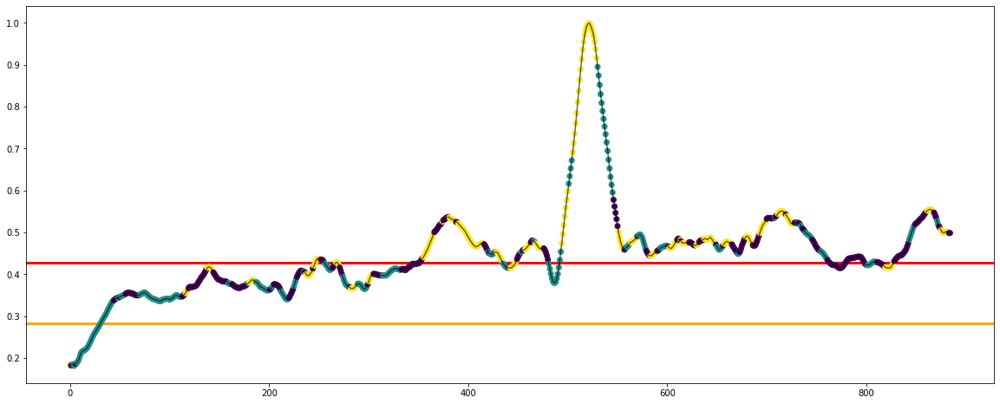

Experiment: 8_20151022_noon
Best Model:
	Score: 21.6549
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 2, 'n_init': 3, 'reg_covar': 5e-07, 'tol': 0.005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.8679
	Calinski-Harabasz Index: 249.7145
	Davies Bouldin Index: 1.1812
Ha convergido? True, n_its: 6
[0.91 0.09]


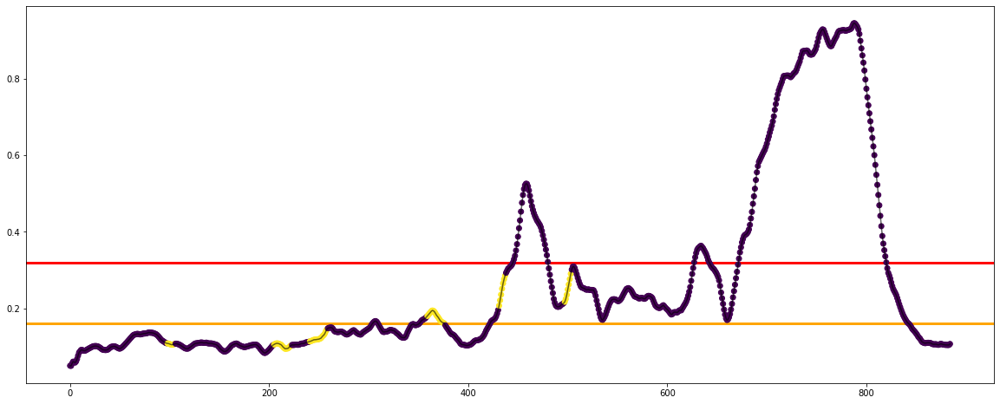

Experiment: 9_20151017_night
Best Model:
	Score: 9.8285
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-06, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2377
	Calinski-Harabasz Index: 180.4613
	Davies Bouldin Index: 1.8012
Ha convergido? True, n_its: 26
[0.53 0.18 0.29]


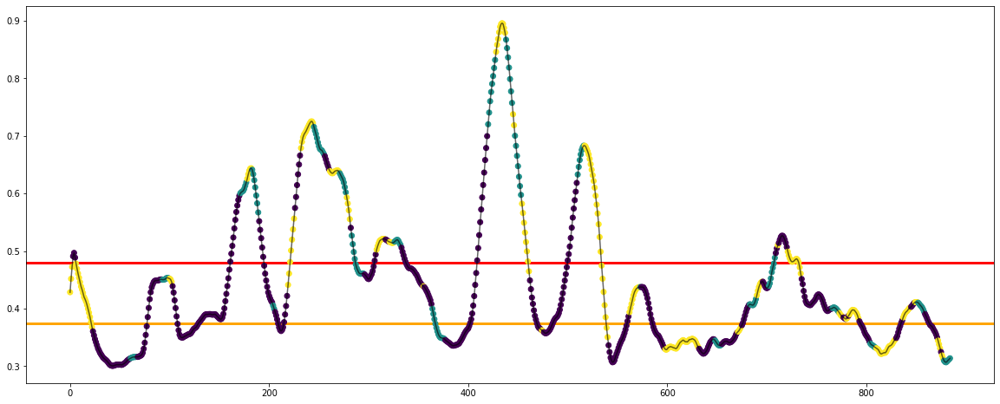

Experiment: 10_20151125_noon
Best Model:
	Score: 5.8185
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.6803
	Calinski-Harabasz Index: 596.3350
	Davies Bouldin Index: 0.9661
Ha convergido? True, n_its: 15
[0.17 0.02 0.82]


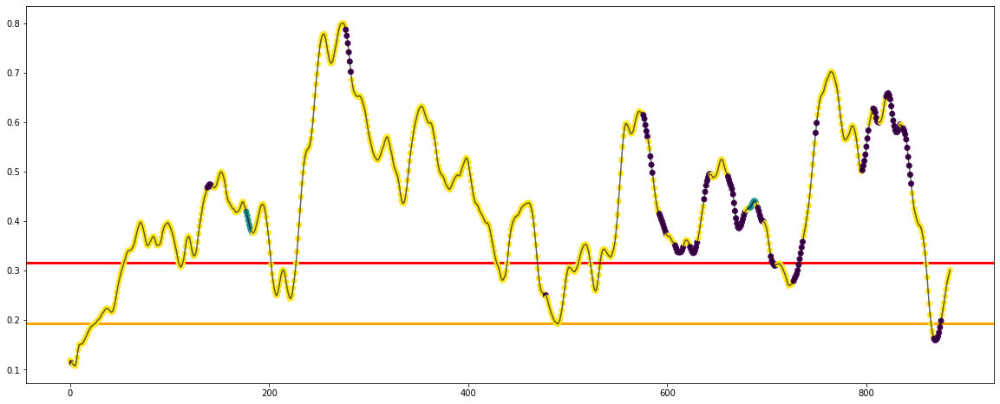

Experiment: 11_20151024_night
Best Model:
	Score: 6.8332
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 2, 'n_init': 3, 'reg_covar': 1e-06, 'tol': 0.0001, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.6523
	Calinski-Harabasz Index: 297.0485
	Davies Bouldin Index: 1.2157
Ha convergido? True, n_its: 5
[0.94 0.06]


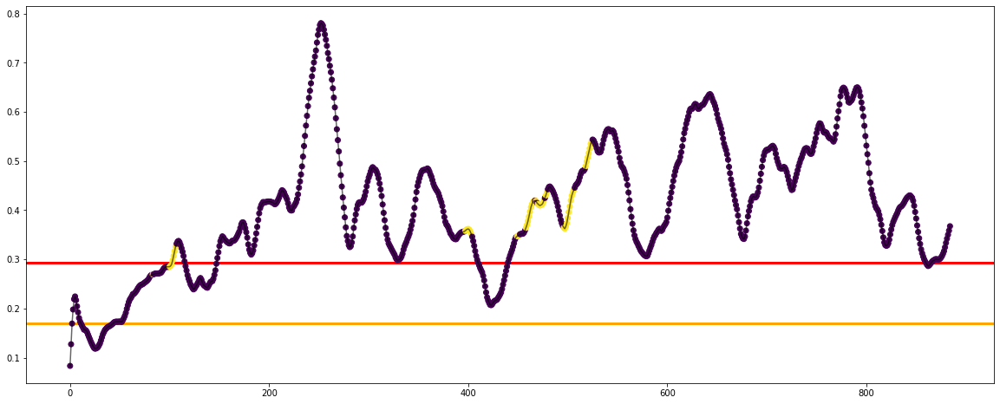

Experiment: 12_20150928_noon
Best Model:
	Score: 6.0448
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-07, 'tol': 0.001, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.2488
	Calinski-Harabasz Index: 192.4177
	Davies Bouldin Index: 2.2699
Ha convergido? True, n_its: 36
[0.42 0.38 0.21]


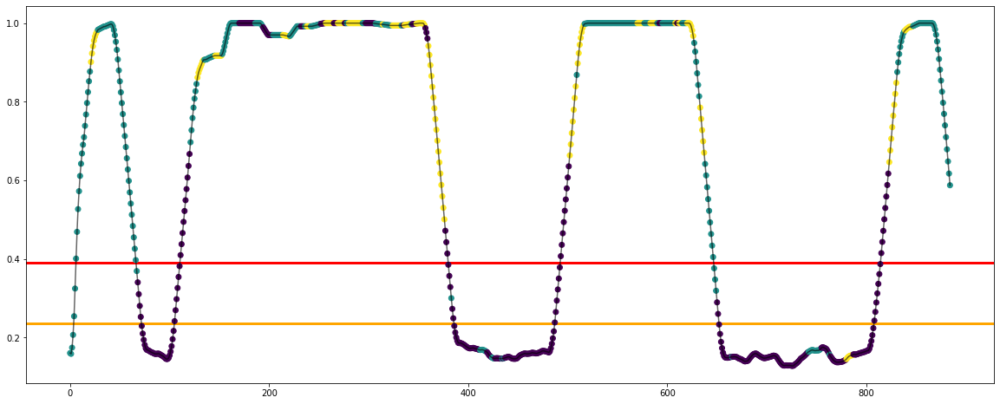

Experiment: 13_20150929_noon
Best Model:
	Score: 5.6337
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 1e-07, 'tol': 0.0005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.4369
	Calinski-Harabasz Index: 261.9054
	Davies Bouldin Index: 1.2699
Ha convergido? True, n_its: 9
[0.08 0.19 0.73]


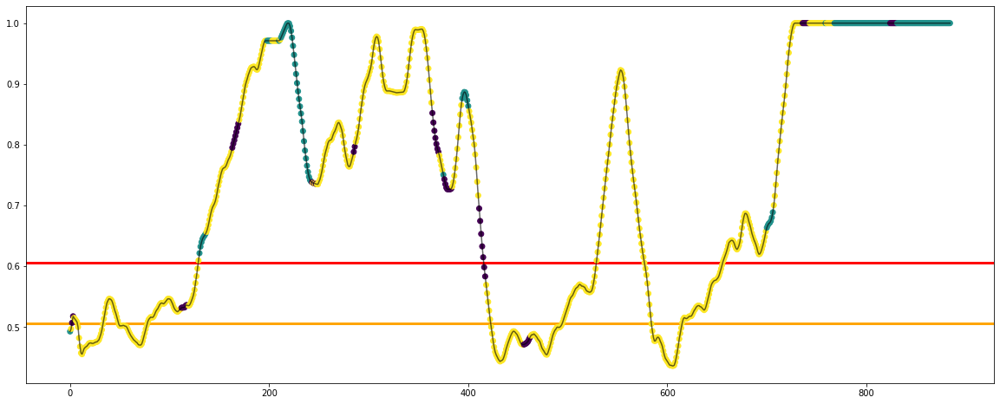

Experiment: 14_20151014_night
Best Model:
	Score: 6.4137
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.1746
	Calinski-Harabasz Index: 140.1959
	Davies Bouldin Index: 1.7484
Ha convergido? True, n_its: 18
[0.21 0.18 0.6 ]


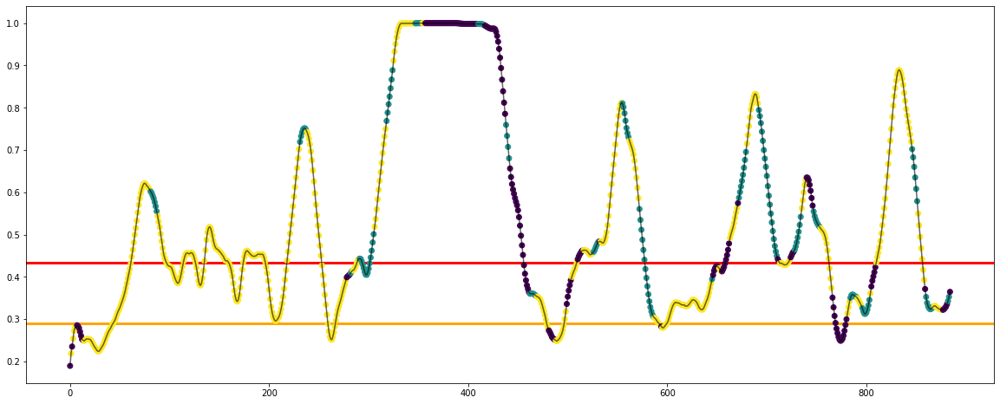

Experiment: 15_20151126_night
Best Model:
	Score: 7.4726
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.3641
	Calinski-Harabasz Index: 315.1769
	Davies Bouldin Index: 1.2958
Ha convergido? True, n_its: 14
[0.03 0.56 0.41]


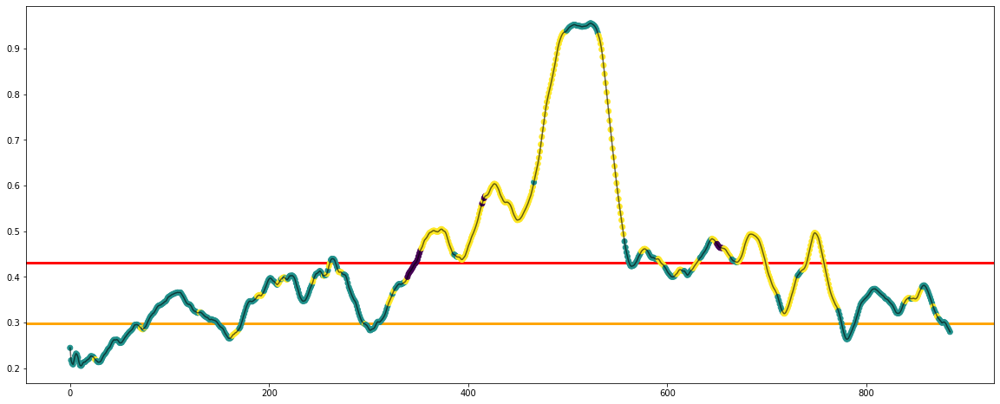

Experiment: 16_20151128_night
Best Model:
	Score: 0.9584
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 2, 'n_init': 3, 'reg_covar': 5e-07, 'tol': 0.005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.8029
	Calinski-Harabasz Index: 174.7044
	Davies Bouldin Index: 1.1944
Ha convergido? True, n_its: 7
[0.11 0.89]


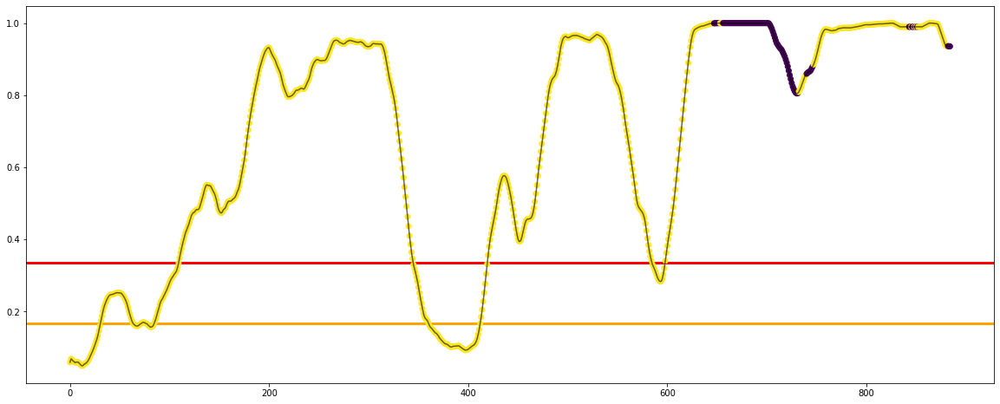

Experiment: 17_20150925_noon
Best Model:
	Score: 5.2834
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.2587
	Calinski-Harabasz Index: 230.6743
	Davies Bouldin Index: 1.2610
Ha convergido? True, n_its: 40
[0.33 0.31 0.36]


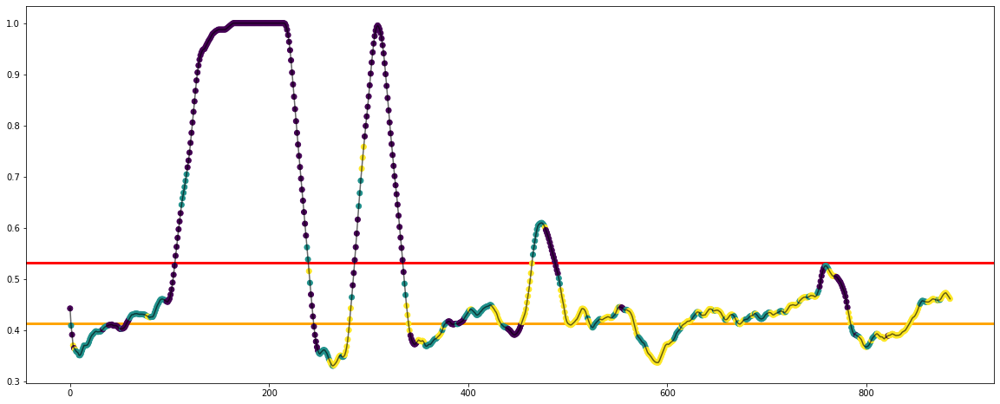

Experiment: 18_20150926_noon
Best Model:
	Score: 11.5827
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-06, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.3924
	Calinski-Harabasz Index: 160.8208
	Davies Bouldin Index: 1.3060
Ha convergido? True, n_its: 20
[0.18 0.75 0.07]


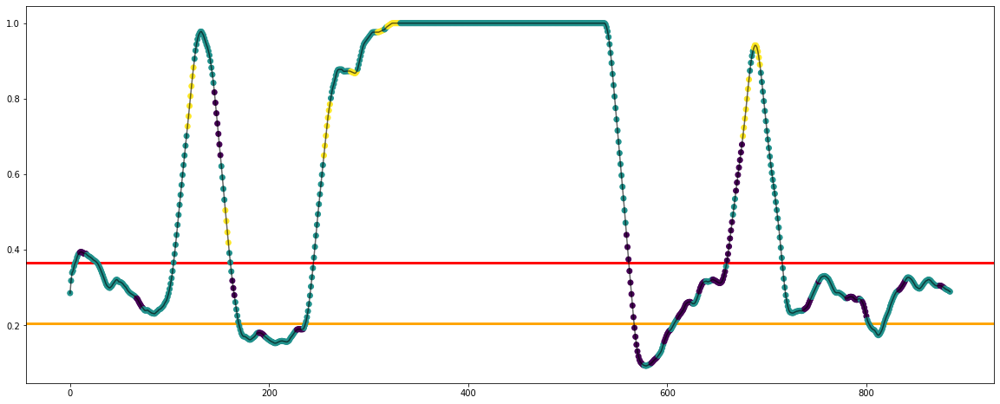

Experiment: 19_20151114_noon
Best Model:
	Score: 1.1058
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.3841
	Calinski-Harabasz Index: 4207.5962
	Davies Bouldin Index: 0.9409
Ha convergido? True, n_its: 20
[0.62 0.01 0.38]


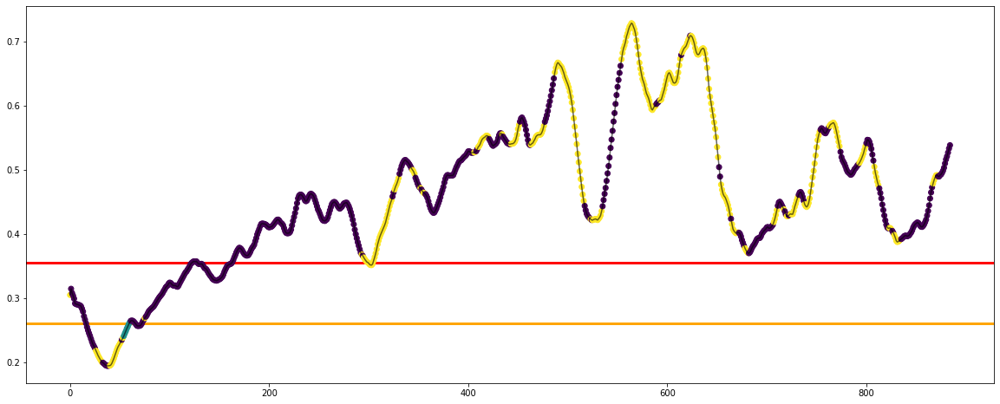

Experiment: 20_20151129_night
Best Model:
	Score: 10.5526
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.4763
	Calinski-Harabasz Index: 387.9231
	Davies Bouldin Index: 1.1903
Ha convergido? True, n_its: 37
[0.03 0.33 0.64]


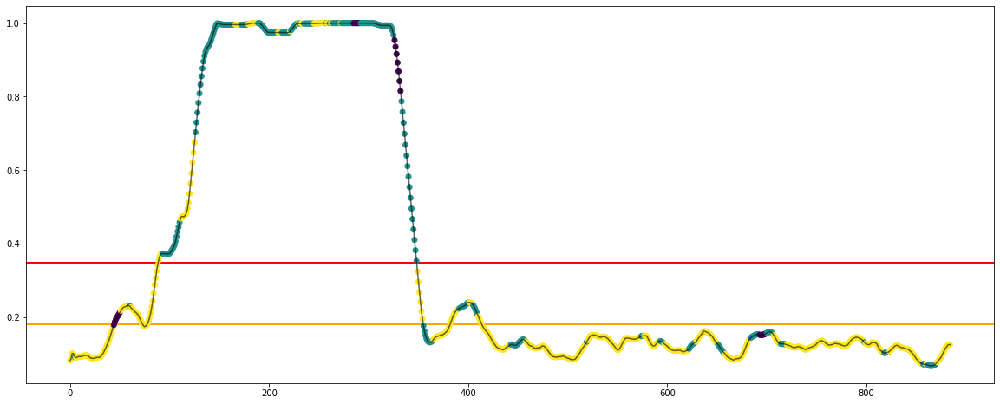

Experiment: 21_20151016_noon
Best Model:
	Score: 5.9893
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-06, 'tol': 0.001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.1377
	Calinski-Harabasz Index: 113.9660
	Davies Bouldin Index: 1.7770
Ha convergido? True, n_its: 14
[0.34 0.33 0.32]


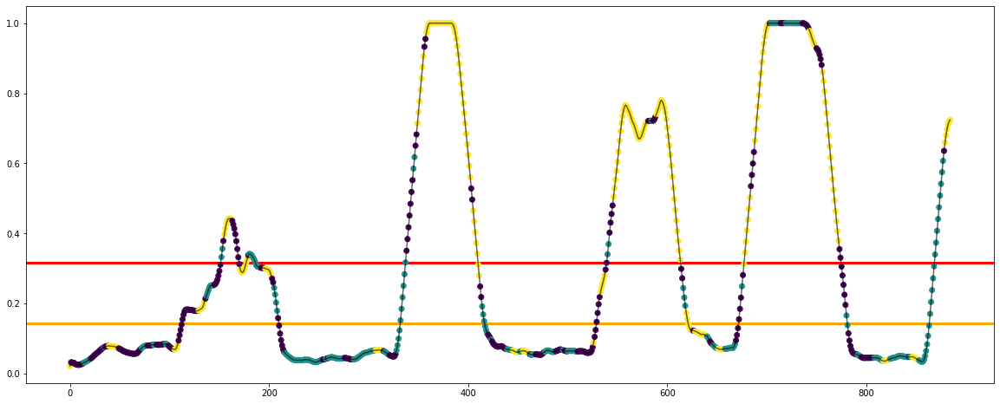

In [31]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = GaussianMixture(max_iter=200, random_state=42)

    space = dict()
    space['n_components'] = randint(2, 4)
    space['covariance_type'] = ['full', 'tied', 'diag', 'spherical']
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['reg_covar'] = [1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5]
    space['n_init'] = randint(1, 5)
    space['init_params'] = ['kmeans', 'random']
    space['warm_start'] = [True, False]

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all[key], y_all[key], model, space, cv=10, n_iter=30)
    
    print(f'Ha convergido? {best_model.converged_}, n_its: {best_model.n_iter_}')
    print(np.round(best_model.weights_,2))
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/GM-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 8.4080
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.3732
	Calinski-Harabasz Index: 226.9687
	Davies Bouldin Index: 1.8144
Ha convergido? True, n_its: 14
[0.11 0.39 0.5 ]


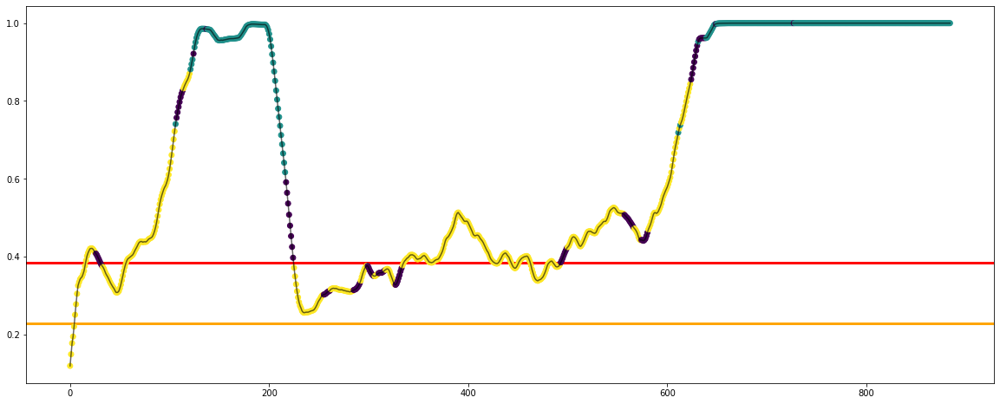

Experiment: 2_20151106_noon
Best Model:
	Score: 11.3474
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.1222
	Calinski-Harabasz Index: 219.5867
	Davies Bouldin Index: 2.4963
Ha convergido? True, n_its: 24
[0.33 0.08 0.59]


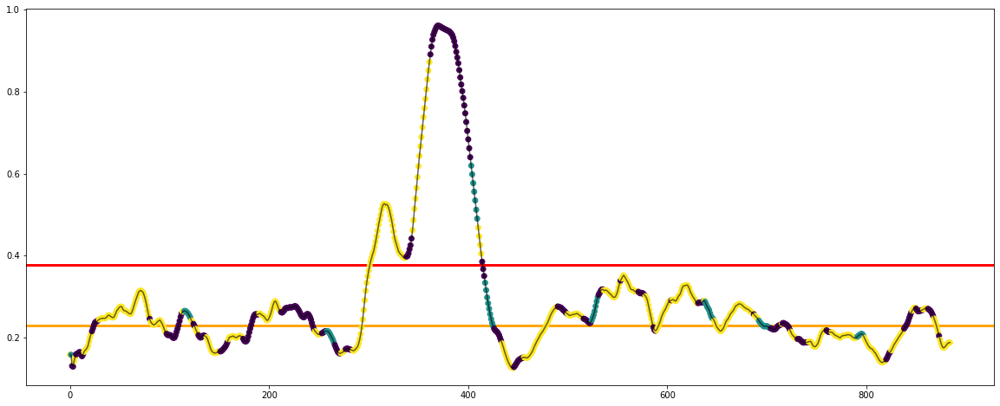

Experiment: 3_20151024_noon
Best Model:
	Score: 6.6894
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.1424
	Calinski-Harabasz Index: 128.6527
	Davies Bouldin Index: 2.0968
Ha convergido? True, n_its: 18
[0.57 0.07 0.36]


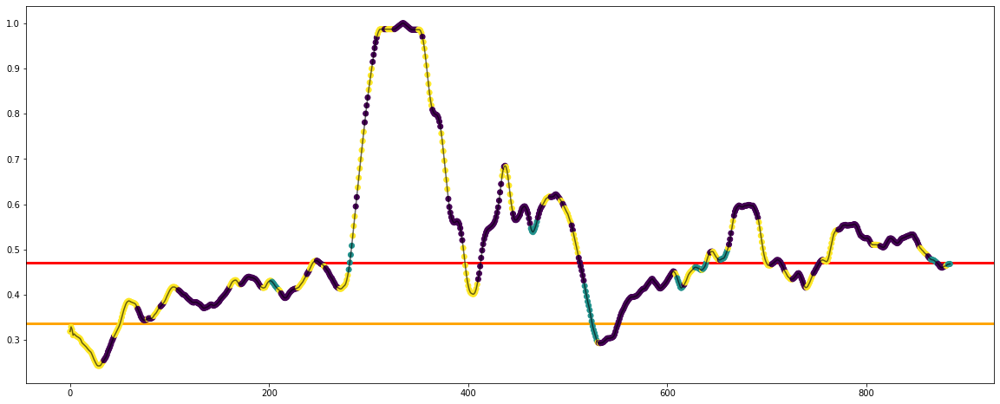

Experiment: 4_20151105_noon
Best Model:
	Score: 3.5638
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-07, 'tol': 1e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.1401
	Calinski-Harabasz Index: 203.5022
	Davies Bouldin Index: 1.7300
Ha convergido? True, n_its: 40
[0.49 0.31 0.2 ]


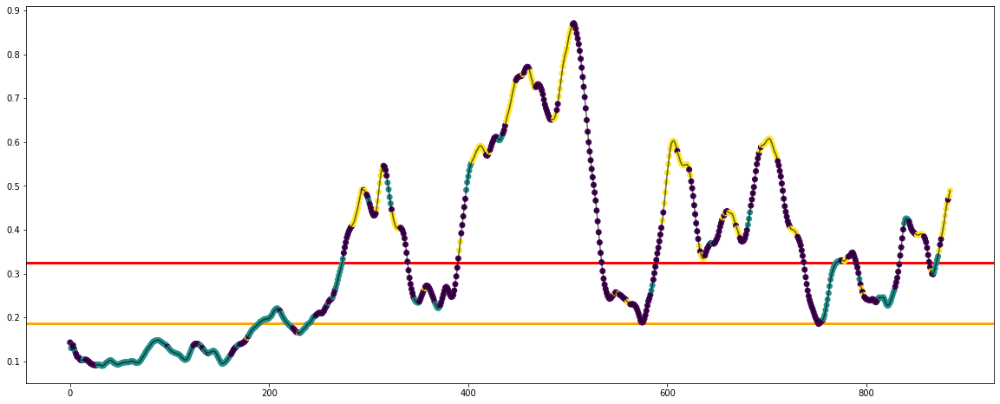

Experiment: 4_20151107_noon
Best Model:
	Score: 7.2579
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-07, 'tol': 1e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.1700
	Calinski-Harabasz Index: 214.6432
	Davies Bouldin Index: 1.5191
Ha convergido? True, n_its: 31
[0.53 0.25 0.22]


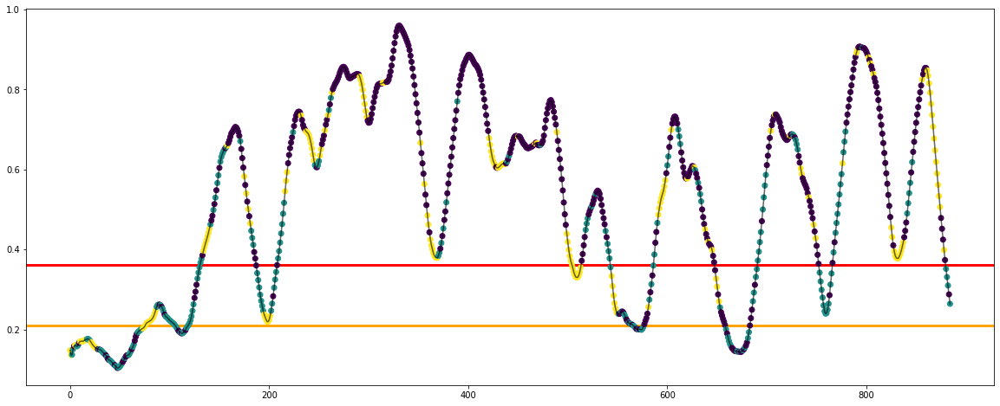

Experiment: 5_20141108_noon
Best Model:
	Score: 7.9219
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-07, 'tol': 0.001, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.1785
	Calinski-Harabasz Index: 152.5917
	Davies Bouldin Index: 1.7081
Ha convergido? True, n_its: 21
[0.43 0.21 0.36]


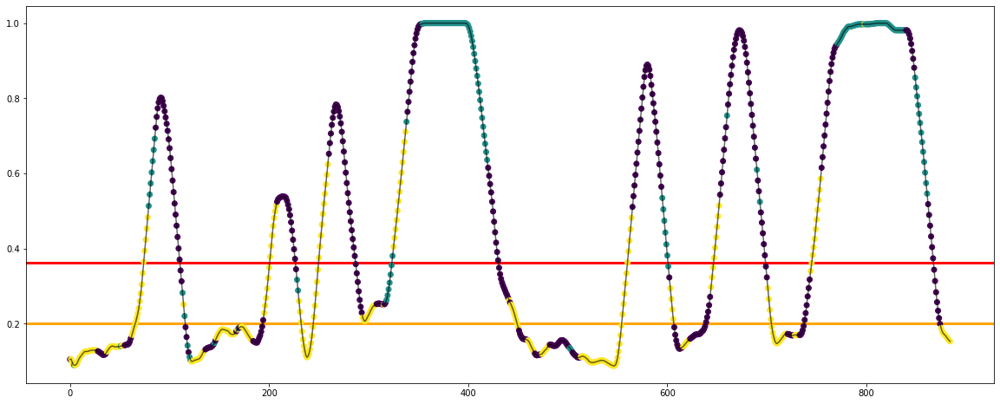

Experiment: 5_20151012_night
Best Model:
	Score: 4.2914
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.5120
	Calinski-Harabasz Index: 487.1175
	Davies Bouldin Index: 1.3528
Ha convergido? True, n_its: 12
[0.05 0.49 0.46]


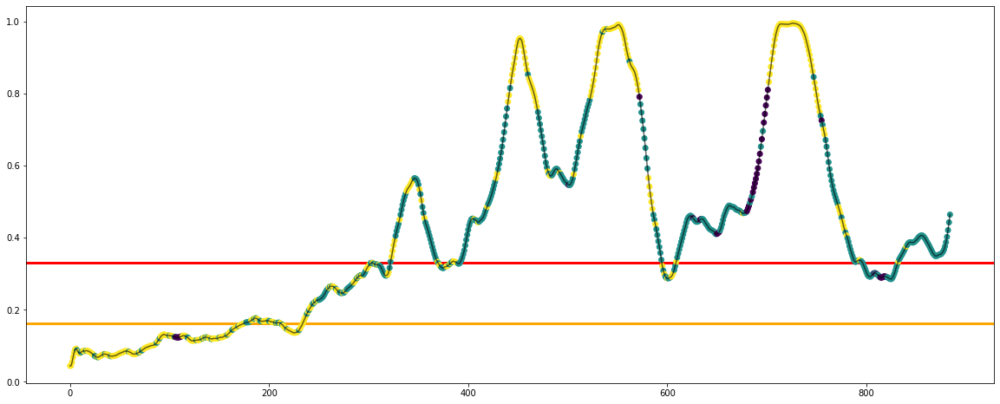

Experiment: 6_20151121_noon
Best Model:
	Score: 12.7917
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-06, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2519
	Calinski-Harabasz Index: 92.8916
	Davies Bouldin Index: 2.2034
Ha convergido? True, n_its: 43
[0.69 0.1  0.21]


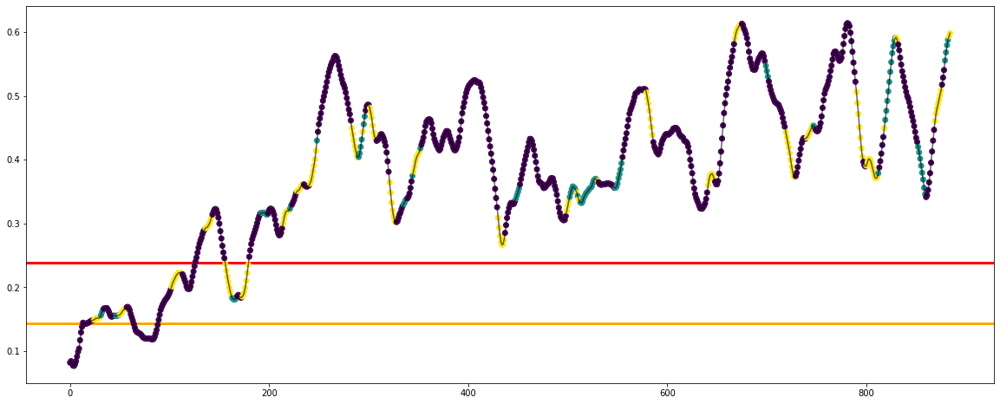

Experiment: 7_20151015_night
Best Model:
	Score: 4.1456
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-06, 'tol': 0.0005, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.3770
	Calinski-Harabasz Index: 236.6155
	Davies Bouldin Index: 1.6063
Ha convergido? True, n_its: 14
[0.06 0.15 0.79]


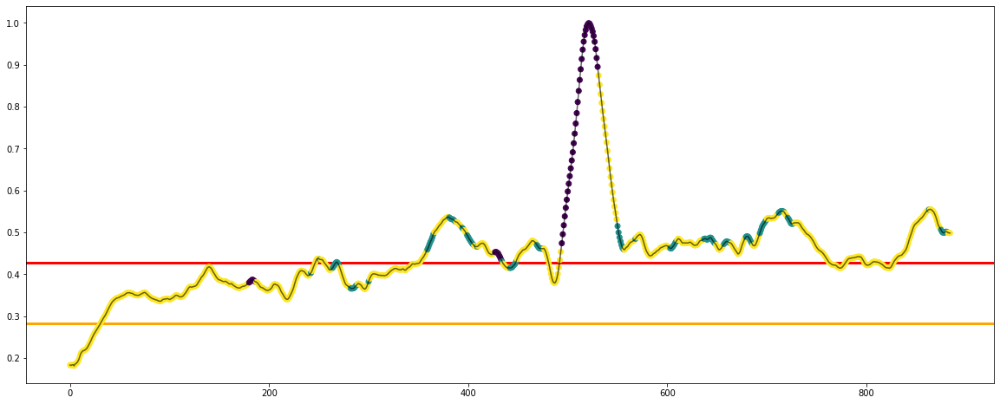

Experiment: 8_20151022_noon
Best Model:
	Score: 6.9896
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.5578
	Calinski-Harabasz Index: 357.3126
	Davies Bouldin Index: 1.2473
Ha convergido? True, n_its: 9
[0.42 0.41 0.17]


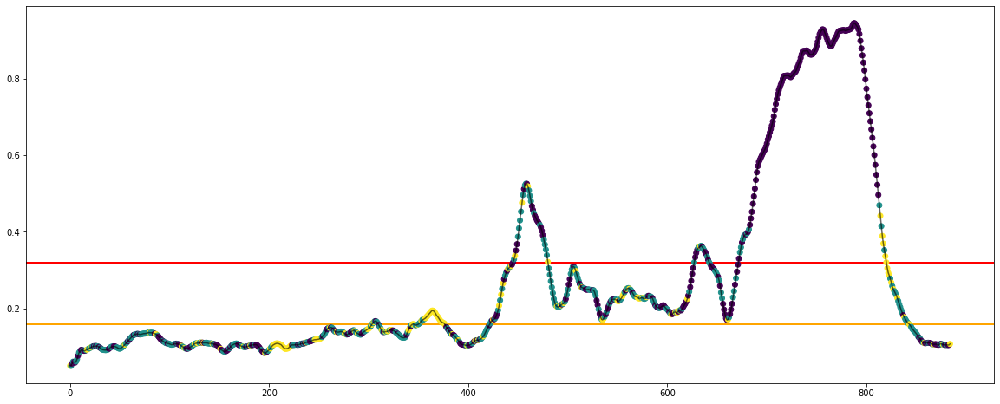

Experiment: 9_20151017_night
Best Model:
	Score: 9.6266
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-06, 'tol': 0.0005, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.1807
	Calinski-Harabasz Index: 150.2864
	Davies Bouldin Index: 2.2787
Ha convergido? True, n_its: 41
[0.27 0.15 0.58]


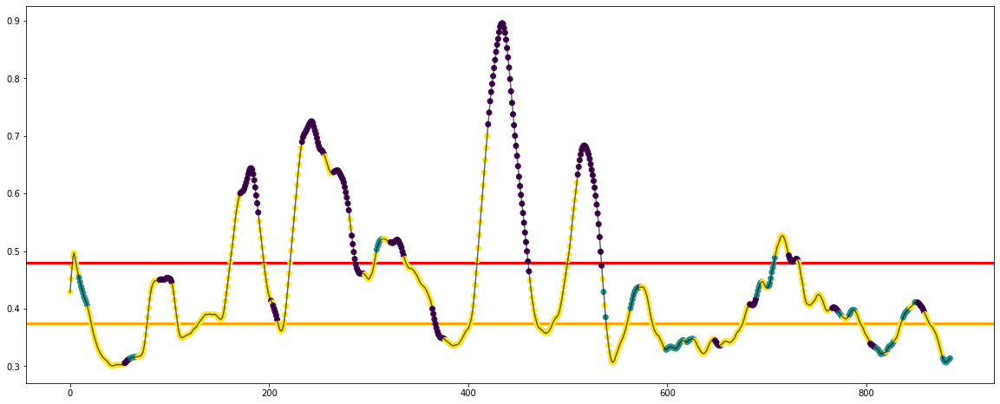

Experiment: 10_20151125_noon
Best Model:
	Score: 8.0500
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-06, 'tol': 0.001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.4616
	Calinski-Harabasz Index: 200.0910
	Davies Bouldin Index: 1.6142
Ha convergido? True, n_its: 10
[0.34 0.53 0.13]


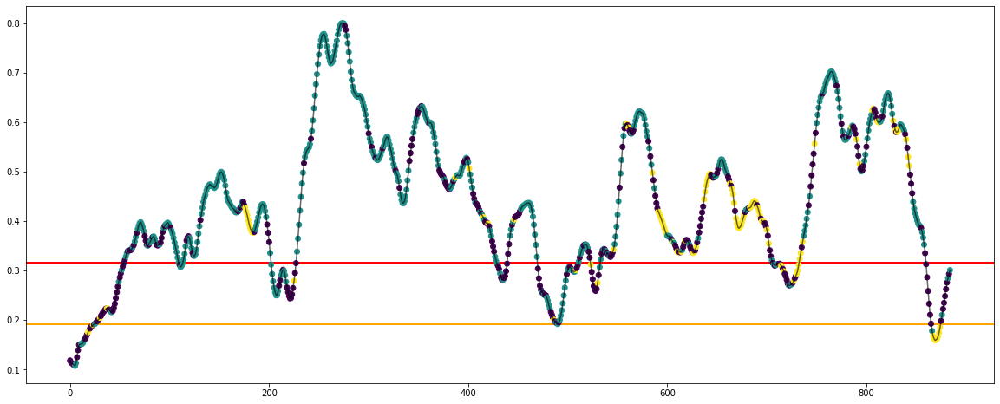

Experiment: 11_20151024_night
Best Model:
	Score: 7.0665
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 2, 'n_init': 3, 'reg_covar': 1e-06, 'tol': 0.0001, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.5719
	Calinski-Harabasz Index: 208.9049
	Davies Bouldin Index: 1.3686
Ha convergido? True, n_its: 5
[0.93 0.07]


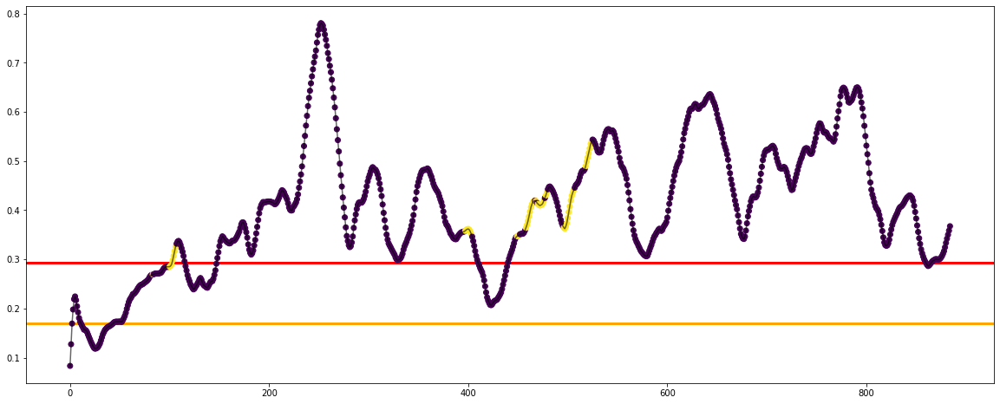

Experiment: 12_20150928_noon
Best Model:
	Score: 9.0682
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-07, 'tol': 0.001, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.3140
	Calinski-Harabasz Index: 264.5562
	Davies Bouldin Index: 1.6628
Ha convergido? True, n_its: 29
[0.35 0.11 0.54]


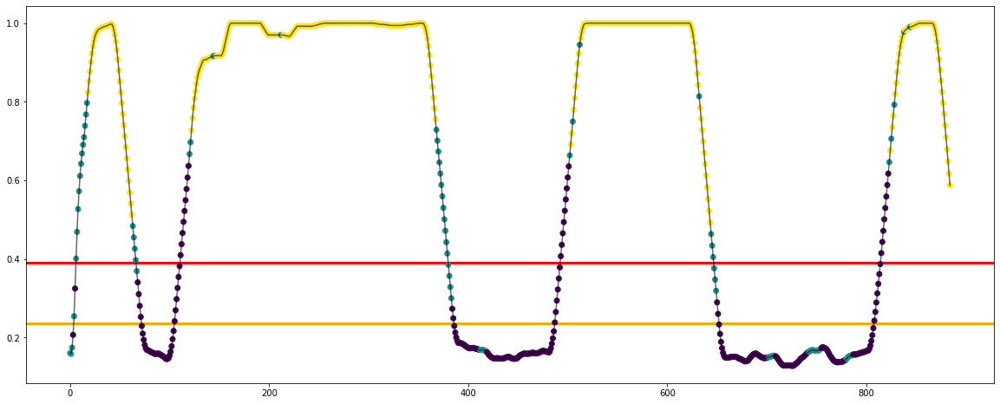

Experiment: 13_20150929_noon
Best Model:
	Score: 8.1163
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 1e-07, 'tol': 0.0005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.2828
	Calinski-Harabasz Index: 214.8512
	Davies Bouldin Index: 1.7704
Ha convergido? True, n_its: 12
[0.39 0.52 0.09]


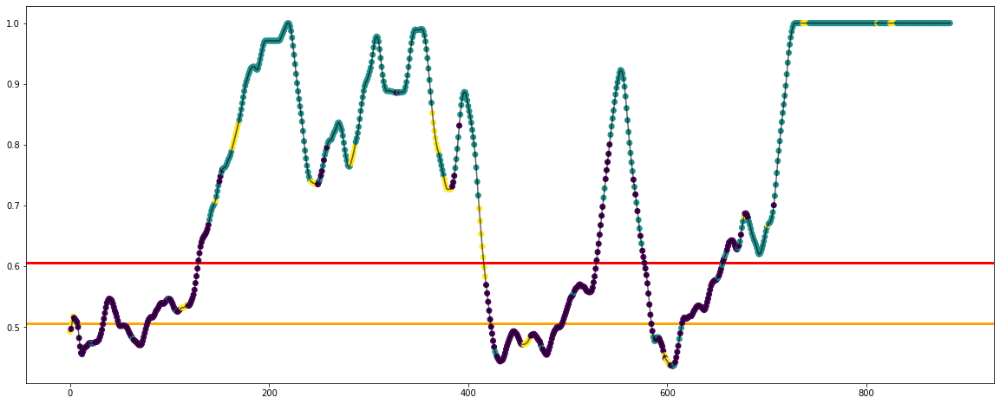

Experiment: 14_20151014_night
Best Model:
	Score: 5.8666
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 1e-07, 'tol': 0.0005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.1948
	Calinski-Harabasz Index: 92.3323
	Davies Bouldin Index: 2.2681
Ha convergido? True, n_its: 23
[0.2  0.61 0.19]


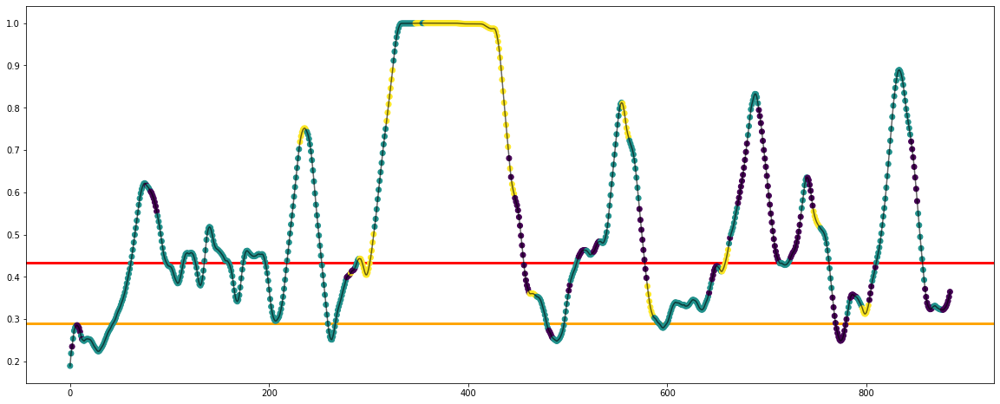

Experiment: 15_20151126_night
Best Model:
	Score: 5.3748
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.4113
	Calinski-Harabasz Index: 327.0016
	Davies Bouldin Index: 1.5788
Ha convergido? True, n_its: 12
[0.12 0.29 0.59]


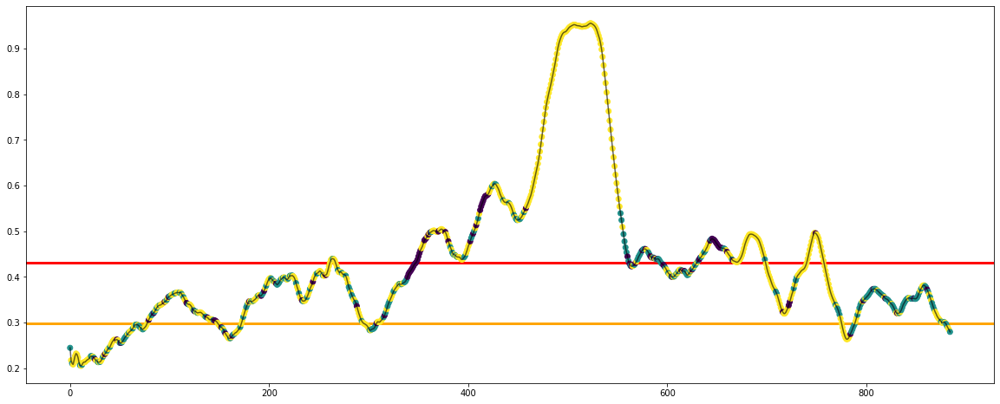

Experiment: 16_20151128_night
Best Model:
	Score: 14.6142
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-06, 'tol': 0.001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.4136
	Calinski-Harabasz Index: 127.7156
	Davies Bouldin Index: 1.0926
Ha convergido? True, n_its: 14
[0.55 0.25 0.2 ]


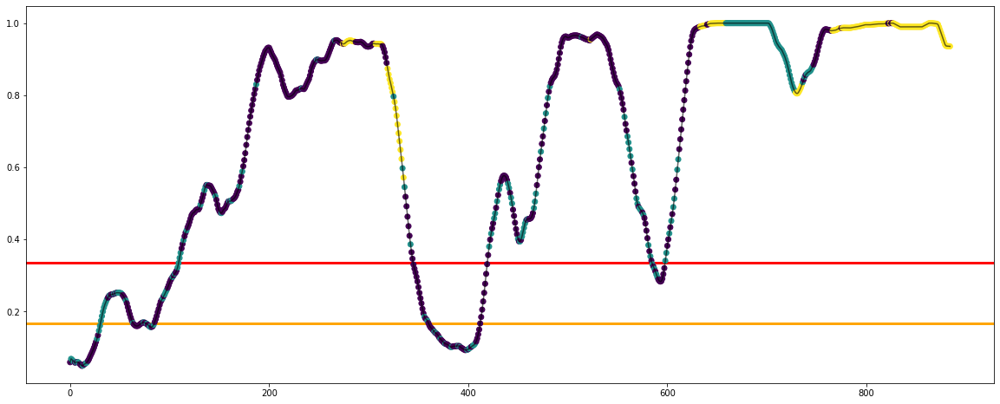

Experiment: 17_20150925_noon
Best Model:
	Score: 5.8722
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 3, 'reg_covar': 1e-07, 'tol': 1e-05, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.3607
	Calinski-Harabasz Index: 336.6733
	Davies Bouldin Index: 1.5403
Ha convergido? True, n_its: 15
[0.12 0.65 0.22]


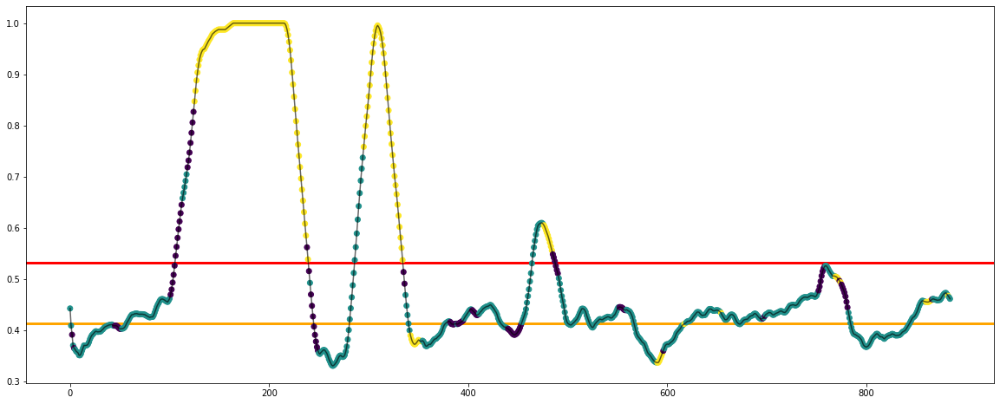

Experiment: 18_20150926_noon
Best Model:
	Score: 13.1804
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 1e-07, 'tol': 0.0005, 'warm_start': False}

Cluestering evaluation:
	Silhouette Coefficient: 0.3341
	Calinski-Harabasz Index: 225.8849
	Davies Bouldin Index: 1.6261
Ha convergido? True, n_its: 9
[0.36 0.48 0.16]


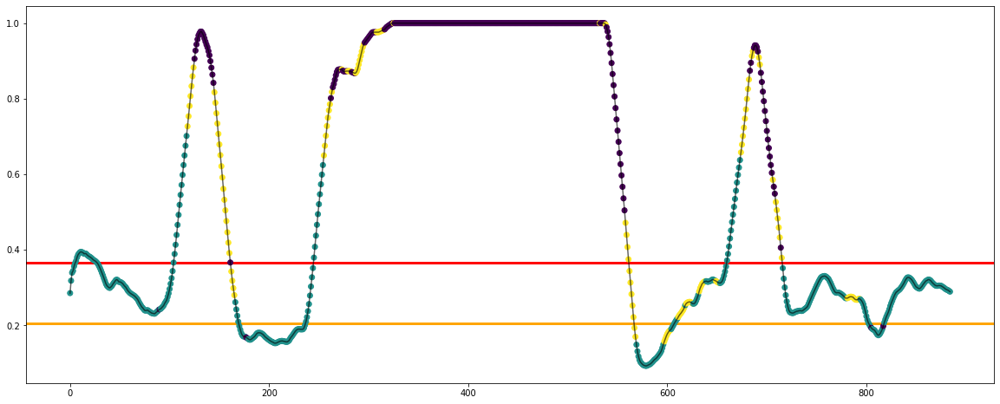

Experiment: 19_20151114_noon
Best Model:
	Score: 4.8669
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.4713
	Calinski-Harabasz Index: 336.4631
	Davies Bouldin Index: 1.3002
Ha convergido? True, n_its: 9
[0.25 0.62 0.12]


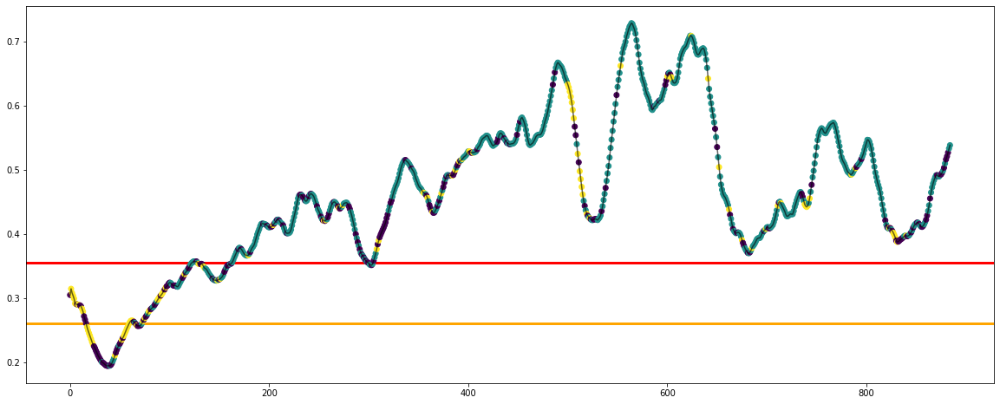

Experiment: 20_20151129_night
Best Model:
	Score: 11.2197
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.3140
	Calinski-Harabasz Index: 240.6325
	Davies Bouldin Index: 1.3914
Ha convergido? True, n_its: 17
[0.04 0.33 0.63]


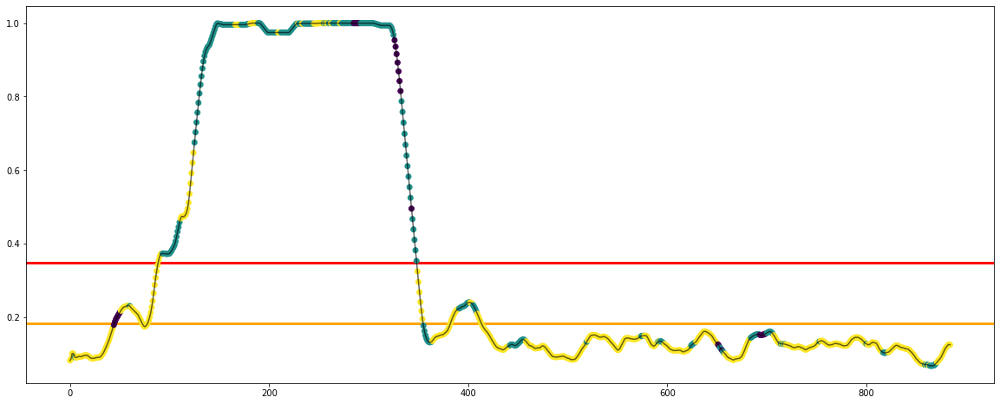

Experiment: 21_20151016_noon
Best Model:
	Score: 6.2797
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 1e-05, 'tol': 0.0001, 'warm_start': True}

Cluestering evaluation:
	Silhouette Coefficient: 0.2797
	Calinski-Harabasz Index: 155.5138
	Davies Bouldin Index: 1.8939
Ha convergido? True, n_its: 20
[0.25 0.6  0.15]


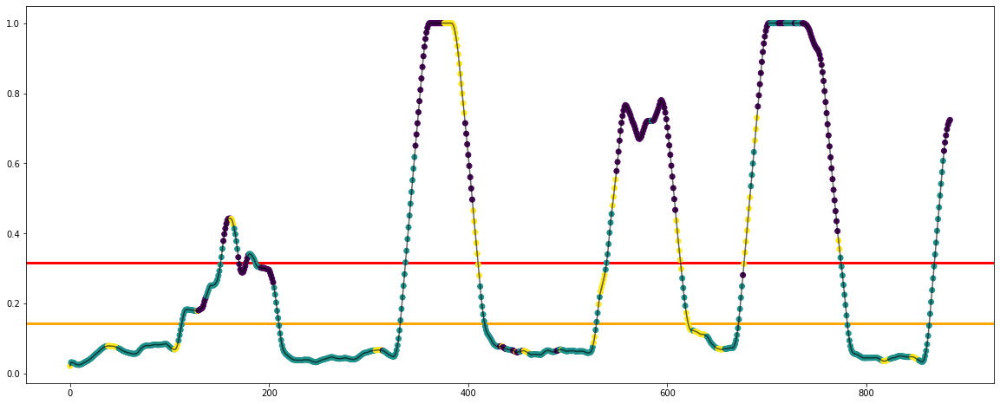

In [30]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = GaussianMixture(max_iter=200, random_state=42)

    space = dict()
    space['n_components'] = randint(2, 4)
    space['covariance_type'] = ['full', 'tied', 'diag', 'spherical']
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['reg_covar'] = [1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5]
    space['n_init'] = randint(1, 5)
    space['init_params'] = ['kmeans', 'random']
    space['warm_start'] = [True, False]

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all_eog[key], y_all[key], model, space, cv=10, n_iter=30)
    
    print(f'Ha convergido? {best_model.converged_}, n_its: {best_model.n_iter_}')
    print(np.round(best_model.weights_,2))
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/GM-PSD+EOG.csv', index=False)

### Resto de cosas de GM

In [39]:
from sklearn.mixture import GaussianMixture
def gm_predictions_plot(X, y, n=3):
    gm = GaussianMixture(n_components=n, n_init=50)
    gm.fit(X)
    predictions = gm.predict(X)

    plt.figure(figsize=(20, 8))
    plt.plot(y, color='gray')
    plt.scatter(range(len(predictions)), y, c=predictions)
    plt.title('GMM - Coloreado del valor PERCLOS y el cluster asociado')
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.show()

# BGM

In [32]:
from sklearn.mixture import BayesianGaussianMixture

### EEG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 153.3536
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-06, 'tol': 0.001, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.1151
	Calinski-Harabasz Index: 395.3694
	Davies Bouldin Index: 1.5782
Ha convergido? True, n_its: 59
[0.3  0.34 0.37]


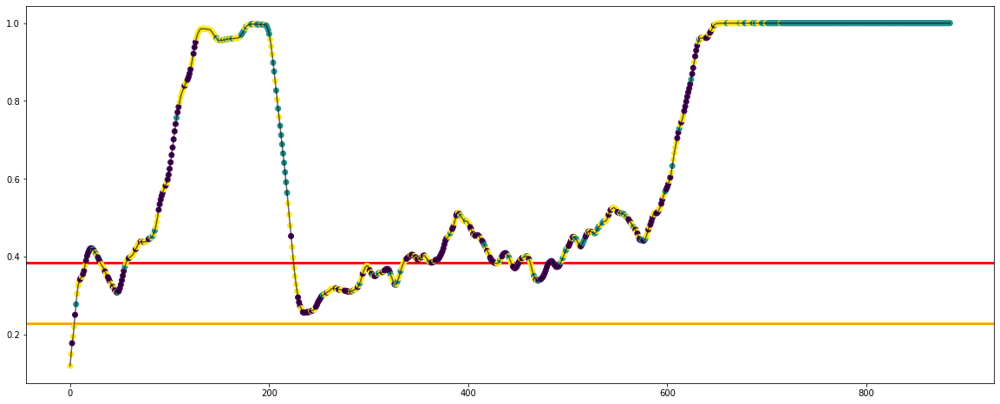

Experiment: 2_20151106_noon
Best Model:
	Score: 354.7910
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.5786
	Calinski-Harabasz Index: 73.4069
	Davies Bouldin Index: 3.4182
Ha convergido? True, n_its: 48
[0.93 0.03 0.04]


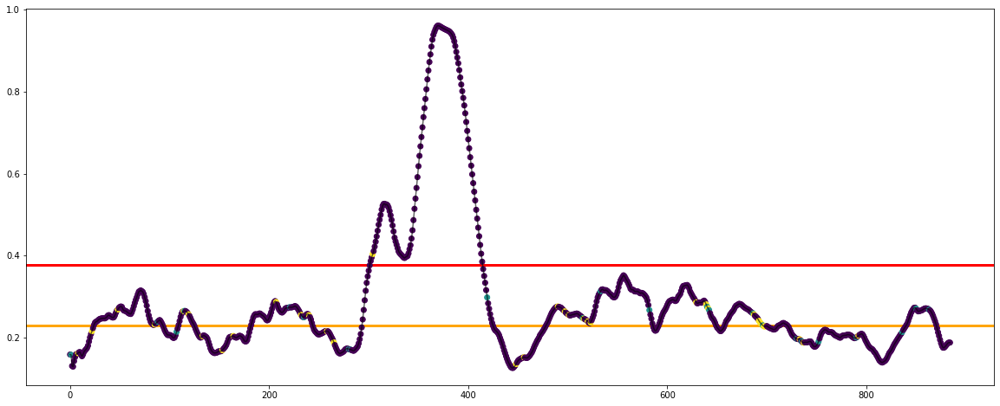

Experiment: 3_20151024_noon
Best Model:
	Score: 157.0203
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2630
	Calinski-Harabasz Index: 248.0000
	Davies Bouldin Index: 1.6796
Ha convergido? True, n_its: 44
[0.65 0.35 0.  ]


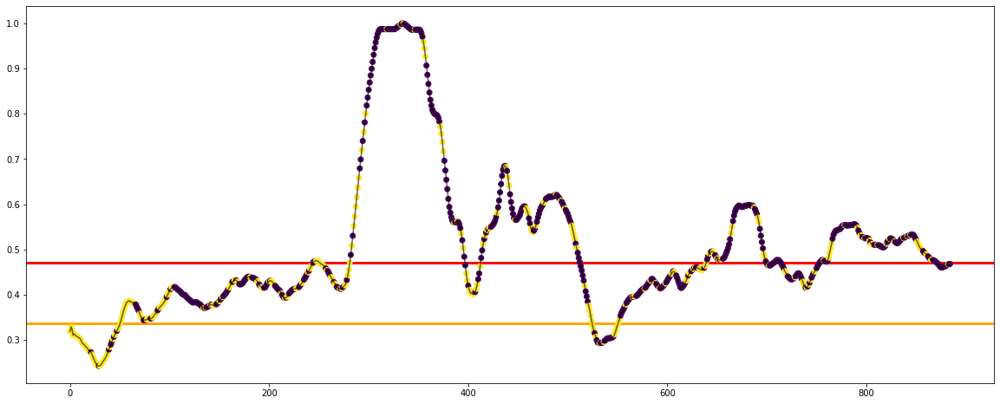

Experiment: 4_20151105_noon
Best Model:
	Score: 260.5065
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2256
	Calinski-Harabasz Index: 166.6262
	Davies Bouldin Index: 1.8585
Ha convergido? True, n_its: 188
[0.18 0.05 0.77]


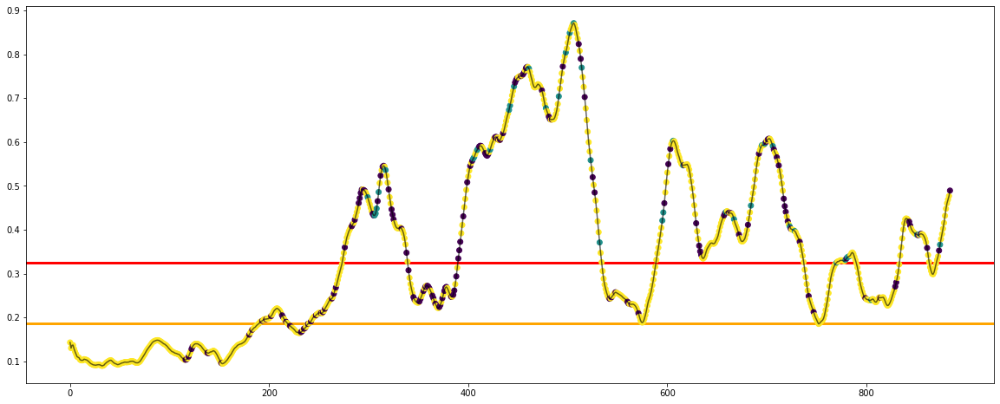

Experiment: 4_20151107_noon
Best Model:
	Score: 221.5106
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2331
	Calinski-Harabasz Index: 96.1118
	Davies Bouldin Index: 3.9330
Ha convergido? True, n_its: 200
[0.12 0.1  0.79]


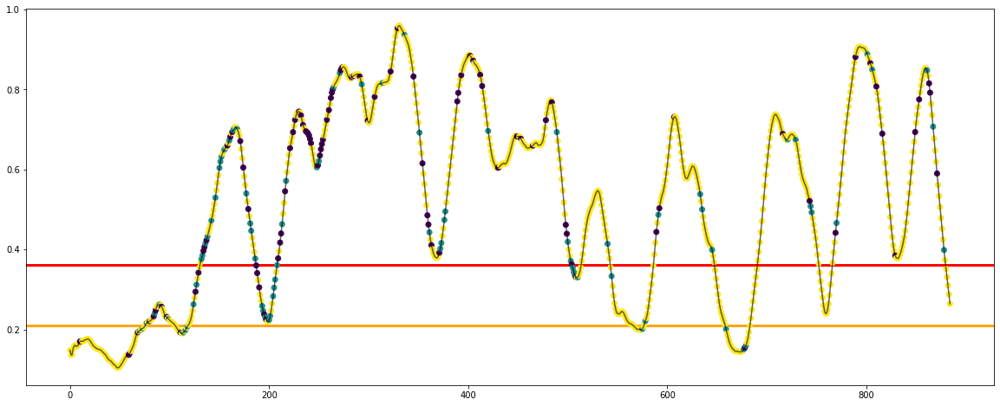

Experiment: 5_20141108_noon
Best Model:
	Score: 165.0124
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2816
	Calinski-Harabasz Index: 290.3919
	Davies Bouldin Index: 1.5230
Ha convergido? True, n_its: 20
[0.41 0.58 0.  ]


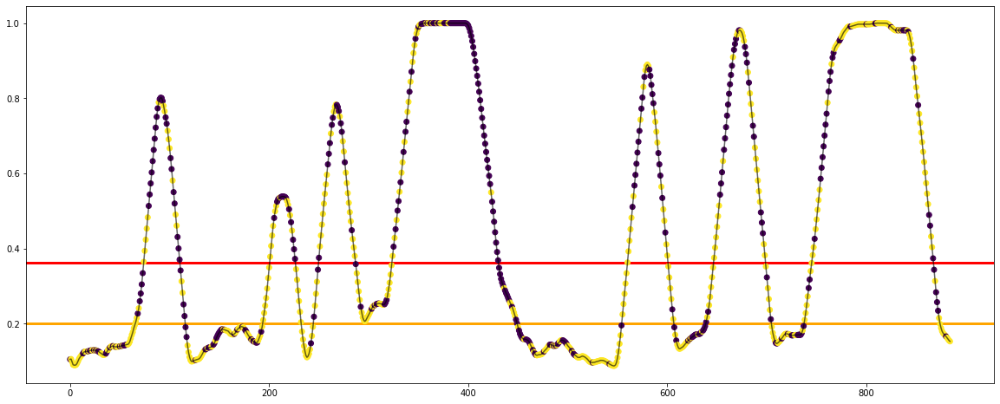

Experiment: 5_20151012_night
Best Model:
	Score: 177.1128
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2375
	Calinski-Harabasz Index: 219.0358
	Davies Bouldin Index: 1.6261
Ha convergido? True, n_its: 27
[0.52 0.   0.48]


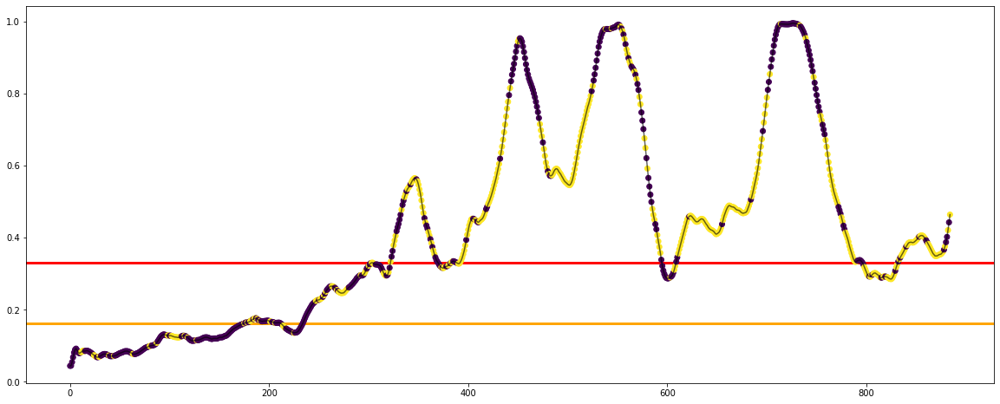

Experiment: 6_20151121_noon
Best Model:
	Score: 257.3828
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 2, 'n_init': 4, 'reg_covar': 1e-07, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3428
	Calinski-Harabasz Index: 191.7894
	Davies Bouldin Index: 1.8746
Ha convergido? True, n_its: 22
[0.67 0.33]


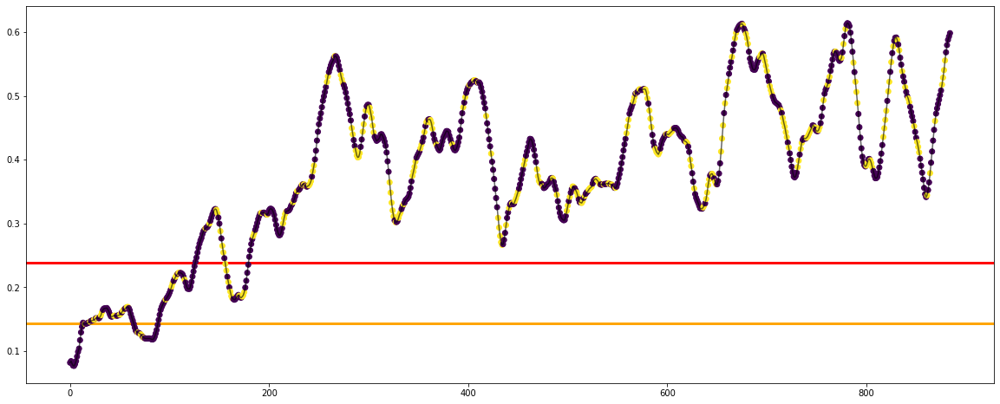

Experiment: 7_20151015_night
Best Model:
	Score: 169.6086
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2663
	Calinski-Harabasz Index: 205.4729
	Davies Bouldin Index: 1.8553
Ha convergido? True, n_its: 56
[0.66 0.34 0.  ]


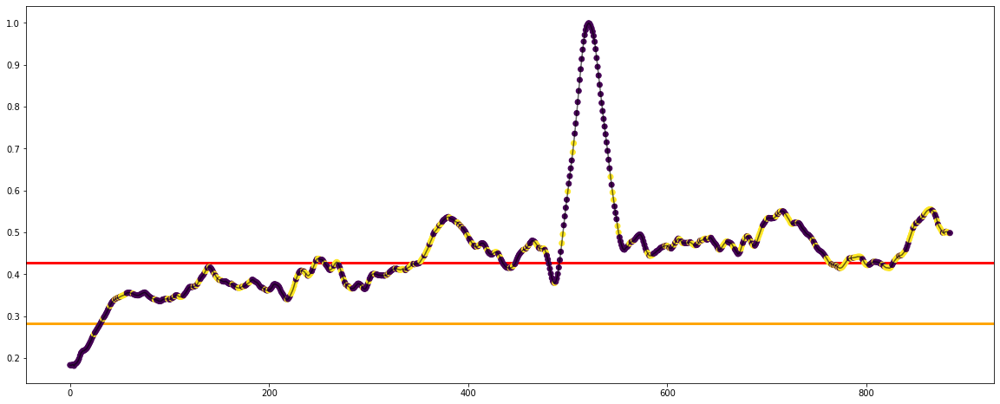

Experiment: 8_20151022_noon
Best Model:
	Score: 204.5692
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 2, 'n_init': 4, 'reg_covar': 1e-07, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3511
	Calinski-Harabasz Index: 236.5822
	Davies Bouldin Index: 1.7286
Ha convergido? True, n_its: 20
[0.69 0.31]


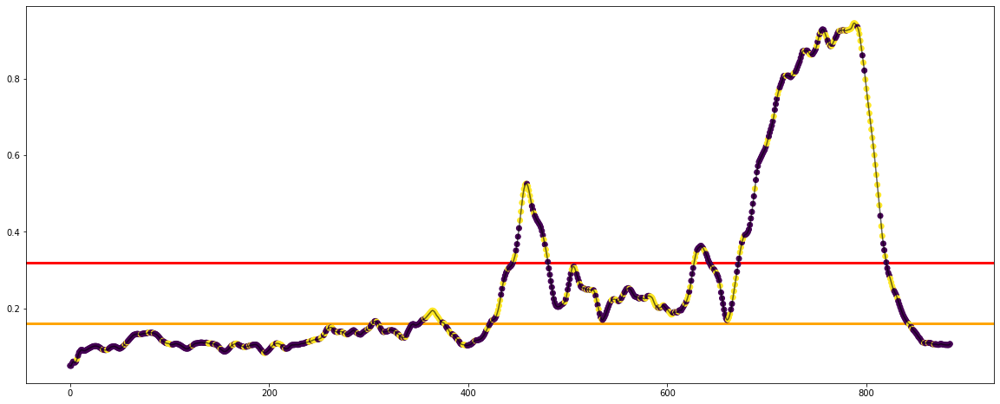

Experiment: 9_20151017_night
Best Model:
	Score: 283.1365
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 2, 'n_init': 3, 'reg_covar': 5e-07, 'tol': 0.0005, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4512
	Calinski-Harabasz Index: 196.6837
	Davies Bouldin Index: 1.7328
Ha convergido? True, n_its: 14
[0.77 0.23]


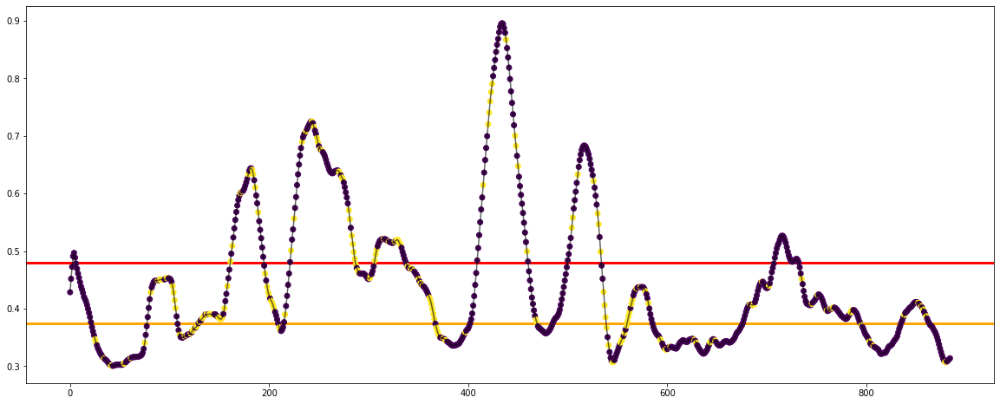

Experiment: 10_20151125_noon
Best Model:
	Score: 186.1500
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2681
	Calinski-Harabasz Index: 130.6853
	Davies Bouldin Index: 2.0489
Ha convergido? True, n_its: 200
[0.04 0.24 0.73]


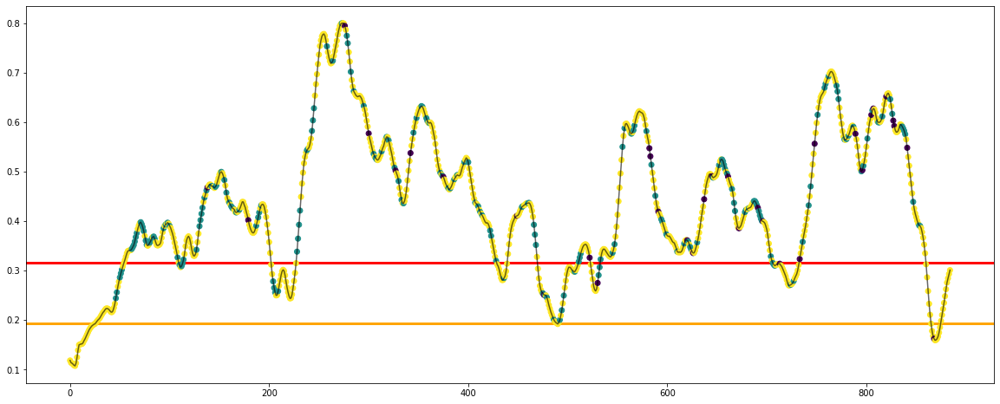

Experiment: 11_20151024_night
Best Model:
	Score: 178.5991
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2331
	Calinski-Harabasz Index: 211.7280
	Davies Bouldin Index: 1.7360
Ha convergido? True, n_its: 33
[0.57 0.   0.43]


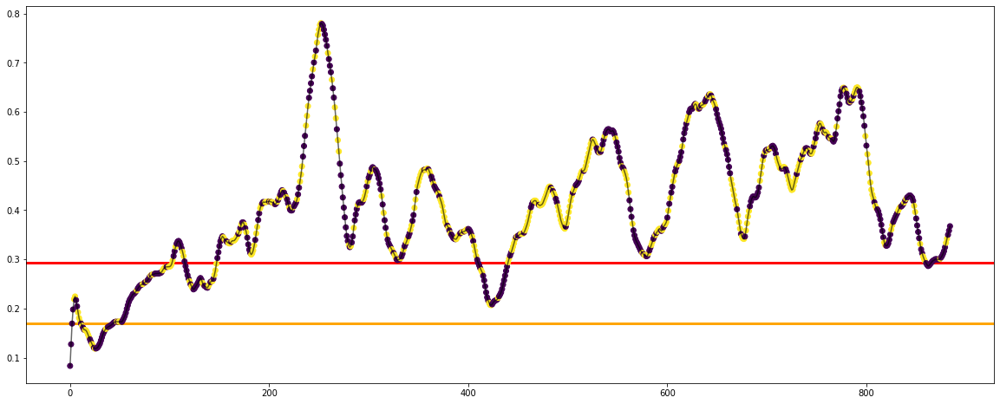

Experiment: 12_20150928_noon
Best Model:
	Score: 334.8686
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3601
	Calinski-Harabasz Index: 149.2884
	Davies Bouldin Index: 1.8257
Ha convergido? True, n_its: 132
[0.75 0.02 0.24]


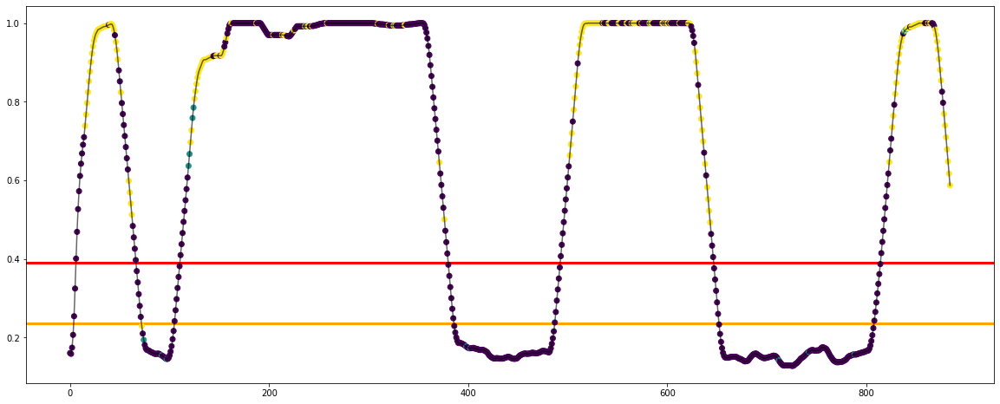

Experiment: 13_20150929_noon
Best Model:
	Score: 144.4024
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.1445
	Calinski-Harabasz Index: 143.9739
	Davies Bouldin Index: 1.7625
Ha convergido? True, n_its: 106
[0.43 0.4  0.17]


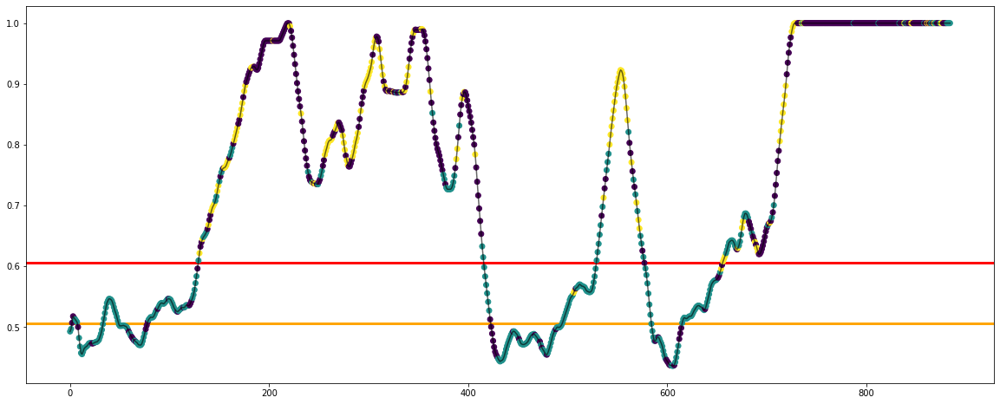

Experiment: 14_20151014_night
Best Model:
	Score: 242.8278
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2518
	Calinski-Harabasz Index: 220.1085
	Davies Bouldin Index: 1.8880
Ha convergido? True, n_its: 26
[0.41 0.07 0.52]


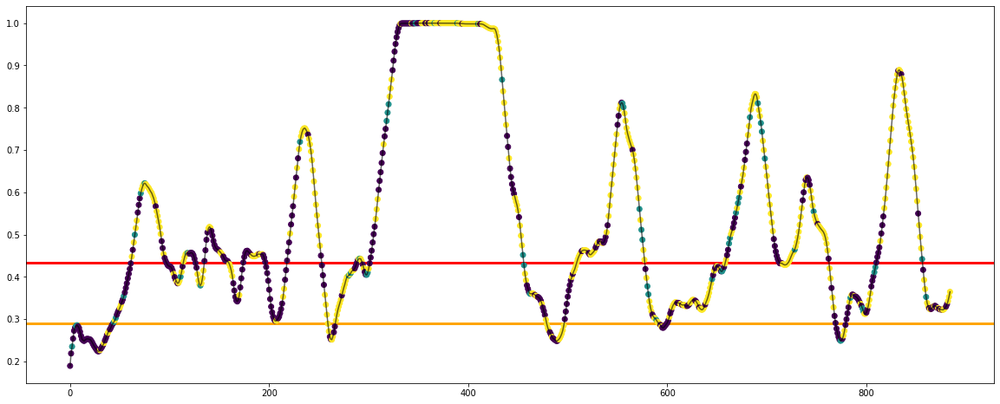

Experiment: 15_20151126_night
Best Model:
	Score: 241.8019
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-05, 'tol': 0.0005, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4426
	Calinski-Harabasz Index: 164.0100
	Davies Bouldin Index: 3.9862
Ha convergido? True, n_its: 80
[0.1  0.82 0.08]


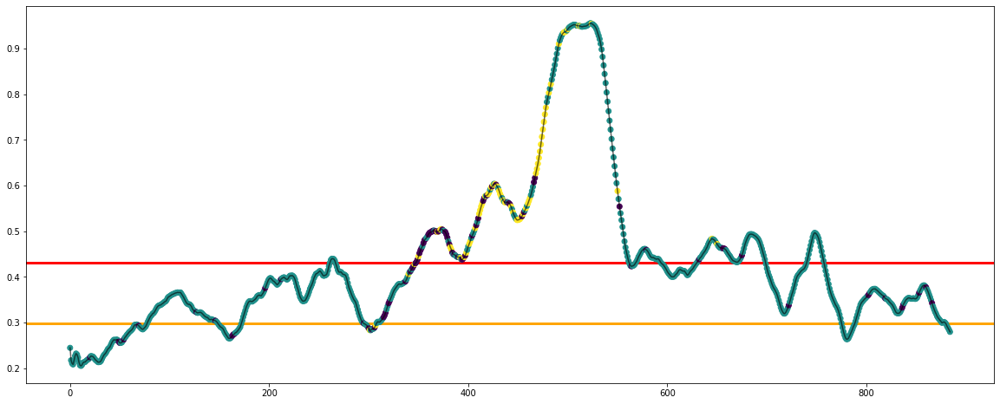

Experiment: 16_20151128_night
Best Model:
	Score: 340.7007
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.6400
	Calinski-Harabasz Index: 264.3341
	Davies Bouldin Index: 1.8994
Ha convergido? True, n_its: 175
[0.95 0.02 0.03]


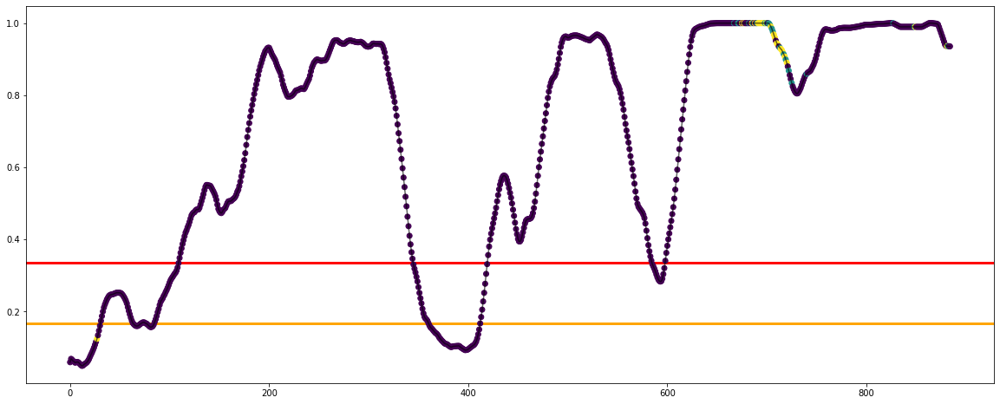

Experiment: 17_20150925_noon
Best Model:
	Score: 221.9955
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2720
	Calinski-Harabasz Index: 124.9349
	Davies Bouldin Index: 2.6166
Ha convergido? True, n_its: 137
[0.73 0.09 0.18]


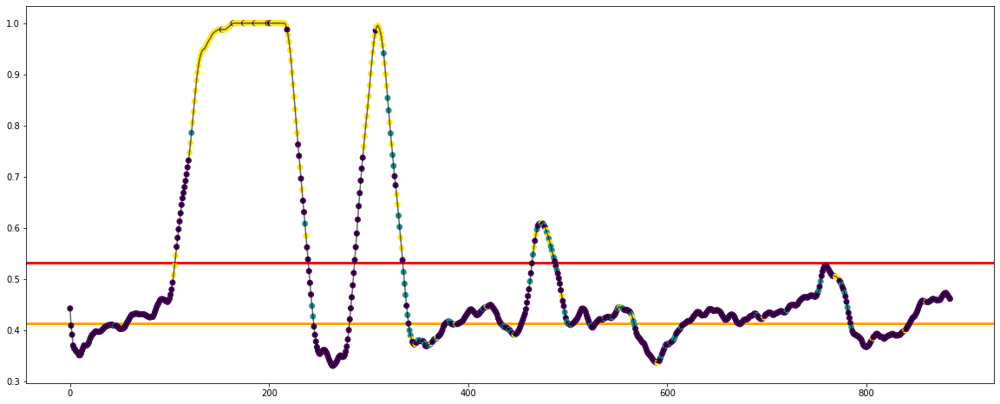

Experiment: 18_20150926_noon
Best Model:
	Score: 244.9018
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4638
	Calinski-Harabasz Index: 255.9416
	Davies Bouldin Index: 0.8698
Ha convergido? True, n_its: 21
[0.73 0.   0.27]


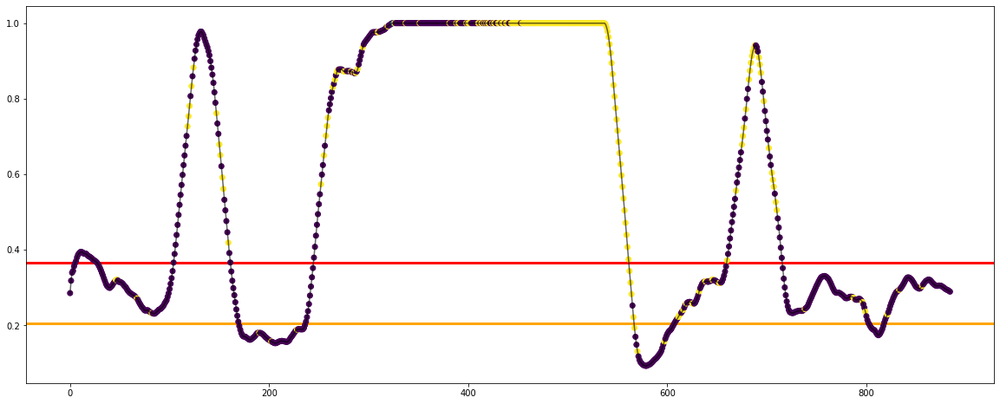

Experiment: 19_20151114_noon
Best Model:
	Score: 124.2451
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2572
	Calinski-Harabasz Index: 332.4233
	Davies Bouldin Index: 1.5312
Ha convergido? True, n_its: 17
[0.44 0.56 0.  ]


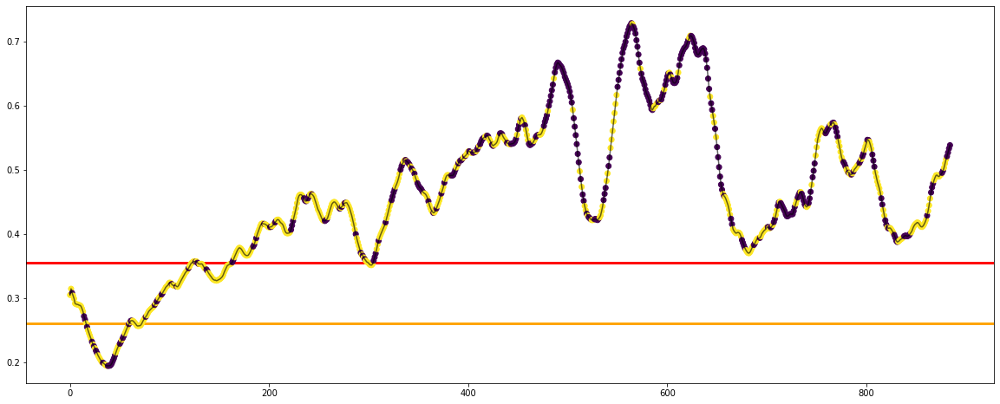

Experiment: 20_20151129_night
Best Model:
	Score: 169.8693
	Hyperparameters: {'covariance_type': 'tied', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3747
	Calinski-Harabasz Index: 292.3380
	Davies Bouldin Index: 1.7173
Ha convergido? True, n_its: 127
[0.78 0.04 0.18]


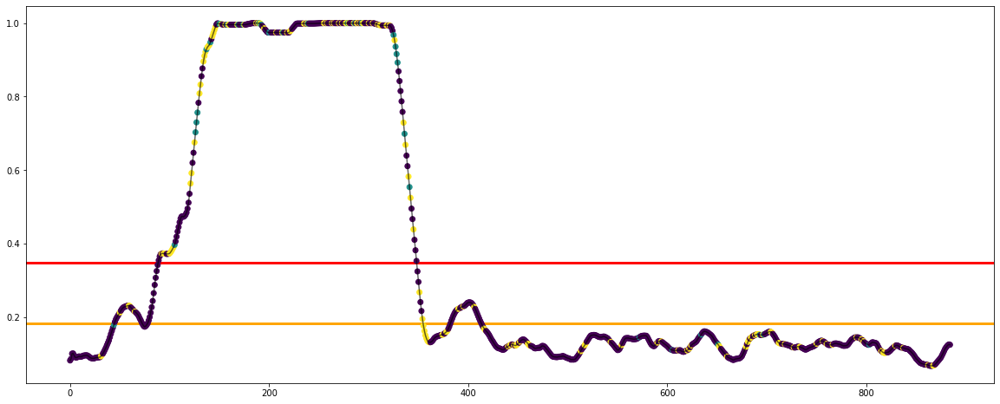

Experiment: 21_20151016_noon
Best Model:
	Score: 243.9338
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2949
	Calinski-Harabasz Index: 148.3394
	Davies Bouldin Index: 2.3179
Ha convergido? True, n_its: 72
[0.43 0.53 0.05]


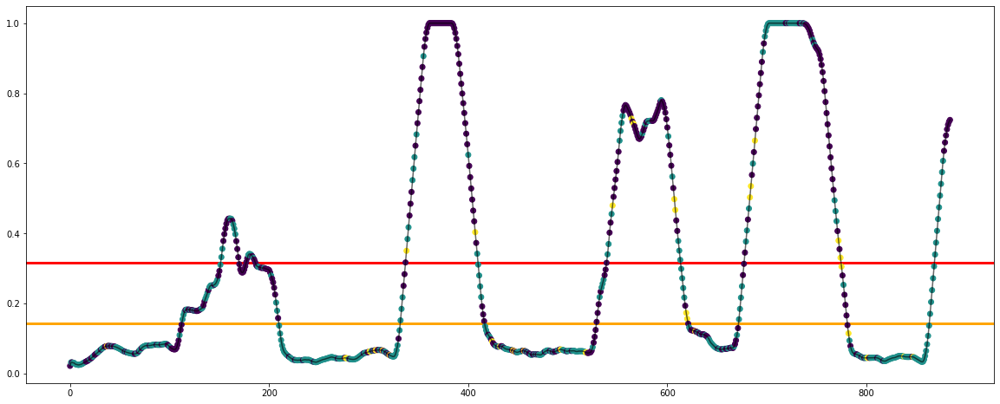

In [50]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    X, y = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)
    
    print(f"Experiment: {key}")
    model = BayesianGaussianMixture(max_iter=200, random_state=42)

    space = dict()
    space['n_components'] = randint(2, 4)
    space['covariance_type'] = ['full', 'tied', 'diag', 'spherical']
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['reg_covar'] = [1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5]
    space['n_init'] = randint(1, 5)
    space['init_params'] = ['kmeans', 'random']
    space['weight_concentration_prior_type'] = ['dirichlet_process', 'dirichlet_distribution']
    space['warm_start'] = [True, False]

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_minmax, y_all[key], model, space, cv=10, n_iter=20)
    
    print(f'Ha convergido? {best_model.converged_}, n_its: {best_model.n_iter_}')
    print(np.round(best_model.weights_,2))
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_minmax, y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/BGM-EEG.csv', index=False)

### PSD

Experiment: 1_20151124_noon_2
Best Model:
	Score: 7.3048
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4756
	Calinski-Harabasz Index: 284.6193
	Davies Bouldin Index: 1.6064
Ha convergido? True, n_its: 49
[0.08 0.41 0.52]


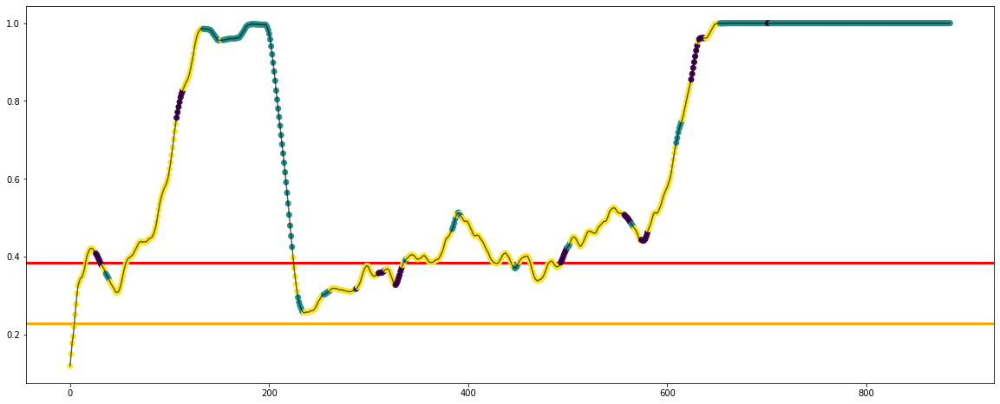

Experiment: 2_20151106_noon
Best Model:
	Score: 10.4270
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-06, 'tol': 1e-05, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3319
	Calinski-Harabasz Index: 278.5451
	Davies Bouldin Index: 1.1592
Ha convergido? True, n_its: 95
[0.51 0.39 0.1 ]


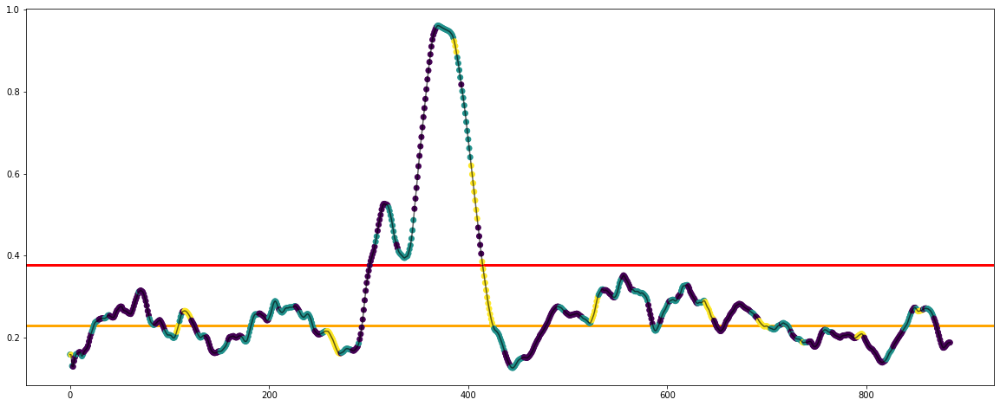

Experiment: 3_20151024_noon
Best Model:
	Score: 6.2981
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2330
	Calinski-Harabasz Index: 216.4501
	Davies Bouldin Index: 1.5484
Ha convergido? True, n_its: 108
[0.37 0.55 0.07]


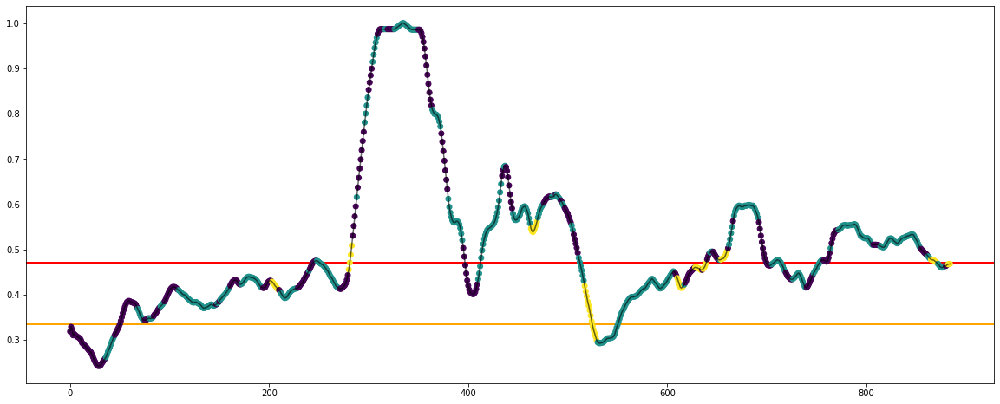

Experiment: 4_20151105_noon
Best Model:
	Score: 3.0488
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 2, 'reg_covar': 5e-06, 'tol': 0.001, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3904
	Calinski-Harabasz Index: 568.9469
	Davies Bouldin Index: 0.8898
Ha convergido? True, n_its: 55
[0.41 0.44 0.15]


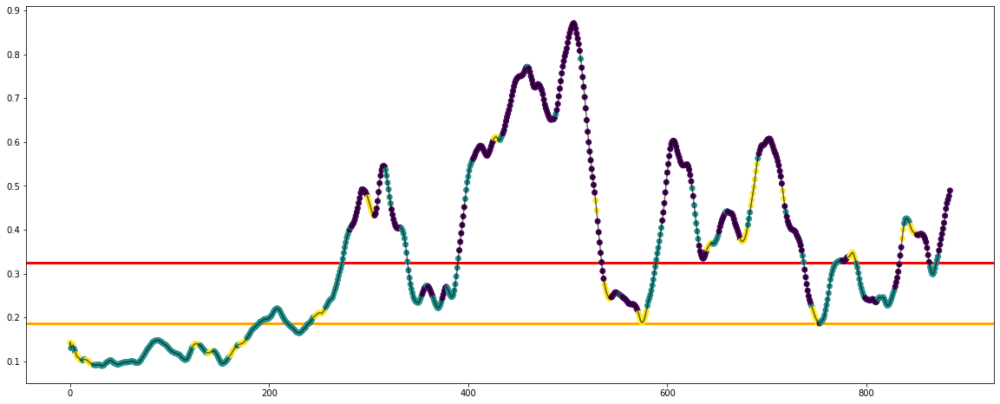

Experiment: 4_20151107_noon
Best Model:
	Score: 3.9466
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 2, 'n_init': 2, 'reg_covar': 1e-05, 'tol': 0.005, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2756
	Calinski-Harabasz Index: 249.1603
	Davies Bouldin Index: 1.6489
Ha convergido? True, n_its: 32
[0.31 0.69]


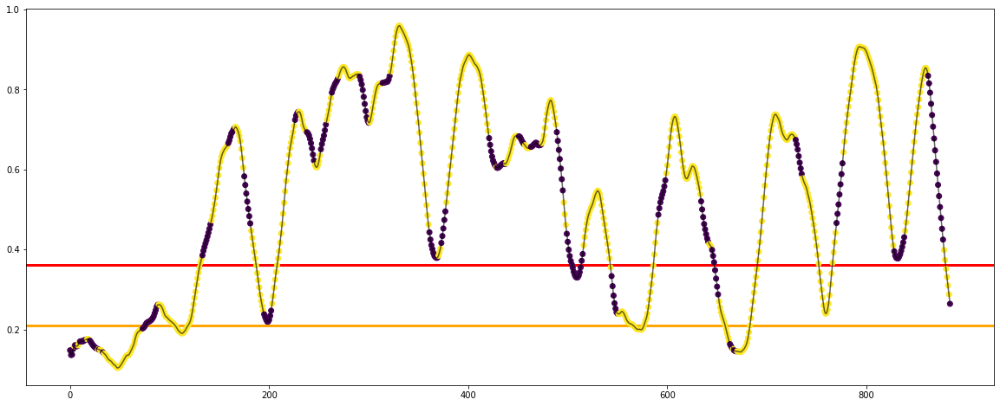

Experiment: 5_20141108_noon
Best Model:
	Score: 6.4166
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2943
	Calinski-Harabasz Index: 222.8782
	Davies Bouldin Index: 1.6023
Ha convergido? True, n_its: 35
[0.23 0.4  0.37]


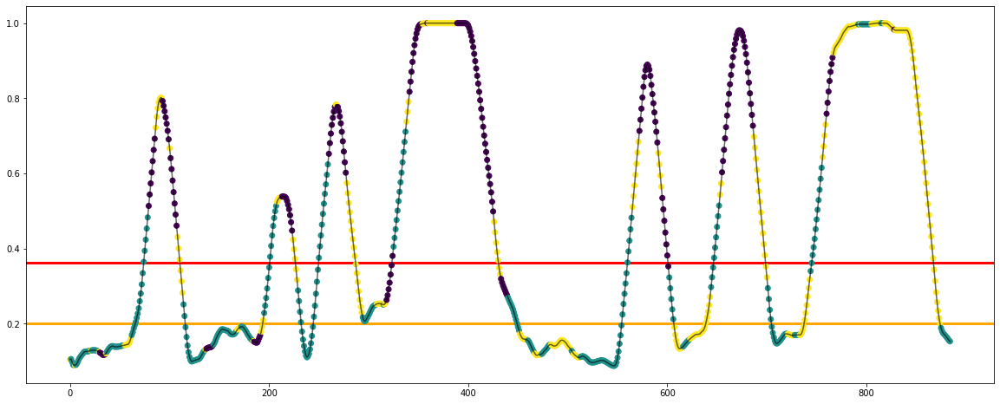

Experiment: 5_20151012_night
Best Model:
	Score: 7.7783
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4967
	Calinski-Harabasz Index: 302.9831
	Davies Bouldin Index: 1.1193
Ha convergido? True, n_its: 70
[0.05 0.37 0.58]


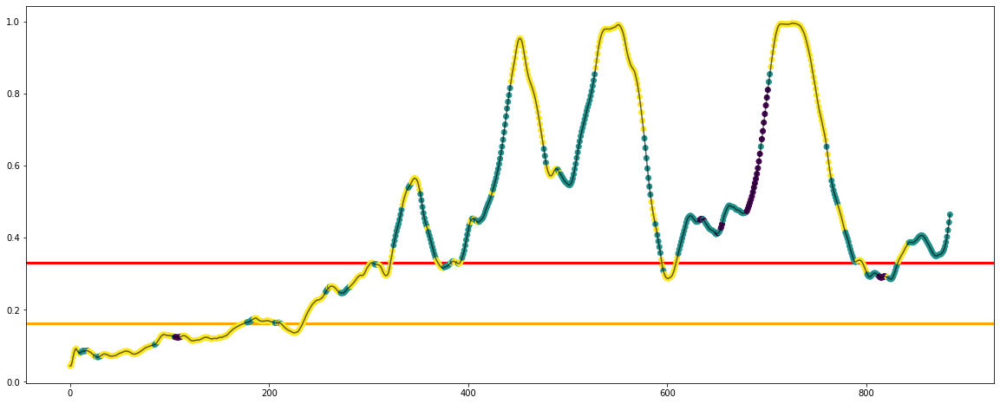

Experiment: 6_20151121_noon
Best Model:
	Score: 13.7884
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-07, 'tol': 0.0005, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.6535
	Calinski-Harabasz Index: 449.7413
	Davies Bouldin Index: 0.7345
Ha convergido? True, n_its: 12
[0.24 0.75 0.01]


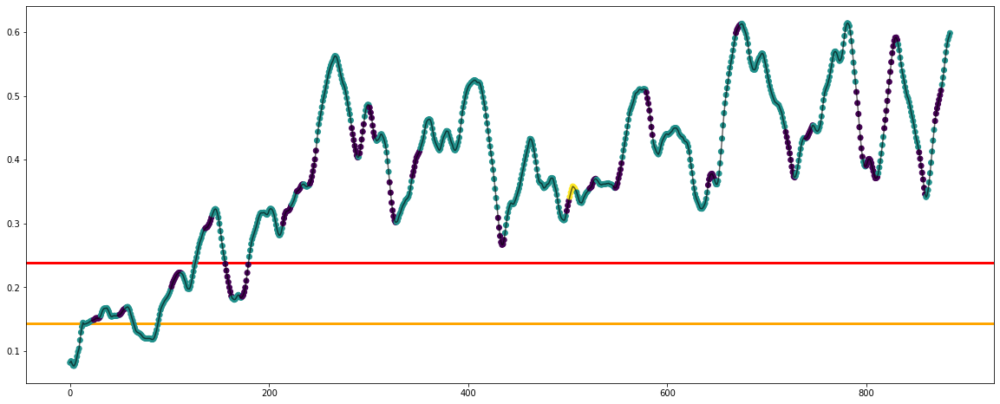

Experiment: 7_20151015_night
Best Model:
	Score: 4.0287
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-06, 'tol': 1e-05, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3111
	Calinski-Harabasz Index: 465.2150
	Davies Bouldin Index: 1.0768
Ha convergido? False, n_its: 200
[0.37 0.35 0.28]


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\mixture\_base.py:269: ConvergenceWarning: Initialization 3 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  % (init + 1), ConvergenceWarning)


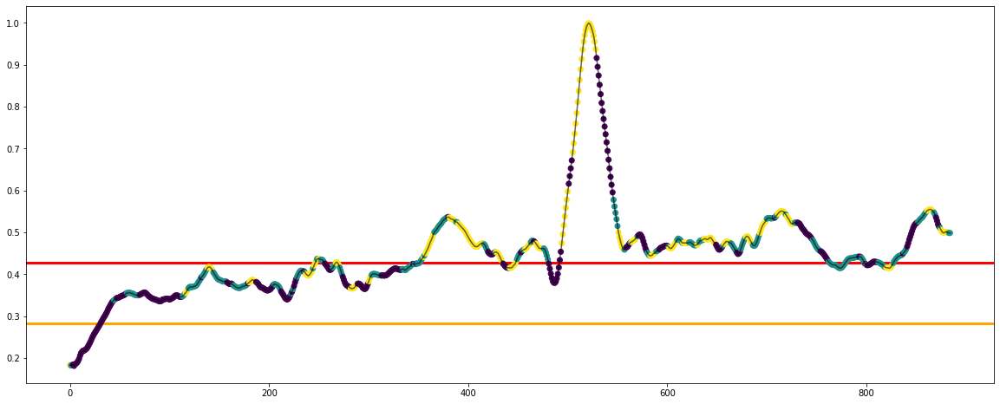

Experiment: 8_20151022_noon
Best Model:
	Score: 16.6063
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 2, 'n_init': 1, 'reg_covar': 1e-06, 'tol': 1e-05, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.8846
	Calinski-Harabasz Index: 290.8291
	Davies Bouldin Index: 1.1286
Ha convergido? True, n_its: 9
[0.92 0.08]


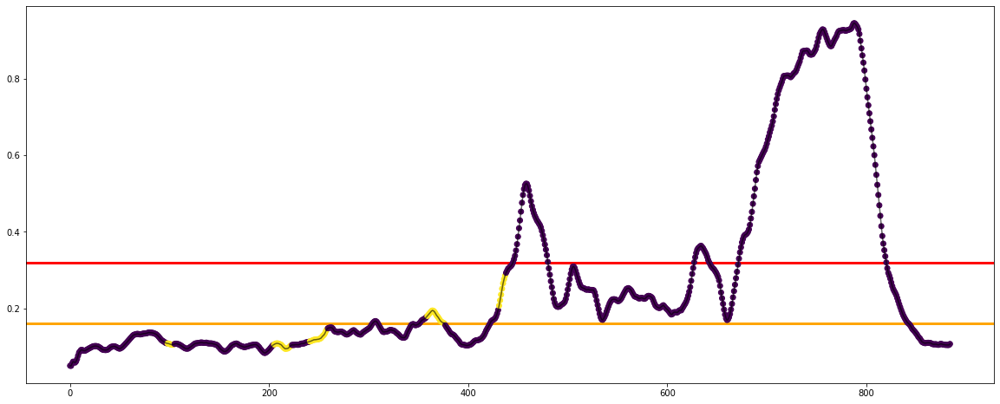

Experiment: 9_20151017_night
Best Model:
	Score: 8.5369
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4001
	Calinski-Harabasz Index: 313.5046
	Davies Bouldin Index: 1.4827
Ha convergido? True, n_its: 51
[0.63 0.21 0.16]


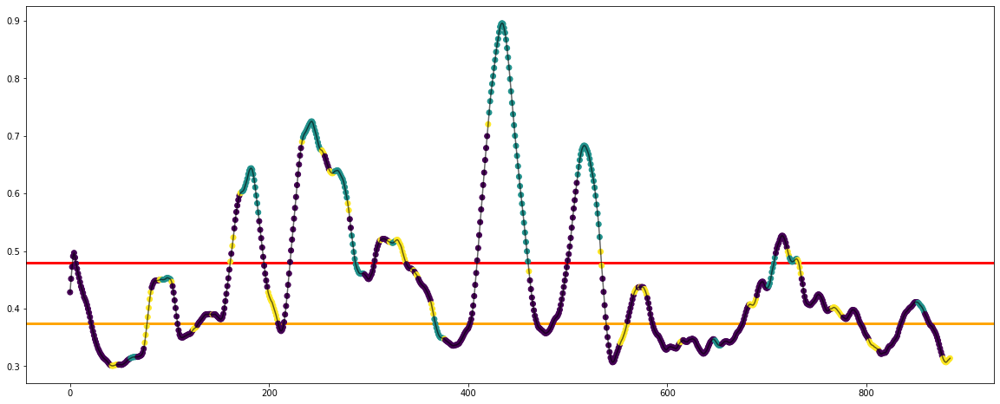

Experiment: 10_20151125_noon
Best Model:
	Score: 5.5612
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.6817
	Calinski-Harabasz Index: 596.7038
	Davies Bouldin Index: 0.9665
Ha convergido? True, n_its: 18
[0.16 0.02 0.82]


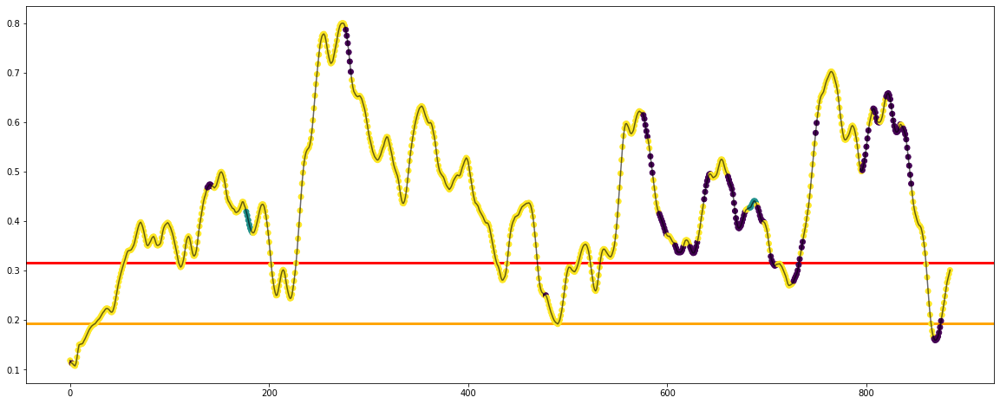

Experiment: 11_20151024_night
Best Model:
	Score: 6.7459
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 2, 'n_init': 3, 'reg_covar': 1e-06, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.6625
	Calinski-Harabasz Index: 301.5020
	Davies Bouldin Index: 1.1949
Ha convergido? True, n_its: 12
[0.94 0.06]


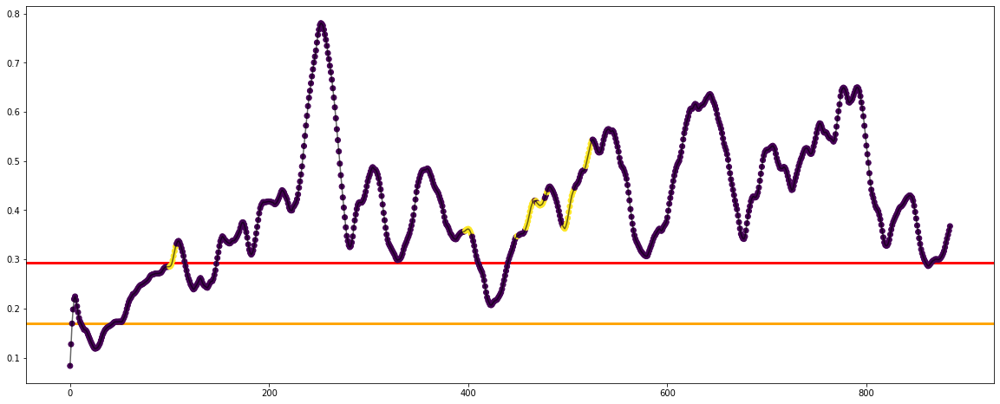

Experiment: 12_20150928_noon
Best Model:
	Score: 4.1817
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 2, 'n_init': 2, 'reg_covar': 1e-05, 'tol': 0.005, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2997
	Calinski-Harabasz Index: 99.4539
	Davies Bouldin Index: 2.5643
Ha convergido? True, n_its: 13
[0.79 0.21]


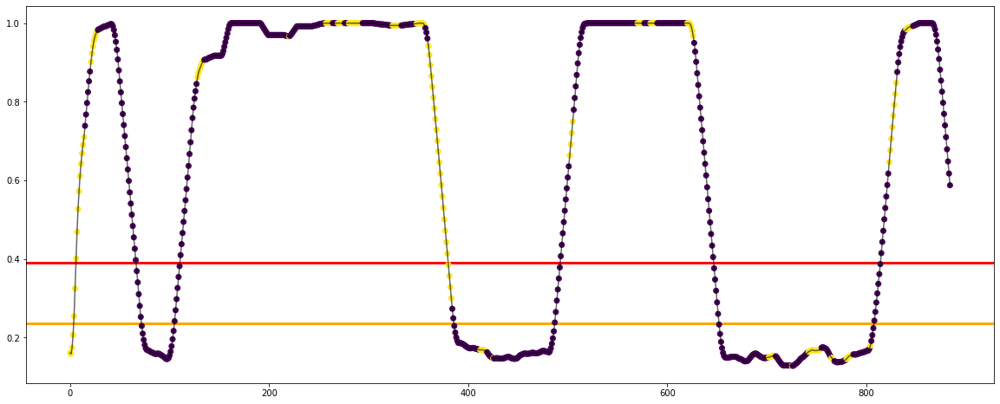

Experiment: 13_20150929_noon
Best Model:
	Score: 5.6151
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3964
	Calinski-Harabasz Index: 307.8443
	Davies Bouldin Index: 1.3681
Ha convergido? True, n_its: 55
[0.49 0.18 0.33]


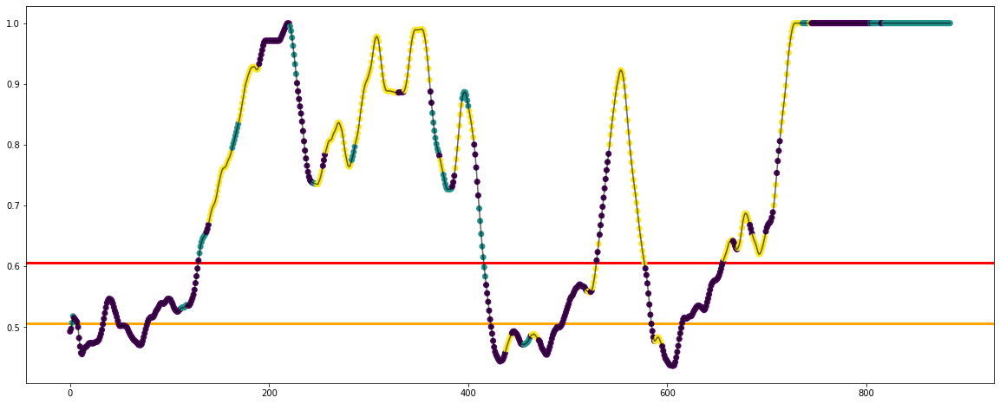

Experiment: 14_20151014_night
Best Model:
	Score: 5.9986
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.1979
	Calinski-Harabasz Index: 141.7475
	Davies Bouldin Index: 1.7412
Ha convergido? True, n_its: 39
[0.2  0.18 0.62]


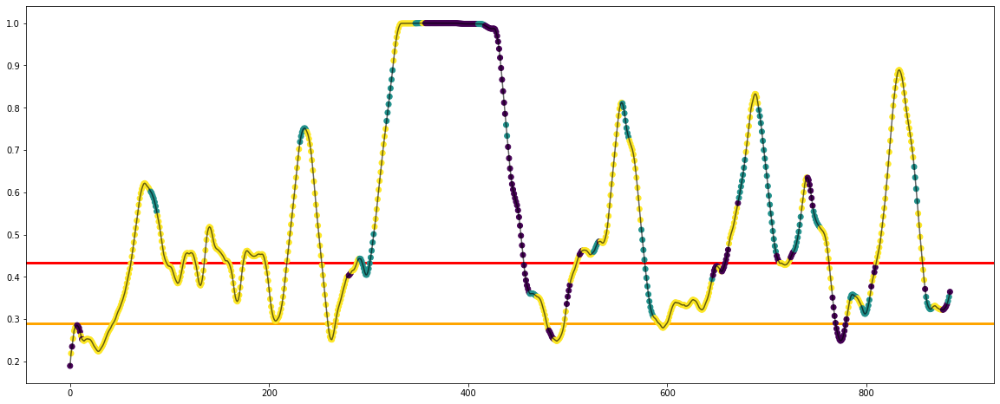

Experiment: 15_20151126_night
Best Model:
	Score: 7.2917
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3803
	Calinski-Harabasz Index: 317.2593
	Davies Bouldin Index: 1.2925
Ha convergido? True, n_its: 38
[0.03 0.58 0.4 ]


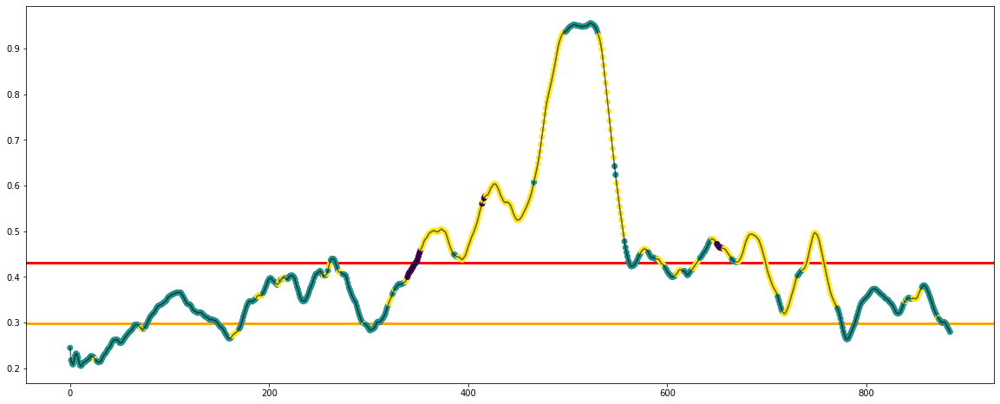

Experiment: 16_20151128_night
Best Model:
	Score: 3.7615
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-07, 'tol': 0.0005, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.7990
	Calinski-Harabasz Index: 16405.2424
	Davies Bouldin Index: 0.4328
Ha convergido? True, n_its: 12
[0.88 0.01 0.11]


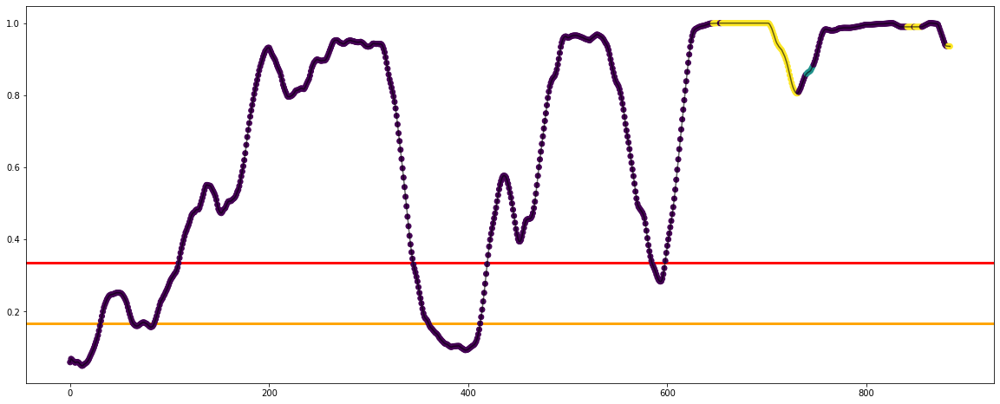

Experiment: 17_20150925_noon
Best Model:
	Score: 5.2462
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2600
	Calinski-Harabasz Index: 232.2370
	Davies Bouldin Index: 1.2576
Ha convergido? True, n_its: 67
[0.31 0.37 0.32]


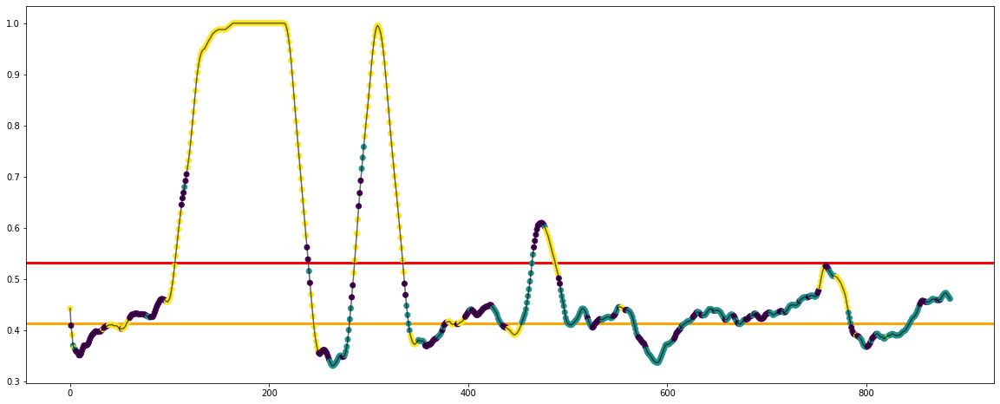

Experiment: 18_20150926_noon
Best Model:
	Score: 7.9357
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 2, 'n_init': 4, 'reg_covar': 1e-07, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.5473
	Calinski-Harabasz Index: 201.4350
	Davies Bouldin Index: 1.5243
Ha convergido? True, n_its: 15
[0.85 0.15]


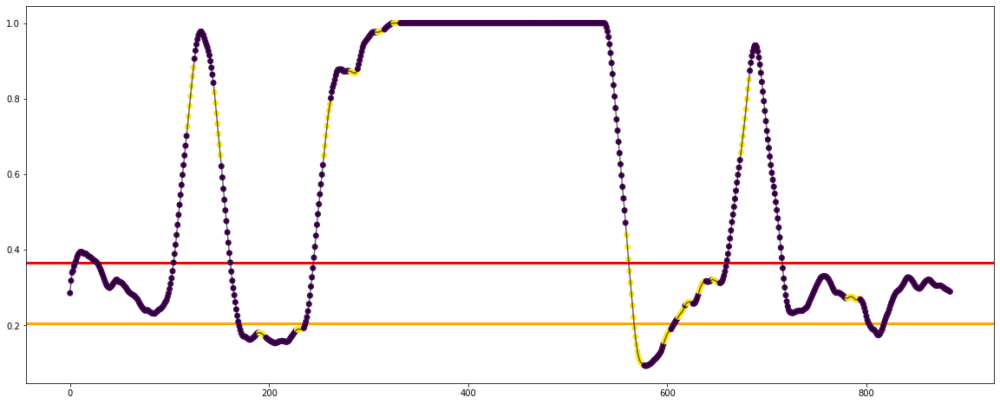

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8939
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3886
	Calinski-Harabasz Index: 4217.5666
	Davies Bouldin Index: 0.9409
Ha convergido? True, n_its: 28
[0.63 0.36 0.01]


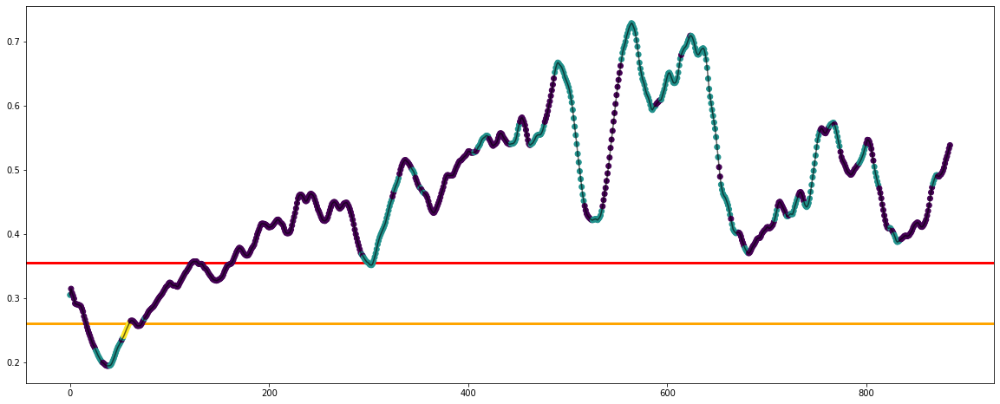

Experiment: 20_20151129_night
Best Model:
	Score: 9.8301
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.5256
	Calinski-Harabasz Index: 629.5584
	Davies Bouldin Index: 0.9165
Ha convergido? True, n_its: 39
[0.29 0.69 0.02]


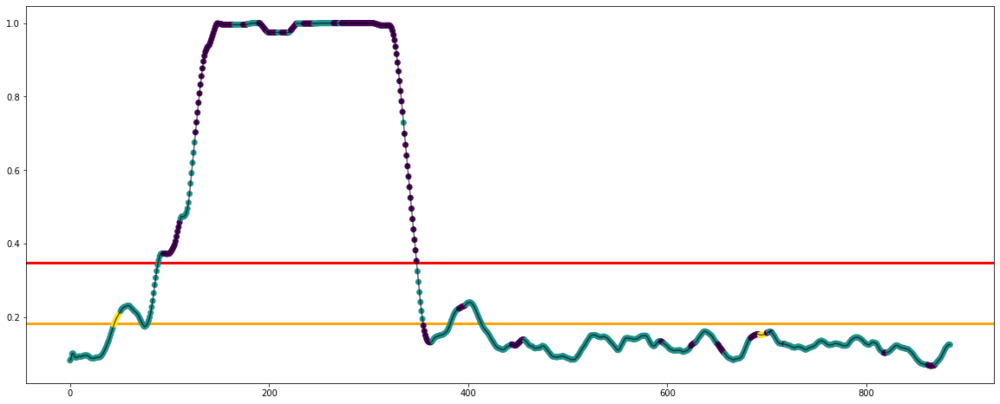

Experiment: 21_20151016_noon
Best Model:
	Score: 5.9468
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2034
	Calinski-Harabasz Index: 129.5436
	Davies Bouldin Index: 1.9554
Ha convergido? True, n_its: 76
[0.31 0.43 0.26]


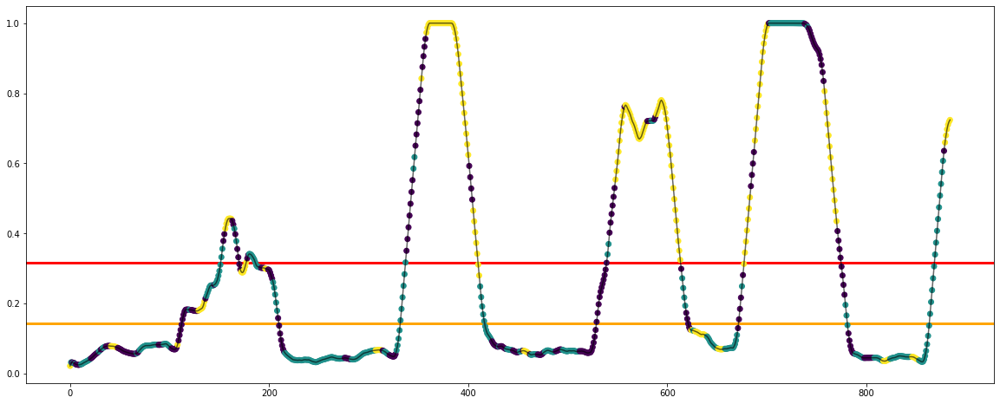

In [33]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = BayesianGaussianMixture(max_iter=200, random_state=42)

    space = dict()
    space['n_components'] = randint(2, 4)
    space['covariance_type'] = ['full', 'tied', 'diag', 'spherical']
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['reg_covar'] = [1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5]
    space['n_init'] = randint(1, 5)
    space['init_params'] = ['kmeans', 'random']
    space['weight_concentration_prior_type'] = ['dirichlet_process', 'dirichlet_distribution']
    space['warm_start'] = [True, False]

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all[key], y_all[key], model, space, cv=10, n_iter=20)
    
    print(f'Ha convergido? {best_model.converged_}, n_its: {best_model.n_iter_}')
    print(np.round(best_model.weights_,2))
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/BGM-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 5.7450
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-07, 'tol': 0.0005, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3829
	Calinski-Harabasz Index: 206.3572
	Davies Bouldin Index: 1.7415
Ha convergido? True, n_its: 21
[0.51 0.34 0.15]


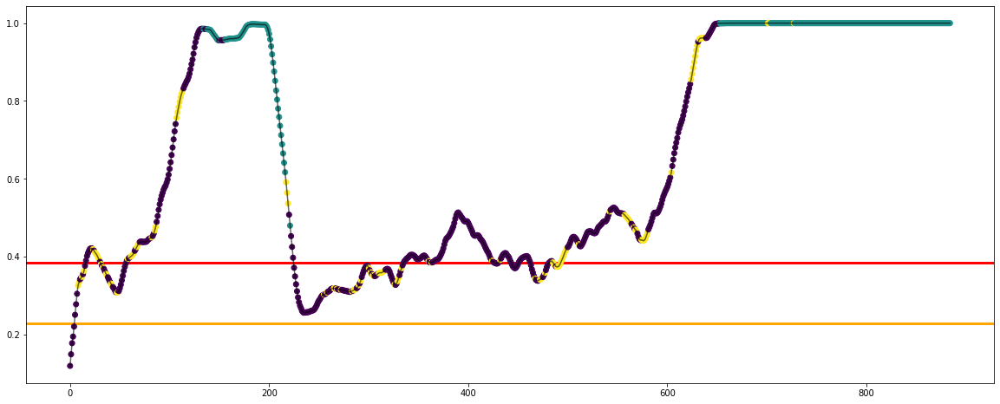

Experiment: 2_20151106_noon
Best Model:
	Score: 10.4370
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.5598
	Calinski-Harabasz Index: 298.1274
	Davies Bouldin Index: 1.1288
Ha convergido? True, n_its: 25
[0.88 0.01 0.11]


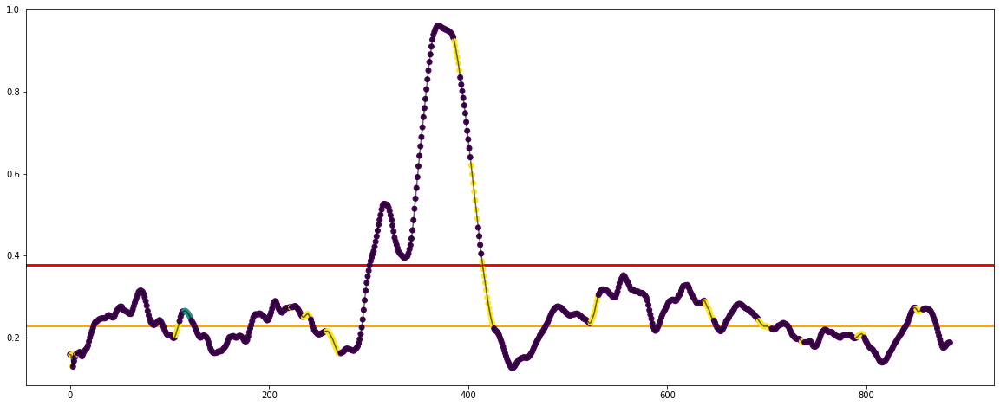

Experiment: 3_20151024_noon
Best Model:
	Score: 6.1065
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 2, 'n_init': 2, 'reg_covar': 1e-05, 'tol': 0.005, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3559
	Calinski-Harabasz Index: 121.9003
	Davies Bouldin Index: 1.7470
Ha convergido? True, n_its: 13
[0.9 0.1]


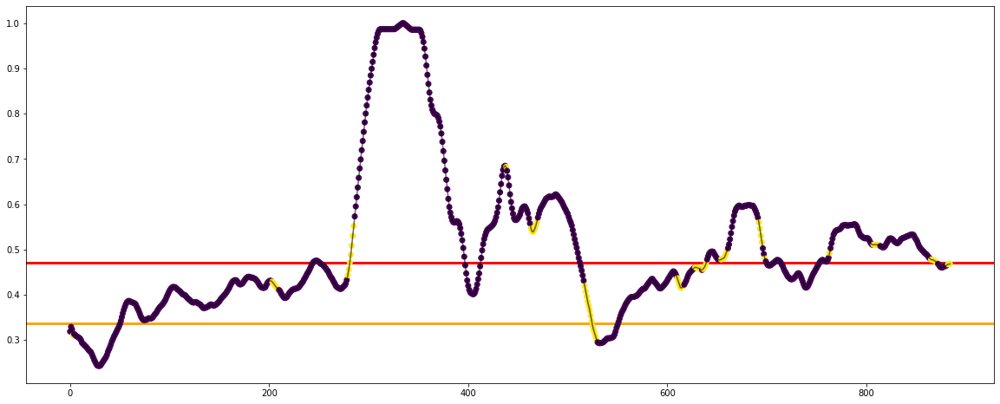

Experiment: 4_20151105_noon
Best Model:
	Score: 3.1274
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 2, 'n_init': 2, 'reg_covar': 1e-05, 'tol': 0.005, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3102
	Calinski-Harabasz Index: 340.2626
	Davies Bouldin Index: 1.2547
Ha convergido? True, n_its: 61
[0.74 0.26]


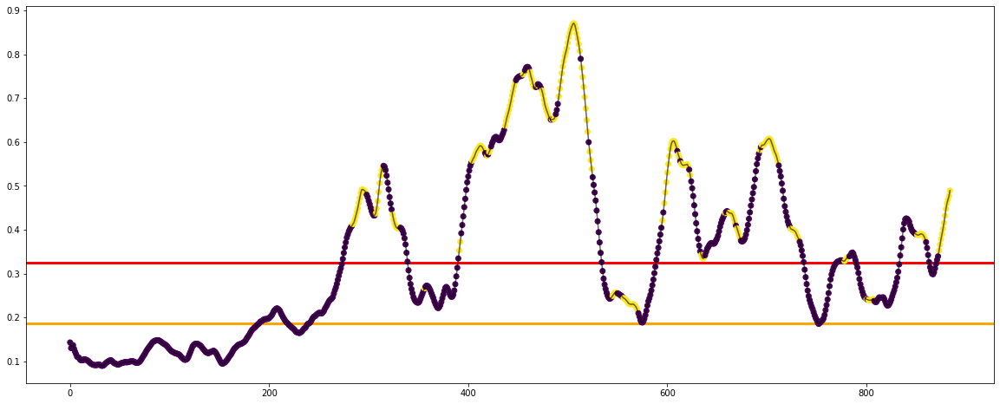

Experiment: 4_20151107_noon
Best Model:
	Score: 4.5483
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 2, 'n_init': 2, 'reg_covar': 1e-05, 'tol': 0.005, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2221
	Calinski-Harabasz Index: 213.3062
	Davies Bouldin Index: 1.8679
Ha convergido? True, n_its: 25
[0.38 0.62]


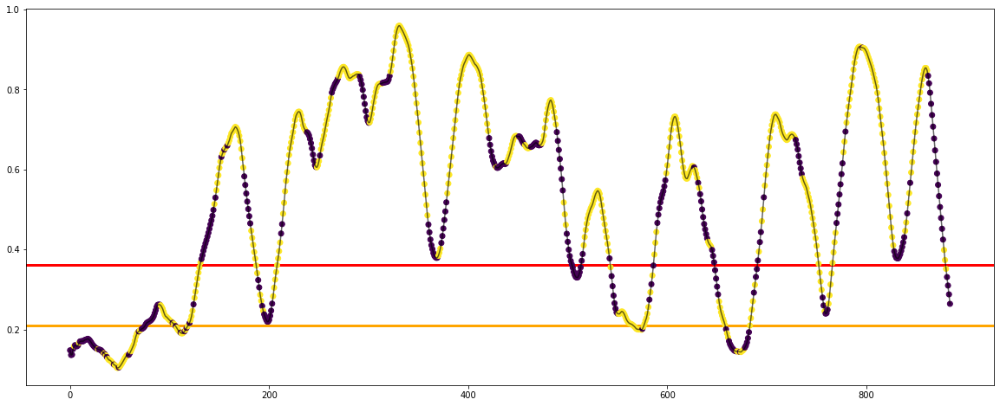

Experiment: 5_20141108_noon
Best Model:
	Score: 6.1216
	Hyperparameters: {'covariance_type': 'full', 'init_params': 'random', 'n_components': 2, 'n_init': 1, 'reg_covar': 1e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2622
	Calinski-Harabasz Index: 135.5105
	Davies Bouldin Index: 2.1564
Ha convergido? True, n_its: 25
[0.64 0.36]


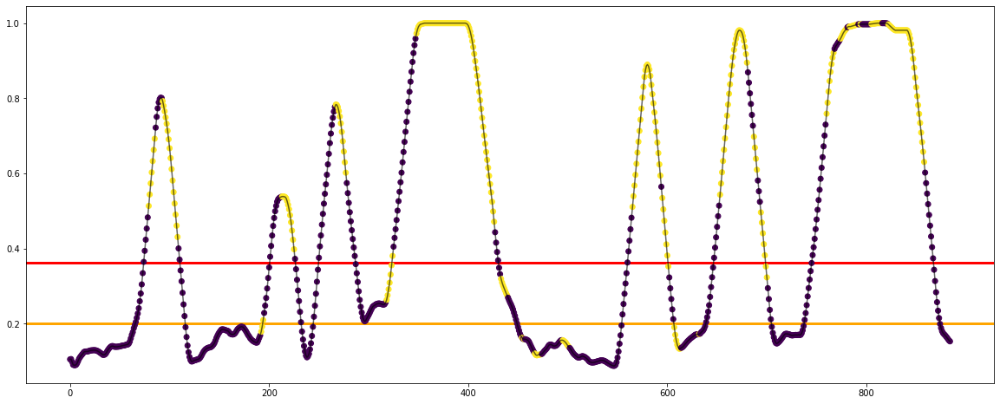

Experiment: 5_20151012_night
Best Model:
	Score: 4.6354
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.5153
	Calinski-Harabasz Index: 510.5537
	Davies Bouldin Index: 1.2970
Ha convergido? True, n_its: 39
[0.05 0.49 0.46]


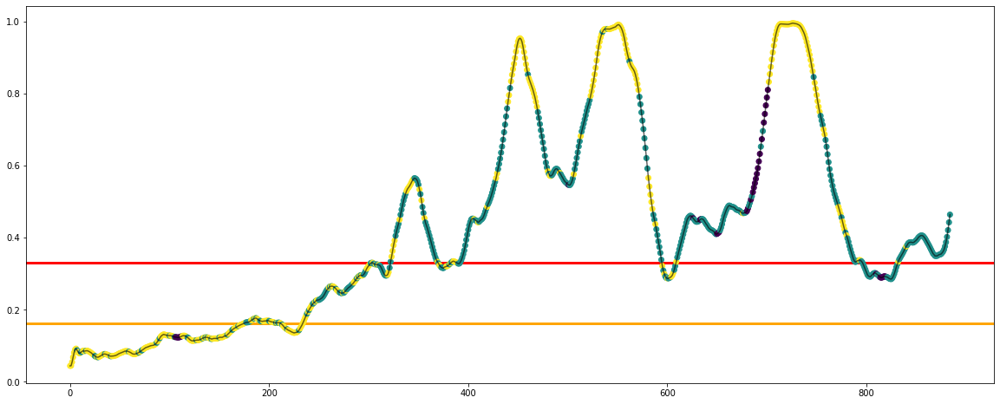

Experiment: 6_20151121_noon
Best Model:
	Score: 8.3585
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 3, 'reg_covar': 5e-06, 'tol': 1e-05, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4491
	Calinski-Harabasz Index: 262.5168
	Davies Bouldin Index: 1.5152
Ha convergido? True, n_its: 38
[0.38 0.48 0.14]


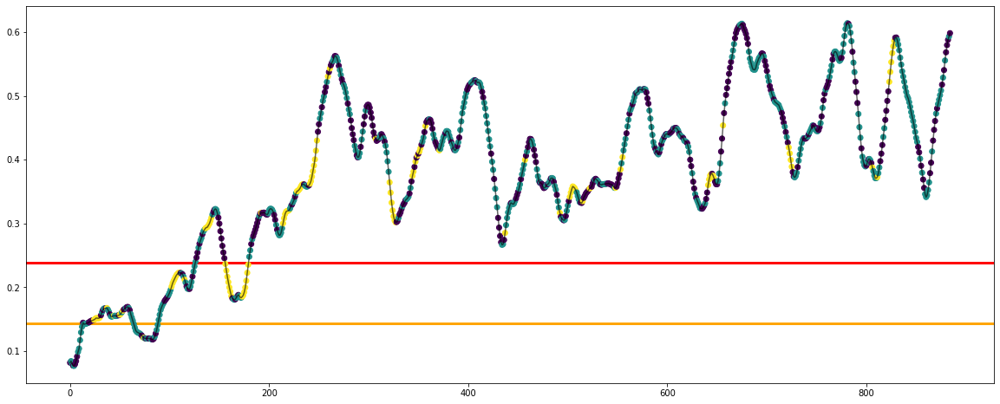

Experiment: 7_20151015_night
Best Model:
	Score: 3.9929
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2491
	Calinski-Harabasz Index: 334.9391
	Davies Bouldin Index: 1.2335
Ha convergido? True, n_its: 51
[0.26 0.34 0.4 ]


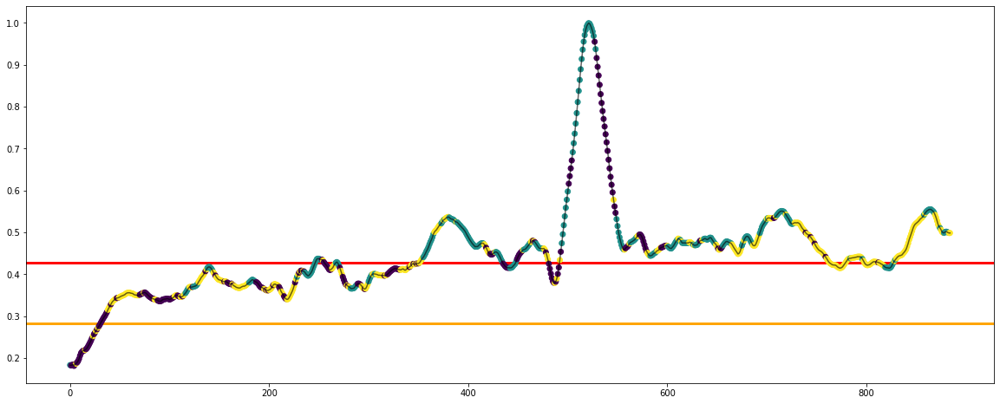

Experiment: 8_20151022_noon
Best Model:
	Score: 6.8808
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.5578
	Calinski-Harabasz Index: 357.3126
	Davies Bouldin Index: 1.2473
Ha convergido? True, n_its: 11
[0.42 0.41 0.17]


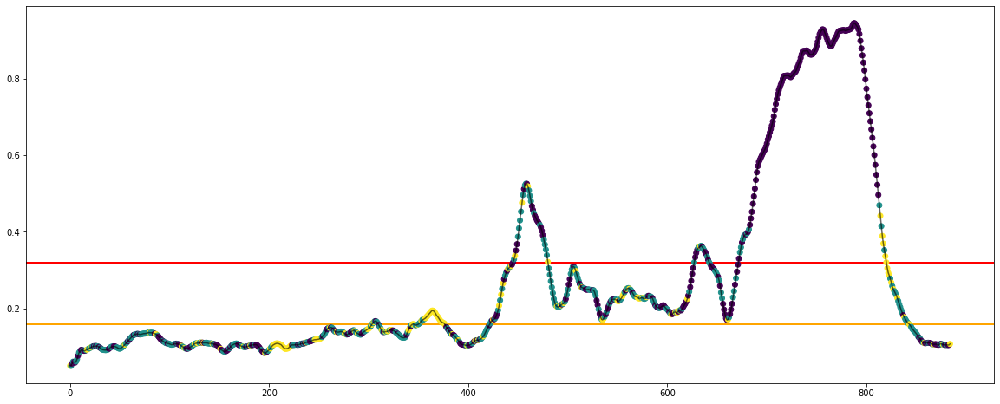

Experiment: 9_20151017_night
Best Model:
	Score: 6.4103
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.1279
	Calinski-Harabasz Index: 205.9585
	Davies Bouldin Index: 2.7953
Ha convergido? True, n_its: 19
[0.22 0.24 0.55]


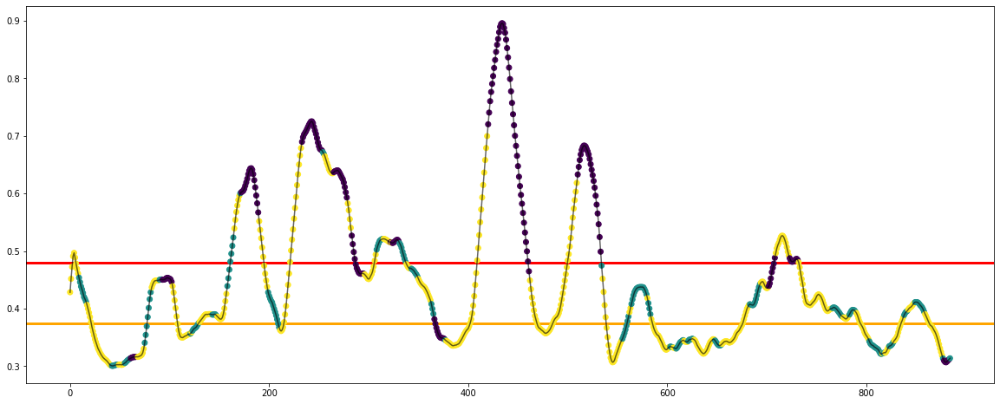

Experiment: 10_20151125_noon
Best Model:
	Score: 7.9090
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4655
	Calinski-Harabasz Index: 202.1886
	Davies Bouldin Index: 1.5969
Ha convergido? True, n_its: 38
[0.53 0.14 0.33]


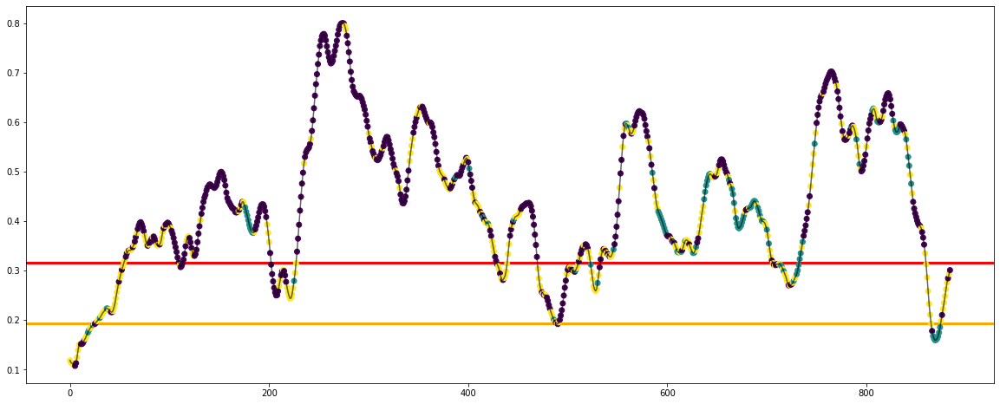

Experiment: 11_20151024_night
Best Model:
	Score: 6.9830
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 2, 'n_init': 3, 'reg_covar': 1e-06, 'tol': 1e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.5919
	Calinski-Harabasz Index: 208.1809
	Davies Bouldin Index: 1.3457
Ha convergido? True, n_its: 29
[0.94 0.06]


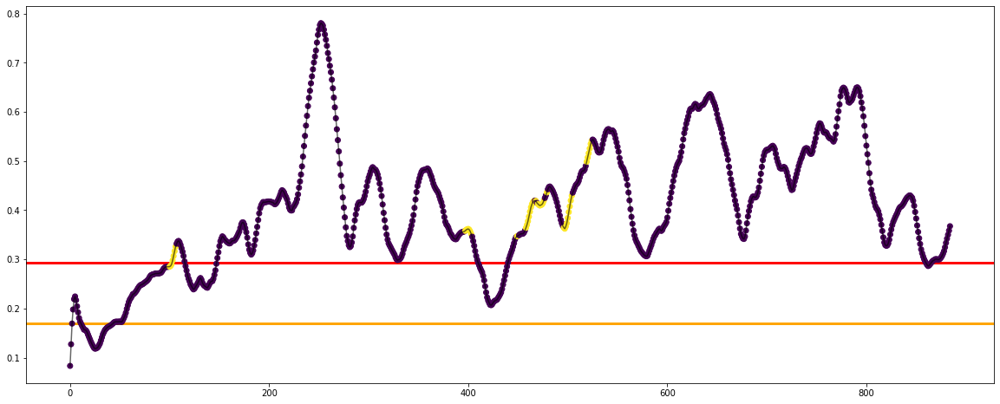

Experiment: 12_20150928_noon
Best Model:
	Score: 5.7989
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2933
	Calinski-Harabasz Index: 273.7878
	Davies Bouldin Index: 1.8722
Ha convergido? True, n_its: 50
[0.47 0.14 0.39]


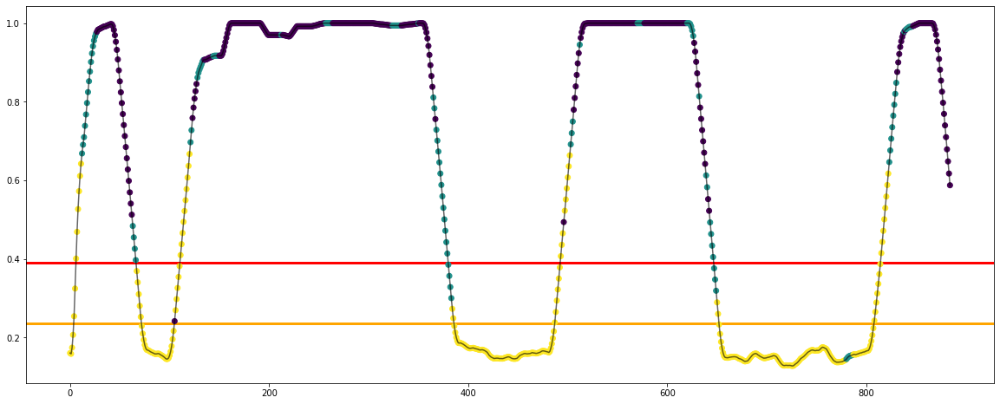

Experiment: 13_20150929_noon
Best Model:
	Score: 5.0084
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'random', 'n_components': 2, 'n_init': 4, 'reg_covar': 5e-07, 'tol': 0.0005, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3295
	Calinski-Harabasz Index: 191.9609
	Davies Bouldin Index: 1.7577
Ha convergido? True, n_its: 43
[0.77 0.23]


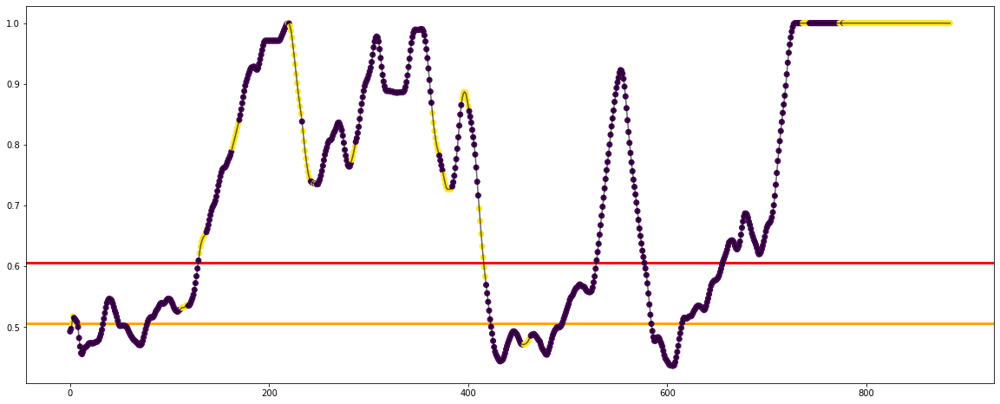

Experiment: 14_20151014_night
Best Model:
	Score: 5.6048
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2444
	Calinski-Harabasz Index: 116.2870
	Davies Bouldin Index: 2.0770
Ha convergido? True, n_its: 37
[0.67 0.19 0.14]


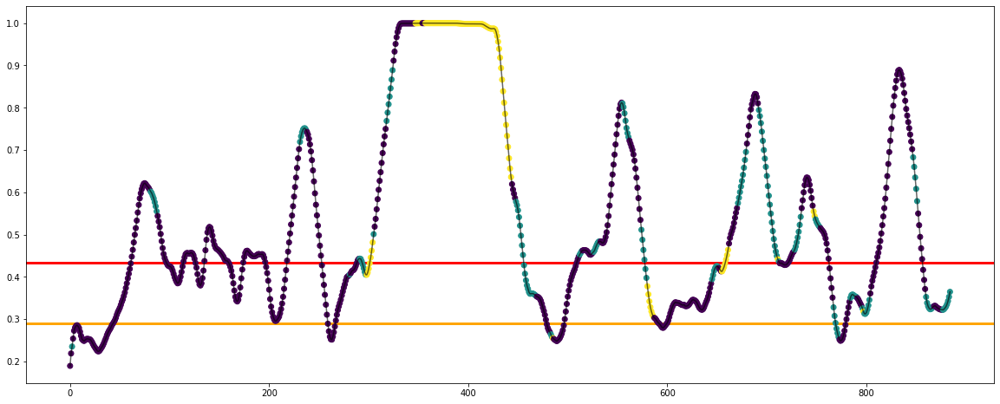

Experiment: 15_20151126_night
Best Model:
	Score: 5.2782
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4122
	Calinski-Harabasz Index: 326.7847
	Davies Bouldin Index: 1.5844
Ha convergido? True, n_its: 19
[0.12 0.29 0.59]


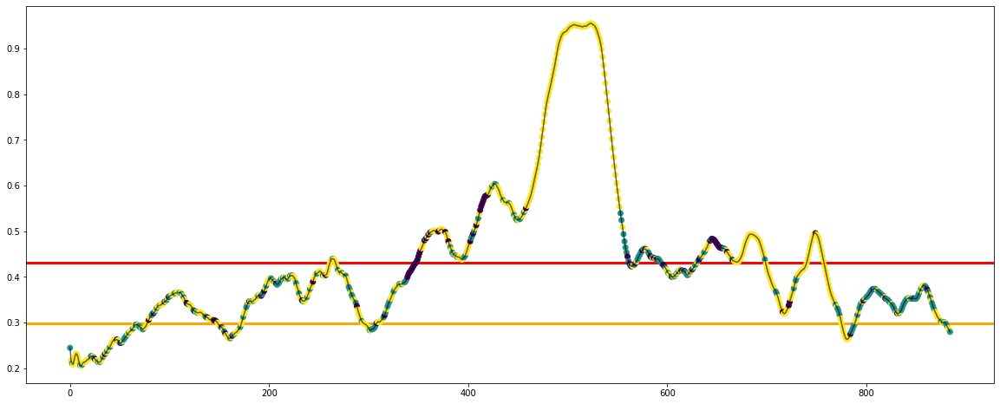

Experiment: 16_20151128_night
Best Model:
	Score: 15.2576
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-07, 'tol': 0.0005, 'warm_start': False, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.7406
	Calinski-Harabasz Index: 1249.5715
	Davies Bouldin Index: 0.6289
Ha convergido? True, n_its: 8
[0.76 0.01 0.23]


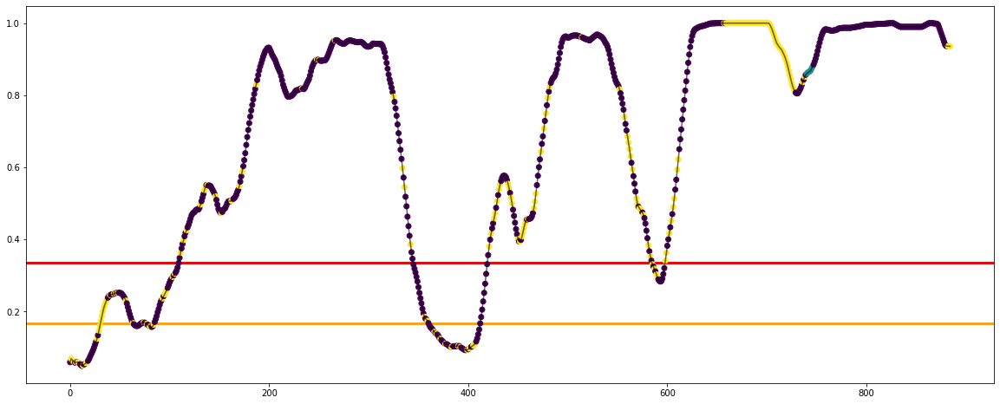

Experiment: 17_20150925_noon
Best Model:
	Score: 4.8281
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3670
	Calinski-Harabasz Index: 363.6770
	Davies Bouldin Index: 1.4172
Ha convergido? True, n_its: 17
[0.16 0.63 0.21]


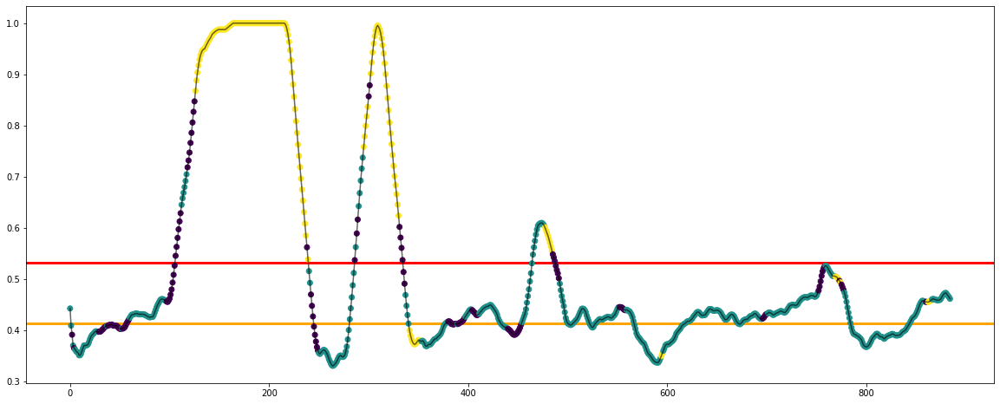

Experiment: 18_20150926_noon
Best Model:
	Score: 9.4808
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3439
	Calinski-Harabasz Index: 238.2378
	Davies Bouldin Index: 1.5722
Ha convergido? True, n_its: 32
[0.5  0.36 0.14]


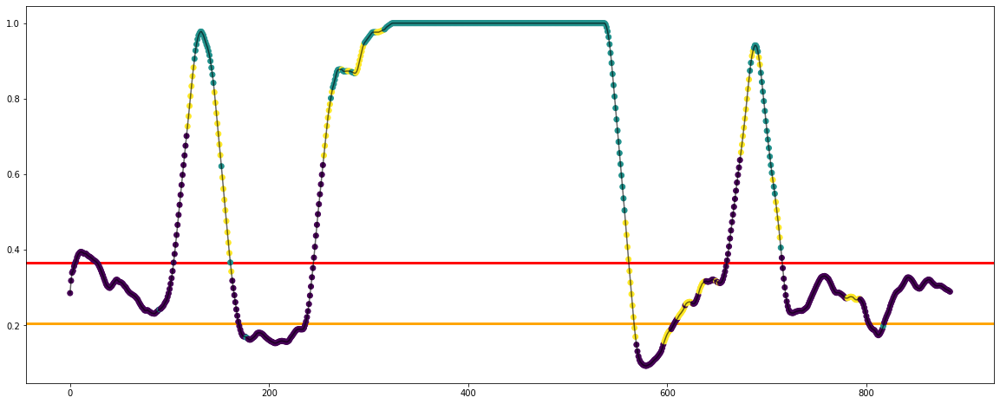

Experiment: 19_20151114_noon
Best Model:
	Score: 4.8446
	Hyperparameters: {'covariance_type': 'spherical', 'init_params': 'random', 'n_components': 3, 'n_init': 4, 'reg_covar': 5e-05, 'tol': 5e-05, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_distribution'}

Cluestering evaluation:
	Silhouette Coefficient: 0.4713
	Calinski-Harabasz Index: 336.4631
	Davies Bouldin Index: 1.3002
Ha convergido? True, n_its: 11
[0.26 0.62 0.12]


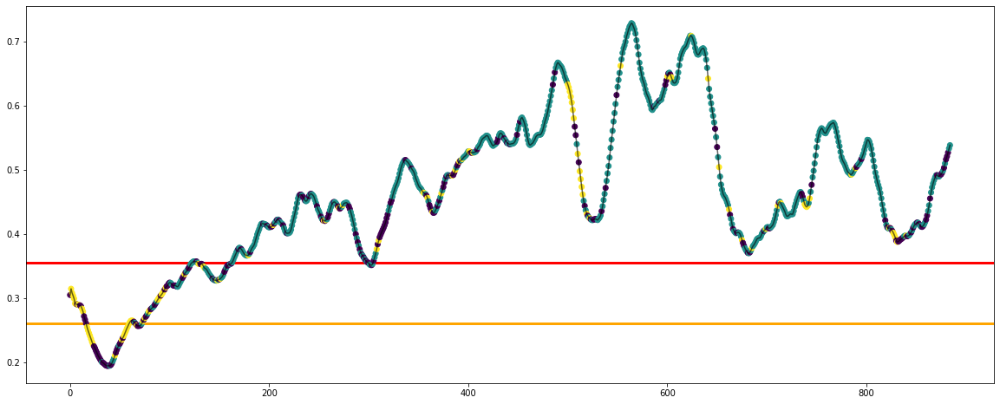

Experiment: 20_20151129_night
Best Model:
	Score: 10.5175
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.3340
	Calinski-Harabasz Index: 240.8807
	Davies Bouldin Index: 1.3541
Ha convergido? True, n_its: 41
[0.32 0.65 0.03]


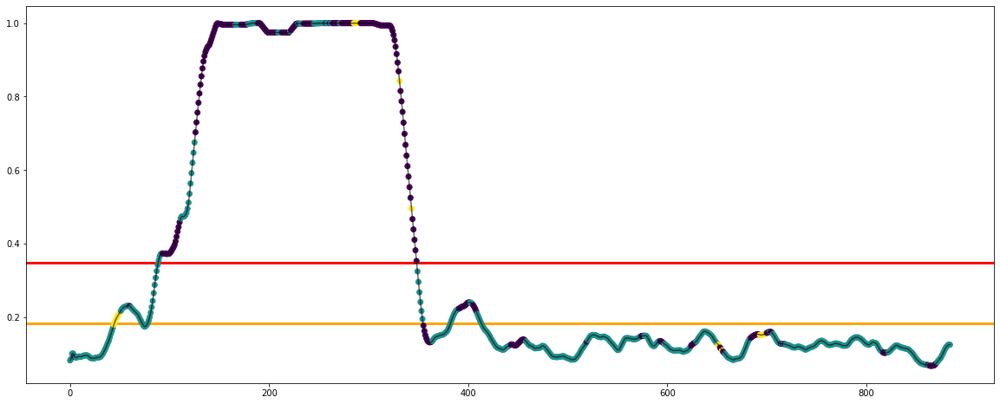

Experiment: 21_20151016_noon
Best Model:
	Score: 5.7584
	Hyperparameters: {'covariance_type': 'diag', 'init_params': 'kmeans', 'n_components': 3, 'n_init': 1, 'reg_covar': 5e-06, 'tol': 0.0001, 'warm_start': True, 'weight_concentration_prior_type': 'dirichlet_process'}

Cluestering evaluation:
	Silhouette Coefficient: 0.2482
	Calinski-Harabasz Index: 135.6747
	Davies Bouldin Index: 1.9863
Ha convergido? True, n_its: 22
[0.18 0.26 0.56]


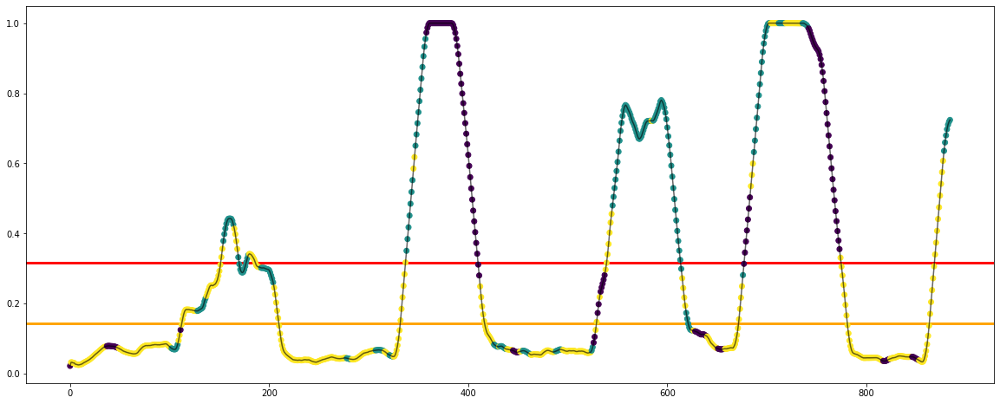

In [36]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = BayesianGaussianMixture(max_iter=200, random_state=42)

    space = dict()
    space['n_components'] = randint(2, 4)
    space['covariance_type'] = ['full', 'tied', 'diag', 'spherical']
    space['tol'] = [1e-3, 5e-3, 1e-4, 5e-4, 1e-5, 5e-5]
    space['reg_covar'] = [1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5]
    space['n_init'] = randint(1, 5)
    space['init_params'] = ['kmeans', 'random']
    space['weight_concentration_prior_type'] = ['dirichlet_process', 'dirichlet_distribution']
    space['warm_start'] = [True, False]

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all_eog[key], y_all[key], model, space, cv=10, n_iter=20)
    
    print(f'Ha convergido? {best_model.converged_}, n_its: {best_model.n_iter_}')
    print(np.round(best_model.weights_,2))
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/BGM-PSD+EOG.csv', index=False)

### Resto de cosas de Bayesian Gaussian Mixture

In [42]:
from sklearn.mixture import BayesianGaussianMixture
def bgm_predictions_plot(X, y):
    bgm = BayesianGaussianMixture(n_components=6, n_init=20, random_state=42)
    bgm.fit(X)

    print(f'Ha convergido? {bgm.converged_}, n_its: {bgm.n_iter_}')
    print(np.round(bgm.weights_,2))

    predictions = bgm.predict(X)

    plt.figure(figsize=(20, 8))
    plt.plot(y, color='gray')
    plt.scatter(range(len(predictions)), y, c=predictions)
    plt.title('BGM - Coloreado del valor PERCLOS y el cluster asociado')
    plt.xlabel('Epoch')
    plt.ylabel('% PERCLOS')
    plt.show()

# Affinity Propagation

In [6]:
from sklearn.cluster import AffinityPropagation

### EEG

Experiment: 1_20151124_noon_2


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.37052816 0.38365574 0.38827963 0.3742947  0.37052816        nan
 0.38686754 0.41294928 0.38686754 0.3742513 ]
  category=UserWarning


Best Model:
	Score: 0.4129
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.1278
	Calinski-Harabasz Index: 164.6474
	Davies Bouldin Index: 1.6023
Numero de Clusters: 27


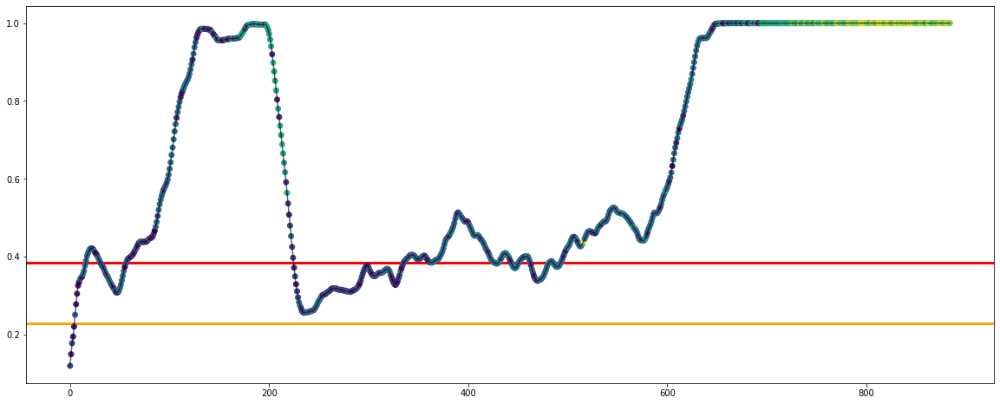

Experiment: 2_20151106_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.16744683 0.19984858 0.18352005 0.19087508 0.16744683        nan
 0.20001812 0.20046016 0.20001812 0.2020573 ]
  category=UserWarning


Best Model:
	Score: 0.2021
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.8, 'preference': -9}

Cluestering evaluation:
	Silhouette Coefficient: 0.0950
	Calinski-Harabasz Index: 280.1575
	Davies Bouldin Index: 1.2240
Numero de Clusters: 8


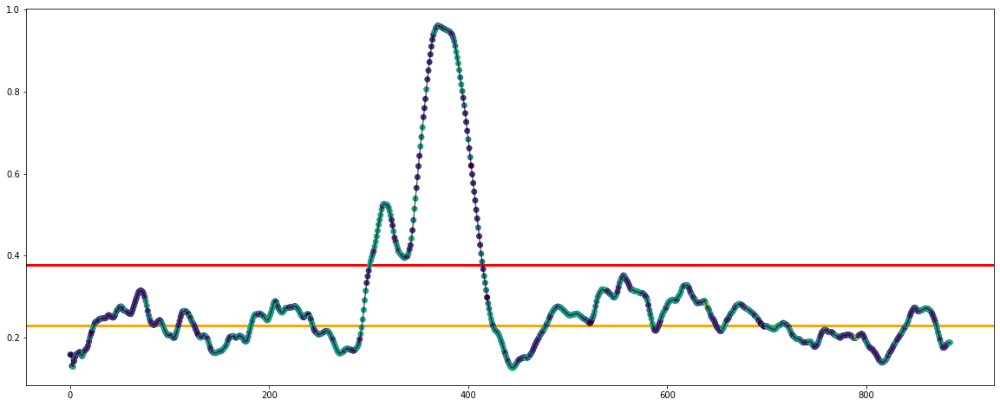

Experiment: 3_20151024_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.32586816 0.35671794 0.34137513 0.31607136 0.32586816        nan
 0.37947697 0.39045993 0.37934763 0.31183078]
  category=UserWarning


Best Model:
	Score: 0.3905
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0351
	Calinski-Harabasz Index: 54.3500
	Davies Bouldin Index: 1.8380
Numero de Clusters: 24


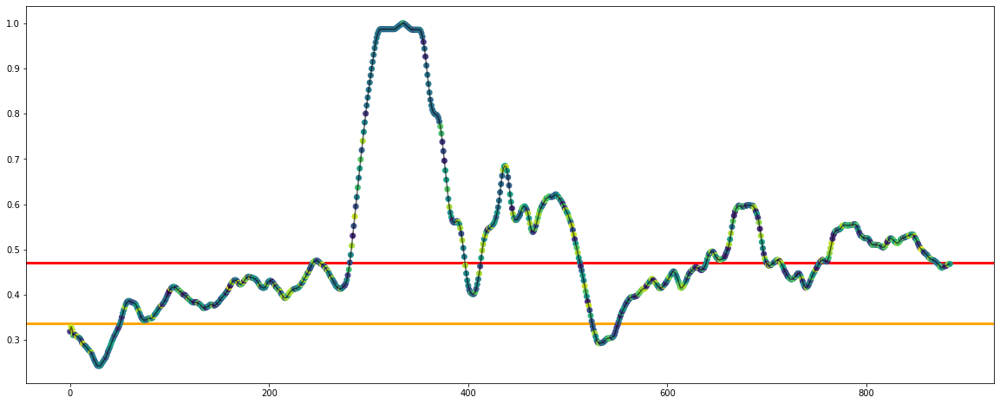

Experiment: 4_20151105_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.39233455 0.40648855 0.41499593 0.39279646 0.39437762        nan
 0.42203818 0.4427841  0.42203818 0.38183158]
  category=UserWarning


Best Model:
	Score: 0.4428
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0654
	Calinski-Harabasz Index: 72.2219
	Davies Bouldin Index: 2.1514
Numero de Clusters: 26


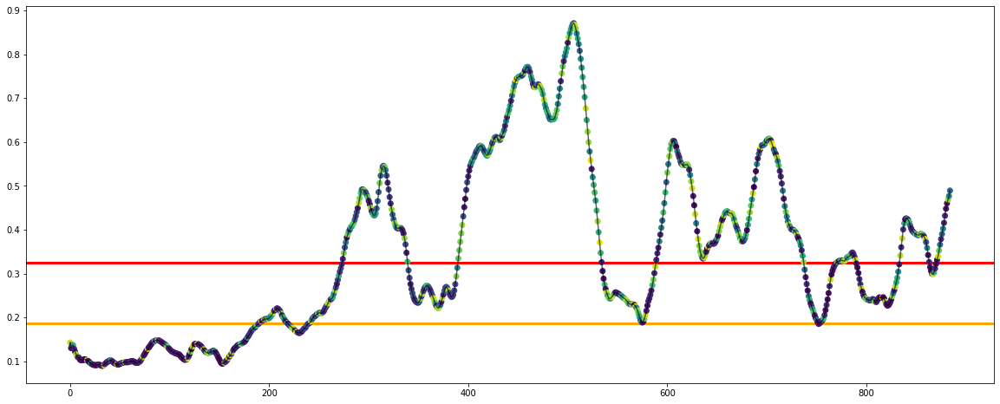

Experiment: 4_20151107_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.41903061 0.43849621 0.44088176 0.42411014 0.41903061        nan
 0.45522967 0.47534128 0.45522967 0.40573239]
  category=UserWarning


Best Model:
	Score: 0.4753
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0525
	Calinski-Harabasz Index: 67.6853
	Davies Bouldin Index: 1.9836
Numero de Clusters: 31


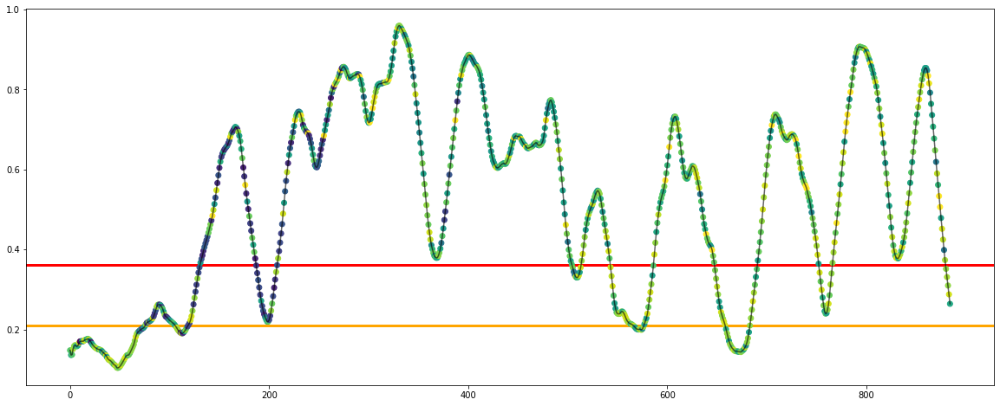

Experiment: 5_20141108_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.37415453 0.39765757 0.38871645 0.37549427 0.37415453        nan
 0.40200642 0.41574678 0.40200642 0.36924915]
  category=UserWarning


Best Model:
	Score: 0.4157
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0725
	Calinski-Harabasz Index: 86.4837
	Davies Bouldin Index: 1.9519
Numero de Clusters: 22


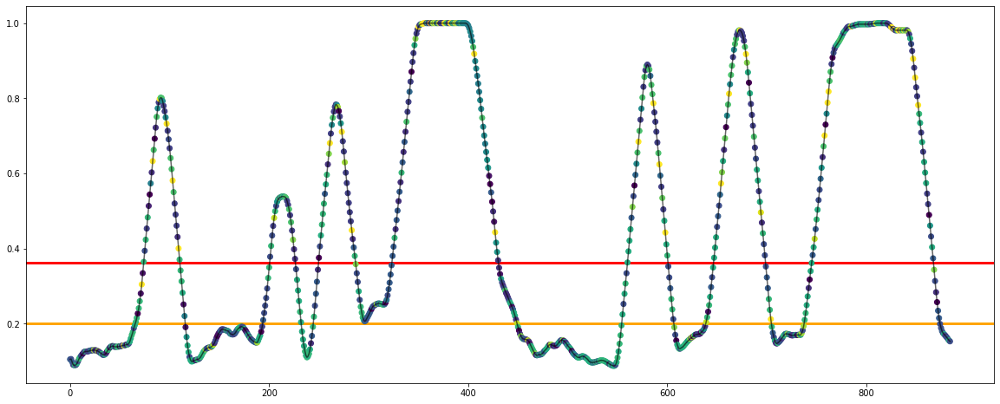

Experiment: 5_20151012_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.28310743 0.32193621 0.29239119 0.27175645 0.28310743        nan
 0.32339306 0.35860552 0.32339306 0.25141066]
  category=UserWarning


Best Model:
	Score: 0.3586
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0680
	Calinski-Harabasz Index: 82.7466
	Davies Bouldin Index: 1.7350
Numero de Clusters: 21


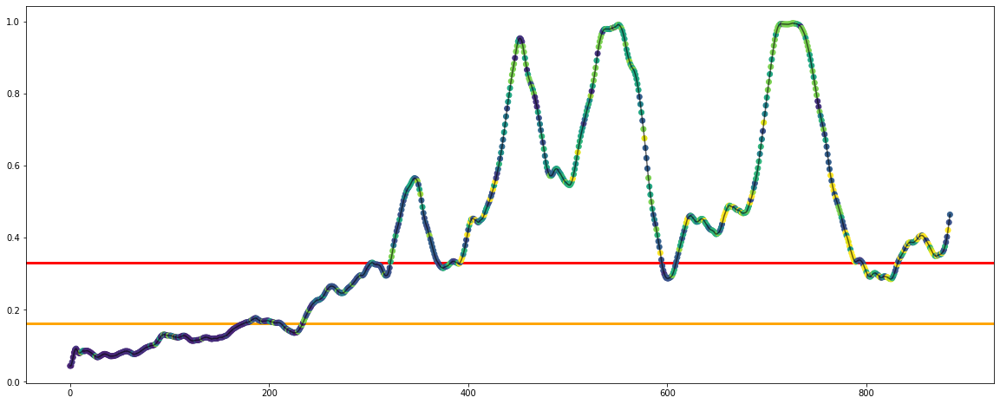

Experiment: 6_20151121_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.23861033 0.30173697 0.30512062 0.25614694 0.23861033        nan
 0.30688808 0.34730638 0.30924088 0.21784744]
  category=UserWarning


Best Model:
	Score: 0.3473
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0821
	Calinski-Harabasz Index: 64.0042
	Davies Bouldin Index: 1.4309
Numero de Clusters: 24


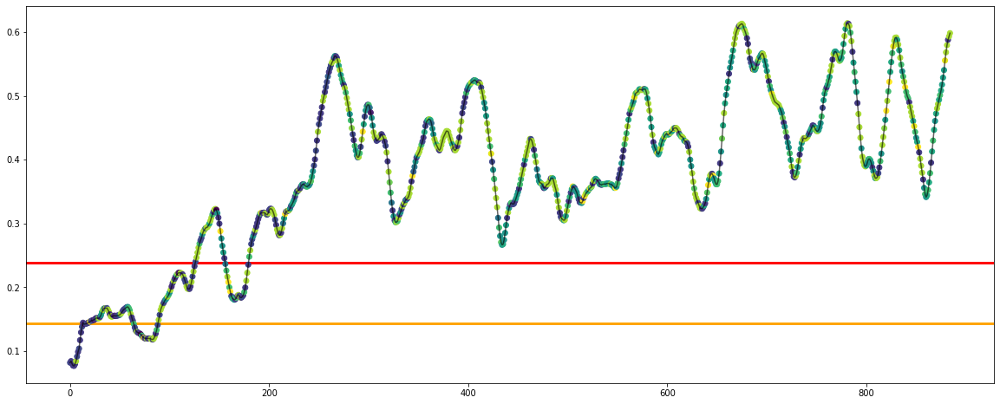

Experiment: 7_20151015_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.33268695 0.35629983 0.34913271 0.32469957 0.33268695        nan
 0.3682791  0.3987042  0.3682791  0.30909374]
  category=UserWarning


Best Model:
	Score: 0.3987
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0453
	Calinski-Harabasz Index: 65.5852
	Davies Bouldin Index: 1.8400
Numero de Clusters: 18


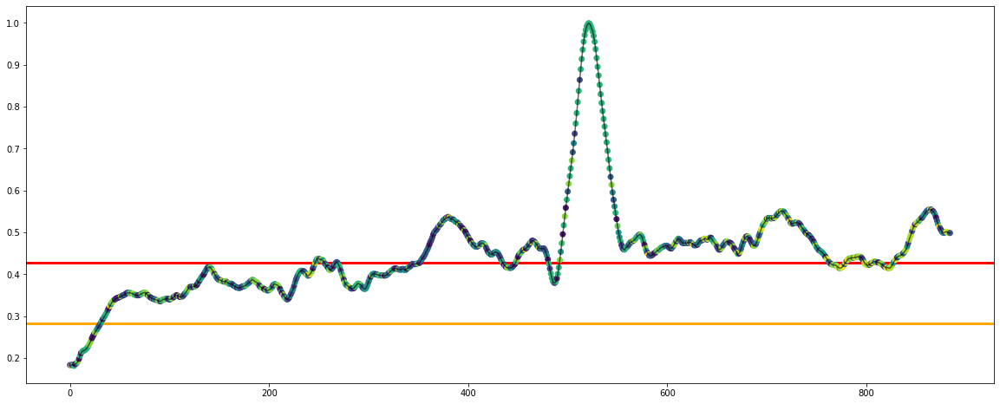

Experiment: 8_20151022_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.29689496 0.29948168 0.29013728 0.29685971 0.29689496        nan
 0.31925286 0.32133914 0.31925286 0.27897025]
  category=UserWarning


Best Model:
	Score: 0.3213
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0871
	Calinski-Harabasz Index: 83.3989
	Davies Bouldin Index: 1.5198
Numero de Clusters: 25


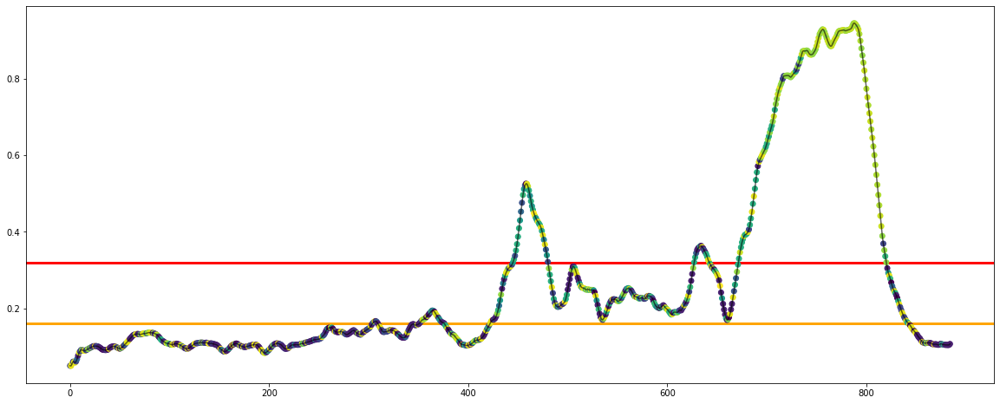

Experiment: 9_20151017_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.19337907 0.21760242 0.21910385 0.20368943 0.19337907        nan
 0.25308604 0.25339426 0.25308604 0.17058295]
  category=UserWarning


Best Model:
	Score: 0.2534
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.1417
	Calinski-Harabasz Index: 117.4258
	Davies Bouldin Index: 1.1104
Numero de Clusters: 21


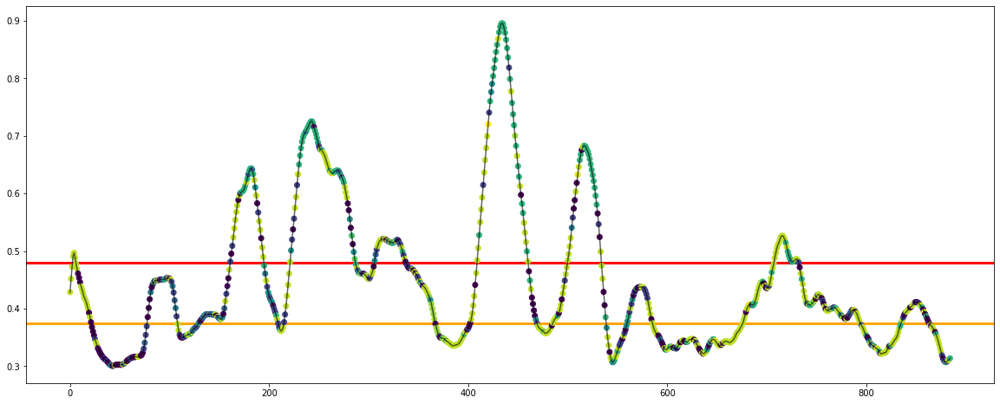

Experiment: 10_20151125_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.3703963  0.38561817 0.39398357 0.36792561 0.3703963         nan
 0.40207387 0.42179889 0.40207387 0.36569479]
  category=UserWarning


Best Model:
	Score: 0.4218
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0773
	Calinski-Harabasz Index: 91.3504
	Davies Bouldin Index: 1.6875
Numero de Clusters: 20


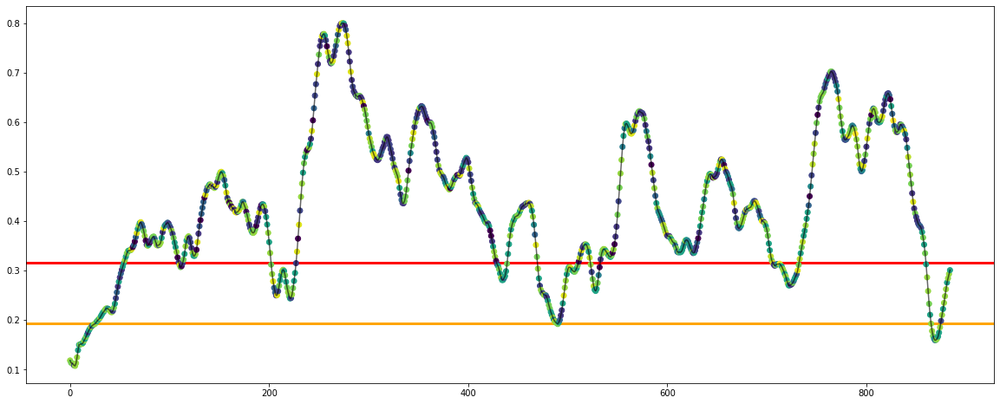

Experiment: 11_20151024_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.31700809 0.33929826 0.33263299 0.32636985 0.31700809        nan
 0.37119673 0.39151422 0.37119673 0.31746895]
  category=UserWarning


Best Model:
	Score: 0.3915
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0598
	Calinski-Harabasz Index: 69.7884
	Davies Bouldin Index: 1.5632
Numero de Clusters: 21


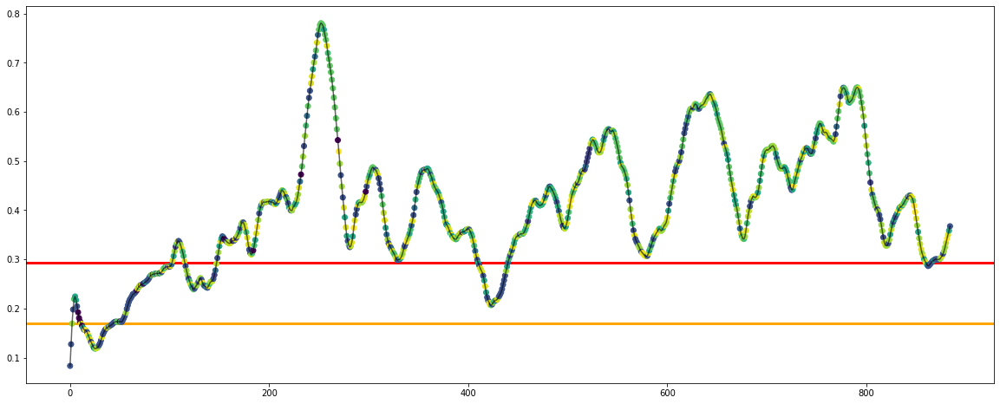

Experiment: 12_20150928_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.27903723 0.2850441  0.28258765 0.27713919 0.27903723        nan
 0.31859083 0.35100708 0.31859083 0.26812287]
  category=UserWarning


Best Model:
	Score: 0.3510
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0974
	Calinski-Harabasz Index: 123.7520
	Davies Bouldin Index: 1.1755
Numero de Clusters: 24


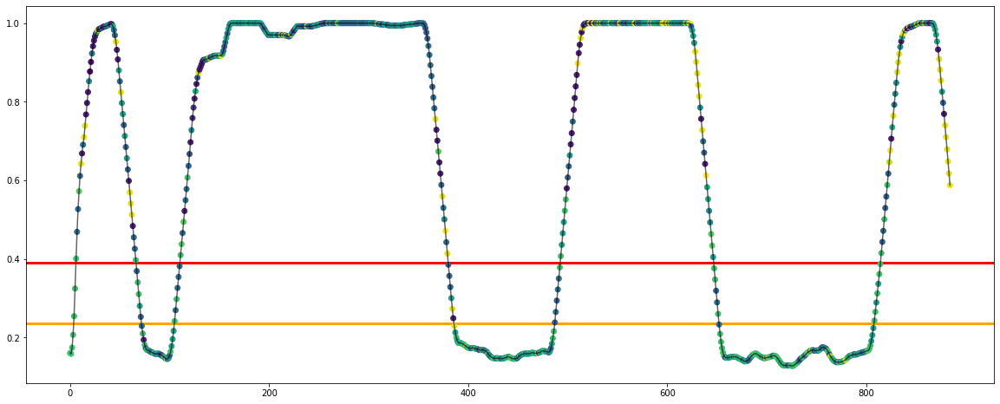

Experiment: 13_20150929_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.3629747  0.38104598 0.37522131 0.36883065 0.3629747         nan
 0.38863571 0.39442983 0.38863571 0.35875383]
  category=UserWarning


Best Model:
	Score: 0.3944
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.1132
	Calinski-Harabasz Index: 133.9863
	Davies Bouldin Index: 1.5410
Numero de Clusters: 23


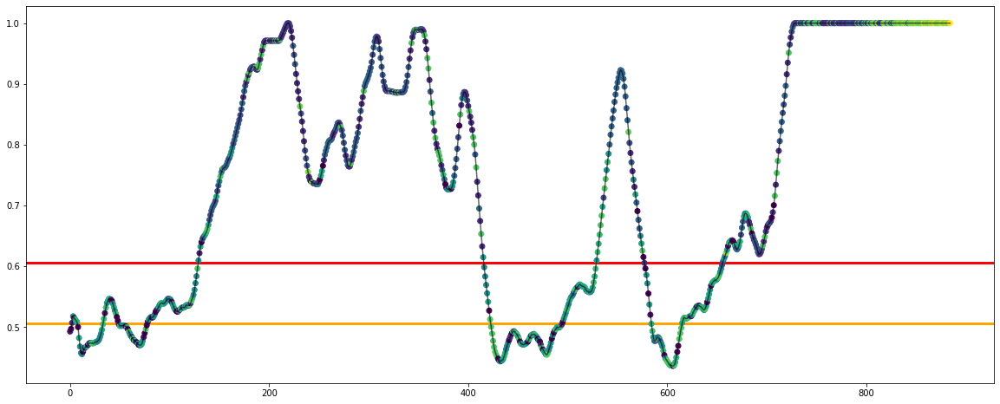

Experiment: 14_20151014_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.32946894 0.3447525  0.3293213  0.33533048 0.32946894        nan
 0.34936902 0.35322155 0.34936902 0.28754031]
  category=UserWarning


Best Model:
	Score: 0.3532
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.1227
	Calinski-Harabasz Index: 92.9893
	Davies Bouldin Index: 1.1760
Numero de Clusters: 26


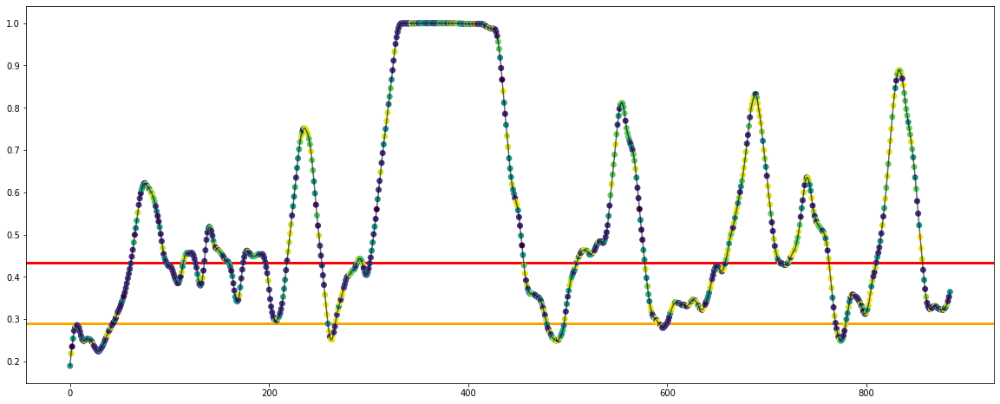

Experiment: 15_20151126_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.25868595 0.26664963 0.28116099 0.2577828  0.25868595        nan
 0.28305556 0.28588096 0.28305556 0.25696109]
  category=UserWarning


Best Model:
	Score: 0.2859
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.1449
	Calinski-Harabasz Index: 143.5376
	Davies Bouldin Index: 1.4335
Numero de Clusters: 21


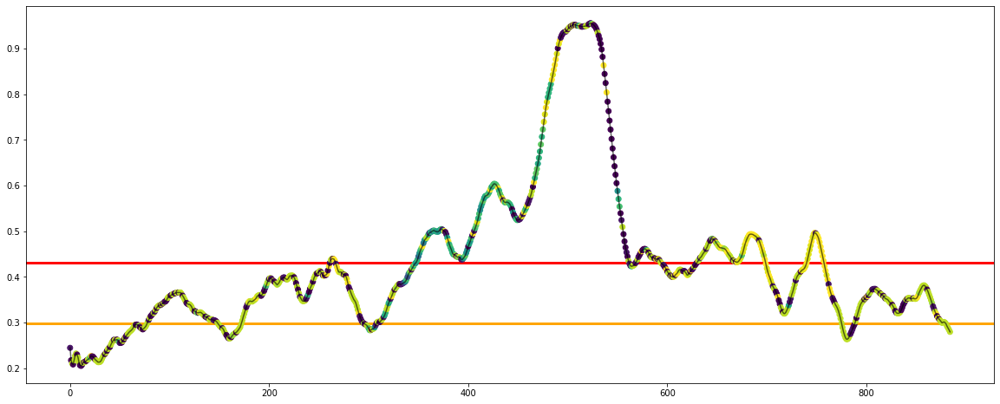

Experiment: 16_20151128_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.28838965 0.31770321 0.32805086 0.30311699 0.28838965        nan
 0.32678996 0.35584692 0.33012938 0.2742156 ]
  category=UserWarning


Best Model:
	Score: 0.3558
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.1172
	Calinski-Harabasz Index: 212.9476
	Davies Bouldin Index: 1.5083
Numero de Clusters: 16


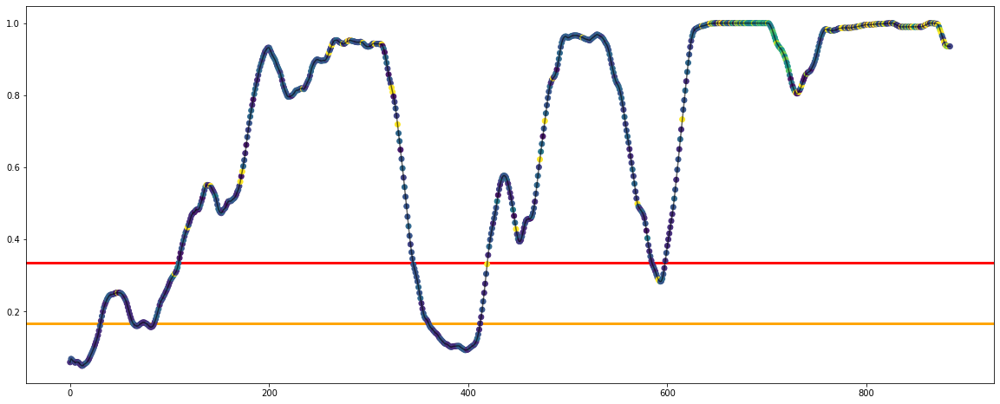

Experiment: 17_20150925_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.36154602 0.38811067 0.3932433  0.36608956 0.36154602        nan
 0.40653052 0.42842275 0.40751736 0.36001146]
  category=UserWarning


Best Model:
	Score: 0.4284
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0627
	Calinski-Harabasz Index: 69.2990
	Davies Bouldin Index: 1.6600
Numero de Clusters: 31


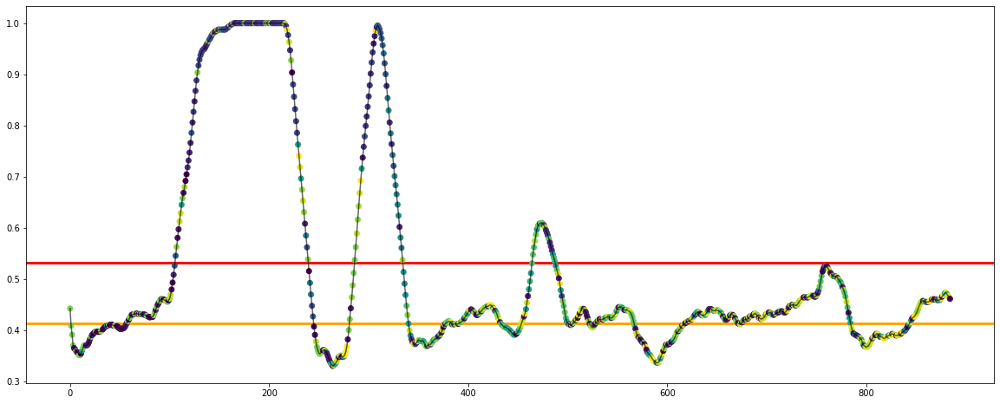

Experiment: 18_20150926_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.35587921 0.35772148 0.35517764 0.35376834 0.35587921        nan
 0.38162523 0.39142718 0.38162523 0.32820038]
  category=UserWarning


Best Model:
	Score: 0.3914
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.1830
	Calinski-Harabasz Index: 138.2520
	Davies Bouldin Index: 1.2086
Numero de Clusters: 22


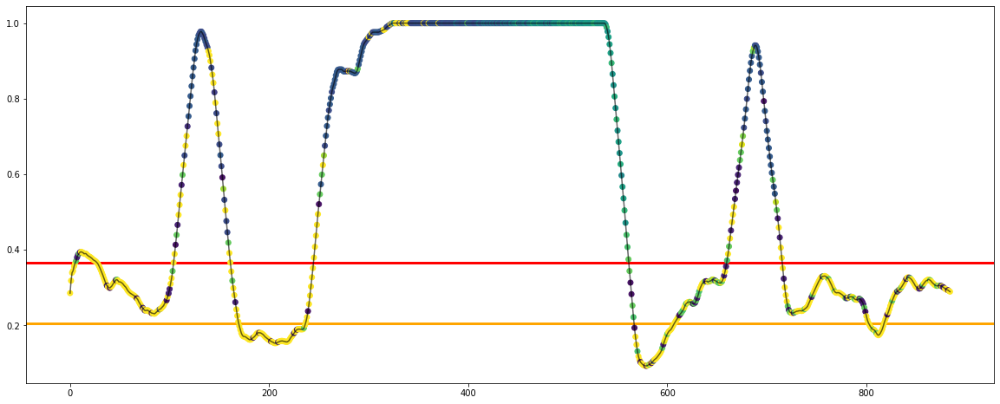

Experiment: 19_20151114_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.42921088 0.45045607 0.45076958 0.42155955 0.42921088        nan
 0.46915598 0.4963835  0.47181048 0.42125376]
  category=UserWarning


Best Model:
	Score: 0.4964
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0371
	Calinski-Harabasz Index: 47.0674
	Davies Bouldin Index: 2.2203
Numero de Clusters: 27


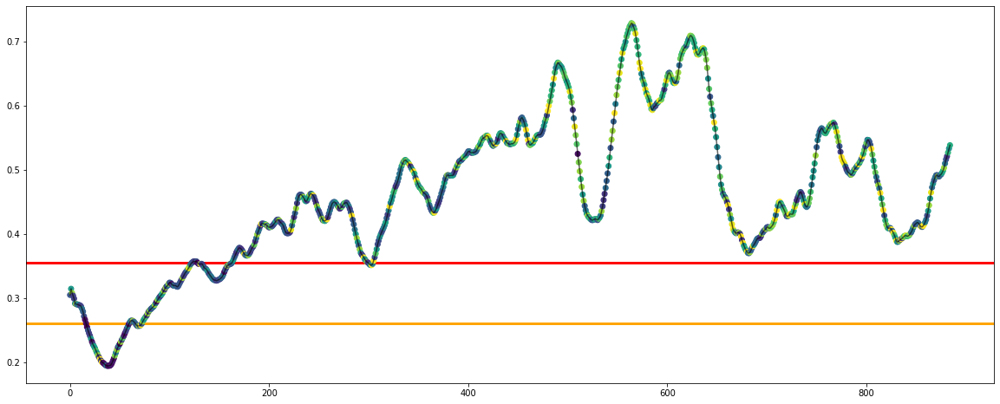

Experiment: 20_20151129_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.34046847 0.36315672 0.36269242 0.34505348 0.34143284        nan
 0.39562491 0.41809552 0.39562491 0.3233455 ]
  category=UserWarning


Best Model:
	Score: 0.4181
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.0508
	Calinski-Harabasz Index: 138.0631
	Davies Bouldin Index: 2.2852
Numero de Clusters: 20


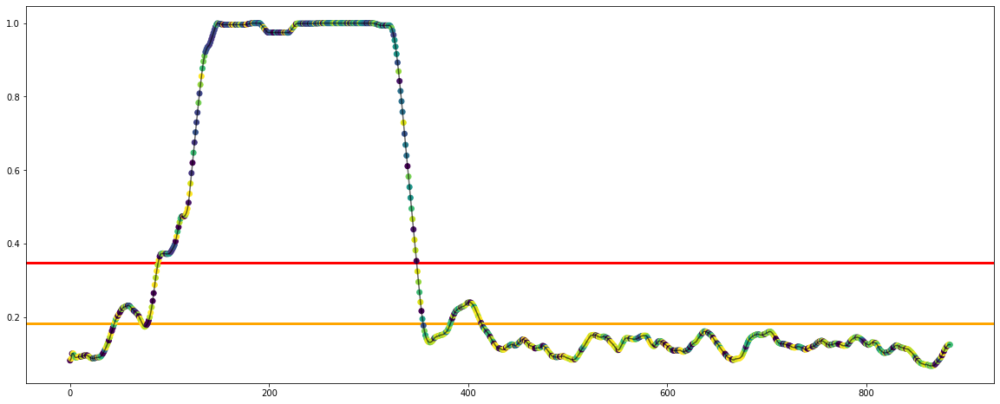

Experiment: 21_20151016_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.27278402 0.28533878 0.27300117 0.26451739 0.27278402        nan
 0.27895163 0.29555938 0.27895163 0.25729551]
  category=UserWarning


Best Model:
	Score: 0.2956
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.2704
	Calinski-Harabasz Index: 111.9920
	Davies Bouldin Index: 1.3062
Numero de Clusters: 21


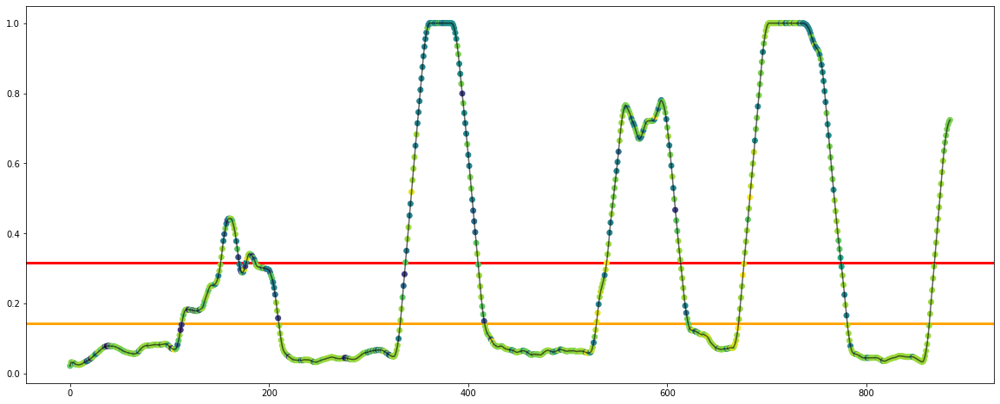

In [48]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    X, y = read_features(f'./features/{key}.csv')
    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)
    
    print(f"Experiment: {key}")
    model = AffinityPropagation(max_iter=1000, random_state=42)

    space = dict()
    space['damping'] = [0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
    space['convergence_iter'] = randint(8, 15)
    space['preference'] = range(-1, -10, -1)

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_minmax, y_all[key], model, space, cv=5, n_iter=10, scoring='homogeneity_score')
    
    cluster_centers_indices = best_model.cluster_centers_indices_
    n_clusters_ = len(cluster_centers_indices)
    print(f'Numero de Clusters: {n_clusters_}')
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_minmax, y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/AffProp-EEG.csv', index=False)

In [7]:
key = '21_20151016_noon'


print(f"Experiment: {key}")
model = AffinityPropagation(max_iter=1000, random_state=42)

space = dict()
space['damping'] = [0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
space['convergence_iter'] = randint(8, 15)
space['preference'] = range(-1, -10, -1)

best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all[key], y_all[key], model, space, cv=5, n_iter=10, scoring='homogeneity_score')

cluster_centers_indices = best_model.cluster_centers_indices_
n_clusters_ = len(cluster_centers_indices)
print(f'Numero de Clusters: {n_clusters_}')

lim_leve_moderada, lim_moderada_severa = y_all_limits[key]

Experiment: 21_20151016_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.05804194 0.03276269 0.09203403 0.05558032 0.05804194        nan
 0.06474679 0.08775447 0.04825989 0.06405049]
  category=UserWarning


Best Model:
	Score: 0.0920
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.7, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.6265
	Calinski-Harabasz Index: 535.2054
	Davies Bouldin Index: 0.5233
Numero de Clusters: 4


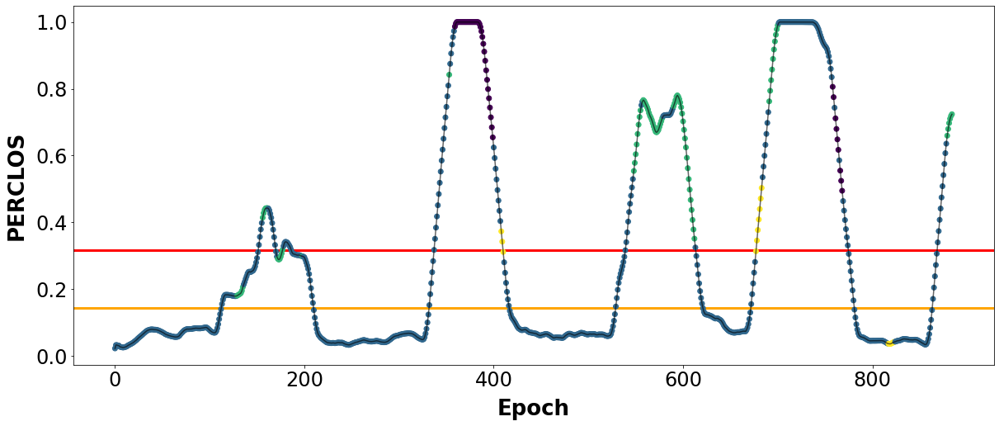

In [11]:
plt.figure(figsize=(20, 8))
plt.axhline(y=lim_leve_moderada, color='orange', linestyle='-', zorder=0, linewidth=3)
plt.axhline(y=lim_moderada_severa, color='red', linestyle='-', zorder=0, linewidth=3)
plt.plot(y_all[key], c='k', alpha=0.6)
colors = best_model.predict(X_all[key])
plt.scatter(range(len(y_all[key])), y_all[key], c=colors)
size_label = 26; plt.xlabel('Epoch', fontweight ='bold', labelpad = 10,fontsize = size_label); plt.ylabel('PERCLOS', fontweight ='bold', labelpad = 10,fontsize = size_label);
size_ticks = 24; plt.xticks(fontsize=size_ticks); plt.yticks(fontsize=size_ticks);
plt.savefig("E:/UNIVERSIDAD/TFG/TRABAJO/Images-Test/NOMBRE2.pdf", bbox_inches='tight')
plt.show()

### PSD

Experiment: 1_20151124_noon_2


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.2741667  0.27840671 0.27858993 0.26582654 0.2741667         nan
 0.27625419 0.27601977 0.27625419 0.28002285]
  category=UserWarning


Best Model:
	Score: 0.2800
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.8, 'preference': -9}

Cluestering evaluation:
	Silhouette Coefficient: 0.5849
	Calinski-Harabasz Index: 1363.3310
	Davies Bouldin Index: 0.4346
Numero de Clusters: 5


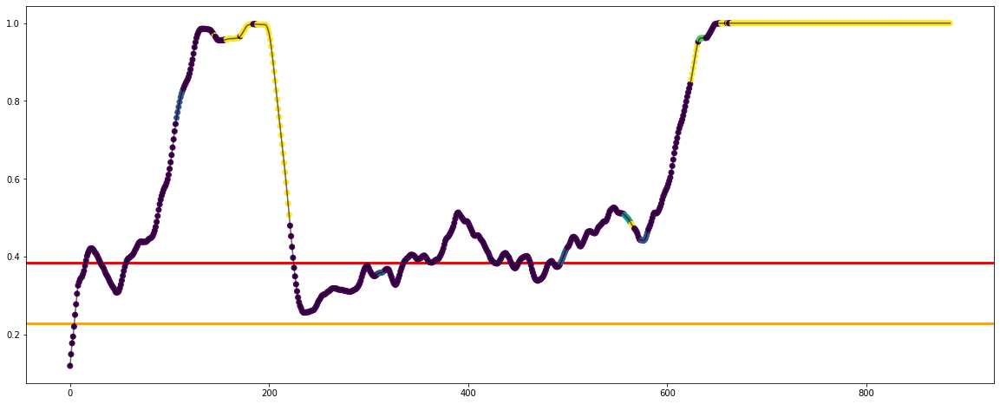

Experiment: 2_20151106_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.01930065 0.02604011 0.0128671  0.0128671  0.01930065        nan
 0.02775379 0.06331862 0.03267806 0.01930065]
  category=UserWarning


Best Model:
	Score: 0.0633
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.6484
	Calinski-Harabasz Index: 1479.5762
	Davies Bouldin Index: 0.6179
Numero de Clusters: 4


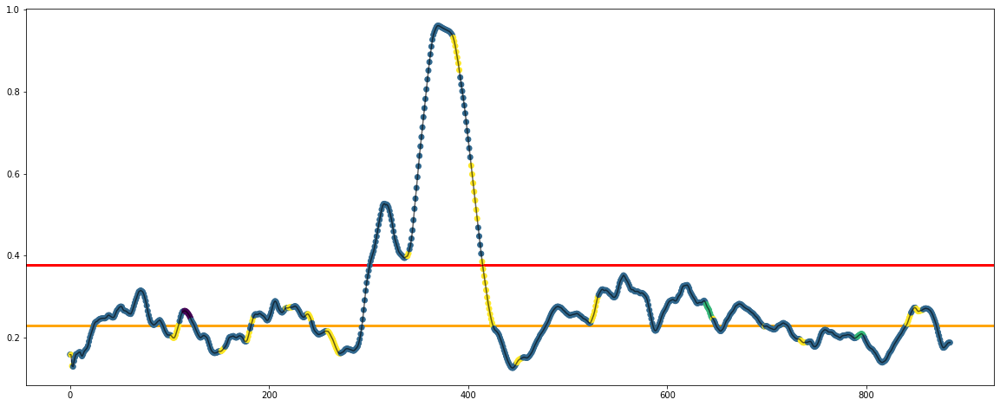

Experiment: 3_20151024_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.13006131 0.10968512 0.11981442 0.12882801 0.13006131        nan
 0.15301742 0.17120664 0.15301742 0.13775675]
  category=UserWarning


Best Model:
	Score: 0.1712
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4495
	Calinski-Harabasz Index: 1249.1205
	Davies Bouldin Index: 0.5362
Numero de Clusters: 5


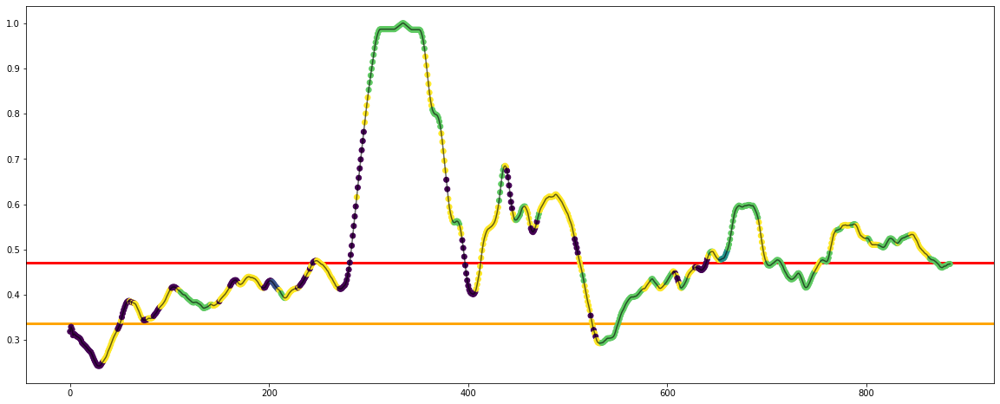

Experiment: 4_20151105_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.15826758 0.17939961 0.20970829 0.18420529 0.15826758        nan
 0.18154574 0.21327366 0.18154574 0.15591438]
  category=UserWarning


Best Model:
	Score: 0.2133
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.3409
	Calinski-Harabasz Index: 516.5180
	Davies Bouldin Index: 1.0404
Numero de Clusters: 5


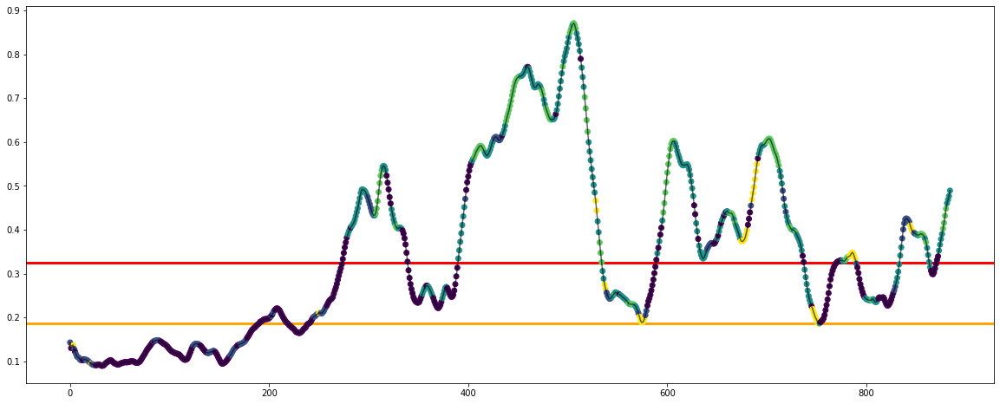

Experiment: 4_20151107_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.20739509 0.22499516 0.21210426 0.23521417 0.20739509        nan
 0.20739917 0.23615162 0.20739917 0.19699389]
  category=UserWarning


Best Model:
	Score: 0.2362
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.3099
	Calinski-Harabasz Index: 426.9555
	Davies Bouldin Index: 1.2225
Numero de Clusters: 5


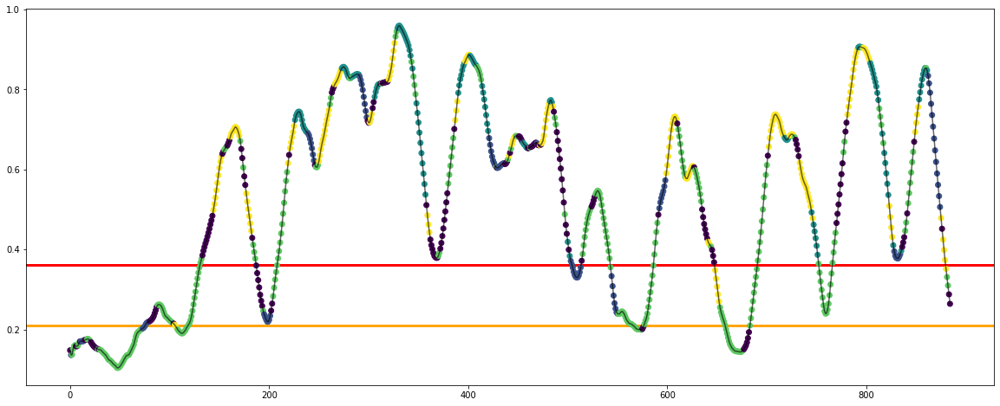

Experiment: 5_20141108_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.10744483 0.08981644 0.09443463 0.09360637 0.10744483        nan
 0.11414669 0.12992455 0.11414669 0.11595072]
  category=UserWarning


Best Model:
	Score: 0.1299
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.5161
	Calinski-Harabasz Index: 535.8495
	Davies Bouldin Index: 0.7851
Numero de Clusters: 6


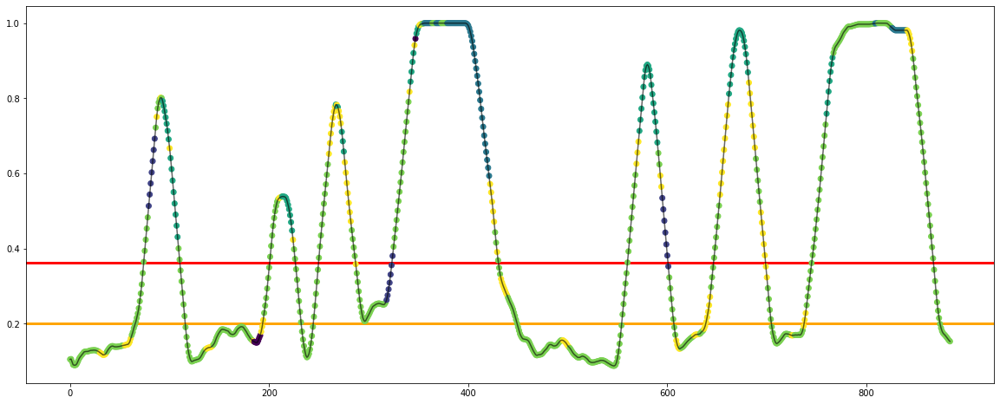

Experiment: 5_20151012_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.00643355 0.         0.         0.         0.00643355        nan
 0.04265179 0.03133966 0.04265179 0.        ]
  category=UserWarning


Best Model:
	Score: 0.0427
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -6}

Cluestering evaluation:
	Silhouette Coefficient: 0.6308
	Calinski-Harabasz Index: 2686.7967
	Davies Bouldin Index: 0.5040
Numero de Clusters: 3


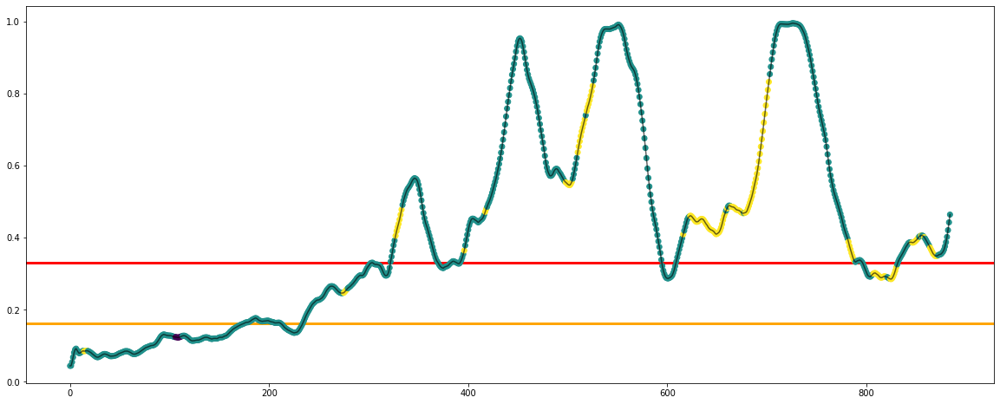

Experiment: 6_20151121_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.         0.05449716 0.         0.         0.                nan
 0.         0.         0.         0.        ]
  category=UserWarning


Best Model:
	Score: 0.0545
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.9, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.8047
	Calinski-Harabasz Index: 1596.1532
	Davies Bouldin Index: 0.4341
Numero de Clusters: 4


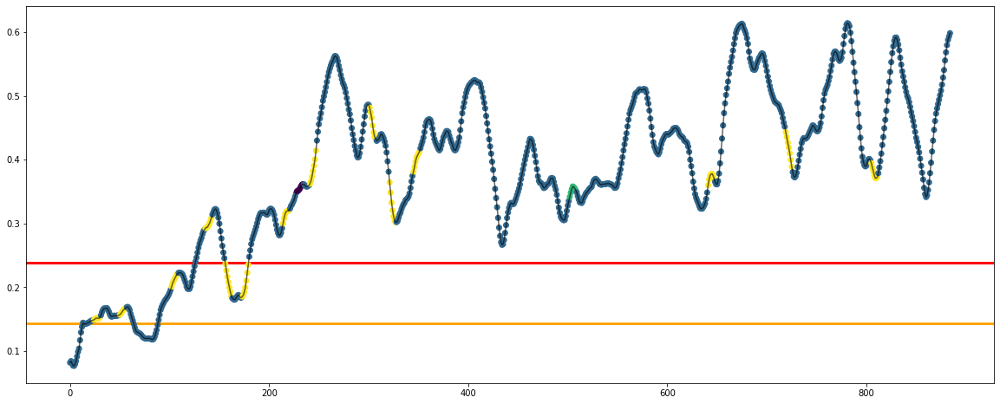

Experiment: 7_20151015_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.15313909 0.13427741 0.17414196 0.16230394 0.15313909        nan
 0.13822011 0.1818216  0.13822011 0.13504193]
  category=UserWarning


Best Model:
	Score: 0.1818
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.3446
	Calinski-Harabasz Index: 704.6333
	Davies Bouldin Index: 0.7457
Numero de Clusters: 6


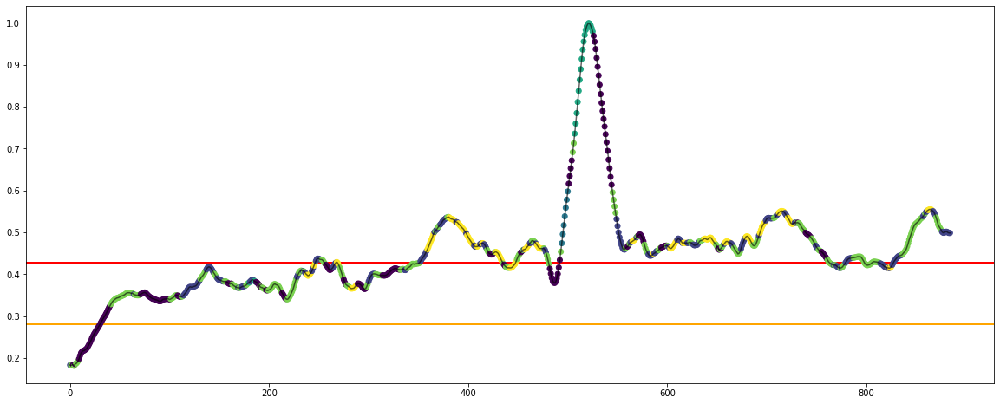

Experiment: 8_20151022_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.        0.3142066 0.        0.        0.              nan 0.1532967
 0.        0.1532967 0.       ]
  category=UserWarning


Best Model:
	Score: 0.3142
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.9, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.9846
	Calinski-Harabasz Index: 6184.9485
	Davies Bouldin Index: 0.1082
Numero de Clusters: 2


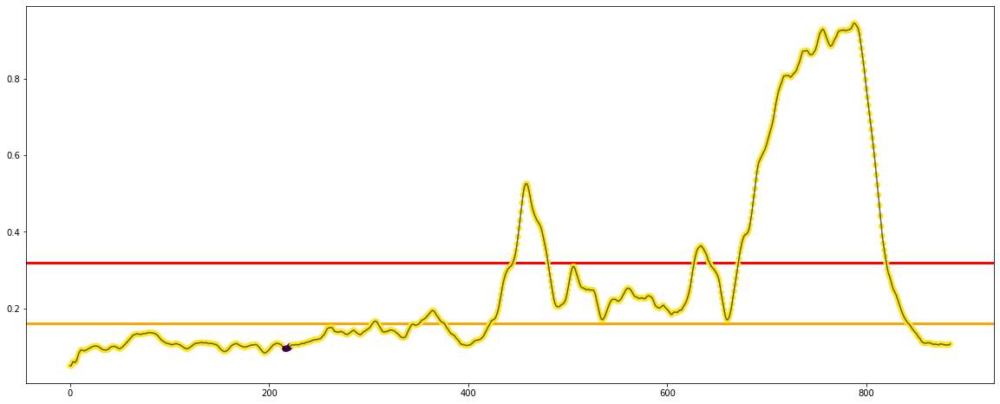

Experiment: 9_20151017_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.07258022 0.07413941 0.07431045 0.07162849 0.0481402         nan
 0.04827236 0.05595322 0.04827236 0.0481402 ]
  category=UserWarning


Best Model:
	Score: 0.0743
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.7, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.7401
	Calinski-Harabasz Index: 849.7703
	Davies Bouldin Index: 0.7187
Numero de Clusters: 4


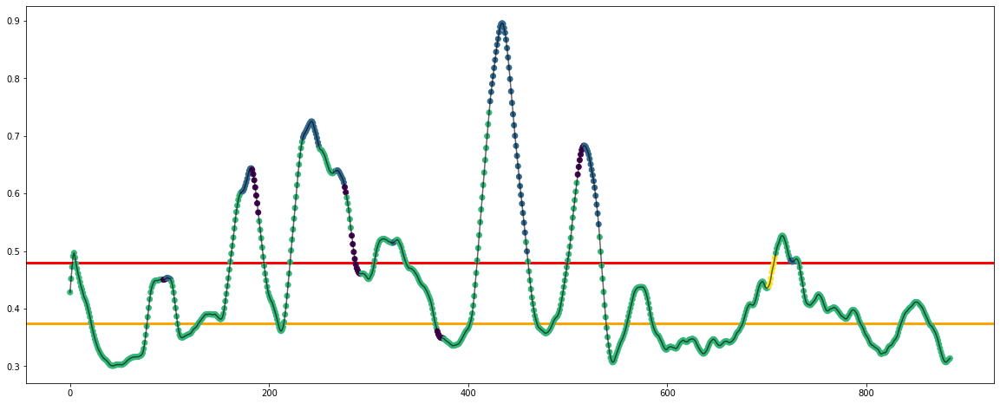

Experiment: 10_20151125_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.         0.         0.16720309 0.         0.                nan
 0.         0.         0.         0.        ]
  category=UserWarning


Best Model:
	Score: 0.1672
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.7, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.9653
	Calinski-Harabasz Index: 5424.7090
	Davies Bouldin Index: 0.0329
Numero de Clusters: 2


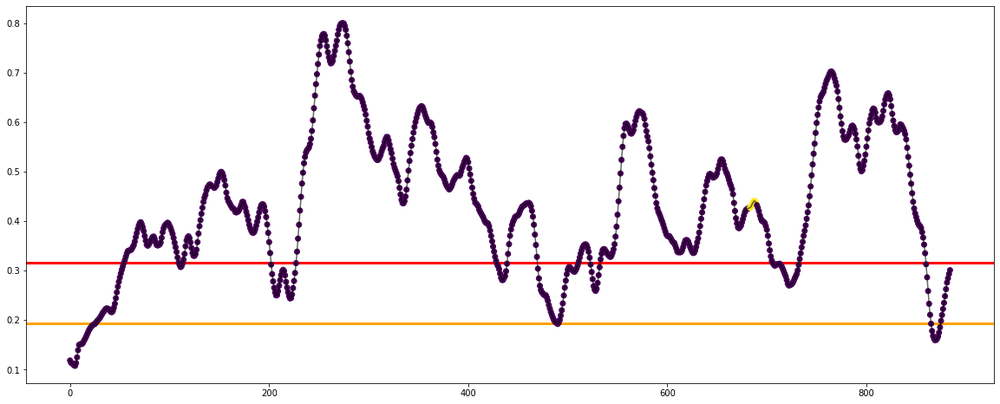

Experiment: 11_20151024_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.08799961 0.09336994 0.15149232 0.06416661 0.07430486        nan
 0.12698166 0.16799952 0.12698166 0.0678302 ]
  category=UserWarning


Best Model:
	Score: 0.1680
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4518
	Calinski-Harabasz Index: 517.4668
	Davies Bouldin Index: 0.5803
Numero de Clusters: 5


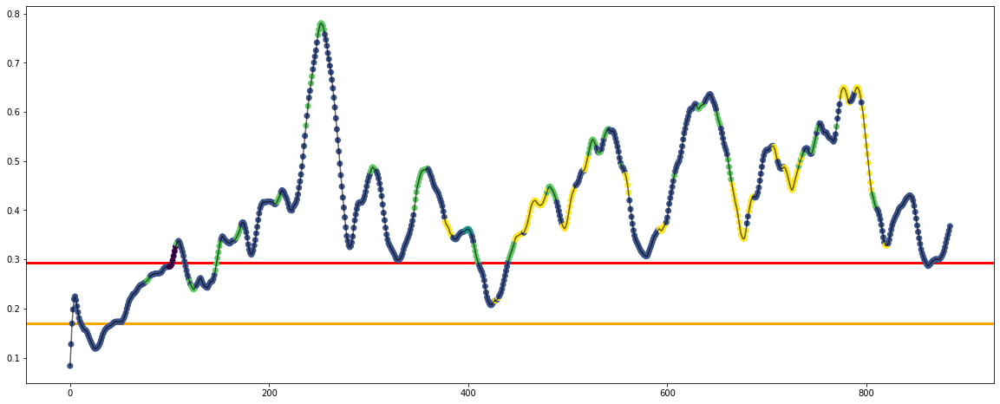

Experiment: 12_20150928_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.19318457 0.17409965 0.19009324 0.17587027 0.18159165        nan
 0.22925415 0.2474689  0.20550288 0.18369629]
  category=UserWarning


Best Model:
	Score: 0.2475
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4411
	Calinski-Harabasz Index: 693.3626
	Davies Bouldin Index: 0.7402
Numero de Clusters: 7


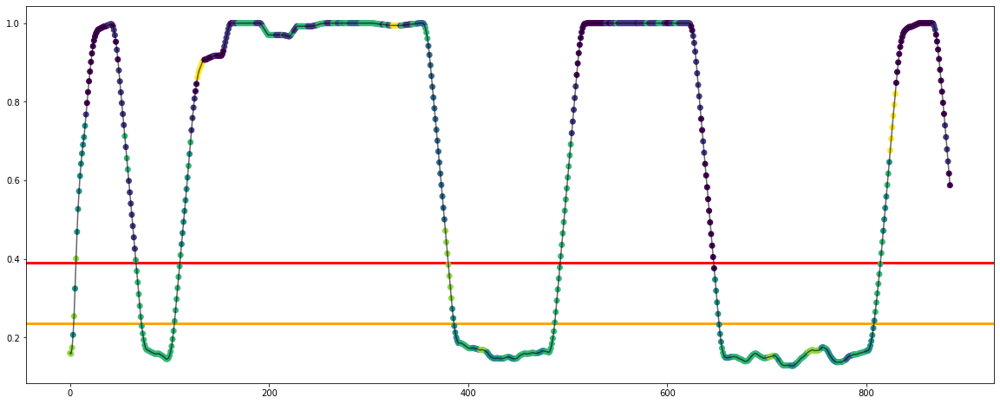

Experiment: 13_20150929_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.11966171 0.13788566 0.16351052 0.1351358  0.11966171        nan
 0.1620827  0.18292755 0.1620827  0.12974572]
  category=UserWarning


Best Model:
	Score: 0.1829
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.5438
	Calinski-Harabasz Index: 717.1394
	Davies Bouldin Index: 0.4852
Numero de Clusters: 5


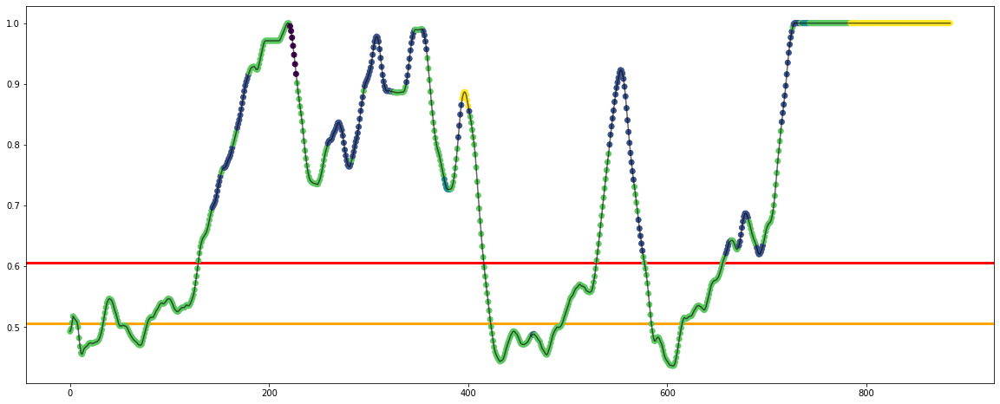

Experiment: 14_20151014_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.15865072 0.11855304 0.15781303 0.15966711 0.15865072        nan
 0.16100746 0.15602431 0.16100746 0.13220257]
  category=UserWarning


Best Model:
	Score: 0.1610
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -6}

Cluestering evaluation:
	Silhouette Coefficient: 0.5364
	Calinski-Harabasz Index: 722.4070
	Davies Bouldin Index: 0.8131
Numero de Clusters: 6


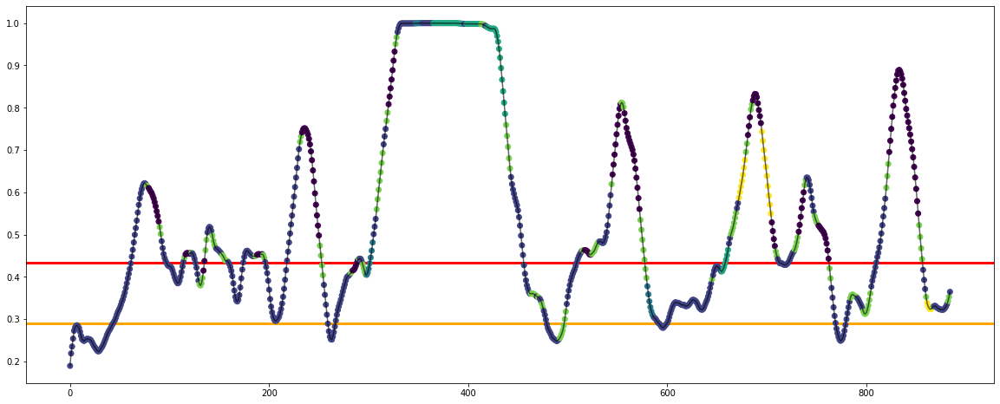

Experiment: 15_20151126_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.         0.         0.         0.         0.                nan
 0.01014127 0.00496896 0.01014127 0.        ]
  category=UserWarning


Best Model:
	Score: 0.0101
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -6}

Cluestering evaluation:
	Silhouette Coefficient: 0.4786
	Calinski-Harabasz Index: 1687.6772
	Davies Bouldin Index: 0.8192
Numero de Clusters: 3


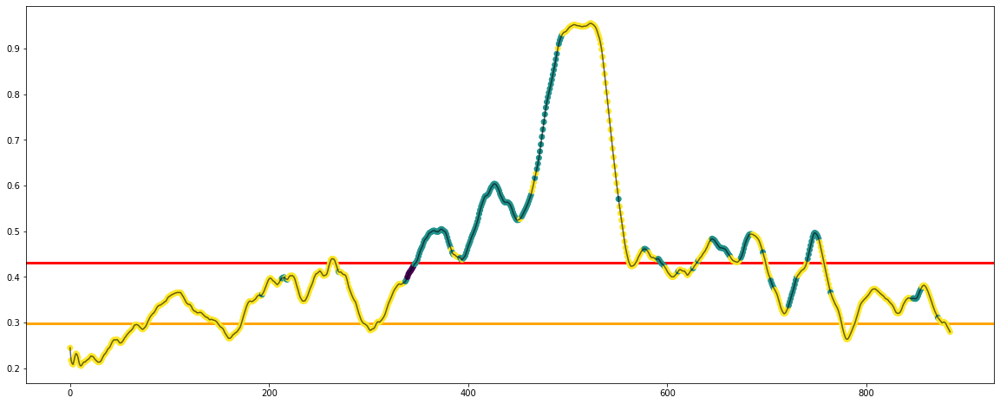

Experiment: 16_20151128_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.         0.17591593 0.32547738 0.47239674 0.                nan
 0.         0.         0.         0.        ]
  category=UserWarning


Best Model:
	Score: 0.4724
	Hyperparameters: {'convergence_iter': 10, 'damping': 0.7, 'preference': -8}

Cluestering evaluation:
	Silhouette Coefficient: 0.9799
	Calinski-Harabasz Index: 10398.5765
	Davies Bouldin Index: 0.0167
Numero de Clusters: 2


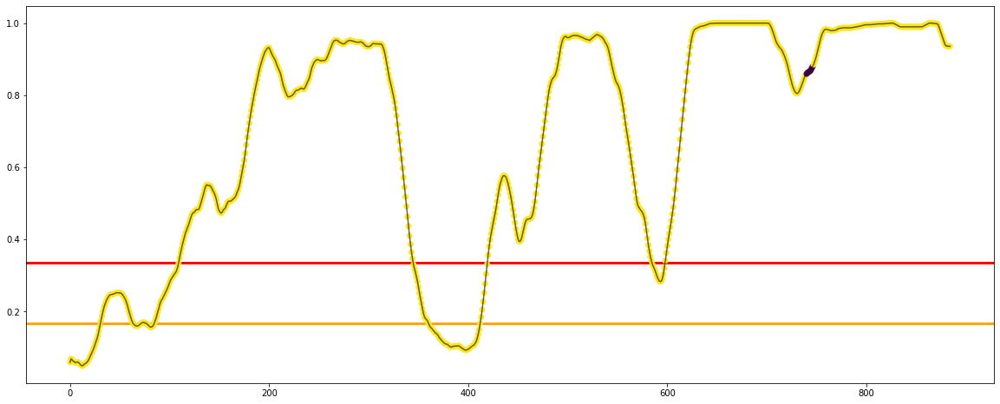

Experiment: 17_20150925_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.12651061 0.12347436 0.16375083 0.13570121 0.12651061        nan
 0.13103329 0.13883416 0.13103329 0.12417074]
  category=UserWarning


Best Model:
	Score: 0.1638
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.7, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.4526
	Calinski-Harabasz Index: 779.9441
	Davies Bouldin Index: 0.6827
Numero de Clusters: 4


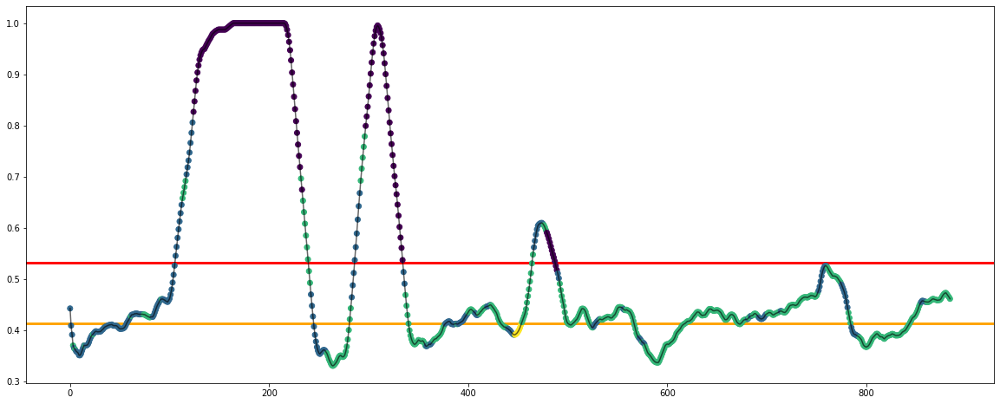

Experiment: 18_20150926_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.29396669 0.29452818 0.28810106 0.21341054 0.29396669        nan
 0.29392851 0.29396669 0.28096434 0.26910248]
  category=UserWarning


Best Model:
	Score: 0.2945
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.9, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.7341
	Calinski-Harabasz Index: 697.6723
	Davies Bouldin Index: 0.7118
Numero de Clusters: 3


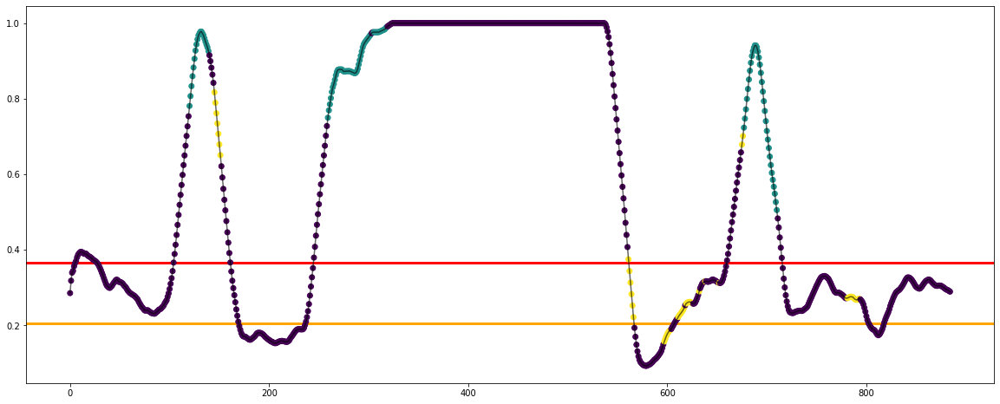

Experiment: 19_20151114_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.         0.         0.68856436 0.85112753 0.                nan
 0.         0.         0.         0.        ]
  category=UserWarning


Best Model:
	Score: 0.8511
	Hyperparameters: {'convergence_iter': 10, 'damping': 0.7, 'preference': -8}

Cluestering evaluation:
	Silhouette Coefficient: 0.9578
	Calinski-Harabasz Index: 5651.1689
	Davies Bouldin Index: 0.0432
Numero de Clusters: 2


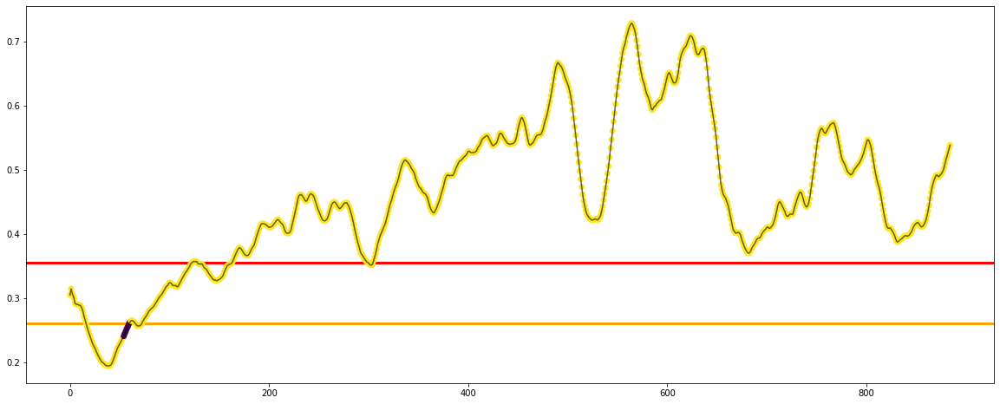

Experiment: 20_20151129_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.05300553 0.05369419 0.0302958  0.01336228 0.05300553        nan
 0.01987326 0.0196064  0.0114802  0.02705039]
  category=UserWarning


Best Model:
	Score: 0.0537
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.9, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.5747
	Calinski-Harabasz Index: 411.0728
	Davies Bouldin Index: 1.0359
Numero de Clusters: 2


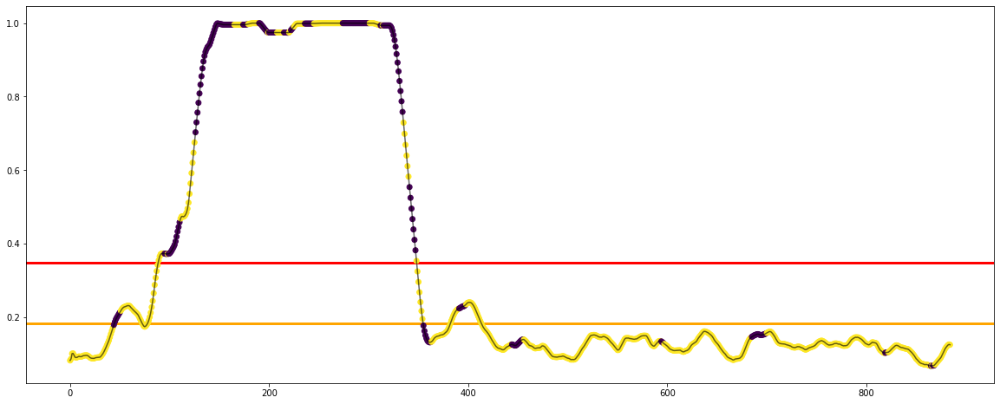

Experiment: 21_20151016_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.05804194 0.03276269 0.09203403 0.05558032 0.05804194        nan
 0.06474679 0.08775447 0.04825989 0.06405049]
  category=UserWarning


Best Model:
	Score: 0.0920
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.7, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.6265
	Calinski-Harabasz Index: 535.2054
	Davies Bouldin Index: 0.5233
Numero de Clusters: 4


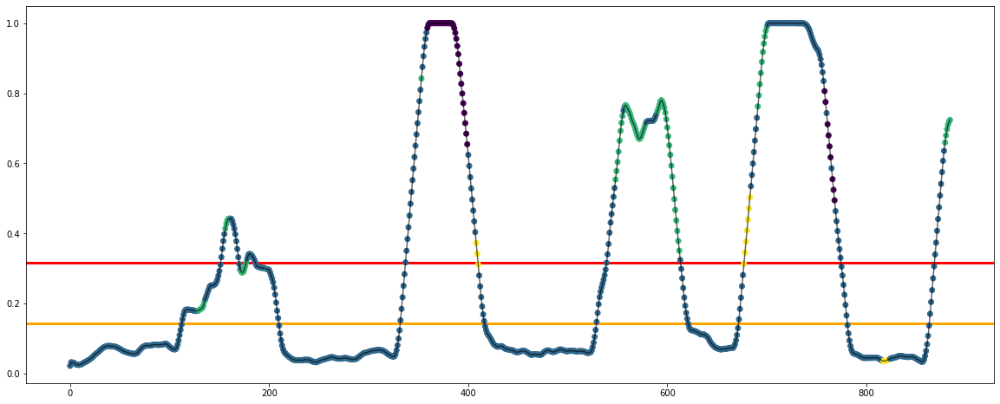

In [39]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = AffinityPropagation(max_iter=1000, random_state=42)

    space = dict()
    space['damping'] = [0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
    space['convergence_iter'] = randint(8, 15)
    space['preference'] = range(-1, -10, -1)

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all[key], y_all[key], model, space, cv=5, n_iter=10, scoring='homogeneity_score')
    
    cluster_centers_indices = best_model.cluster_centers_indices_
    n_clusters_ = len(cluster_centers_indices)
    print(f'Numero de Clusters: {n_clusters_}')
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/AffProp-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.3189177  0.34868763 0.33027059 0.31695622 0.3189177         nan
 0.34333465 0.37316917 0.34333465 0.34529377]
  category=UserWarning


Best Model:
	Score: 0.3732
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4500
	Calinski-Harabasz Index: 888.4639
	Davies Bouldin Index: 0.5530
Numero de Clusters: 6


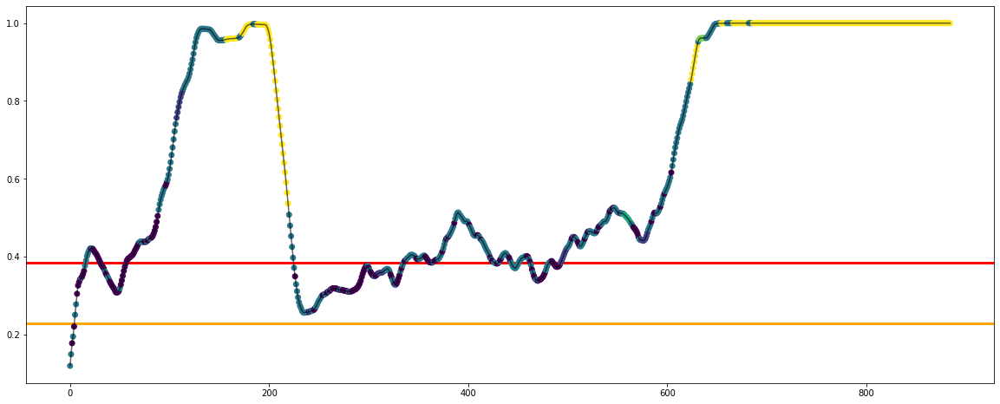

Experiment: 2_20151106_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.07289429 0.13465153 0.11669566 0.0886273  0.08057939        nan
 0.12464341 0.14112775 0.12464341 0.06466466]
  category=UserWarning


Best Model:
	Score: 0.1411
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4536
	Calinski-Harabasz Index: 745.7685
	Davies Bouldin Index: 0.6573
Numero de Clusters: 4


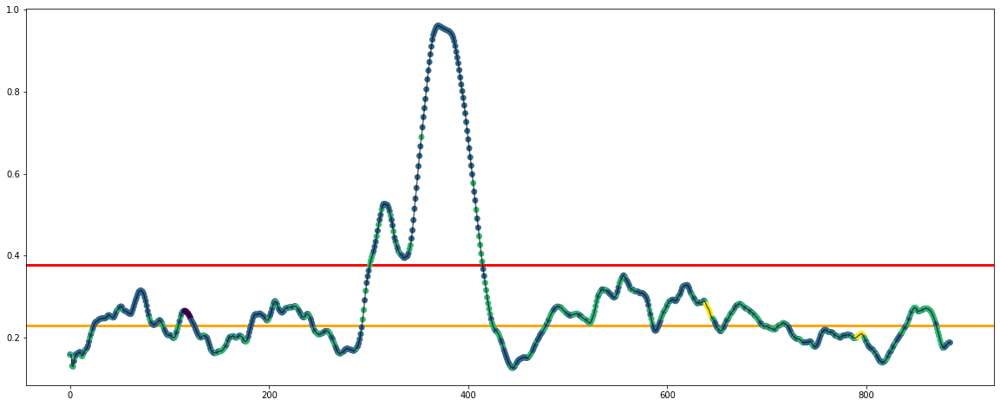

Experiment: 3_20151024_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.18616527 0.18309352 0.22942438 0.2019367  0.18616527        nan
 0.17646503 0.23138382 0.17646503 0.20257493]
  category=UserWarning


Best Model:
	Score: 0.2314
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.3825
	Calinski-Harabasz Index: 587.0149
	Davies Bouldin Index: 0.7291
Numero de Clusters: 6


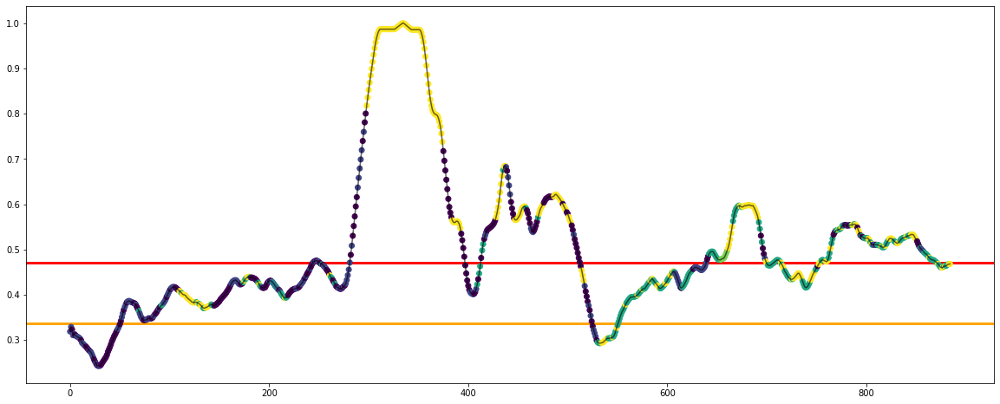

Experiment: 4_20151105_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.21803782 0.24293487 0.24153909 0.24535257 0.22159141        nan
 0.2387172  0.25638008 0.2387172  0.21603142]
  category=UserWarning


Best Model:
	Score: 0.2564
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.2708
	Calinski-Harabasz Index: 323.0389
	Davies Bouldin Index: 1.2502
Numero de Clusters: 6


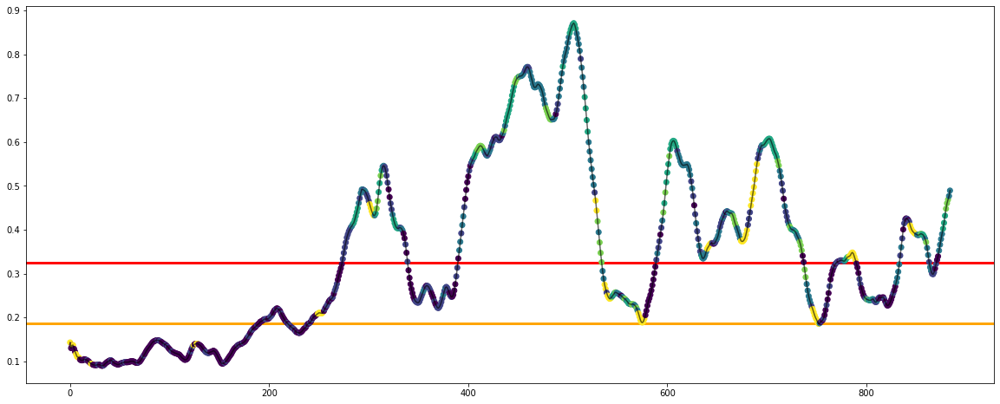

Experiment: 4_20151107_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.24450962 0.2126008  0.25358159 0.20673287 0.22805562        nan
 0.25471756 0.26583983 0.25471756 0.21032169]
  category=UserWarning


Best Model:
	Score: 0.2658
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.2385
	Calinski-Harabasz Index: 315.6387
	Davies Bouldin Index: 1.2290
Numero de Clusters: 7


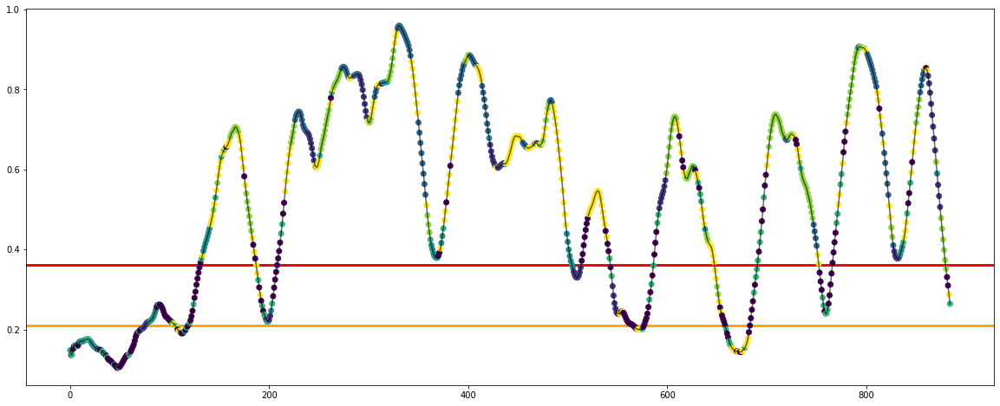

Experiment: 5_20141108_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.18981522 0.1878208  0.20674479 0.16959708 0.18981522        nan
 0.1886306  0.19265546 0.1886306  0.18430839]
  category=UserWarning


Best Model:
	Score: 0.2067
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.7, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.3019
	Calinski-Harabasz Index: 340.5011
	Davies Bouldin Index: 0.9443
Numero de Clusters: 7


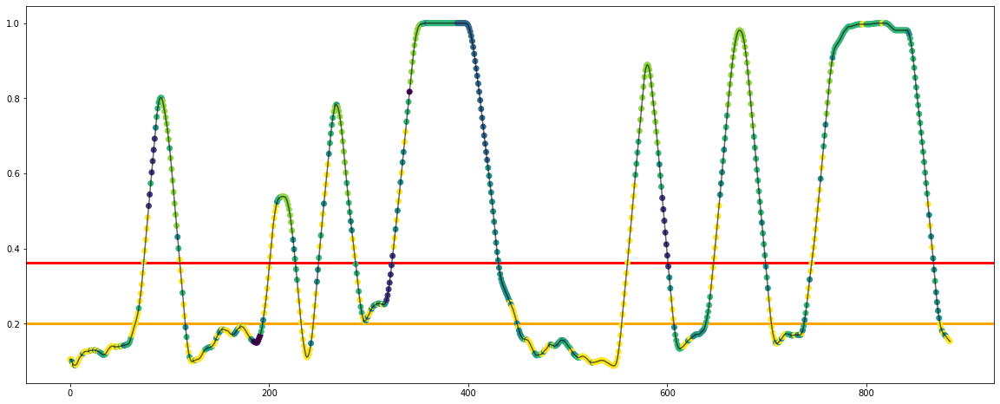

Experiment: 5_20151012_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.17140493 0.11412616 0.08990555 0.11552006 0.17140493        nan
 0.17137664 0.1806885  0.17137664 0.17209367]
  category=UserWarning


Best Model:
	Score: 0.1807
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4455
	Calinski-Harabasz Index: 1350.5675
	Davies Bouldin Index: 0.6544
Numero de Clusters: 4


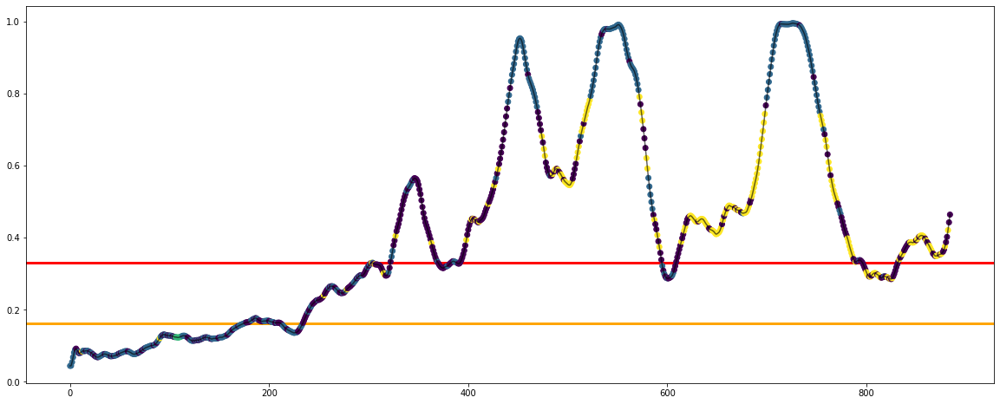

Experiment: 6_20151121_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.13965706 0.13712703 0.         0.         0.13965706        nan
 0.13564823 0.16525125 0.13564823 0.12477235]
  category=UserWarning


Best Model:
	Score: 0.1653
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4849
	Calinski-Harabasz Index: 773.0472
	Davies Bouldin Index: 0.6519
Numero de Clusters: 6


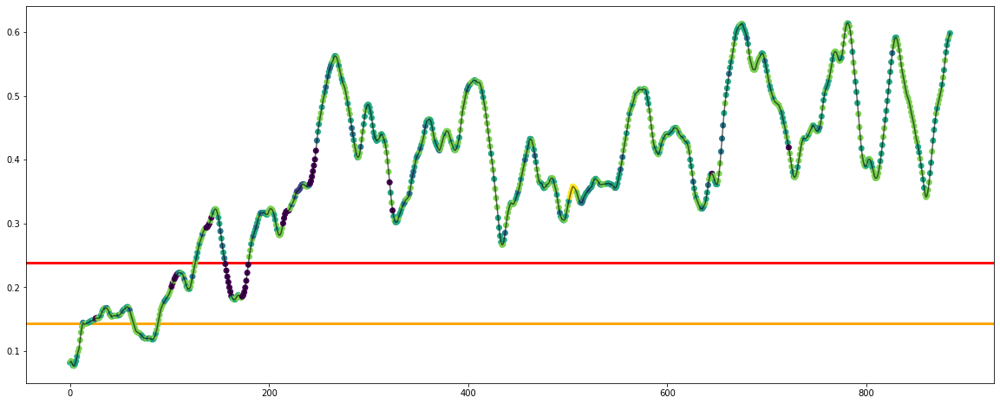

Experiment: 7_20151015_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.19205959 0.18794038 0.21280437 0.19499118 0.19205959        nan
 0.21047417 0.21770275 0.21047417 0.17634628]
  category=UserWarning


Best Model:
	Score: 0.2177
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.2667
	Calinski-Harabasz Index: 422.5287
	Davies Bouldin Index: 0.9520
Numero de Clusters: 7


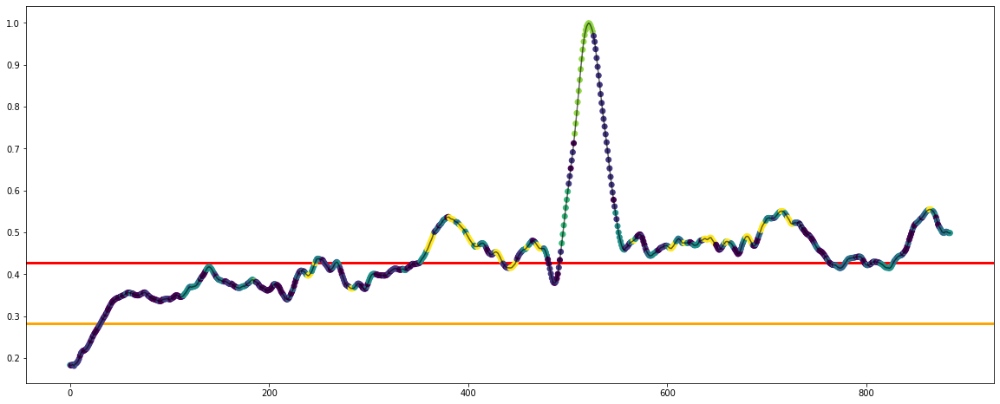

Experiment: 8_20151022_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.         0.3667962  0.         0.         0.                nan
 0.08384023 0.03908423 0.08384023 0.        ]
  category=UserWarning


Best Model:
	Score: 0.3668
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.9, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.1047
	Calinski-Harabasz Index: 20.5850
	Davies Bouldin Index: 1.1685
Numero de Clusters: 147


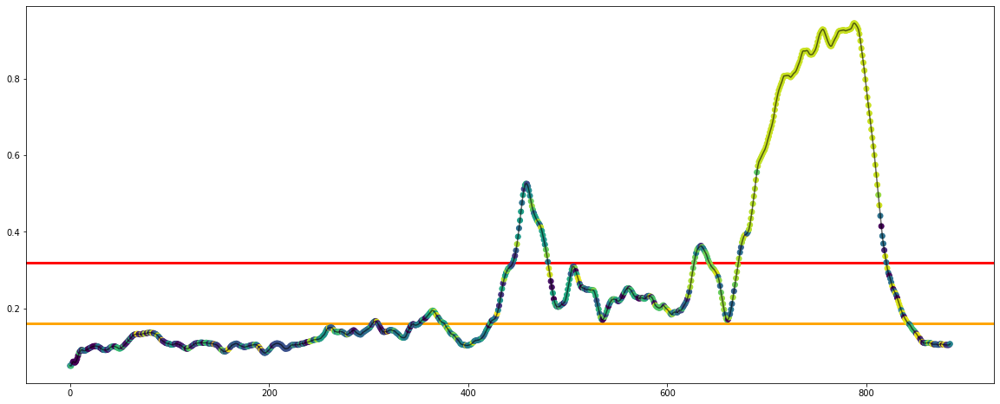

Experiment: 9_20151017_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.174192   0.17662543 0.19369471 0.20633515 0.174192          nan
 0.2270663  0.23719971 0.2270663  0.16943068]
  category=UserWarning


Best Model:
	Score: 0.2372
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4255
	Calinski-Harabasz Index: 692.6333
	Davies Bouldin Index: 0.6796
Numero de Clusters: 7


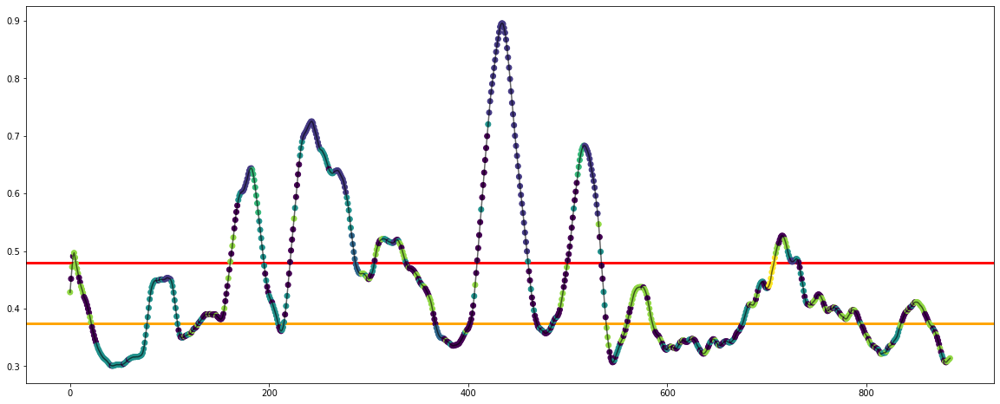

Experiment: 10_20151125_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.09500654 0.09911417 0.01121335 0.         0.09500654        nan
 0.11236793 0.09500654 0.07435862 0.07435862]
  category=UserWarning


Best Model:
	Score: 0.1124
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -6}

Cluestering evaluation:
	Silhouette Coefficient: 0.5854
	Calinski-Harabasz Index: 1705.5961
	Davies Bouldin Index: 0.5092
Numero de Clusters: 3


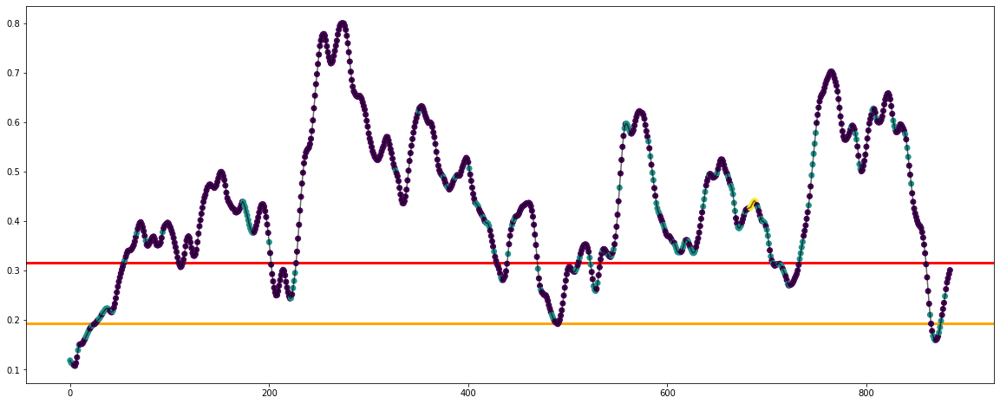

Experiment: 11_20151024_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.15918017 0.17356873 0.15842553 0.14992412 0.15918017        nan
 0.20795955 0.22569473 0.20795955 0.15579371]
  category=UserWarning


Best Model:
	Score: 0.2257
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.2383
	Calinski-Harabasz Index: 331.2687
	Davies Bouldin Index: 0.9646
Numero de Clusters: 7


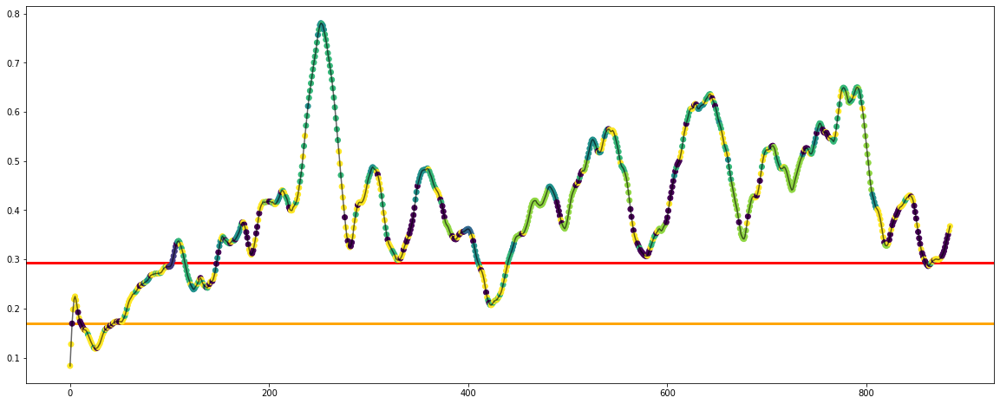

Experiment: 12_20150928_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.22030297 0.2385431  0.25988431 0.21148218 0.22023685        nan
 0.23901981 0.25658878 0.23901981 0.22433418]
  category=UserWarning


Best Model:
	Score: 0.2599
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.7, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.3522
	Calinski-Harabasz Index: 506.7731
	Davies Bouldin Index: 1.0135
Numero de Clusters: 5


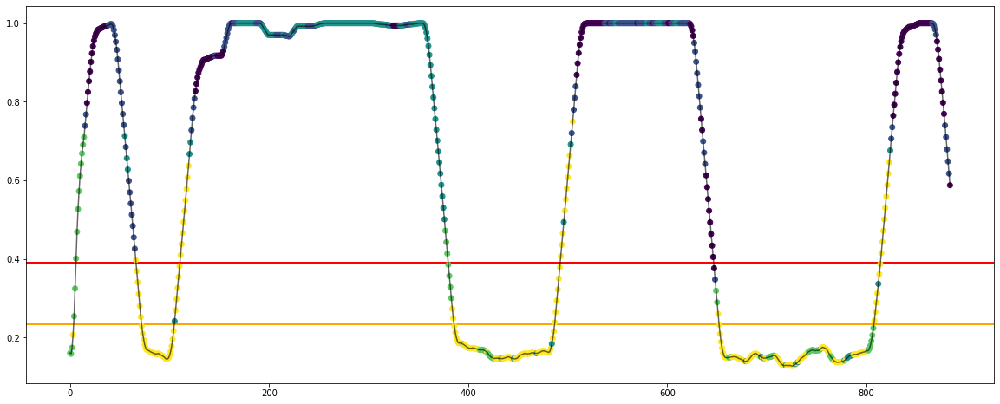

Experiment: 13_20150929_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.20441349 0.19839513 0.22486581 0.19298501 0.20441349        nan
 0.19637899 0.2350349  0.19637899 0.19610396]
  category=UserWarning


Best Model:
	Score: 0.2350
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4057
	Calinski-Harabasz Index: 615.6189
	Davies Bouldin Index: 0.8100
Numero de Clusters: 6


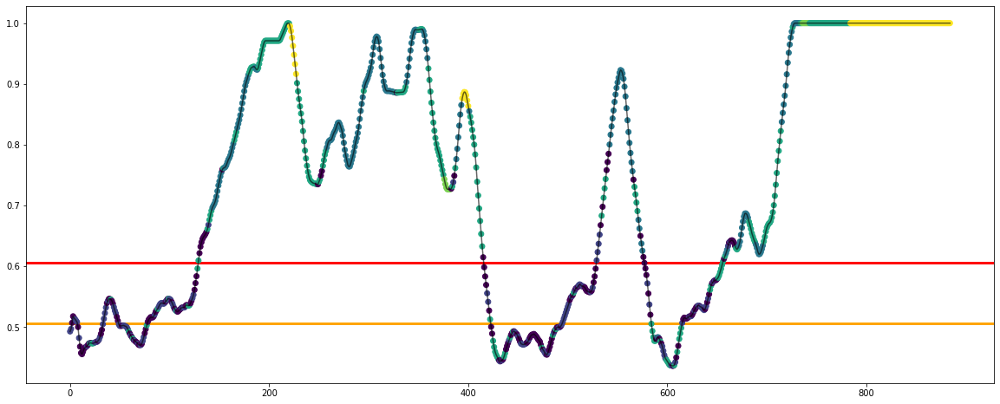

Experiment: 14_20151014_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.18715485 0.18942628 0.22494394 0.18660965 0.20412925        nan
 0.19207822 0.24971817 0.19207822 0.18576349]
  category=UserWarning


Best Model:
	Score: 0.2497
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4012
	Calinski-Harabasz Index: 497.7618
	Davies Bouldin Index: 0.8426
Numero de Clusters: 7


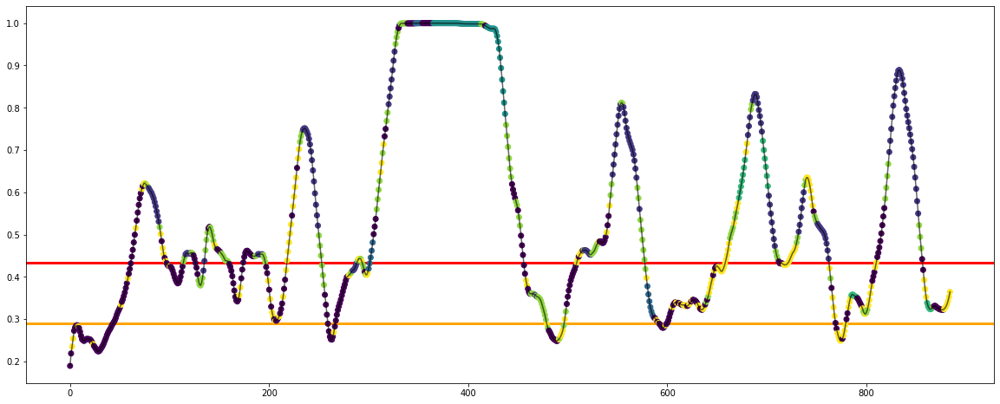

Experiment: 15_20151126_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.13546763 0.16410445 0.14928133 0.16291777 0.13546763        nan
 0.1699412  0.20025064 0.1699412  0.12007327]
  category=UserWarning


Best Model:
	Score: 0.2003
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.4086
	Calinski-Harabasz Index: 1045.0064
	Davies Bouldin Index: 0.7034
Numero de Clusters: 4


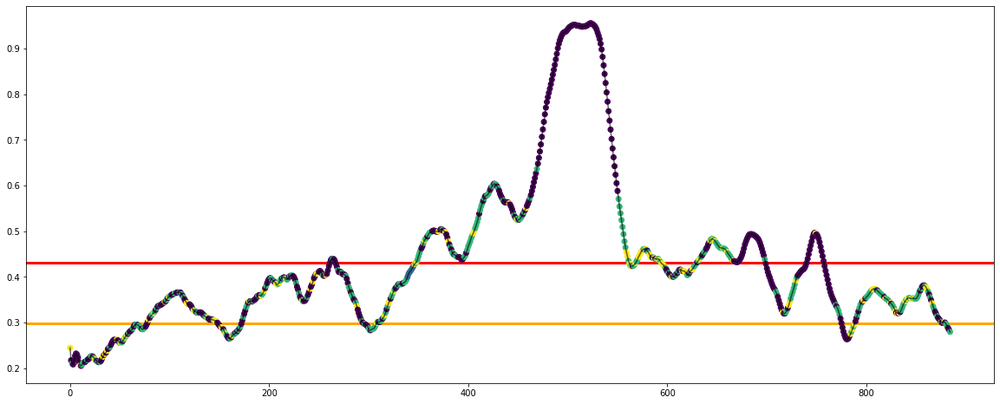

Experiment: 16_20151128_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.02300111 0.2356248  0.04473465 0.04473465 0.03076761        nan
 0.03076761 0.0531865  0.03076761 0.05938534]
  category=UserWarning


Best Model:
	Score: 0.2356
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.9, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.8544
	Calinski-Harabasz Index: 2844.9653
	Davies Bouldin Index: 0.3552
Numero de Clusters: 3


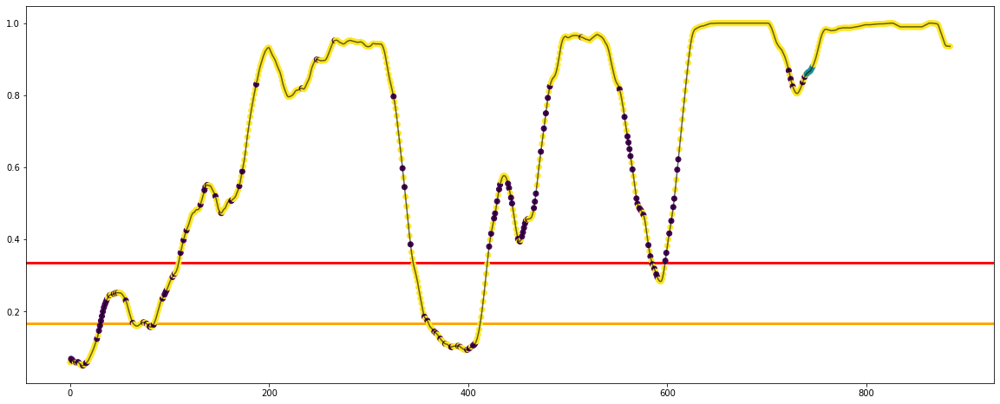

Experiment: 17_20150925_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.20779651 0.20288343 0.214468   0.17625269 0.20779651        nan
 0.22331507 0.2243045  0.22331507 0.19058101]
  category=UserWarning


Best Model:
	Score: 0.2243
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.3667
	Calinski-Harabasz Index: 609.3020
	Davies Bouldin Index: 0.9019
Numero de Clusters: 6


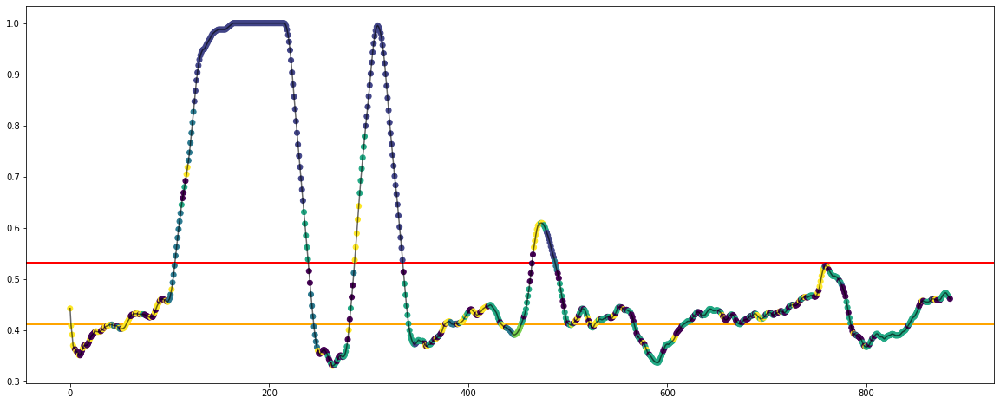

Experiment: 18_20150926_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.34259334 0.35813833 0.36101628 0.36195383 0.34259334        nan
 0.36947528 0.36553889 0.35899636 0.34760543]
  category=UserWarning


Best Model:
	Score: 0.3695
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -6}

Cluestering evaluation:
	Silhouette Coefficient: 0.5040
	Calinski-Harabasz Index: 694.7527
	Davies Bouldin Index: 0.7167
Numero de Clusters: 5


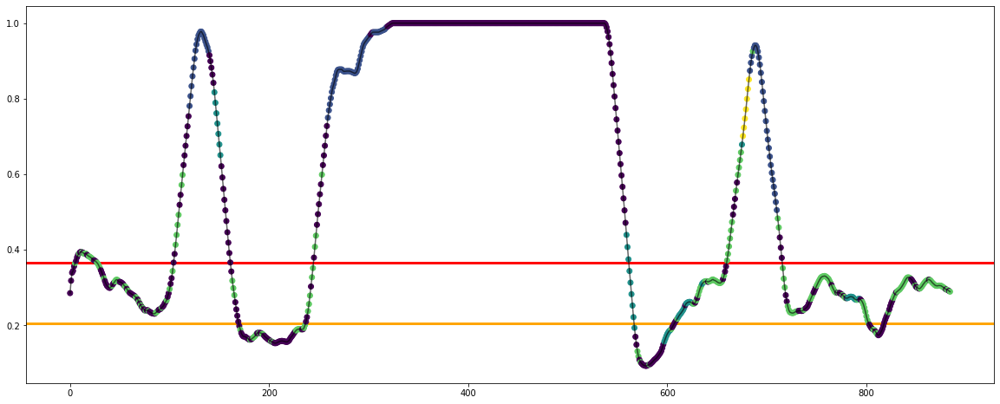

Experiment: 19_20151114_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.10790943 0.1397424  0.11960547 0.10294638 0.10790943        nan
 0.14405155 0.12733797 0.14405155 0.12337599]
  category=UserWarning


Best Model:
	Score: 0.1441
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -6}

Cluestering evaluation:
	Silhouette Coefficient: 0.4055
	Calinski-Harabasz Index: 1569.7267
	Davies Bouldin Index: 0.6266
Numero de Clusters: 4


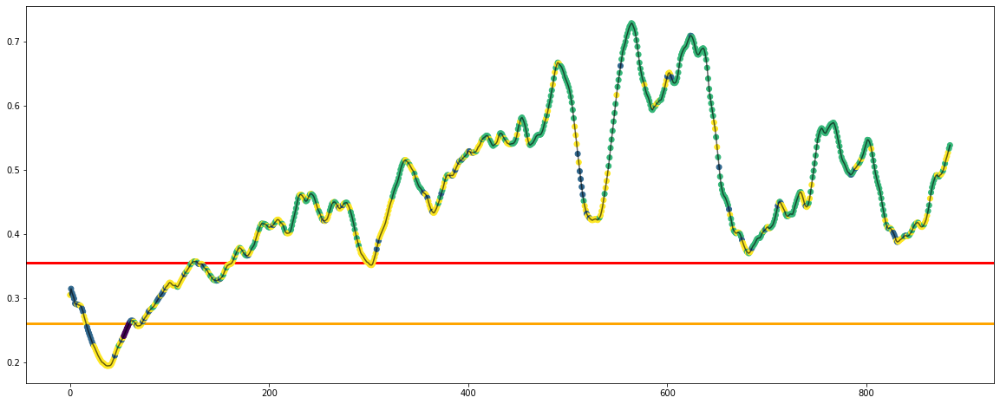

Experiment: 20_20151129_night


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.07335536 0.1253523  0.06408834 0.05131006 0.07335536        nan
 0.09781446 0.1240279  0.09781446 0.05148224]
  category=UserWarning


Best Model:
	Score: 0.1254
	Hyperparameters: {'convergence_iter': 12, 'damping': 0.9, 'preference': -7}

Cluestering evaluation:
	Silhouette Coefficient: 0.4483
	Calinski-Harabasz Index: 826.7158
	Davies Bouldin Index: 0.6766
Numero de Clusters: 5


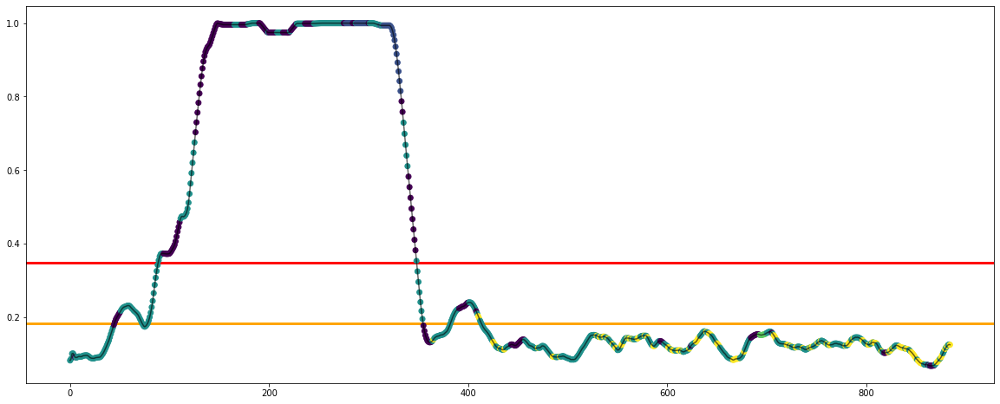

Experiment: 21_20151016_noon


c:\users\usuario\appdata\local\programs\python\python37\lib\site-packages\sklearn\model_selection\_search.py:921: UserWarning: One or more of the test scores are non-finite: [0.15045092 0.15502235 0.15933474 0.15702418 0.15045092        nan
 0.16006173 0.18256748 0.16006173 0.15797005]
  category=UserWarning


Best Model:
	Score: 0.1826
	Hyperparameters: {'convergence_iter': 9, 'damping': 0.8, 'preference': -5}

Cluestering evaluation:
	Silhouette Coefficient: 0.3998
	Calinski-Harabasz Index: 434.3701
	Davies Bouldin Index: 0.8152
Numero de Clusters: 6


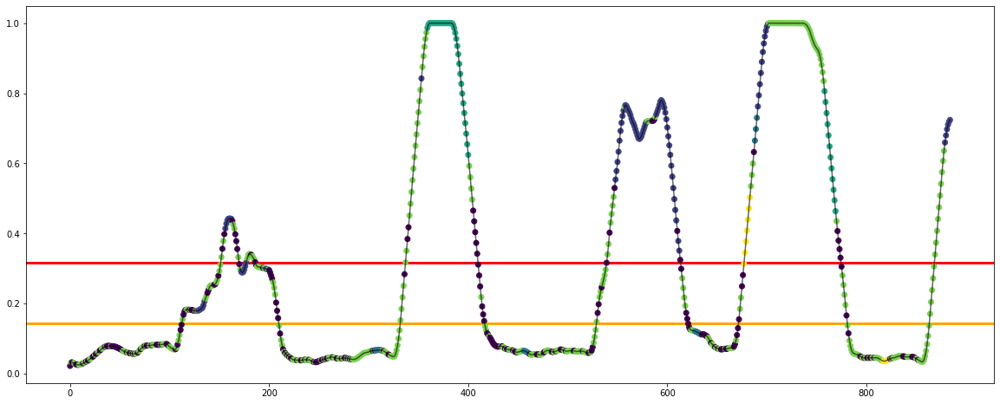

In [41]:
key = '21_20151016_noon'

csv_dict = {
    'sujeto': [],
    'silhouette': [],
    'calinski': [],
    'davies': []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = AffinityPropagation(max_iter=1000, random_state=42)

    space = dict()
    space['damping'] = [0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
    space['convergence_iter'] = randint(8, 15)
    space['preference'] = range(-1, -10, -1)

    best_model, silhouette, calinski, davies = find_and_test_best_model_clust(X_all_eog[key], y_all[key], model, space, cv=5, n_iter=10, scoring='homogeneity_score')
    
    cluster_centers_indices = best_model.cluster_centers_indices_
    n_clusters_ = len(cluster_centers_indices)
    print(f'Numero de Clusters: {n_clusters_}')
    
    csv_dict['sujeto'].append(key)
    csv_dict['silhouette'].append(silhouette)
    csv_dict['calinski'].append(calinski)
    csv_dict['davies'].append(davies)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_clust(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_clust/AffProp-PSD+EOG.csv', index=False)

### Resto de cosas de Affinity Propagation

In [44]:
from sklearn.cluster import AffinityPropagation
from sklearn import metrics

from itertools import cycle

In [69]:
#features_files = ['4_20151105_noon.mat', '4_20151107_noon.mat', '5_20141108_noon.mat','12_20150928_noon.mat','14_20151014_night.mat', '18_20150926_noon.mat', '21_20151016_noon.mat']
key = '21_20151016_noon'

af = AffinityPropagation(preference=-6, max_iter=3000, affinity='euclidean', random_state=42)

af.fit(X_all[key])

cluster_centers_indices = af.cluster_centers_indices_
predictions = af.labels_
n_clusters_ = len(cluster_centers_indices)

print('Estimated number of clusters: %d' % n_clusters_)

Estimated number of clusters: 5


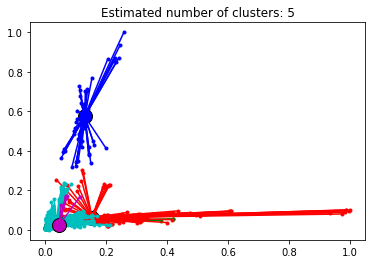

In [70]:
colors = cycle('bgrcmykbgrcmykbgrcmykbgrcmyk')
for k, col in zip(range(n_clusters_), colors):
    class_members = predictions == k
    cluster_center = X_all[key][cluster_centers_indices[k]]
    plt.plot(X_all[key][class_members, 0], X_all[key][class_members, 1], col + '.')
    plt.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col, markeredgecolor='k', markersize=14)
    for x in X_all[key][class_members]:
        plt.plot([cluster_center[0], x[0]], [cluster_center[1], x[1]], col)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

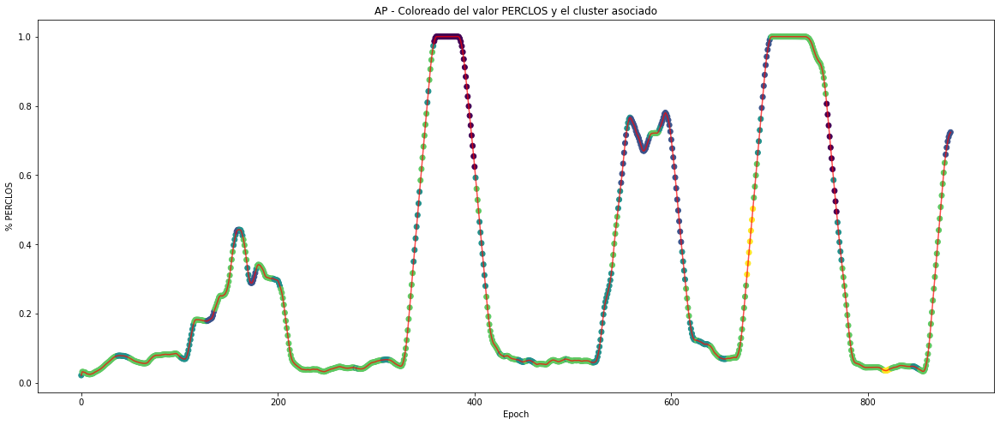

In [71]:
plt.figure(figsize=(20, 8))
plt.plot(y_all[key], color='r', alpha=0.7)
plt.scatter(range(len(predictions)), y_all[key], c=predictions)
plt.title('AP - Coloreado del valor PERCLOS y el cluster asociado')
plt.xlabel('Epoch')
plt.ylabel('% PERCLOS')
plt.show()